## Environment setup

In [1]:
pip install numpy
pip install pandas
pip install openpyxl
pip install xlrd
pip install xlwt
pip install python-slugify
pip install chardet


Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip available: 22.3.1 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [11]:
import numpy as np
import pandas as pd
import os
from slugify import slugify
import chardet
from io import StringIO
import csv
import fnmatch
import re

# Organização de arquivos e DFs

## Dicionário de arquivos e DFs

In [12]:
# Original Files armazena o nome dos dfs importados como keys e os nomes dos arquivos originais como valores

Original_Files = {} # Original Files armazena o nome dos dfs importados como keys e os nomes dos arquivos originais como valores
Raw_DFs        = {} # Raw_DFs armazena os dfs importados diretamente do arquivo, sem modificações, para garantir resets
Working_DFs    = {} # Working_DFs armazena os dfs sendo trabalhados (nomeados df_Nome) momentaneamente
Treated_DFs    = {} # Treated_DFS armazena os dfs após limpeza e tratamento (nomeados DF_Nome) para uso posterior para queries e análise
Filtered_DFs   = {} # Filtered_DFs armazena DFs menores criados a partir da seleção de dados dos DFs originais

Project_Index = [   # Project_Index contém a lista com nomes dos dicionários na ordem em que são armazenados em Project_DFs para facilitar o processo
                'Project_Index',
                'Original_Files', 
                'Raw_DFs', 
                'Working_DFs', 
                'Treated_DFs', 
                'Filtered_DFs'
                ]

Errors_list =   []  # Lista para adição de erros e exceções para tratamento específico

Project_DFs   = [   # Project_DFs é a lista que contém todos os dicionários do projeto
                Project_Index, 
                Original_Files, 
                Raw_DFs, 
                Working_DFs, 
                Treated_DFs, 
                Filtered_DFs,
                Errors_list
                ]


In [13]:
# Checando cwd do projeto e arquivos no diretório 
os.getcwd(), os.listdir()

('c:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard',
 ['% Crianças Pobres Censos (91-2010) Municípios AL BA PE.xlsx',
  '% de Extremamente Pobres Municipal BR 1991-2010.csv',
  '% Pobres - linha de pobreza baseada em necessidades calóricas - Estadual BR 1976-2014.csv',
  '% Pobres Municipal BR 1991-2010.csv',
  '% Pobreza e Renda Pobreza Municípios Censos (91-2010) AL BA PE.xlsx',
  '% População com acesso a infraestrutura Censos (91-2010) Municipios AL BA PE.xlsx',
  '% População com acesso a saneamento SNIS (2017) Municípios AL BA PE.xlsx',
  '% População vivendo em domicílios precários Censos (91-2010) Municípios AL BA PE.xlsx',
  'Aglomerados Subnormais.xlsx',
  'Areas de Risco_Domicilios RAW.xlsx',
  'Areas de Risco_Pessoas RAW.xls',
  'A_p_amp_dc_e_os_30_anos_de_desastres_no_Brasil_20221_compressed.pdf',
  'Dados Educação Censos (1991-2010) por Sexo, Cor e Modo de Vida Municípios AL BA PE.xlsx',
  'Dados Renda Detalhados Censos (91-2010) Municípios AL BA PE.xlsx',
  'Da

## Datasets usados no projeto

In [14]:
# Listando os arquivos de trabalho necessários e anotando problemas de limpeza necessários

Files = [
        'DTB_BRASIL_MUNICIPIO.xls',
        'Areas de Risco_Domicilios RAW.xlsx', # associar COD_BATER ao cod. municipal padrão IBGE e adicionar coluna com nome de municipios
        'Areas de Risco_Pessoas RAW.xls', # associar COD_BATER ao cod. municipal padrão IBGE e adicionar coluna com nome de municipios
        'Mapa INSAN Raw.xlsx', #slugify nomes de municipios
        'População.xlsx', # Municipios repetidos, filtrar por cor, sexo e situação domic. em dfs diferentes?
        'Educação.xlsx', #slugify nomes de municipios
        'Renda e Ocupação.xlsx', # Municipios repetidos, filtrar por cor, sexo e situação domic. em dfs diferentes?
        'Pobreza e Vulnerabilidade.xlsx', # Municipios repetidos, filtrar por cor, sexo e situação domic. em dfs diferentes?
        'Aglomerados Subnormais.xlsx', #slugify nomes de municipios

        '% Pobres Municipal BR 1991-2010.csv', #slugify nomes de municipios
        '% de Extremamente Pobres Municipal BR 1991-2010.csv', #slugify nomes de municipios
        '% Crianças Pobres Censos (91-2010) Municípios AL BA PE.xlsx', # Nomes municipios com (UF) e colunas vazias
        '% Pobres - linha de pobreza baseada em necessidades calóricas - Estadual BR 1976-2014.csv', #slugify UFs
        '% Pobreza e Renda Pobreza Municípios Censos (91-2010) AL BA PE.xlsx', # Nomes municipios com (UF) e colunas vazias
        'Dados Renda Detalhados Censos (91-2010) Municípios AL BA PE.xlsx', # Nomes municipios com (UF) e colunas vazias
        'Renda Domiciliar Estratificada Censos (91-2010) Municípios AL BA PE.xlsx', # Nomes municipios com (UF) e colunas vazias
        'Estratificação Renda Censos (91-2010) Municípios AL BA PE.xlsx', # Nomes municipios com (UF) e colunas vazias

        'PIB Municipal 1970.csv', #slugify nomes de municipios, checar inexistência de Municipios
        'PIB Municipal 1996.csv', #slugify nomes de municipios, checar inexistência de Municipios
        'PIB Municipal 2000.csv', #slugify nomes de municipios, checar inexistência de Municipios
        'PIB Municipal 2010.csv', #slugify nomes de municipios, checar inexistência de Municipios
        'PIB Municipal 2020.csv', #slugify nomes de municipios, checar inexistência de Municipios

        '% População com acesso a infraestrutura Censos (91-2010) Municipios AL BA PE.xlsx', # Nomes municipios com (UF) e colunas vazias
        '% População com acesso a saneamento SNIS (2017) Municípios AL BA PE.xlsx', # Nomes municipios com (UF) e colunas vazias
        '% População vivendo em domicílios precários Censos (91-2010) Municípios AL BA PE.xlsx', # Nomes municipios com (UF) e colunas vazias

        'Dados Educação Censos (1991-2010) por Sexo, Cor e Modo de Vida Municípios AL BA PE.xlsx', # Nomes municipios com (UF) e colunas vazias
        'Medidas de Desigualdade Censos (91-2010) Municípios AL BA PE.xlsx' # Nomes municipios com (UF) e colunas vazias
        ]



# Ingestão de dados e armazenamento no dicionário de arquivos e DFs

#### function: digest_files( )

In [15]:
# Cria função para digestão de arquivos e armazenamento de dfs nos dicionários do projeto

''' DOC:
Lê e armazena arquivos de dados com pd.read_ listados em uma lista passada como argumento.
Distingue entre formatos de arquivo .csv ou .xlsx/.xls. 
Arquivos .xls são lidos e armazenados sem intervenções. 
Em arquivos .csv é identificado o tipo de encoding utilizado com chardet.detect() e o arquivo é lido e tem os separadores substituídos por ',' antes do armazenamento.
Gera nomes dinamicamente, padronizando texto removendo espaços e hífens.
Armazena df em variável no escopo global com globals().
Adiciona arquivos nos dicionários do projeto.

Argumento obrigatório:
Files: Lista com nomes de arquivos para leitura.
'''

def digest_files(Files): 

    # Gerando listas vazia para armazenar com os dfs criados, nomes dos dfs criados e nomes dos arquivos importados
    Lista_dfs            = []
    Lista_nomes_dfs      = []
    Lista_imported_files = []
    
    for file in  Files: 

        # Detecta formato de arquivo.csv          
        if '.csv' in file: 

            # Produz nomes dinamicamente para o df a partir do arquivo 
            name = file.replace('.csv', '').replace(' ', '_').replace('-', '_')
            df   = f'raw_{name}'

            # Tenta criar o df e armazenar em var globalmente a partir de .csv sem intervenções
            try: 
                globals()[df] = pd.read_csv(file)
            
            # Em caso de erro tenta especificar encoding e substituir separadores específicos por ','
            except: 
                try: 
                    # Verifica o tipo de encoding do arquivo .csv e armazena em variável para uso na função pd.read_csv
                    with open (file, 'rb') as f: 
                        encod_result = chardet.detect(f.read())['encoding']

                    # abre o arquivo e substitui os separadores em cada linha antes de pd.read_csv, adiciona o tipo de enconding na função
                    globals()[df] = pd.read_csv(StringIO(''.join(l.replace('\t', ',').replace(';', ',') for l in open(file))), encoding = encod_result)

                    # Adiciona df criado nas listas da função
                    Lista_dfs.append(globals()[df])
                    Lista_nomes_dfs.append(df)
                    Lista_imported_files.append(file)
                    print(f'{df} criado com sucesso a partir do arquivo {file}, encoding detectado: {encod_result}')                      

                # Em caso de persistência de erro, não interrompe o processo e armazena arquivo não processado na lista de erros
                except: 
                    print(f'Impossível criar df a partir de {file}')
                    Errors_list.append(file)

            else: 
                # Adiciona df criado nas listas da função
                Lista_dfs.append(globals()[df])
                Lista_nomes_dfs.append(df)
                Lista_imported_files.append(file)
                print(f'{df} criado com sucesso a partir do arquivo {file}')        

        # Detecta formato de arquivo.xls ou .xlsx
        elif '.xlsx' or '.xls' in file: 
            
            # Produz nomes dinamicamente e cria variável que armazena o conteúdo do arquivo em df no escopo global
            name = file.replace('.xlsx', '').replace('.xls', '').replace(' ', '_').replace('-','_')
            df   = f'raw_{name}'

            try: 
                globals()[df] = pd.read_excel(file)
            except: 
                print(f'Impossível criar df a partir de {file}')
                Errors_list.append(file)
            else: 
                # Adiciona df criado nas listas da função
                Lista_dfs.append(globals()[df])
                Lista_nomes_dfs.append(df)
                Lista_imported_files.append(file)
                print(f'{df} criado com sucesso a partir do arquivo {file}')       

        else: 
            print(f'{file} não é um arquivo .csv, .xls ou .xlsx')

    # Zipa listas da função em dicionários utilizados para atualizar os dicionários do projeto
    dict_update_line = dict(zip(Lista_nomes_dfs, Lista_imported_files))
    Original_Files.update(dict_update_line)
    dict_update_line = dict(zip(Lista_nomes_dfs, Lista_dfs))
    Raw_DFs.update(dict_update_line)
    

## Ingestão de arquivos

In [16]:
# Digerindo os arquivos listados

digest_files(Files)

# checking
Raw_DFs.keys(), Original_Files


raw_DTB_BRASIL_MUNICIPIO criado com sucesso a partir do arquivo DTB_BRASIL_MUNICIPIO.xls
raw_Areas_de_Risco_Domicilios_RAW criado com sucesso a partir do arquivo Areas de Risco_Domicilios RAW.xlsx
raw_Areas_de_Risco_Pessoas_RAW criado com sucesso a partir do arquivo Areas de Risco_Pessoas RAW.xls
raw_Mapa_INSAN_Raw criado com sucesso a partir do arquivo Mapa INSAN Raw.xlsx
raw_População criado com sucesso a partir do arquivo População.xlsx
raw_Educação criado com sucesso a partir do arquivo Educação.xlsx
raw_Renda_e_Ocupação criado com sucesso a partir do arquivo Renda e Ocupação.xlsx
raw_Pobreza_e_Vulnerabilidade criado com sucesso a partir do arquivo Pobreza e Vulnerabilidade.xlsx
raw_Aglomerados_Subnormais criado com sucesso a partir do arquivo Aglomerados Subnormais.xlsx
raw_%_Pobres_Municipal_BR_1991_2010 criado com sucesso a partir do arquivo % Pobres Municipal BR 1991-2010.csv, encoding detectado: ISO-8859-1
raw_%_de_Extremamente_Pobres_Municipal_BR_1991_2010 criado com sucesso 

(dict_keys(['raw_DTB_BRASIL_MUNICIPIO', 'raw_Areas_de_Risco_Domicilios_RAW', 'raw_Areas_de_Risco_Pessoas_RAW', 'raw_Mapa_INSAN_Raw', 'raw_População', 'raw_Educação', 'raw_Renda_e_Ocupação', 'raw_Pobreza_e_Vulnerabilidade', 'raw_Aglomerados_Subnormais', 'raw_%_Pobres_Municipal_BR_1991_2010', 'raw_%_de_Extremamente_Pobres_Municipal_BR_1991_2010', 'raw_%_Crianças_Pobres_Censos_(91_2010)_Municípios_AL_BA_PE', 'raw_%_Pobres___linha_de_pobreza_baseada_em_necessidades_calóricas___Estadual_BR_1976_2014', 'raw_%_Pobreza_e_Renda_Pobreza_Municípios_Censos_(91_2010)_AL_BA_PE', 'raw_Dados_Renda_Detalhados_Censos_(91_2010)_Municípios_AL_BA_PE', 'raw_Renda_Domiciliar_Estratificada_Censos_(91_2010)_Municípios_AL_BA_PE', 'raw_Estratificação_Renda_Censos_(91_2010)_Municípios_AL_BA_PE', 'raw_PIB_Municipal_1970', 'raw_PIB_Municipal_1996', 'raw_PIB_Municipal_2000', 'raw_PIB_Municipal_2010', 'raw_PIB_Municipal_2020', 'raw_%_População_com_acesso_a_infraestrutura_Censos_(91_2010)_Municipios_AL_BA_PE', 'raw_%_

# Dicionários de padronização dos DFs com códigos e nomes de municípios a partir de DTB_BRASIL_MUNICÍPIO

In [17]:
# Tratando raw_DTB_BRASIL_MUNICIPIO

# Armazenando raw data em dfs de trabalho para tratamento
df_Codigos_IBGE = Raw_DFs['raw_DTB_BRASIL_MUNICIPIO'].copy()

# Slugifying todas as colunas com nomes de unidades territoriais
cols = ['Nome_UF', 'Nome_Mesorregião', 'Nome_Microrregião', 'Nome_Município']
for  col in cols: 
     df_Codigos_IBGE[col] = df_Codigos_IBGE[col].apply(slugify)

# Armazenando DF tratado no dicionário Treated_DFs
DF_Codigos_IBGE = df_Codigos_IBGE.copy()
Treated_DFs['DF_Codigos_IBGE'] = DF_Codigos_IBGE


In [18]:
# Cria dicionários IBGE

# Cria dicionário código-município e município-código
CodMunicipio_dict = dict(zip(df_Codigos_IBGE['Código Município Completo'].astype(str), df_Codigos_IBGE['Nome_Município']))
MunicipioCod_dict = dict(zip(df_Codigos_IBGE['Nome_Município'], df_Codigos_IBGE['Código Município Completo'].astype(str)))

# Cria dicionário da mesma natureza associando os códigos das UFs (2 primeiros digitos do código municipal) aos nomes da UFs
CodUF_dict = dict(zip(df_Codigos_IBGE['UF'].astype(str), df_Codigos_IBGE['Nome_UF']))
UFCod_dict = dict(zip(df_Codigos_IBGE['Nome_UF'].astype(str), df_Codigos_IBGE['UF']))

# Cria dicionário associando nomes dos municípios padronizados aos nomes de meso e microrregiões
CodMeso_dict  = dict(zip(df_Codigos_IBGE['Código Município Completo'].astype(str), df_Codigos_IBGE['Nome_Mesorregião']))
CodMicro_dict = dict(zip(df_Codigos_IBGE['Código Município Completo'].astype(str), df_Codigos_IBGE['Nome_Microrregião']))

#### function: add_IBGE_std( )

In [19]:
# Cria função para adicionar nomenclatura aos dfs a partir do padrão IBGE mapeado nos dicts CodMunic_dict e CodUF_dict
''' DOC:
add_IBGE_std(df, col, cod_ibge = True, drop = []):

Adiciona as colunas cod_municipio, nome_municipio, cod_UF e nome_UF
a partir de coluna do df com código do município ou nome do município 
indicada como parâmetro.

A função necessita dos dicionários criados a partir de tabela do IBGE com 
códigos e nomes dos municípios (CodMunicipio_dict e MunicipioCod_dict) e 
realiza o mapeamento dos valores da coluna indicada como chave.

No caso de scale = 'mun', adiciona nomes e códigos de municípios e UFs à tabela.

No caso de scale = 'UF', adiciona apenas nomes e códigos de UFs à tabela.

No caso de cod_ibge = True, toma o valor dos códigos do município, cria coluna a 
partir do dicionário CodMunicpio_dict, e cria cod_UF e nome_UF a partir do dict 
CodUF_dict

No caso de cod_ibge = False, toma o valor dos nomes dos municípios, cria coluna 
cod_municipio a partir do dicionário MunicipioCod, e cria cod_UF e nome_UF a partir 
do dict CodUF_dict 

O argumento drop indica colunas que se deseja deletar do df durante o processo.

A função demanda como argumentos obrigatórios: 
  - (var) df: Um data frame a ser processado
  - (str) col: O nome de uma coluna chave cujos valores serão mapeados para produção de 
     nova coluna cod_municipio ou cod_IBGE

A função recebe como argumentos opcionais:
  - (str) scale: 'mun' por padrão. 'UF' aplica a padronização e inserção de códigos ou nomes 
     apenas de UFs. 'mun' aplica a padronização e inserção de nomes e códigos de municípios e UFs.
  - (boolean) cod_ibge: True por padrão. True indica que a coluna chave indicada contém os códigos 
     de município do IBGE a partir do qual serão gerados os nomes padronizados. False indica que a 
     coluna contém nomes dos município, a partir dos quais serão gerados os códigos de município.
  - (list of str) drop: [] por padrão. As strings indicadas dentro de drop são deletadas ao final do processo.

'''


def add_IBGE_std(df, col, scale = 'mun', cod_ibge = True, drop = []):
    
    x = df

    if scale == 'mun' and cod_ibge == True :

        # Adiciona colunas numeradas como strings a partir dos códigos do IBGE mapeados como keys em CodMunicipio_dict
        x ['!02cod_municipio']  = x[col].astype(str)
        x ['!03nome_municipio'] = x['!02cod_municipio'].map(CodMunicipio_dict)
        x ['!00cod_UF']         = x[col].astype(str).str[:2]
        x ['!01nome_UF']        = x['!00cod_UF'].map(CodUF_dict)

        # Cria uma lista com os nomes das colunas e a reordena lexicograficamente
        new_order = sorted(x.columns.tolist())

        # Reinsere as colunas no df a partir da lista ordenada new_order
        x = x[new_order]

        # Remove a numeração no nome das colunas
        x.rename({
        '!00cod_UF'        : 'cod_UF',
        '!01nome_UF'       : 'nome_UF',
        '!02cod_municipio' : 'cod_municipio',
        '!03nome_municipio': 'nome_municipio'
        }, axis = 1, inplace = True)

    # Adiciona a colunas a partir do nome do município disponível, padronizado com slugify para corresponder aos nomes padronizados como keys em MunicipioCod_dict   
    elif scale == 'mun' and cod_ibge == False  :
        # Preenche NaN com 'None' para proceder com slugify dos nomes de municipios
        x['!03nome_municipio'] = x[col].fillna('None').apply(slugify)
        x['!02cod_municipio']  = x['!03nome_municipio'].map(MunicipioCod_dict)
        x['!00cod_UF']         = x['!02cod_municipio'].astype(str).str[:2]
        x['!01nome_UF']        = x['!00cod_UF'].map(CodUF_dict)

        # Reordena e renomeia as novas colunas
        new_order = sorted(x.columns.tolist())
        x         = x[new_order]
        x.rename({
        '!00cod_UF'        : 'cod_UF',
        '!01nome_UF'       : 'nome_UF',
        '!02cod_municipio' : 'cod_municipio',
        '!03nome_municipio': 'nome_municipio'
        }, axis = 1, inplace = True)

    elif scale == 'UF' and cod_ibge == True:
        
        # Criando as colunas nome_UF a partir dos códigos do IBGE mapeados como keys em CodUF_dict
        x ['!00cod_UF']   = x[col].astype(str)
        x ['!01nome_UF']  = x['!00cod_UF'].map(CodUF_dict)

        # Reordena e renomeia as novas colunas
        new_order = sorted(x.columns.tolist())
        x         = x[new_order]
        x.rename({
        '!00cod_UF' : 'cod_UF',
        '!01nome_UF': 'nome_UF'
        }, axis = 1, inplace = True)

    # Adiciona colunas a partir do nome do estado disponível, padronizado com slugify correspondendo aos nomes padronizados como keys em UFCod_dict
    elif scale == 'UF' and cod_ibge == False: 
        x['!01nome_UF'] = x[col].fillna('None').apply(slugify)
        x['!00cod_UF']  = x['!01nome_UF'].map(UFCod_dict)

        # Reordena e renomeia as novas colunas
        new_order = sorted(x.columns.tolist())
        x         = x[new_order]
        x.rename({
        '!00cod_UF' : 'cod_UF',
        '!01nome_UF': 'nome_UF'
        }, axis = 1, inplace = True)

    elif scale == 'all' and cod_ibge == True:

        # Adiciona colunas numeradas como strings nome_municipio e nome_UF a partir dos códigos do IBGE mapeados como keys em CodMunicipio_dict
        x['!04cod_municipio']      = x[col].astype(str)
        x['!05nome_municipio']     = x['!04cod_municipio'].map(CodMunicipio_dict)
        x['!00cod_UF']             = x[col].astype(str).str[:2]
        x['!01nome_UF']            = x['!00cod_UF'].map(CodUF_dict)
        x['!02nome_mesorregiao']   = x['!04cod_municipio'].map(CodMeso_dict)
        x['!03nome_microrregiao']  = x['!04cod_municipio'].map(CodMicro_dict)
        
        # Cria uma lista com os nomes das colunas e a reordena lexicograficamente
        new_order = sorted(x.columns.tolist())

        # Reinsere as colunas no df a partir da lista ordenada new_order
        x = x[new_order]

        # Remove a numeração no nome das colunas
        x.rename({
        '!00cod_UF'           : 'cod_UF',
        '!01nome_UF'          : 'nome_UF',
        '!04cod_municipio'    : 'cod_municipio',
        '!05nome_municipio'   : 'nome_municipio',
        '!02nome_mesorregiao' : 'nome_mesorregiao',
        '!03nome_microrregiao': 'nome_microrregiao'
        }, axis = 1, inplace = True)

        # Adiciona a colunas a partir do nome do município disponível, padronizado com slugify para corresponder aos nomes padronizados como keys em MunicipioCod_dict
    elif scale == 'all' and cod_ibge == False: 
        x['!05nome_municipio']    = x[col].fillna('None').apply(slugify)
        x['!04cod_municipio']     = x['!05nome_municipio'].map(MunicipioCod_dict)
        x['!00cod_UF']            = x['!04cod_municipio'].astype(str).str[:2]
        x['!01nome_UF']           = x['!00cod_UF'].map(CodUF_dict)
        x['!02nome_mesorregião']  = x['!04cod_municipio'].map(CodMeso_dict)
        x['!03nome_microrregião'] = x['!04cod_municipio'].map(CodMicro_dict)

        # Reordena e renomeia as novas colunas
        new_order = sorted(x.columns.tolist())
        x         = x[new_order]
        x.rename({
        '!00cod_UF'           : 'cod_UF',
        '!01nome_UF'          : 'nome_UF',
        '!04cod_municipio'    : 'cod_municipio',
        '!05nome_municipio'   : 'nome_municipio',
        '!02nome_mesorregião' : 'nome_mesorregiao',
        '!03nome_microrregião': 'nome_microrregiao'
        }, axis = 1, inplace = True)

    # Se o parâmetro drop for declarado como argumento, deleta as colunas listadas do df
    if len(drop) != 0 :
      x.drop(drop, axis = 1, inplace = True)

    return x


# Tratando DFs

#### function: NaN_rows( )

In [20]:
# Cria função para visualização rápida de rows específicas que contém Nulls em colunas específicas
''' DOC:
NaN_rows(df, col) recebe como argumentos um dataframe (var) e uma coluna específica (str).
Cria uma máscara que retorna apenas as linhas com NaN na coluna indicada, sem eliminar outras colunas.
'''

def NaN_rows(df, col):
    mask = df[col].isna()
    NaN_rows = df[mask]
    return NaN_rows


#### function: make_filtered_df( )

In [21]:
# Cria função para aplicar múltiplos filtros semelhantes em um DF e armazenar DFs filtrados em arquivos.xlsx
''' Function DOC:
make_filtered_df(col, filter_value, df_name, [Project_DFs_number, save_excel, save_path])

Gera os nomes e DFs filtrados dinamicamente, armazena o resultado no dict Filtered_DFs e opcionalmente salva os DFs em arquivos .xlsx

A função demanda como argumentos obrigatórios: 
  - str col: o nome de uma coluna
  - str filter_value: uma lista com valores de filtros
  - str df_name: o nome do DF conforme armazenado como key em um dict em Project_DFs
A função recebe como argumentos opcionais:
  - int Project_DFs_number: o índice de um dict em Project_DFs, por padrão definido em 3. [2] Raw_DFs; [3] Working_DFs; [4] Treated_DFs; [5] Filtered_DFs. [0] e [1] resultarão em erro.
  - Boolean save_excel:True salva o df em um arquivo .xlsx no cwd ou diretório indicado. Por padrão definido como False, não salva arquivo .xlsx
  - str save_path: indica diretório para salvar arquivo .xlsx com o novo DF. Por padrão determina o cwd com a função os.getcwd()

'''

def make_filtered_dfs(df_name, col, filter_values, dict_number = 3, save_excel=False, save_path = os.getcwd()) :

    # Cria novo nome para o novo df unindo o df original ao filtro indicado
    new_df_name = df_name + '_' + '_'.join(filter_values)
    new_df_name = new_df_name.replace(' ','_').replace('-','_')

    # Seleciona o df indicado em df_name no dicionário indicado
    df = Project_DFs[dict_number][df_name]

    # Cria novo df globalmente a partir de lista de filtros passada como argumento filter_values
    globals()[new_df_name] = df[df[col].isin(filter_values)]
    Filtered_DFs[new_df_name] = globals()[new_df_name]


    if save_excel == True :
      globals()[new_df_name].to_excel(f'{save_path}\\{new_df_name}.xlsx', index = False)

      return print(f'''
                    {new_df_name} gerado com sucesso.
                    Shape: {globals()[new_df_name].shape}
                    Filtered_DFs atualizado com sucesso.
                    {print(Filtered_DFs.keys())}
                    Arquivo {new_df_name}.xlsx salvo com sucesso em {save_path}
                  ''')
    else :
       return print(f'''
                    {new_df_name} gerado com sucesso.
                    Shape: {globals()[new_df_name].shape}
                    Filtered_DFs atualizado com sucesso.
                    {print(Filtered_DFs.keys())}
                  ''')
       

## Tratando raw_Areas_Risco_Domicilios e raw_Areas_Risco_Pessoas

In [46]:
# Criando cópias de trabalho e armazenando em Working_DFs
df_Areas_Risco_Domic   = Raw_DFs['raw_Areas_de_Risco_Domicilios_RAW'].copy()
df_Areas_Risco_Pessoas = Raw_DFs['raw_Areas_de_Risco_Pessoas_RAW'].copy()
dict_update_line       = {
                         'df_Areas_Risco_Domic' : df_Areas_Risco_Domic, 
                         'df_Areas_Risco_Pessoas' : df_Areas_Risco_Pessoas
                         }
Working_DFs.update(dict_update_line)


In [47]:
# Cria nova coluna 'Código Município Completo' no df_Areas_Risco com apenas os 7 primeiros dígitos de COD_BATER
# correspondentes aos códigos dos municípios IBGE
df_Areas_Risco_Domic['Código_Município'] = df_Areas_Risco_Domic['COD_BATER'].astype(str).str[:7]

# Adiciona nomes de municípios, UFs e regiões e códigos de municípios e UFs conforme padrão IBGE a partir da coluna 'Código_Município'
df_Areas_Risco_Domic = add_IBGE_std(df_Areas_Risco_Domic, 'Código_Município', 'all', True)

In [48]:
# Repete procedimento acima para df_Area_Risco_Pessoas

df_Areas_Risco_Pessoas['Código_Município']  = df_Areas_Risco_Pessoas['COD_BATER'].astype(str).str[:7]
df_Areas_Risco_Pessoas = add_IBGE_std(df_Areas_Risco_Pessoas, 'Código_Município', 'all', True)


#### Verificando Nulos e padronizando colunas chave

In [49]:
# Verificando nulos em df_Areas_Risco_Domic
df_Areas_Risco_Domic.isnull().sum()

# Buscando rows de nulos em nome_municpio
NaN_rows(df_Areas_Risco_Domic, 'nome_municipio')

#* O erro se deve a erros de digitação no código em COD_BATER
#* O código 2301308 provavelmente se refere à cidade Araripe no Ceará, cod:2301307
#* O código 2409102 provavelmente se refere à cidade Passa-e-Fica no RN, cod: 2409100

# Buscando resultados pelas cidades e códigos

df_Areas_Risco_Domic[df_Areas_Risco_Domic.eq("2301307").any(axis=1)]
#* 0 rows
df_Areas_Risco_Domic[df_Areas_Risco_Domic.eq("araripe").any(axis=1)]
#* 0 rows
df_Areas_Risco_Domic[df_Areas_Risco_Domic.eq("2409100").any(axis=1)]
#*  0 rows
df_Areas_Risco_Domic[df_Areas_Risco_Domic.eq("passa-e-fica").any(axis=1)]
#* 0 rows

df = df_Areas_Risco_Domic.copy()

# Atualizando valores dos códigos IBGE corretos
df.at[641, 'Código_Município' ] = '2301307'
df.at[864, 'Código_Município']  = '2409100'

# Adicionando novamente nomenclatura padrão de unidades geográficas conforme padrão dos 
# dicionários criados a partir de raw_DTB_BRASIL_MUNICIPIO com a função add_IBGE_std()

# Remove colunas para recriação conforme códigos corretos
drop_list = ['cod_municipio', 'nome_municipio','cod_UF','nome_UF','nome_mesorregiao','nome_microrregiao']
df.drop(drop_list, axis = 1, inplace = True)

# Recria as colunas a partir dos códigos corrigidos
df = add_IBGE_std(df, 'Código_Município', 'all', True)

# Checking
df.isnull().sum()
#* 0 Nulls

# Atualizando df_Areas_Risco_Domic com as mudanças
df_Areas_Risco_Domic = df


In [50]:
# Verificando nulos em df_Areas_Risco_Pessoas
df_Areas_Risco_Pessoas.isnull().sum()

# Buscando rows de nulos em nome_municpio
NaN_rows(df_Areas_Risco_Pessoas, 'nome_municipio')

#* Os nulos se devem ao mesmo problema em df_Areas_Risco_Domic

# Repete procedimento acima para df_Areas_Risco_Pessoas

df = df_Areas_Risco_Pessoas.copy()

# Atualizando valores dos códigos IBGE corretos

df.at[641, 'Código_Município' ] = '2301307'
df.at[864, 'Código_Município']  = '2409100'


# Adicionando nomenclatura padrão de unidades geográficas conforme padrão dos 
# dicionários criados a partir de raw_DTB_BRASIL_MUNICIPIO com a função add_IBGE_std()

# Remove colunas para recriação conforme códigos corretos
drop_list = ['cod_municipio', 'nome_municipio','cod_UF','nome_UF','nome_mesorregiao','nome_microrregiao']
df.drop(drop_list, axis = 1, inplace = True)

# A configuração de add_IBGE_std() abaixo cria as colunas a partir dos códigos conhecidos
df = add_IBGE_std(df, 'Código_Município', 'all', True)

# Checking
df.isnull().sum()
#* 0 Nulls

# Atualizando df_Areas_Risco_Domic com as mudanças
df_Areas_Risco_Pessoas = df

In [51]:
# Salvando DFs tratados no dict Treated_DFs

DF_Areas_Risco_Domic = df_Areas_Risco_Domic
DF_Areas_Risco_Pessoas = df_Areas_Risco_Pessoas

dict_update_line = {
                   'DF_Areas_Risco_Domic' : DF_Areas_Risco_Domic, 
                   'DF_Areas_Risco_Pessoas' : DF_Areas_Risco_Pessoas
                   }
Treated_DFs.update(dict_update_line)


#### Unindo dfs Area_Risco_Pessoas e Area_Risco_Munic em um único df

In [52]:
# Realiza inner join com união em COD_BATER e modifica sufixos de duplicatas para facilitar a sua remoção
df_Areas_Risco_Domic_Pessoas = pd.merge(DF_Areas_Risco_Domic,
                                        DF_Areas_Risco_Pessoas, 
                                        how      = 'inner',
                                        on = 'COD_BATER',
                                        suffixes = ('', '_remove'))

# Deleta colunas excedentes criadas pelo merge()
df_Areas_Risco_Domic_Pessoas.drop([col for col in df_Areas_Risco_Domic_Pessoas.columns if 'remove' in col], axis = 1, inplace = True)

# Adiciona joined DF em Treated_DFs
DF_Areas_Risco_Domic_Pessoas = df_Areas_Risco_Domic_Pessoas.copy()
Treated_DFs['DF_Areas_Risco_Domic_Pessoas'] = DF_Areas_Risco_Domic_Pessoas


#### Criando DFs filtrados por unidade geográfica a partir de DF_Areas_Risco_Domic_Pessoas e exportando DFs filtrados em .xlsx

In [ ]:
# Preparando listas para criar e salvar os dfs necessários com make_filtered_df() em loop

# Define diretório para armazenar os arquivos gerados pelos novos dfs
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\Áreas de Risco'

# Criando os filtros com os valores desejados em cada escala territorial relevante para o projeto
Estados    = ['alagoas', 'bahia', 'pernambuco']

MicroRegs  = ['maceio', 'itamaraca', 'recife', 'suape', 'porto-seguro', 'ilheus-itabuna']

MesoRegs   = ['leste-alagoano', 'sul-baiano', 'metropolitana-de-recife']

Municipios = ['maceio',
            'marechal-deodoro',
            'rio-largo',
            'belmonte',
            'eunapolis',
            'itamaraju',
            'jucurucu',
            'porto-seguro',
            'prado',
            'santa-cruz-cabralia',
            'teixeira-de-freitas',
            'abreu-e-lima',
            'cabo-de-santo-agostinho',
            'igarassu',
            'jaboatao-dos-guararapes',
            'olinda',
            'paulista',
            'recife']


Unids_Territoriais = [Estados, MesoRegs, MicroRegs, Municipios]
Filterable_cols    = ['nome_UF', 'nome_mesorregiao', 'nome_microrregiao', 'nome_municipio']
Filters            = dict(zip(Filterable_cols, Unids_Territoriais))

# Esvaziando Filtered_DFs e mantendo apenas os DFs a serem processados em Working_DFs
Working_DFs.clear()
Filtered_DFs.clear()
Errors_list.clear()
Working_DFs['DF_Areas_Risco_Domic_Pessoas'] = DF_Areas_Risco_Domic_Pessoas

# Inicia loop iterando pelos dfs em Working_DFs
for df_name in Project_DFs[3].keys(): 
    # Itera pela lista de nomes de colunas definidos como keys em Filters
    for col in Filters.keys(): 
        # Itera pela lista de nomes de unidades territoriais definidos como values em Filters
        for unid in Filters[col]: 
            # Verifica se o filtro existe na coluna em que é aplicado
            if unid not in Project_DFs[3][df_name][col].tolist(): 
                #Adiciona filtros inexistentes em Errors_list
                Errors_list.append(unid)
                print(f'''
                        {unid} não existe em {col} no {df_name}
                        {df_name}_{unid} não foi criado.

                       ''')
            # Aplica make_filtered_df e salva arquivos no save_path
            else: 
                mask = []
                mask.append(unid)
                make_filtered_dfs(df_name, col, mask, 3, True, save_path)



In [ ]:
# Verificando Errors_list
print(Errors_list)
DF_Areas_Risco_Domic_Pessoas[DF_Areas_Risco_Domic_Pessoas['nome_municipio'].isin(Errors_list)]
#* Municipios em Errors_list de fato não constam em DF_Areas_Risco_Domic_Pessoas

In [59]:
# Cria DFs com todos os municípios, estados e regiões do projeto a partir de DF_Areas_Risco_Domic_Pessoas
DF_Areas_Risco_Municipios    = DF_Areas_Risco_Domic_Pessoas[DF_Areas_Risco_Domic_Pessoas['nome_municipio'].isin(Municipios)]
DF_Areas_Risco_Estados       = DF_Areas_Risco_Domic_Pessoas[DF_Areas_Risco_Domic_Pessoas['nome_UF'].isin(Estados)]
DF_Areas_Risco_Mesorregiões  = DF_Areas_Risco_Domic_Pessoas[DF_Areas_Risco_Domic_Pessoas['nome_UF'].isin(MesoRegs)]
DF_Areas_Risco_Microrregiões = DF_Areas_Risco_Domic_Pessoas[DF_Areas_Risco_Domic_Pessoas['nome_UF'].isin(MicroRegs)]

# Atualiza Filtered_DFs conforme necessário
dict_update_line = {
                   'DF_Areas_Risco_Municipios'   : DF_Areas_Risco_Domic_Pessoas,
                   'DF_Areas_Risco_Estados'      : DF_Areas_Risco_Domic_Pessoas,
                   'DF_Areas_Risco_Mesorregiões' : DF_Areas_Risco_Domic_Pessoas,
                   'DF_Areas_Risco_Microrregiões': DF_Areas_Risco_Domic_Pessoas
                   }

Filtered_DFs.update(dict_update_line)

# Exporta DFs filtrados em .xlsx
for key in list(dict_update_line.keys()):
    dict_update_line[key].to_excel(f'{save_path}\\{key}.xlsx', index = False)




## Tratando raw_Mapa_INSAN

In [70]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_Mapa_INSAN = Raw_DFs['raw_Mapa_INSAN_Raw'].copy()
Working_DFs.clear()
Working_DFs['df_Mapa_INSAN'] = df_Mapa_INSAN
df = df_Mapa_INSAN

# Remove \n de nomes de colunas
df.rename(columns= lambda s: ''.join(s.split('\n')), inplace=True)
df.rename(columns= lambda s: s.replace('%', ' %').replace('  ',' '), inplace=True)

# Aplica padrão do projeto com add_IBGE_std( ) a partir da coluna 'Código Município"
df = add_IBGE_std(df, 'Código Município IBGE', 'all', True, ['UF', 'Código Município IBGE', 'Nome do Município'])

# Checando valores nulos
DF_Mapa_INSAN.isnull().sum()
#* Não há nulos

# Adiciona DF tratado em Treated_DFs
DF_Mapa_INSAN                = df
Treated_DFs['DF_Mapa_INSAN'] = DF_Mapa_INSAN

# Exporta DF tratado em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\INSAN'
DF_Mapa_INSAN.to_excel(f'{save_path}\\DF_Mapa_INSAN.xlsx', index = False)



In [71]:
# Cria DFs filtrados por municípios e estados do projeto
DF_Mapa_INSAN_Municipios    = DF_Mapa_INSAN[DF_Mapa_INSAN['nome_municipio'].isin(Municipios)]
DF_Mapa_INSAN_Estados       = DF_Mapa_INSAN[DF_Mapa_INSAN['nome_UF'].isin(Estados)]
DF_Mapa_INSAN_Mesorregiões  = DF_Mapa_INSAN[DF_Mapa_INSAN['nome_mesorregiao'].isin(MesoRegs)]
DF_Mapa_INSAN_Microrregiões = DF_Mapa_INSAN[DF_Mapa_INSAN['nome_microrregiao'].isin(MicroRegs)]

# Salvando dfs filtrados nos dicionários apropriados
Filtered_DFs['DF_Mapa_INSAN_Municipios'] = DF_Mapa_INSAN_Municipios
Filtered_DFs['DF_Mapa_INSAN_Estados']    = DF_Mapa_INSAN_Estados

# Atualiza Filtered_DFs conforme necessário
dict_update_line = {
                   'DF_Mapa_INSAN_Municipios'   : DF_Mapa_INSAN_Municipios,
                   'DF_Mapa_INSAN_Estados'      : DF_Mapa_INSAN_Estados,
                   'DF_Mapa_INSAN_Mesorregiões' : DF_Mapa_INSAN_Mesorregiões,
                   'DF_Mapa_INSAN_Microrregiões': DF_Mapa_INSAN_Microrregiões
                   }

Filtered_DFs.update(dict_update_line)

# Exporta DFs filtrados em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\INSAN'
for key in list(dict_update_line.keys()):
    dict_update_line[key].to_excel(f'{save_path}\\{key}.xlsx', index = False)


## Tratando planilhas organizadas no Excel a partir de bases de dados online

### Tratando raw_População

In [73]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_População                = Raw_DFs['raw_População'].copy()
Working_DFs['df_População'] = df_População
df                          = df_População

# Aplica padrão do projeto a partir dos nomes de municípios
df = add_IBGE_std(df, 'Nome do Município', 'all', False, ['Nome da UF',	'Nome do Município', 'Ano'])

# Checando nulos
df.isnull().sum()
#* Necessário remover colunas vazias.
#* O excesso de nulos se dá pela tabela possuir as colunas Cor, Sexo 
#* e Situação de Domicílio como colunas de filtro (repetindo os dados 3x por cada categoria em cada coluna)

# Remove colunas vazias
df.drop(['Unnamed: 26', 'Unnamed: 27'], axis = 1, inplace = True)

# Checando coluna nome_municipio
#* Dois nulos convertidos em str values
df.drop([468, 469], inplace = True)

# Armazena df_População em DF_População_Municipios em Treated_DFs
DF_População_Municipios                = df
Treated_DFs['DF_População_Municipios'] = DF_População_Municipios

# Exporta DF tratado em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\População'
DF_População_Municipios.to_excel(f'{save_path}\\DF_População_Municipios.xlsx', index = False)


### Tratando raw_Educação

In [74]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_Educação                = Raw_DFs['raw_Educação'].copy()
Working_DFs['df_Educação'] = df_Educação
df                         = df_Educação

# Checando nulos
df.isnull().sum()
NaN_rows(df, 'AA')
#* Necessário remover linhas vazias e irrelevantes

# Remove linhas vazias
df.drop([18,19], inplace = True)

#Checa nulos novamente
df.isnull().sum()
#* 0 nulos

# Aplica padrão do projeto a partir dos nomes de municípios
df = add_IBGE_std(df, 'AA.1', 'all', False, ['AA', 'AA.1'])

# Armazenando df_Educação em Treated_DFs
DF_Educação_Municipios                = df
Treated_DFs['DF_Educação_Municipios'] = DF_Educação_Municipios

# Exporta DF tratado em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\Educação'
DF_Educação_Municipios.to_excel(f'{save_path}\\DF_Educação_Municipios.xlsx', index = False)


### Tratando raw_Renda_e_Ocupação

In [75]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_Renda_e_Ocupação                = Raw_DFs['raw_Renda_e_Ocupação'].copy()
Working_DFs['df_Renda_e_Ocupação'] = df_Renda_e_Ocupação
df                                 = df_Renda_e_Ocupação

# Checando nulos
df.isnull().sum()
NaN_rows(df, 'Nome do Município')
#* Necessário remover linhas vazias e irrelevantes em Nome do Município

# Remove linhas vazias
df.drop([468,469], inplace = True)

df.isnull().sum()
# #* 0 nulos

# Aplica padrão do projeto a partir dos nomes de municípios
df = add_IBGE_std(df, 'Nome do Município', 'mun', False, ['Nome da UF', 'Nome do Município', 'Ano'])

# Armazenando DF_Renda_e_Ocupação em Treated_DFs
DF_Renda_e_Ocupação_Municipios                = df
Treated_DFs['DF_Renda_e_Ocupação_Municipios'] = DF_Renda_e_Ocupação_Municipios

# Exporta DF tratado em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\Renda e Ocupação'
DF_Renda_e_Ocupação_Municipios.to_excel(f'{save_path}\\DF_Renda_e_Ocupação_Municipios.xlsx', index = False)


### Tratando raw_Pobreza_e_Vulnerabilidade

In [76]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_Pobreza_e_Vulnerabilidade                = Raw_DFs['raw_Pobreza_e_Vulnerabilidade'].copy()
Working_DFs['df_Pobreza_e_Vulnerabilidade'] = df_Pobreza_e_Vulnerabilidade
df                                          = df_Pobreza_e_Vulnerabilidade

# Checando nulos
df.isnull().sum()
#* Grande quantidade de nulos devido às colunas Cor, Sexo e Situação de Domicílio, que 
#* repetem os dados e possuem alguns ausentespara cada categoria que possuem 

NaN_rows(df, 'Nome do Município')
#* Necessário remover linhas vazias e irrelevantes em Nome do Município

# Remove linhas vazias
df.drop([468,469], inplace = True)

df.isnull().sum()
#* 0 nulos em Nome do Município

# Aplica padrão do projeto a partir dos nomes de municípios
df = add_IBGE_std(df, 'Nome do Município', 'mun', False, ['Nome da UF', 'Nome do Município', 'Ano'])

# # Armazenando DF_Renda_e_Ocupação em Treated_DFs
DF_Pobreza_e_Vulnerabilidade_Municipios                = df
Treated_DFs['DF_Pobreza_e_Vulnerabilidade_Municipios'] = DF_Pobreza_e_Vulnerabilidade_Municipios

# Exporta DF tratado em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\Pobreza e Vulnerabilidade'
DF_Pobreza_e_Vulnerabilidade_Municipios.to_excel(f'{save_path}\\DF_Pobreza_e_Vulnerabilidade_Municipios.xlsx', index = False)


### Tratando raw_Aglomerados_Subnormais

In [78]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_Aglomerados_Subnormais                = Raw_DFs['raw_Aglomerados_Subnormais'].copy()
Working_DFs['df_Aglomerados_Subnormais'] = df_Aglomerados_Subnormais
df                                       = df_Aglomerados_Subnormais

# Checando nulos
df.isnull().sum()
NaN_rows(df, 'NM_MUN')
#* Necessário remover linhas vazias e irrelevantes em Nome do Município

# Remove linhas vazias
df.drop([18,19], inplace = True)

df.isnull().sum()
#* 0 nulos em Nome do Município

# Aplica padrão do projeto a partir dos nomes de municípios
df = add_IBGE_std(df, 'NM_MUN', 'all', False, ['OBJECTID',	'CD_MUN',	'UF',	'NM_MUN'])

DF_Aglomerados_Subnormais_Municipios                = df
Treated_DFs['DF_Aglomerados_Subnormais_Municipios'] = DF_Aglomerados_Subnormais_Municipios

# Exporta DF tratado em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\AGSN'
DF_Aglomerados_Subnormais_Municipios.to_excel(f'{save_path}\\DF_Aglomerados_Subnormais_Municipios.xlsx', index = False)


## Tratando e unindo dfs sobre pobreza 1991-2010

### Tratando raw_%_Pobres_Municipal_BR_1991_2010

In [99]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_Prop_Pobres_Municipal_BR_1991_2010                = Raw_DFs['raw_%_Pobres_Municipal_BR_1991_2010'].copy()
Working_DFs['df_Prop_Pobres_Municipal_BR_1991_2010'] = df_Prop_Pobres_Municipal_BR_1991_2010
df                                                   = df_Prop_Pobres_Municipal_BR_1991_2010

# Checando nulos
df.isnull().sum()
#* 0 nulos em Nome do Município
#* nulos em todas as colunas com dados, municípios sem dados, nenhum na lista do projeto
NaN_rows(df, '1991')

# Cria máscara para filtrar linhas sem nulos e adiciona os índices do df resultante em lista
excluded_rows = NaN_rows(df, '1991').index.tolist()
excluded_rows

# Exclui lista de linhas com nulos
df.drop(excluded_rows, inplace = True)

df.isnull().sum()
#* 0 nulos no df

# Aplica padrão do projeto a partir de coluna com códigos IBGE
df = add_IBGE_std(df, 'Código', 'all', True, ['Código','Município', 'Sigla'])

# Renomeia colunas que serão repetidas no merge
df.rename(columns={
                  '1991': '% Pobres 1991',
                  '2000': '% Pobres 2000',
                  '2010': '% Pobres 2010' }, inplace = True)

# Reserva dataframe para realizar join posteriormente
df_left = df


### Limpando df_Prop_Extremam_Pobres_Municipal_BR_1991_2010

In [101]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_Prop_Extrem_Pobres_Municipal_BR_1991_2010                = Raw_DFs['raw_%_de_Extremamente_Pobres_Municipal_BR_1991_2010'].copy()
Working_DFs['df_Prop_Extrem_Pobres_Municipal_BR_1991_2010'] = df_Prop_Extrem_Pobres_Municipal_BR_1991_2010
df                                                          = df_Prop_Extrem_Pobres_Municipal_BR_1991_2010

# Checando nulos
df.isnull().sum()
#* 0 nulos em Nome do Município e 32 em todas as colunas, municipios sem dados
NaN_rows(df, '1991')

# Cria máscara para filtrar linhas sem nulos e adiciona os índices do df resultante em lista
excluded_rows = NaN_rows(df, '1991').index.tolist()
excluded_rows

# Exclui lista de linhas com nulos
df.drop(excluded_rows, inplace = True)

# Aplica padrão do projeto a partir de coluna com códigos IBGE
df = add_IBGE_std(df, 'Código', 'all', True, ['Código','Município', 'Sigla'])

# Renomeia colunas que serão repetidas no merge
df.rename(columns={
                  '1991': '% Ext Pobres 1991',
                  '2000': '% Ext Pobres 2000',
                  '2010': '% Ext Pobres 2010' }, inplace = True)

# Reserva dataframe para realizar join posteriormente
df_right = df


### Unindo df_Prop_Pobres_Municipal_BR_1991_2010 e df_Prop_Extrem_Pobres_Municipal_BR_1991_2010

In [105]:
# Faz inner join usando cod_municipio como key e altera sufixos para facilitar remoção de duplicatas
DF_Prop_Pobreza_Municipios_91_10 = pd.merge(df_left,
                                            df_right, 
                                            how      = 'inner',
                                            on       = 'nome_municipio',
                                            suffixes = ('', '_remove'))

# Deleta colunas excedentes criadas pelo merge()
DF_Prop_Pobreza_Municipios_91_10.drop([col for col in DF_Prop_Pobreza_Municipios_91_10.columns if 'remove' in col], axis = 1, inplace = True)

Treated_DFs['DF_Prop_Pobreza_Municipios_91_10'] = DF_Prop_Pobreza_Municipios_91_10

# Exporta df tratado em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\Pobreza e Vulnerabilidade'
DF_Prop_Pobreza_Municipios_91_10.to_excel(f'{save_path}\\DF_Prop_Pobreza_Municipios_91_10.xlsx', index = False)



## Tratando dfs PIB 1970-2020

### Tratando 'raw_PIB_Municipal_1970'

In [186]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_PIB_Municipal_1970                = Raw_DFs['raw_PIB_Municipal_1970'].copy()
Working_DFs['df_PIB_Municipal_1970'] = df_PIB_Municipal_1970
df                                   = df_PIB_Municipal_1970


df.isnull().sum()
#* 0 nulos em Nome do Município e 1645 nulos idênticos em todas as colunas, municipios sem dados
NaN_rows(df, 'PIB Municipal - preços de mercado (preços de 2010) (1970)')

# Cria máscara para filtrar linhas sem nulos e adiciona os índices desse df em lista
excluded_rows = NaN_rows(df, 'PIB Municipal - preços de mercado (preços de 2010) (1970)').index.tolist()
df.drop(excluded_rows, inplace=True)
#* 3951 linhas permanecem

# Exclui coluna vazia
df.drop(['Unnamed: 7'], axis = 1, inplace = True)

df.isnull().sum()
#* 0 nulos no df

df = add_IBGE_std(df, 'Código', 'mun', True, ['Sigla',	'Código',	'Município'])

# Checando municipios dos projetos
df[df['nome_municipio'].isin(Municipios)]
#*1 municipio homôninmo não pertinente

# transforma valor da célula específica
df.at[2711, 'nome_municipio' ] = 'paulista-pb'

DF_PIB_Municipal_1970 = df


### Tratando 'raw_PIB_Municipal_1996'

In [187]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_PIB_Municipal_1996                = Raw_DFs['raw_PIB_Municipal_1996'].copy()
Working_DFs['df_PIB_Municipal_1996'] = df_PIB_Municipal_1996
df                                   = df_PIB_Municipal_1996


# Checando nulos
df.isnull().sum()
# #* 0 nulos em Nome do Município e 622 nulos idênticos em todas as colunas, municipios sem dados
NaN_rows(df, 'PIB Municipal - preços de mercado (preços de 2010) (1996)')

# Cria máscara para filtrar linhas sem nulos e adiciona os índices desse df em lista
excluded_rows = NaN_rows(df, 'PIB Municipal - preços de mercado (preços de 2010) (1996)').index.tolist()
df.drop(excluded_rows, inplace=True)
#* 4974 linhas permanecem

# Exclui coluna vazia
df.drop(['Unnamed: 7'], axis = 1, inplace = True)

df.isnull().sum()
# #* 0 nulos no df

# Aplica padrão do projeto usando a coluna código IBGE como base
df = add_IBGE_std(df, 'Código', 'mun', True, ['Sigla',	'Código',	'Município'])
df

# Checando municipios dos projetos
df[df['nome_municipio'].isin(Municipios)]
#*2 municipios homôninmos não pertinentes

# transforma valores das células específicas
df.at[2711, 'nome_municipio' ] = 'paulista-pb'
df.at[4473, 'nome_municipio' ] = 'belmonte-sc'

DF_PIB_Municipal_1996 = df


### Tratando  raw_PIB_Municipal_2000

In [188]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_PIB_Municipal_2000                = Raw_DFs['raw_PIB_Municipal_2000'].copy()
Working_DFs['df_PIB_Municipal_2000'] = df_PIB_Municipal_2000
df                                   = df_PIB_Municipal_2000

# Checando nulos
df.isnull().sum()
# #* 0 nulos em Nome do Município e 89 nulos idênticos em todas as colunas, municipios sem dados
NaN_rows(df, 'PIB Municipal - preços de mercado (preços de 2010) (2000)')

# Cria máscara para filtrar linhas sem nulos e adiciona os índices desse df em lista
excluded_rows = NaN_rows(df, 'PIB Municipal - preços de mercado (preços de 2010) (2000)').index.tolist()
df.drop(excluded_rows, inplace=True)
df.isnull().sum()

# Exclui coluna vazia
df.drop(['Unnamed: 7'], axis = 1, inplace = True)

df.isnull().sum()
# #* 0 nulos no df

# Aplica padrão do projeto usando a coluna código IBGE como base
df = add_IBGE_std(df, 'Código', 'mun', True, ['Sigla',	'Código',	'Município'])

# Checando municipios dos projetos
df[df['nome_municipio'].isin(Municipios)]
# #*2 municipios homôninmos não pertinentes

# transforma valores das células específicas
df.at[2711, 'nome_municipio' ] = 'paulista-pb'
df.at[4473, 'nome_municipio' ] = 'belmonte-sc'

DF_PIB_Municipal_2000 = df


### Tratando  raw_PIB_Municipal_2010

In [189]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_PIB_Municipal_2010                = Raw_DFs['raw_PIB_Municipal_2010'].copy()
Working_DFs['df_PIB_Municipal_1996'] = df_PIB_Municipal_2010
df                                   = df_PIB_Municipal_2010

# Checando nulos
df.isnull().sum()
# #* 0 nulos em Nome do Município e 32 nulos idênticos em todas as colunas, municipios sem dados
NaN_rows(df, 'PIB Municipal - preços de mercado (preços de 2010) (2010)')

# Cria máscara para filtrar linhas sem nulos e adiciona os índices desse df em lista
excluded_rows = NaN_rows(df, 'PIB Municipal - preços de mercado (preços de 2010) (2010)').index.tolist()
df.drop(excluded_rows, inplace=True)
#* 5564 linhas permanecem

# Exclui coluna vazia
df.drop(['Unnamed: 7'], axis = 1, inplace = True)

df.isnull().sum()
# #* 0 nulos no df

# Aplica padrão do projeto usando a coluna código IBGE como base
df = add_IBGE_std(df, 'Código', 'mun', True, ['Sigla',	'Código',	'Município'])

# Checando municipios dos projetos
df[df['nome_municipio'].isin(Municipios)]
# #*2 municipios homôninmos não pertinentes

# transforma valores das células específicas
df.at[2711, 'nome_municipio' ] = 'paulista-pb'
df.at[4473, 'nome_municipio' ] = 'belmonte-sc'

DF_PIB_Municipal_2010 = df


### Tratando  raw_PIB_Municipal_2020

In [190]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_PIB_Municipal_2020                = Raw_DFs['raw_PIB_Municipal_2020'].copy()
Working_DFs['df_PIB_Municipal_2020'] = df_PIB_Municipal_2020
df                                   = df_PIB_Municipal_2020

# Checando nulos
df.isnull().sum()
# #* 0 nulos em Nome do Município e 32 nulos idênticos em todas as colunas, municipios sem dados
NaN_rows(df, 'PIB Municipal (valor adicionado a preços básicos) - indústria (preços de 2010) (2020)')

# Cria máscara para filtrar linhas sem nulos e adiciona os índices desse df em lista
excluded_rows = NaN_rows(df, 'PIB Municipal (valor adicionado a preços básicos) - indústria (preços de 2010) (2020)').index.tolist()
df.drop(excluded_rows, inplace=True)
#* 5564 linhas permanecem

# Exclui colunas vazias
df.drop(['Unnamed: 7'], axis = 1, inplace = True)
df.drop(['PIB Municipal - preços de mercado (preços de 2010) (2020)'], axis = 1, inplace = True)

df.isnull().sum()
# #* 0 nulos no df

# Aplica padrão do projeto usando a coluna código IBGE como base
df = add_IBGE_std(df, 'Código', 'mun', True, ['Sigla',	'Código',	'Município'])

# Checando municipios dos projetos
df[df['nome_municipio'].isin(Municipios)]
#*2 municipios homôninmos não pertinentes

# transforma valores das células específicas
df.at[2711, 'nome_municipio' ] = 'paulista-pb'
df.at[4473, 'nome_municipio' ] = 'belmonte-sc'

DF_PIB_Municipal_2020 = df


### Unindo dfs PIB_Municipal 1970, 1996, 2000, 2010, 2020

In [210]:
# Reduz nomes dos dfs
A = DF_PIB_Municipal_1970.copy()
B = DF_PIB_Municipal_1996.copy()
C = DF_PIB_Municipal_2000.copy()
D = DF_PIB_Municipal_2010.copy()
E = DF_PIB_Municipal_2020.copy()


# Faz inner join usando cod_municipio como key e altera sufixos para facilitar remoção de duplicatas
AB = pd.merge(
            A,
            B, 
            how      = 'right',
            on       = 'cod_municipio',
            suffixes = ('', '_remove'))
AB.drop([col for col in AB.columns if 'remove' in col], axis = 1, inplace = True)

ABC = pd.merge(
            AB,
            C, 
            how      = 'right',
            on       = 'cod_municipio',
            suffixes = ('', '_remove'))
ABC.drop([col for col in ABC.columns if 'remove' in col], axis = 1, inplace = True)

ABCD = pd.merge(
            ABC,
            D, 
            how      = 'right',
            on       = 'cod_municipio',
            suffixes = ('', '_remove'))
ABCD.drop([col for col in ABCD.columns if 'remove' in col], axis = 1, inplace = True)

ABCDE = pd.merge(
            ABCD,
            E, 
            how      = 'right',
            on       = 'cod_municipio',
            suffixes = ('', '_remove'))
ABCDE.drop([col for col in ABCDE.columns if 'remove' in col], axis = 1, inplace = True)

DF_PIB_Municipal_1970_2020 = ABCDE
Treated_DFs['DF_PIB_Municipal_1970_2020'] = DF_PIB_Municipal_1970_2020

# Exporta df tratado em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\PIB'
DF_PIB_Municipal_1970_2020.to_excel(f'{save_path}\\DF_PIB_Municipal_1970_2020.xlsx', index = False)


In [212]:
# Cria DFs com todos os municípios e estados do projeto a partir de DF_Areas_Risco_Domic_Pessoas
DF_PIB_Municipal_1970_2020_Municipios    = DF_PIB_Municipal_1970_2020[DF_PIB_Municipal_1970_2020['nome_municipio'].isin(Municipios)]
DF_PIB_Municipal_1970_2020_Estados       = DF_PIB_Municipal_1970_2020[DF_PIB_Municipal_1970_2020['nome_UF'].isin(Estados)]

# Atualiza Filtered_DFs conforme necessário
dict_update_line = {
                   'DF_PIB_Municipal_1970_2020_Municipios': DF_PIB_Municipal_1970_2020_Municipios,
                   'DF_PIB_Municipal_1970_2020_Estados'   : DF_PIB_Municipal_1970_2020_Estados
                   }

Filtered_DFs.update(dict_update_line)

# Exporta DFs filtrados em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\PIB'
for key in list(dict_update_line.keys()):
    dict_update_line[key].to_excel(f'{save_path}\\{key}.xlsx', index = False)




## Tratando dfs AL-BA-PE

 ### Tratando raw_%_Pobres_-_linha_de_pobreza_baseada_em_necessidades_calóricas_-_Estadual_BR_1976-2014_Pobres___linha_de_pobreza_baseada_em_necessidades_calóricas___Estadual_BR_1976_2014

In [218]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_Abaixo_Linha_de_Pobreza_Kcal_91_10                = Raw_DFs['raw_%_Pobres___linha_de_pobreza_baseada_em_necessidades_calóricas___Estadual_BR_1976_2014'].copy()
Working_DFs['df_Abaixo_Linha_de_Pobreza_Kcal_91_10'] = df_Abaixo_Linha_de_Pobreza_Kcal_91_10
df                                                   = df_Abaixo_Linha_de_Pobreza_Kcal_91_10

#Checa existência de valores nulos
df.isnull().sum()
#* DF sem necessidade de dropar Nulls

# Aplica padronização IBGE para cods. e nomes das unidades da federação
df = add_IBGE_std(df, 'Código', 'UF', True, ['Sigla',	'Código',	'Estado'])

DF_Abaixo_Linha_de_Pobreza_Kcal_91_2010 = df
Treated_DFs['DF_Abaixo_Linha_de_Pobreza_Kcal_91_2010'] = DF_Abaixo_Linha_de_Pobreza_Kcal_91_2010

# Exporta df tratado em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\Pobreza e Vulnerabilidade'
DF_Abaixo_Linha_de_Pobreza_Kcal_91_2010.to_excel(f'{save_path}\\DF_Abaixo_Linha_de_Pobreza_Kcal_91_2010.xlsx', index = False)

# filtrando DF_Abaixo_Linha_de_Pobreza_Kcal_91_2010 para alagoas, bahia e pernambuco utilizando a função make_filtered_dfs()
Working_DFs.clear()
Working_DFs['DF_Abaixo_Linha_de_Pobreza_Kcal_91_2010'] = DF_Abaixo_Linha_de_Pobreza_Kcal_91_2010
make_filtered_dfs('DF_Abaixo_Linha_de_Pobreza_Kcal_91_2010', 'nome_UF', ['alagoas', 'bahia', 'pernambuco'], 3, True, save_path)


dict_keys(['DF_Areas_Risco_Domic_Pessoas_alagoas', 'DF_Areas_Risco_Domic_Pessoas_bahia', 'DF_Areas_Risco_Domic_Pessoas_pernambuco', 'DF_Areas_Risco_Domic_Pessoas_leste_alagoano', 'DF_Areas_Risco_Domic_Pessoas_sul_baiano', 'DF_Areas_Risco_Domic_Pessoas_metropolitana_de_recife', 'DF_Areas_Risco_Domic_Pessoas_maceio', 'DF_Areas_Risco_Domic_Pessoas_itamaraca', 'DF_Areas_Risco_Domic_Pessoas_recife', 'DF_Areas_Risco_Domic_Pessoas_suape', 'DF_Areas_Risco_Domic_Pessoas_porto_seguro', 'DF_Areas_Risco_Domic_Pessoas_ilheus_itabuna', 'DF_Areas_Risco_Domic_Pessoas_marechal_deodoro', 'DF_Areas_Risco_Domic_Pessoas_belmonte', 'DF_Areas_Risco_Domic_Pessoas_itamaraju', 'DF_Areas_Risco_Domic_Pessoas_prado', 'DF_Areas_Risco_Domic_Pessoas_santa_cruz_cabralia', 'DF_Areas_Risco_Domic_Pessoas_abreu_e_lima', 'DF_Areas_Risco_Domic_Pessoas_cabo_de_santo_agostinho', 'DF_Areas_Risco_Domic_Pessoas_igarassu', 'DF_Areas_Risco_Domic_Pessoas_jaboatao_dos_guararapes', 'DF_Areas_Risco_Domic_Pessoas_olinda', 'DF_Areas_Ris

### Tratando 'raw_%_Crianças_Pobres_Censos_(91_2010)_Municípios_AL_BA_PE'

In [221]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_Prop_Crianças_Pobres_91_10_AL_BA_PE                = Raw_DFs['raw_%_Crianças_Pobres_Censos_(91_2010)_Municípios_AL_BA_PE'].copy()
Working_DFs['df_Prop_Crianças_Pobres_91_10_AL_BA_PE'] = df_Prop_Crianças_Pobres_91_10_AL_BA_PE
df                                                    = df_Prop_Crianças_Pobres_91_10_AL_BA_PE

# Checando nulos
df.isnull().sum()
#* DF sem necessidade de dropar Nulls em nomes de municípios
#* Dropar todas as colunas Desagregação
#* Dropar linhas vazias e irrelevantes (brasil, vazias e fontes)

# Seleciona todas as colunas que NÃO iniciam com a substring 'Desagregação'
df = df.loc[:,~df.columns.str.contains('^Desagregação')]

# Deletando linhas vazias ou irrelevantes
df.drop([0, 705,706,707], inplace = True)

# Padronizando nomes de municípios fora do padrão IBGE (impedem o mapping adequado para aplicação do padrão do projeto)
df['Territorialidades'] = df['Territorialidades'].replace(['Iguaraci (PE)', 'Muquém de São Francisco (BA)'],['Iguaracy', 'Muquém do São Francisco'])

# Padronizando coluna Territorialidades, removendo '(??)' das strings e aplicando slugify, 
# para permitir a aplicação da padronização do projeto com add_IBGE_std()
#! importar fnmatch e re (instalados na célula de preparação do ambiente)
df = df.replace(to_replace = '\(.*', value = '', regex = True)
df['Territorialidades'] = df['Territorialidades'].apply(slugify)

# Adicionando padrão IBGE usado no projeto
df = add_IBGE_std(df, 'Territorialidades', 'mun', False, ['Territorialidades'])

DF_Prop_Crianças_Pobres_91_10_AL_BA_PE                = df
Treated_DFs['DF_Prop_Crianças_Pobres_91_10_AL_BA_PE'] = DF_Prop_Crianças_Pobres_91_10_AL_BA_PE

# Exporta df tratado em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\Pobreza e Vulnerabilidade'
DF_Prop_Crianças_Pobres_91_10_AL_BA_PE.to_excel(f'{save_path}\\DF_Prop_Crianças_Pobres_91_10_AL_BA_PE.xlsx', index = False)



C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\3853510457.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop([0, 705,706,707], inplace = True)
C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\3853510457.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Territorialidades'] = df['Territorialidades'].replace(['Iguaraci (PE)', 'Muquém de São Francisco (BA)'],['Iguaracy', 'Muquém do São Francisco'])


### Tratando 'raw_%_Pobreza_e_Renda_Pobreza_Municípios_Censos_(91_2010)_AL_BA_PE'

In [222]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_Prop_Pobreza_Renda_91_10_AL_BA_PE                = Raw_DFs['raw_%_Pobreza_e_Renda_Pobreza_Municípios_Censos_(91_2010)_AL_BA_PE'].copy()
Working_DFs['df_Prop_Pobreza_Renda_91_10_AL_BA_PE'] = df_Prop_Pobreza_Renda_91_10_AL_BA_PE
df                                                  = df_Prop_Pobreza_Renda_91_10_AL_BA_PE

# Checando nulos
df.isnull().sum()
#* DF sem necessidade de dropar Nulls em nomes de municípios
#* Dropar todas as colunas Desagregação
#* Dropar linhas vazias e irrelevantes (brasil, vazias e fontes)

# Seleciona todas as colunas que NÃO iniciam com a substring 'Desagregação'
df = df.loc[:,~df.columns.str.contains('^Desagregação')]

# Deletando linhas
df.drop([0, 705,706,707], inplace = True)

# Padronizando nomes de municípios fora do padrão IBGE (impedem o mapping adequado para aplicação do padrão do projeto)
df['Territorialidades'] = df['Territorialidades'].replace(['Iguaraci (PE)', 'Muquém de São Francisco (BA)'],['Iguaracy', 'Muquém do São Francisco'])

# Padronizando coluna Territorialidades, removendo '(??)' das strings e aplicando slugify, 
# para permitir a aplicação da padronização do projeto com add_IBGE_std()
df = df.replace(to_replace = '\(.*', value = '', regex = True)
df['Territorialidades'] = df['Territorialidades'].apply(slugify)

# Adicionando padrão IBGE usado no projeto
df = add_IBGE_std(df, 'Territorialidades', 'mun', False, ['Territorialidades'])

DF_Prop_Pobreza_Renda_91_10_AL_BA_PE                = df
Treated_DFs['DF_Prop_Pobreza_Renda_91_10_AL_BA_PE'] = DF_Prop_Pobreza_Renda_91_10_AL_BA_PE

# Exporta df tratado em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\Pobreza e Vulnerabilidade'
DF_Prop_Pobreza_Renda_91_10_AL_BA_PE.to_excel(f'{save_path}\\DF_Prop_Pobreza_Renda_91_10_AL_BA_PE.xlsx', index = False)


C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\491026584.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop([0, 705,706,707], inplace = True)
C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\491026584.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Territorialidades'] = df['Territorialidades'].replace(['Iguaraci (PE)', 'Muquém de São Francisco (BA)'],['Iguaracy', 'Muquém do São Francisco'])


### Tratando 'raw_Dados_Renda_Detalhados_Censos_(91_2010)_Municípios_AL_BA_PE'

In [223]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_Renda_Detalhada_91_10_AL_BA_PE                = Raw_DFs['raw_Dados_Renda_Detalhados_Censos_(91_2010)_Municípios_AL_BA_PE'].copy()
Working_DFs['df_Renda_Detalhada_91_10_AL_BA_PE'] = df_Renda_Detalhada_91_10_AL_BA_PE
df                                               = df_Renda_Detalhada_91_10_AL_BA_PE

# Checando nulos
df.isnull().sum()
#* DF sem necessidade de dropar Nulls em nomes de municípios
#* Dropar todas as colunas Desagregação e Rendimento médio dos ocupados 1991 e	Rendimento médio dos ocupados 2000
#* Dropar linhas vazias e irrelevantes (brasil, vazias e fontes)

# Seleciona todas as colunas que NÃO iniciam com a substring 'Desagregação'
df = df.loc[:,~df.columns.str.contains('^Desagregação')]

#deletando colunas
df.drop(['Rendimento médio dos ocupados 1991','Rendimento médio dos ocupados 2000'], axis = 1, inplace=True)

# Deletando linhas
df.drop([0, 705,706,707], inplace = True)

# Padronizando nomes de municípios fora do padrão IBGE (impedem o mapping adequado para aplicação do padrão do projeto)
df['Territorialidades'] = df['Territorialidades'].replace(['Iguaraci (PE)', 'Muquém de São Francisco (BA)'],['Iguaracy', 'Muquém do São Francisco'])

# Padronizando coluna Territorialidades, removendo '(??)' das strings e aplicando slugify, 
# para permitir a aplicação da padronização do projeto com add_IBGE_std()
df = df.replace(to_replace = '\(.*', value = '', regex = True)
df['Territorialidades'] = df['Territorialidades'].apply(slugify)

# Adicionando padrão IBGE usado no projeto
df = add_IBGE_std(df, 'Territorialidades', 'mun', False, ['Territorialidades'])


DF_Renda_Detalhada_91_10_AL_BA_PE                = df
Treated_DFs['DF_Renda_Detalhada_91_10_AL_BA_PE'] = DF_Renda_Detalhada_91_10_AL_BA_PE

# Exporta df tratado em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\Renda e Ocupação'
DF_Renda_Detalhada_91_10_AL_BA_PE.to_excel(f'{save_path}\\DF_Renda_Detalhada_91_10_AL_BA_PE.xlsx', index = False)



C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\2210041813.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop(['Rendimento médio dos ocupados 1991','Rendimento médio dos ocupados 2000'], axis = 1, inplace=True)
C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\2210041813.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop([0, 705,706,707], inplace = True)
C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\2210041813.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cave

### Tratando 'raw_Renda_Domiciliar_Estratificada_Censos_(91_2010)_Municípios_AL_BA_PE'

In [224]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_Renda_Domiciliar_Estrat_91_10_AL_BA_PE                = Raw_DFs['raw_Renda_Domiciliar_Estratificada_Censos_(91_2010)_Municípios_AL_BA_PE'].copy()
Working_DFs['df_Renda_Domiciliar_Estrat_91_10_AL_BA_PE'] = df_Renda_Domiciliar_Estrat_91_10_AL_BA_PE
df                                                       = df_Renda_Domiciliar_Estrat_91_10_AL_BA_PE

# Checando nulos
df.isnull().sum()
#* DF sem necessidade de dropar Nulls em nomes de municípios
#* Dropar todas as colunas Desagregação
#* Dropar linhas vazias e irrelevantes (brasil, vazias e fontes)

# Seleciona todas as colunas que NÃO iniciam com a substring 'Desagregação'
df = df.loc[:,~df.columns.str.contains('^Desagregação')]

# Deletando linhas
df.drop([0, 705,706,707], inplace = True)

# Padronizando nomes de municípios fora do padrão IBGE (impedem o mapping adequado para aplicação do padrão do projeto)
df['Territorialidades'] = df['Territorialidades'].replace(['Iguaraci (PE)', 'Muquém de São Francisco (BA)'],['Iguaracy', 'Muquém do São Francisco'])

# Padronizando coluna Territorialidades, removendo '(??)' das strings e aplicando slugify, 
# para permitir a aplicação da padronização do projeto com add_IBGE_std()
df = df.replace(to_replace = '\(.*', value = '', regex = True)
df['Territorialidades'] = df['Territorialidades'].apply(slugify)

# Adicionando padrão IBGE usado no projeto
df = add_IBGE_std(df, 'Territorialidades', 'mun', False, ['Territorialidades'])

DF_Renda_Domiciliar_Estrat_91_10_AL_BA_PE                = df
Treated_DFs['DF_Renda_Domiciliar_Estrat_91_10_AL_BA_PE'] = DF_Renda_Domiciliar_Estrat_91_10_AL_BA_PE

# Exporta df tratado em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\Renda e Ocupação'
DF_Renda_Domiciliar_Estrat_91_10_AL_BA_PE.to_excel(f'{save_path}\\DF_Renda_Domiciliar_Estrat_91_10_AL_BA_PE.xlsx', index = False)


C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\3017711735.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop([0, 705,706,707], inplace = True)
C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\3017711735.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Territorialidades'] = df['Territorialidades'].replace(['Iguaraci (PE)', 'Muquém de São Francisco (BA)'],['Iguaracy', 'Muquém do São Francisco'])


### Tratando 'raw_Estratificação_Renda_Censos_(91_2010)_Municípios_AL_BA_PE'

In [225]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_Estratificação_Renda_91_10_AL_BA_PE                = Raw_DFs['raw_Estratificação_Renda_Censos_(91_2010)_Municípios_AL_BA_PE'].copy()
Working_DFs['df_Estratificação_Renda_91_10_AL_BA_PE'] = df_Estratificação_Renda_91_10_AL_BA_PE
df                                                  = df_Estratificação_Renda_91_10_AL_BA_PE

# Checando nulos
df.isnull().sum()
#* DF sem necessidade de dropar Nulls em nomes de municípios
#* Dropar todas as colunas Desagregação, % dos ocupados sem rendimento 1991, % dos ocupados com rendimento de até 1 salário mínimo 1991
#* % dos ocupados com rendimento de até 2 salários mínimo 1991, % dos ocupados com rendimento de até 3 salários mínimo 1991, % dos ocupados com rendimento de até 5 salários mínimo 1991
#* Dropar linhas vazias e irrelevantes (brasil, vazias e fontes)

# Seleciona todas as colunas que NÃO iniciam com a substring 'Desagregação'
df = df.loc[:,~df.columns.str.contains('^Desagregação')]

# Seleciona todas as colunas que NÃO possuem com as substrings: 'mínimo 1991' e 'rendimento 1991'
df = df.loc[:,~df.columns.str.contains('mínimo 1991')]
df = df.loc[:,~df.columns.str.contains('rendimento 1991')]

# Deletando linhas
df.drop([0, 705,706,707], inplace = True)

# Padronizando nomes de municípios fora do padrão IBGE (impedem o mapping adequado para aplicação do padrão do projeto)
df['Territorialidades'] = df['Territorialidades'].replace(['Iguaraci (PE)', 'Muquém de São Francisco (BA)'],['Iguaracy', 'Muquém do São Francisco'])

# Padronizando coluna Territorialidades, removendo '(??)' das strings e aplicando slugify, 
# para permitir a aplicação da padronização do projeto com add_IBGE_std()
df = df.replace(to_replace = '\(.*', value = '', regex = True)
df['Territorialidades'] = df['Territorialidades'].apply(slugify)

# Adicionando padrão IBGE usado no projeto
df = add_IBGE_std(df, 'Territorialidades', 'mun', False, ['Territorialidades'])

DF_Estratificação_Renda_91_10_AL_BA_PE                = df
Treated_DFs['DF_Estratificação_Renda_91_10_AL_BA_PE'] = DF_Estratificação_Renda_91_10_AL_BA_PE

# Exporta df tratado em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\Renda e Ocupação'
DF_Estratificação_Renda_91_10_AL_BA_PE.to_excel(f'{save_path}\\DF_Estratificação_Renda_91_10_AL_BA_PE.xlsx', index = False)

### Tratando 'raw_%_População_com_acesso_a_infraestrutura_Censos_(91_2010)_Municipios_AL_BA_PE'

In [226]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_Prop_Pop_Sem_Infraestrutura_91_10_AL_BA_PE                = Raw_DFs['raw_%_População_com_acesso_a_infraestrutura_Censos_(91_2010)_Municipios_AL_BA_PE'].copy()
Working_DFs['df_Prop_Pop_Sem_Infraestrutura_91_10_AL_BA_PE'] = df_Prop_Pop_Sem_Infraestrutura_91_10_AL_BA_PE
df                                                           = df_Prop_Pop_Sem_Infraestrutura_91_10_AL_BA_PE

# Checando nulos
df.isnull().sum()
#* DF sem necessidade de dropar Nulls em nomes de municípios
#* Dropar todas as colunas Desagregação
#* Dropar linhas vazias e irrelevantes (brasil, vazias e fontes)

# Seleciona todas as colunas que NÃO iniciam com a substring 'Desagregação'
df = df.loc[:,~df.columns.str.contains('^Desagregação')]

# Seleciona todas as colunas que NÃO possuem as substrings 'aparelhada 1991' ou 'aparelhada 2000'
df = df.loc[:,~df.columns.str.contains('aparelhada 1991')]
df = df.loc[:,~df.columns.str.contains('aparelhada 2000')]

#eliminando linhas
df.drop([0, 705,706,707], inplace = True)

#padronizando nomes de municípios fora do padrão IBGE
df['Territorialidades'] = df['Territorialidades'].replace(['Iguaraci (PE)', 'Muquém de São Francisco (BA)'],['Iguaracy', 'Muquém do São Francisco'])

# Padronizando coluna Territorialidades, removendo '(??)' das strings e aplicando slugify, 
# para permitir a aplicação da padronização do projeto com add_IBGE_std()
df = df.replace(to_replace = '\(.*', value = '', regex = True)
df['Territorialidades'] = df['Territorialidades'].apply(slugify)

# Adicionando padrão IBGE usado no projeto
df = add_IBGE_std(df, 'Territorialidades', 'mun', False, ['Territorialidades'])

DF_Prop_Pop_Sem_Infraestrutura_91_10_AL_BA_PE                = df
Treated_DFs['DF_Prop_Pop_Sem_Infraestrutura_91_10_AL_BA_PE'] = DF_Prop_Pop_Sem_Infraestrutura_91_10_AL_BA_PE

# Exporta df tratado em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\Infraestrutura Urbana'
DF_Prop_Pop_Sem_Infraestrutura_91_10_AL_BA_PE.to_excel(f'{save_path}\\DF_Prop_Pop_Sem_Infraestrutura_91_10_AL_BA_PE.xlsx', index = False)


### Tratando 'raw_%_População_com_acesso_a_saneamento_SNIS_(2017)_Municípios_AL_BA_PE'

In [229]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_Prop_Pop_Sem_Saneamento_SNIS2017_91_10_AL_BA_PE                = Raw_DFs['raw_%_População_com_acesso_a_saneamento_SNIS_(2017)_Municípios_AL_BA_PE'].copy()
Working_DFs['df_Prop_Pop_Sem_Saneamento_SNIS2017_91_10_AL_BA_PE'] = df_Prop_Pop_Sem_Saneamento_SNIS2017_91_10_AL_BA_PE
df                                                       = df_Prop_Pop_Sem_Saneamento_SNIS2017_91_10_AL_BA_PE

# Checando nulos
df.isnull().sum()
#* DF sem necessidade de dropar Nulls em nomes de municípios
#* Dropar todas as colunas Desagregação
#* Dropar linhas vazias e irrelevantes (brasil, vazias e fontes)

# Seleciona todas as colunas que NÃO iniciam com a substring 'Desagregação'
df = df.loc[:,~df.columns.str.contains('^Desagregação')]

# Deletando linhas
df.drop([0, 705,706,707], inplace = True)

# Padronizando nomes de municípios fora do padrão IBGE (impedem o mapping adequado para aplicação do padrão do projeto)
df['Territorialidades'] = df['Territorialidades'].replace(['Iguaraci (PE)', 'Muquém de São Francisco (BA)'],['Iguaracy', 'Muquém do São Francisco'])

# Padronizando coluna Territorialidades, removendo '(??)' das strings e aplicando slugify, 
# para permitir a aplicação da padronização do projeto com add_IBGE_std()
df = df.replace(to_replace = '\(.*', value = '', regex = True)
df['Territorialidades'] = df['Territorialidades'].apply(slugify)

# Adicionando padrão IBGE usado no projeto
df = add_IBGE_std(df, 'Territorialidades', 'mun', False, ['Territorialidades'])

DF_Prop_Pop_Sem_Saneamento_SNIS2017_91_10_AL_BA_PE                = df
Treated_DFs['DF_Prop_Pop_Sem_Saneamento_SNIS2017_91_10_AL_BA_PE'] = DF_Prop_Pop_Sem_Saneamento_SNIS2017_91_10_AL_BA_PE

# Exporta df tratado em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\Infraestrutura Urbana'
DF_Prop_Pop_Sem_Saneamento_SNIS2017_91_10_AL_BA_PE.to_excel(f'{save_path}\\DF_Prop_Pop_Sem_Saneamento_SNIS2017_91_10_AL_BA_PE.xlsx', index = False)


C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\2639328626.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop([0, 705,706,707], inplace = True)
C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\2639328626.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Territorialidades'] = df['Territorialidades'].replace(['Iguaraci (PE)', 'Muquém de São Francisco (BA)'],['Iguaracy', 'Muquém do São Francisco'])


### Tratando 'raw_%_População_vivendo_em_domicílios_precários_Censos_(91_2010)_Municípios_AL_BA_PE'

In [231]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_Prop_Pop_Domicílios_Precários_91_10_AL_BA_PE                = Raw_DFs['raw_%_População_vivendo_em_domicílios_precários_Censos_(91_2010)_Municípios_AL_BA_PE'].copy()
Working_DFs['df_Prop_Pop_Domicílios_Precários_91_10_AL_BA_PE'] = df_Prop_Pop_Domicílios_Precários_91_10_AL_BA_PE
df                                                       = df_Prop_Pop_Domicílios_Precários_91_10_AL_BA_PE

# Checando nulos
df.isnull().sum()
#* DF sem necessidade de dropar Nulls em nomes de municípios
#* Dropar todas as colunas Desagregação
#* Dropar linhas vazias e irrelevantes (brasil, vazias e fontes)

# Seleciona todas as colunas que NÃO iniciam com a substring 'Desagregação'
df = df.loc[:,~df.columns.str.contains('^Desagregação')]

# Seleciona todas as colunas que NÃO possuem com as substrings: 'aparelhada 1991' e 'aparealhada 2000'
df = df.loc[:,~df.columns.str.contains('aparelhada 1991')]
df = df.loc[:,~df.columns.str.contains('aparelhada 2000')]


# Deletando linhas
df.drop([0, 705,706,707], inplace = True)

# Padronizando nomes de municípios fora do padrão IBGE (impedem o mapping adequado para aplicação do padrão do projeto)
df['Territorialidades'] = df['Territorialidades'].replace(['Iguaraci (PE)', 'Muquém de São Francisco (BA)'],['Iguaracy', 'Muquém do São Francisco'])

# Padronizando coluna Territorialidades, removendo '(??)' das strings e aplicando slugify, 
# para permitir a aplicação da padronização do projeto com add_IBGE_std()
df = df.replace(to_replace = '\(.*', value = '', regex = True)
df['Territorialidades'] = df['Territorialidades'].apply(slugify)

# Adicionando padrão IBGE usado no projeto
df = add_IBGE_std(df, 'Territorialidades', 'mun', False, ['Territorialidades'])

DF_Prop_Pop_Domicílios_Precários_91_10_AL_BA_PE                = df
Treated_DFs['DF_Prop_Pop_Domicílios_Precários_91_10_AL_BA_PE'] = DF_Prop_Pop_Domicílios_Precários_91_10_AL_BA_PE

# Exporta df tratado em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\Infraestrutura Urbana'
DF_Prop_Pop_Domicílios_Precários_91_10_AL_BA_PE.to_excel(f'{save_path}\\DF_Prop_Pop_Domicílios_Precários_91_10_AL_BA_PE.xlsx', index = False)


### Tratando 'raw_Dados_Educação_Censos_(1991_2010)_por_Sexo,_Cor_e_Modo_de_Vida_Municípios_AL_BA_PE'

In [91]:
Raw_DFs['raw_Dados_Educação_Censos_(1991_2010)_por_Sexo,_Cor_e_Modo_de_Vida_Municípios_AL_BA_PE'].isnull().sum()

Territorialidades                                                                           0
% de 18 a 20 anos de idade com ensino médio completo 1991                                  50
% de 18 a 20 anos de idade com ensino médio completo 2000                                  12
% de 18 a 20 anos de idade com ensino médio completo 2010                                   3
% de 15 a 17 anos de idade com ensino fundamental completo 1991                            22
                                                                                         ... 
Desagregação URBANO % de 25 anos ou mais de idade com ensino superior completo Censo.1    708
Desagregação URBANO % de 25 anos ou mais de idade com ensino superior completo Censo.2    707
Desagregação URBANO Expectativa de anos de estudo aos 18 anos de idade Censo              708
Desagregação URBANO Expectativa de anos de estudo aos 18 anos de idade Censo.1            708
Desagregação URBANO Expectativa de anos de estudo aos 18 ano

In [232]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_Dados_Educação_Censo_91_10_AL_BA_PE                = Raw_DFs['raw_Dados_Educação_Censos_(1991_2010)_por_Sexo,_Cor_e_Modo_de_Vida_Municípios_AL_BA_PE'].copy()
Working_DFs['df_Dados_Educação_Censo_91_10_AL_BA_PE'] = df_Dados_Educação_Censo_91_10_AL_BA_PE
df                                                  = df_Dados_Educação_Censo_91_10_AL_BA_PE

# Checando nulos
df.isnull().sum()
#* DF sem necessidade de dropar Nulls em nomes de municípios
#* Dropar todas as colunas Desagregação, % dos ocupados sem rendimento 1991, % dos ocupados com rendimento de até 1 salário mínimo 1991
#* % dos ocupados com rendimento de até 2 salários mínimo 1991, % dos ocupados com rendimento de até 3 salários mínimo 1991, % dos ocupados com rendimento de até 5 salários mínimo 1991
#* Dropar linhas vazias e irrelevantes (brasil, vazias e fontes)

# Seleciona todas as colunas que NÃO iniciam com a substring 'Desagregação'
df = df.loc[:,~df.columns.str.contains('^Desagregação')]

# Deletando linhas
df.drop([0, 705,706,707], inplace = True)

# Padronizando nomes de municípios fora do padrão IBGE (impedem o mapping adequado para aplicação do padrão do projeto)
df['Territorialidades'] = df['Territorialidades'].replace(['Iguaraci (PE)', 'Muquém de São Francisco (BA)'],['Iguaracy', 'Muquém do São Francisco'])

# Padronizando coluna Territorialidades, removendo '(??)' das strings e aplicando slugify, 
# para permitir a aplicação da padronização do projeto com add_IBGE_std()
df = df.replace(to_replace = '\(.*', value = '', regex = True)
df['Territorialidades'] = df['Territorialidades'].apply(slugify)

# Adicionando padrão IBGE usado no projeto
df = add_IBGE_std(df, 'Territorialidades', 'mun', False, ['Territorialidades'])

DF_Dados_Educação_Censo_91_10_AL_BA_PE                = df
Treated_DFs['DF_Dados_Educação_Censo_91_10_AL_BA_PE'] = DF_Dados_Educação_Censo_91_10_AL_BA_PE

# Exporta df tratado em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\Educação'
DF_Dados_Educação_Censo_91_10_AL_BA_PE.to_excel(f'{save_path}\\DF_Dados_Educação_Censo_91_10_AL_BA_PE.xlsx', index = False)

C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\4131214376.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.drop([0, 705,706,707], inplace = True)
C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\4131214376.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Territorialidades'] = df['Territorialidades'].replace(['Iguaraci (PE)', 'Muquém de São Francisco (BA)'],['Iguaracy', 'Muquém do São Francisco'])


### Tratando  'raw_Medidas_de_Desigualdade_Censos_(91-2010)_Municípios_AL_BA_PE'

In [233]:
# Armazena raw_df em cópia de trabalho, esvazia e atualiza Working_DFs
df_Medidas_Desigualdade_Censo_91_10_AL_BA_PE                = Raw_DFs['raw_Medidas_de_Desigualdade_Censos_(91_2010)_Municípios_AL_BA_PE'].copy()
Working_DFs['df_Medidas_Desigualdade_Censo_91_10_AL_BA_PE'] = df_Medidas_Desigualdade_Censo_91_10_AL_BA_PE
df                                                  = df_Medidas_Desigualdade_Censo_91_10_AL_BA_PE

# Checando nulos
df.isnull().sum()
#* DF sem necessidade de dropar Nulls em nomes de municípios
#* Dropar todas as colunas Desagregação, % dos ocupados sem rendimento 1991, % dos ocupados com rendimento de até 1 salário mínimo 1991
#* % dos ocupados com rendimento de até 2 salários mínimo 1991, % dos ocupados com rendimento de até 3 salários mínimo 1991, % dos ocupados com rendimento de até 5 salários mínimo 1991
#* Dropar linhas vazias e irrelevantes (brasil, vazias e fontes)


# Deletando linhas
df.drop([0, 705,706,707], inplace = True)

# Padronizando nomes de municípios fora do padrão IBGE (impedem o mapping adequado para aplicação do padrão do projeto)
df['Territorialidades'] = df['Territorialidades'].replace(['Iguaraci (PE)', 'Muquém de São Francisco (BA)'],['Iguaracy', 'Muquém do São Francisco'])

# Padronizando coluna Territorialidades, removendo '(??)' das strings e aplicando slugify, 
# para permitir a aplicação da padronização do projeto com add_IBGE_std()
df = df.replace(to_replace = '\(.*', value = '', regex = True)
df['Territorialidades'] = df['Territorialidades'].apply(slugify)

# Adicionando padrão IBGE usado no projeto
df = add_IBGE_std(df, 'Territorialidades', 'mun', False, ['Territorialidades'])

DF_Medidas_Desigualdade_Censo_91_10_AL_BA_PE                = df
Treated_DFs['DF_Medidas_Desigualdade_Censo_91_10_AL_BA_PE'] = DF_Medidas_Desigualdade_Censo_91_10_AL_BA_PE

# Exporta df tratado em .xlsx
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Treated Files Repository\\Desigualdade'
DF_Medidas_Desigualdade_Censo_91_10_AL_BA_PE.to_excel(f'{save_path}\\DF_Medidas_Desigualdade_Censo_91_10_AL_BA_PE.xlsx', index = False)


# Exportando DFs tratados e filtrados em .xlsx

In [95]:
# Define save_path
save_path = 'c:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\DB Municipios Leonard\\DFs Tratados'

# Salva DFs em Treated_DFs em loop
for df in list(Treated_DFs.keys()):
    name = df+'.xlsx'
    Treated_DFs[df].to_excel(f'{save_path}\\{name}', index = False)

In [286]:
# Define save_path
save_path = 'c:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\DB Municipios Leonard\\DFs Tratados\\DFs Filtrados'

# Salva DFs em Treated_DFs em loop
for df in list(Filtered_DFs.keys()):
    name = df+'.xlsx'
    Filtered_DFs[df].to_excel(f'{save_path}\\{name}', index = False)

# Plotando Gráficos

## Setup para plotagens

In [235]:
from matplotlib import pyplot as plt
from matplotlib.ticker import ScalarFormatter


In [334]:
# Define padrão de tamanho dos plots
plt.rcParams['figure.figsize'] = [10,6]

# Altera configuração de exibição do pandas
# Remove notação científica e restringe números a duas casas decimais
pd.set_option('display.float_format', lambda x: f'{x:.2f}')

# Armazena path para diretório de armazenamento dos gráficos
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Saved Graphs' 

# Define função para salvar gráficos com a mesma configuração
def save_graph(title, scope):
    scope = re.sub(r'\n', ' ', scope) # re module necessário para lidar com \n em nomes de municípios transformados
    plt.savefig(f'{save_path}\\{title}_{scope}.png', dpi = 150, bbox_inches='tight' )


In [243]:
# Define Dicionário X_labels para transformar X ticks

Municipios
Nomes = [
    'Maceió (AL)',
    'Mal. Deodoro (AL)',
    'Rio Largo (AL)',
    'Belmonte (BA)',
    'Eunápolis (BA)',
    'Itamaraju (BA)',
    'Jucuruçu (BA)',
    'Porto Seguro (BA)',
    'Prado (BA)',
    'Sta Cruz\nCabrália (BA)',
    'Teixeira de\nFreitas (BA)',
    'Abreu e Lima (PE)',
    'Cabo de Sto\nAgostinho (PE)',
    'Igarassu (PE)',
    'Jaboatão dos\nGuararapes (PE)',
    'Olinda (PE)',
    'Paulista (PE)',
    'Recife (PE)'
]

X_labels = dict(zip(Municipios, Nomes))
X_labels

# Armazena paleta de cores para utilizar nos gráficos
c = '#3498db'
m = '#e74c3c'
y = '#f39c12'
g = '#27ae60'
p = '#9b59b6'
t = '#1abc9c'
a = '#34495e'
colors = [c, m, y, g, p, t, a]

## Gráficos População

#### Plots: DF_População_Municipios

Selecionando e alterando colunas

In [246]:
# Filtrando df e montando pop_growth_df para gráfico
df = DF_População_Municipios[['nome_municipio','População 2000', 'População 2010', 'População 2020', 'Cor', 'Sexo', 'Situação de Domicílio']]
pop_growth_df = df[(df['Cor'] == 'Total Cor') & (df['Sexo'] == 'Total Sexo') & (df['Situação de Domicílio'] == 'Total Situação de Domicílio') ]
pop_growth_df.drop(['Cor', 'Sexo', 'Situação de Domicílio'], axis = 1, inplace = True )


C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\794555480.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pop_growth_df.drop(['Cor', 'Sexo', 'Situação de Domicílio'], axis = 1, inplace = True )


In [247]:
# Adicionando colunas com acréscimo populacional para cada ano para criar bar chart empilhado proporcional
pop_growth_df['Acresc_Pop_2010'] = pop_growth_df.apply(lambda row: row['População 2010'] - row['População 2000'], axis = 1)
pop_growth_df['Acresc_Pop_2020'] = pop_growth_df.apply(lambda row: row['População 2020'] - row['População 2010'], axis = 1)


C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\1300409317.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pop_growth_df['Acresc_Pop_2010'] = pop_growth_df.apply(lambda row: row['População 2010'] - row['População 2000'], axis = 1)
C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\1300409317.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pop_growth_df['Acresc_Pop_2020'] = pop_growth_df.apply(lambda row: row['População 2020'] - row['População 2010'], axis = 1)


Gráfico Comparado Total Populacional e Acréscimo Populacional

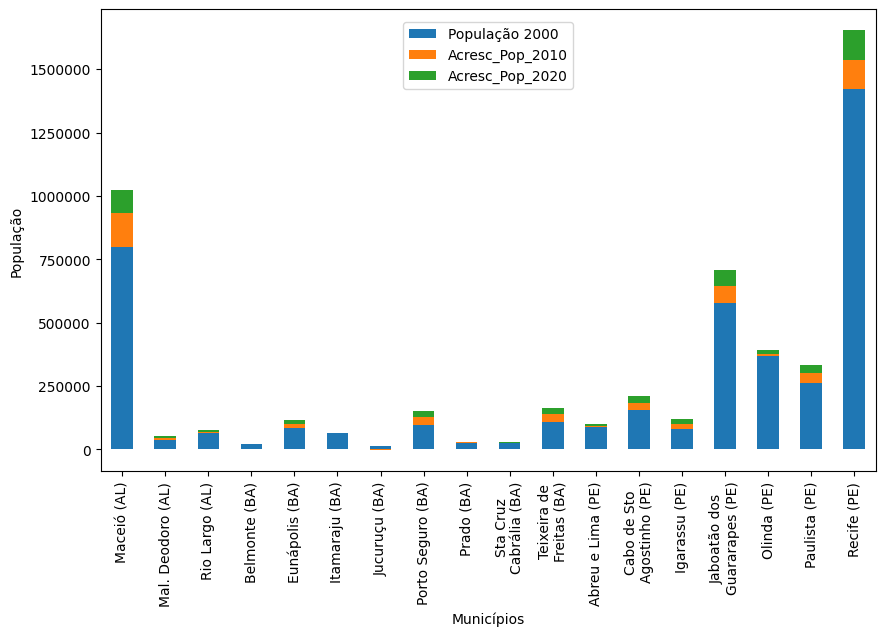

In [248]:
# Criando bar chart empilhado com total populacional e acréscimo populacional agregado por municipios de um estado

ax = pop_growth_df.plot(x="nome_municipio", y=["População 2000", "Acresc_Pop_2010", "Acresc_Pop_2020"], kind="bar", rot=0, stacked=True)

# set the tick labels using the new labels dictionary
ax.set_xticklabels([X_labels.get(label.get_text(), label.get_text()) for label in ax.get_xticklabels()])

_ = ax.legend(bbox_to_anchor=(.5,.9), loc='center')
_ = plt.xticks(rotation=90)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('População')
plt.xlabel('Municípios')

save_graph('Bar_Tamanho e Crescimento Populacional','Municipios')

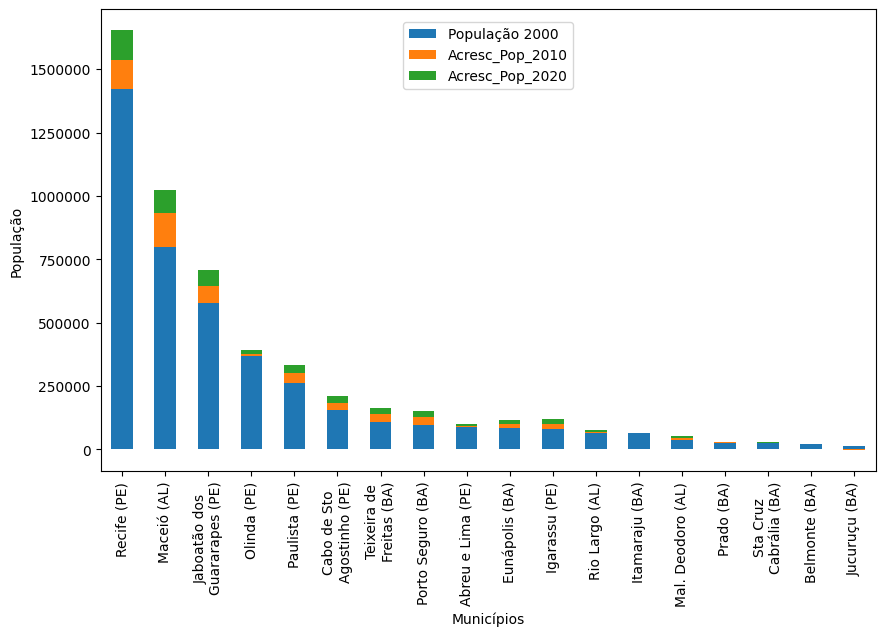

In [249]:
# Criando bar chart empilhado com total populacional e acréscimo populacional em ordem decrescente

sorted_df = pop_growth_df.sort_values('População 2000', ascending=False)

ax = sorted_df.plot(x="nome_municipio", y=["População 2000", "Acresc_Pop_2010", "Acresc_Pop_2020"], kind="bar", rot=0, stacked=True)

ax.set_xticklabels([X_labels.get(label.get_text(), label.get_text()) for label in ax.get_xticklabels()])

_ = ax.legend(bbox_to_anchor=(.5,.9), loc='center')
_ = plt.xticks(rotation=90)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('População')
plt.xlabel('Municípios')

save_graph('Bar_Tamanho e Cresc Popluacional Ordenado', 'Municipios')

#### Plots: DF_População_Municipios

Gráficos Pizza Perfil População: Sexo (O.K.)

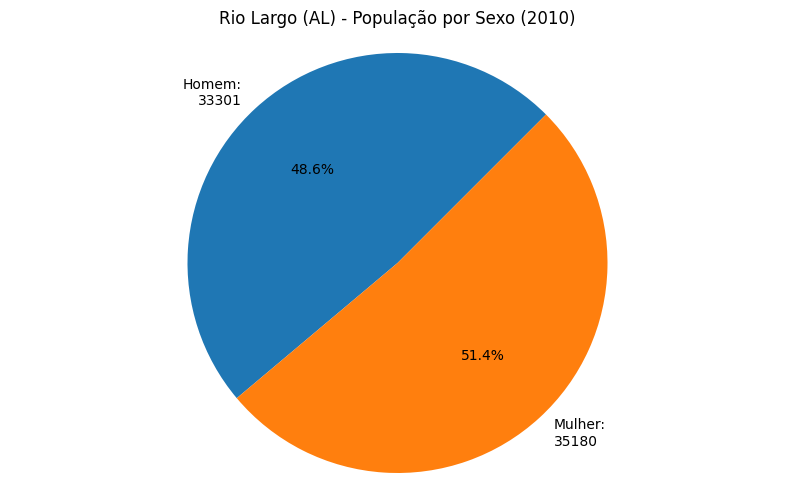

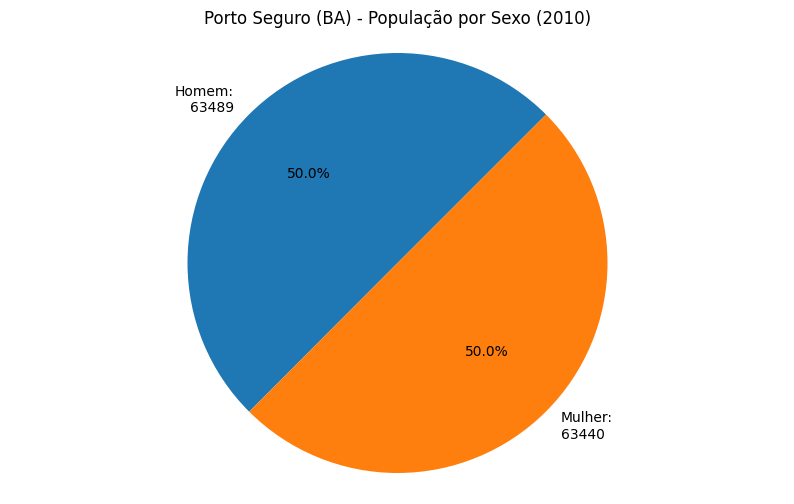

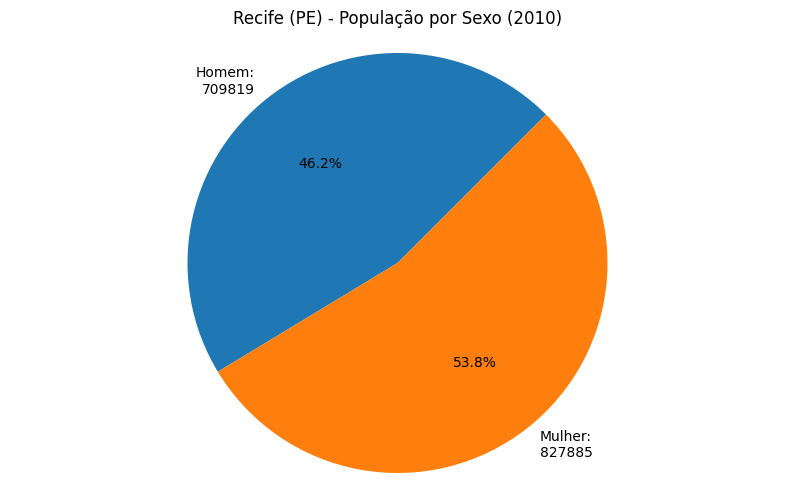

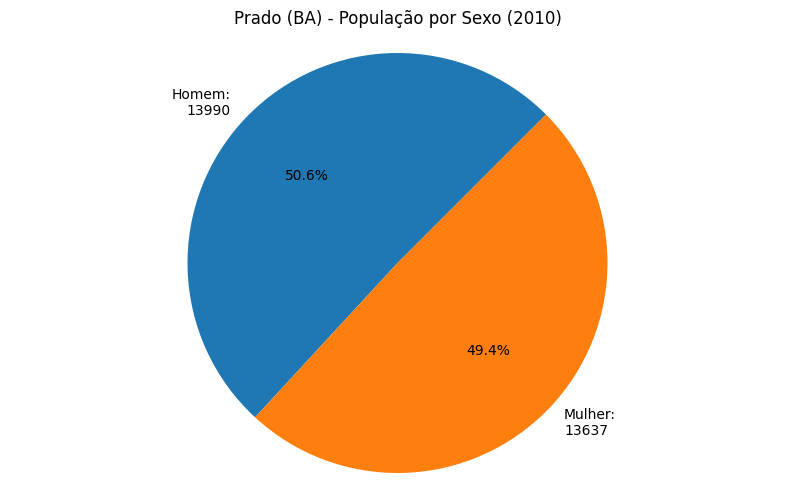

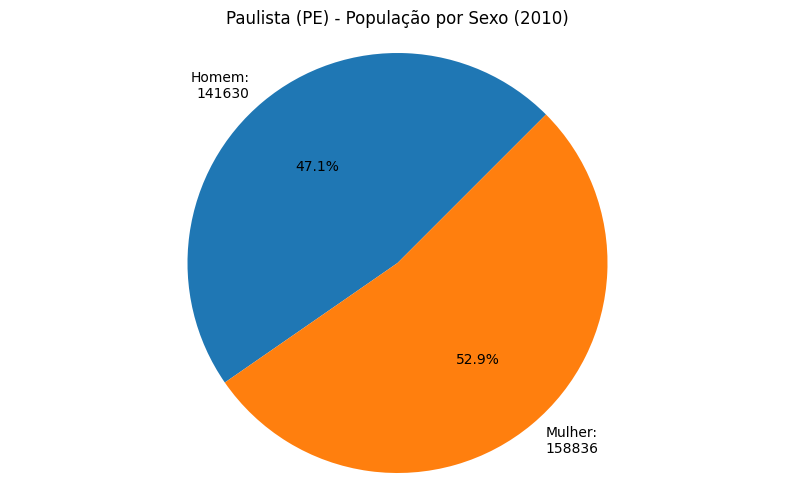

...

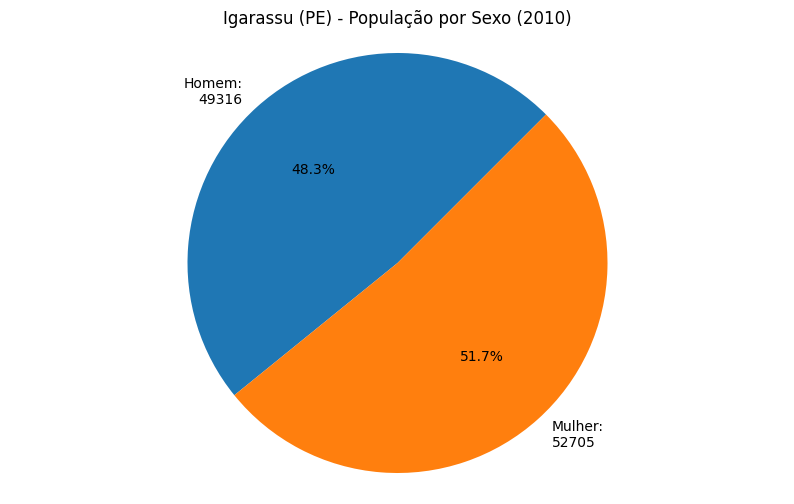

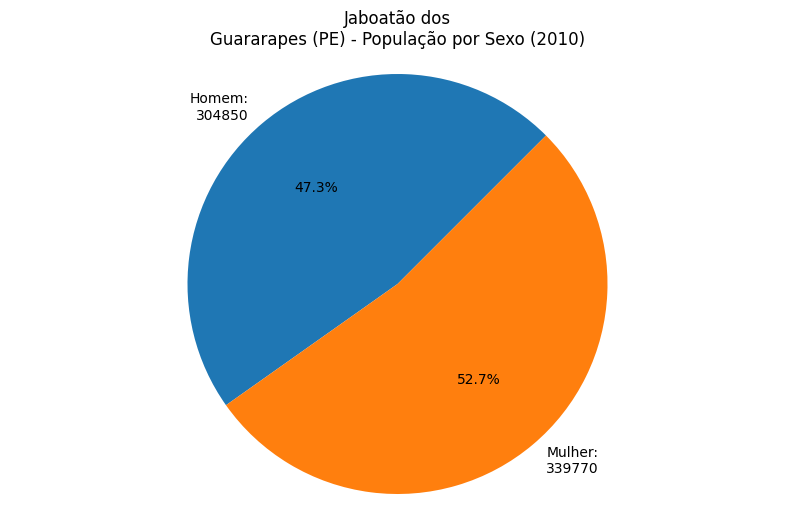

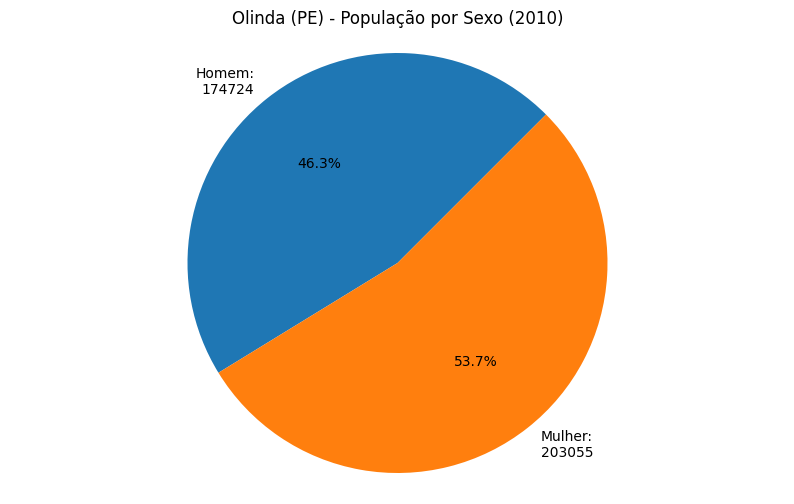

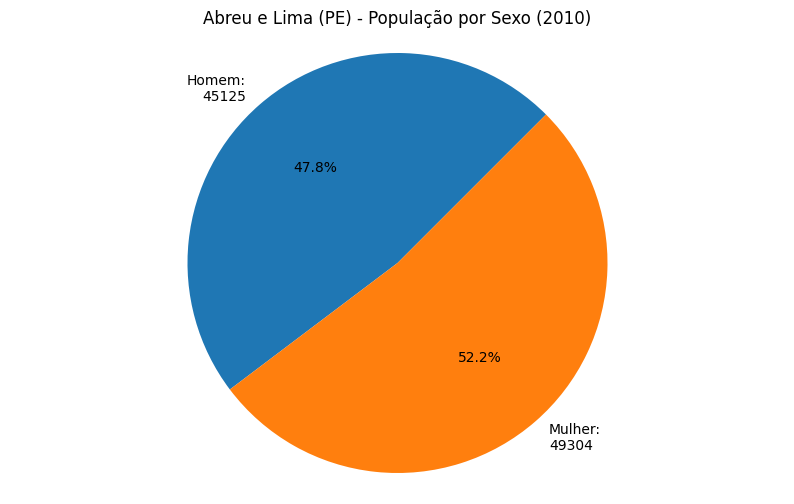

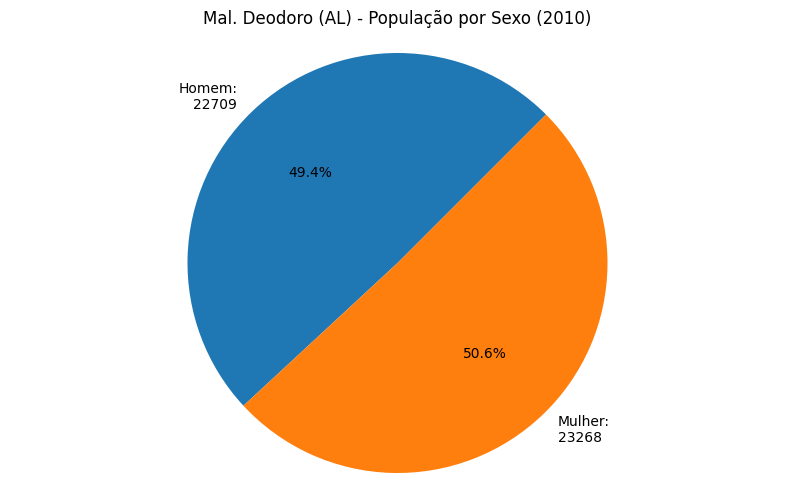

In [250]:
# Filtrando df e montando pop_sexo_df para gráfico
df = DF_População_Municipios[[
                             'nome_municipio',
                             'Cor', 'Sexo', 'Situação de Domicílio',
                             'População 2010'
                              ]]

df = df[(df['Cor'] == 'Total Cor') & (df['Situação de Domicílio'] == 'Total Situação de Domicílio') & ((df['Sexo'] == 'Mulher') | (df['Sexo'] == 'Homem'))  ]
df.drop(['Cor', 'Situação de Domicílio'], axis = 1, inplace = True )

# replace the values in the 'nome_municipio' column
df['nome_municipio'] = df['nome_municipio'].replace(X_labels)

df['População 2010'] = df['População 2010'].apply(lambda x: pd.to_numeric(x, errors='coerce'))

# Loop de criação dos pie charts para pop_sexo_df
set_munic = set(df['nome_municipio'].tolist())


for municipio in set_munic:
    pop_sexo_df = df[df['nome_municipio'] == municipio].pivot(index='nome_municipio', columns='Sexo', values='População 2010')
    
    homem_pop = pop_sexo_df['Homem'][0]
    mulher_pop = pop_sexo_df['Mulher'][0]
    
    labels = [f'Homem:\n{pop_sexo_df["Homem"][0]}', f'Mulher:\n{pop_sexo_df["Mulher"][0]}']
    sizes = [homem_pop, mulher_pop]
    
    fig1, ax1 = plt.subplots()
    ax1.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=45)
    ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
    plt.title(f"{municipio} - População por Sexo (2010)")
    
    save_graph('Pie_Pop por Sexo 2010', municipio)

    plt.show()


Gráficos Pizza Perfil População: Cor (O.K)

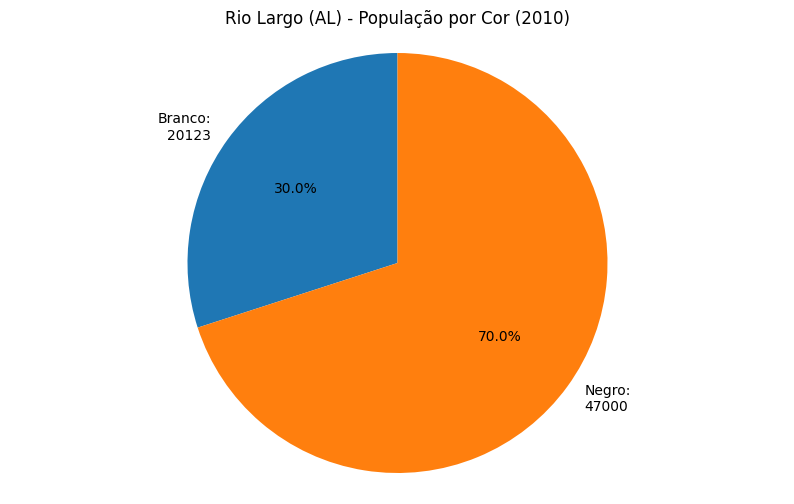

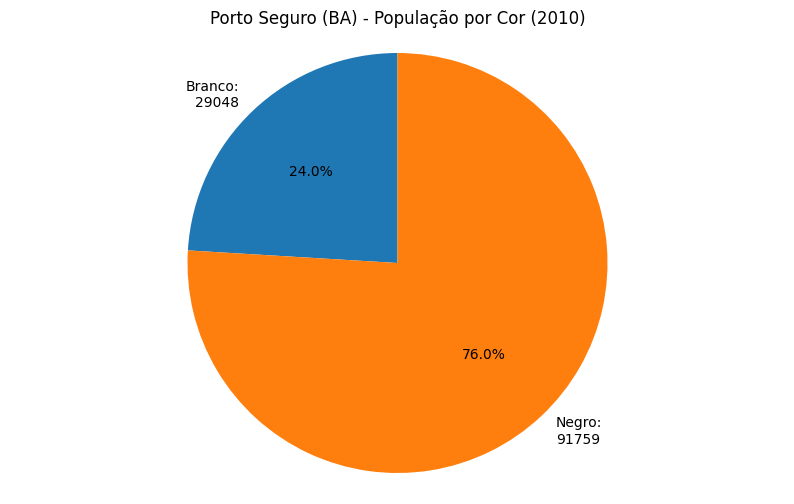

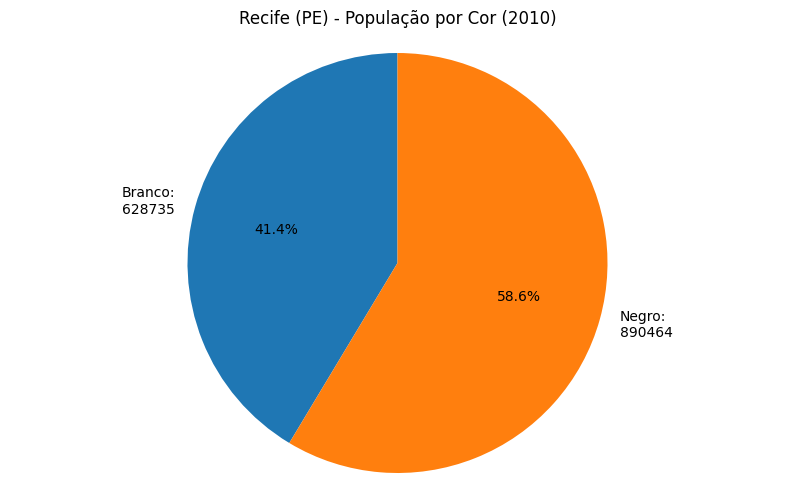

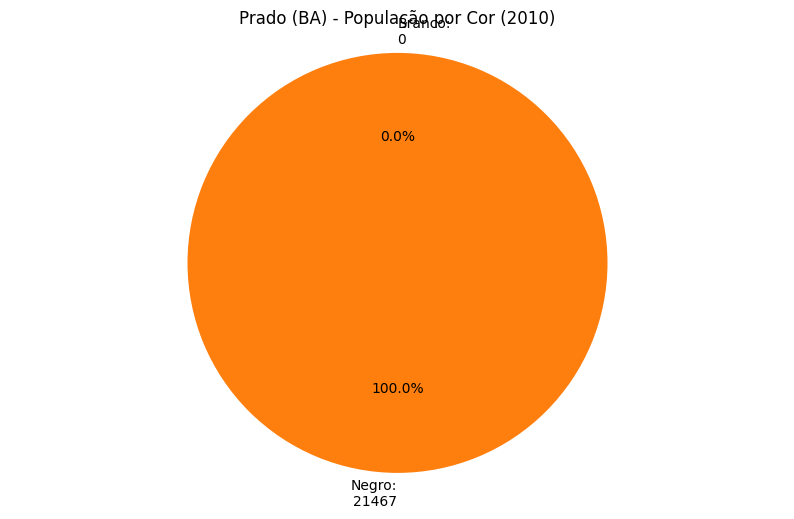

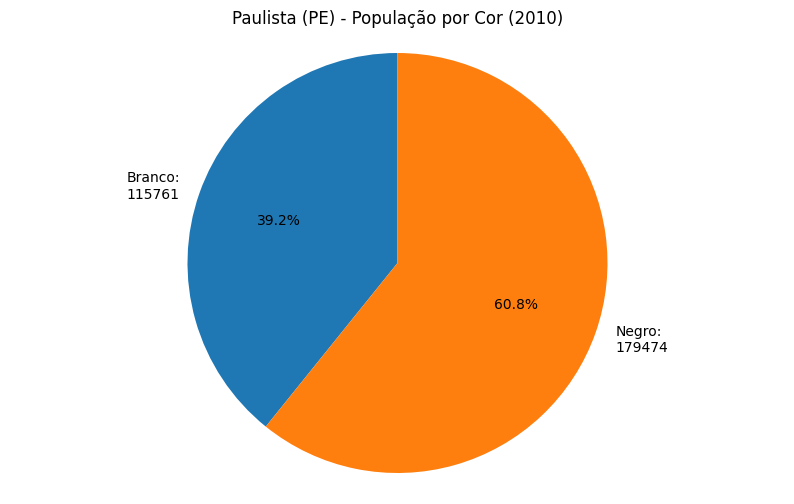

...

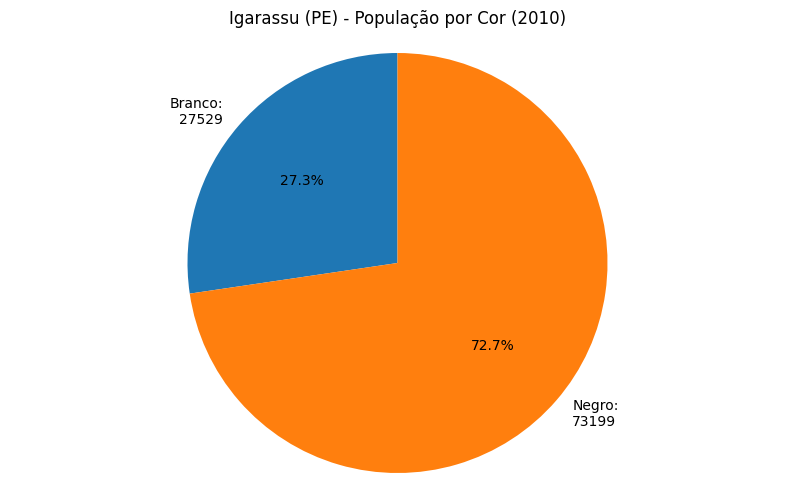

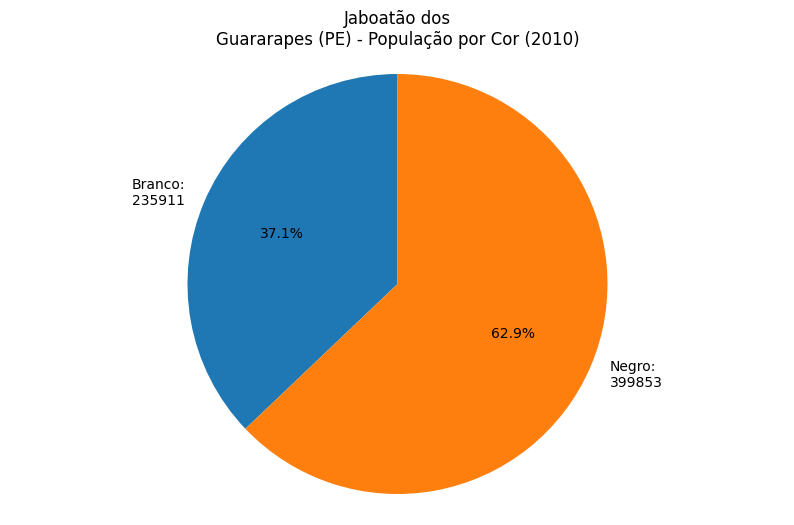

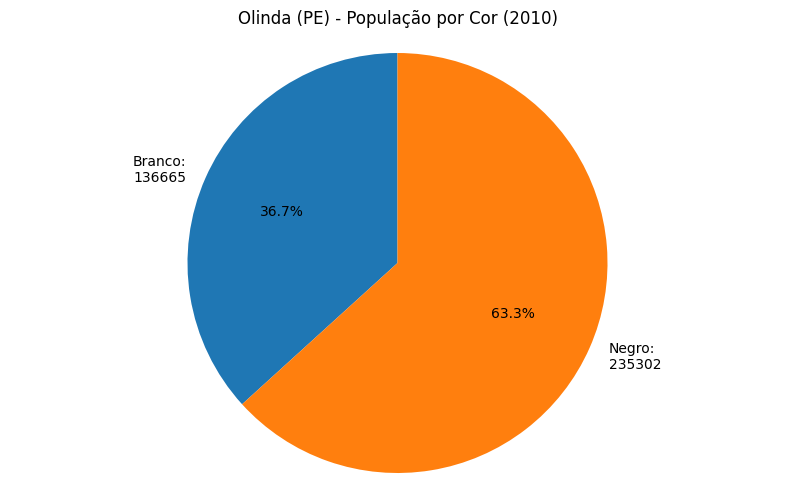

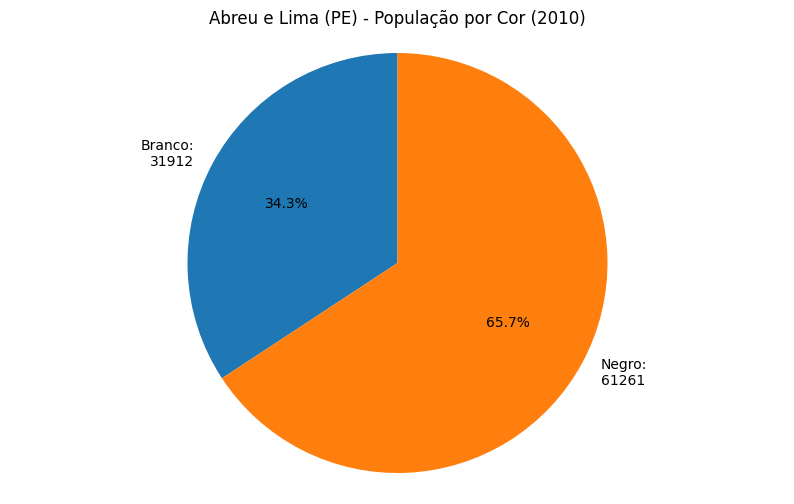

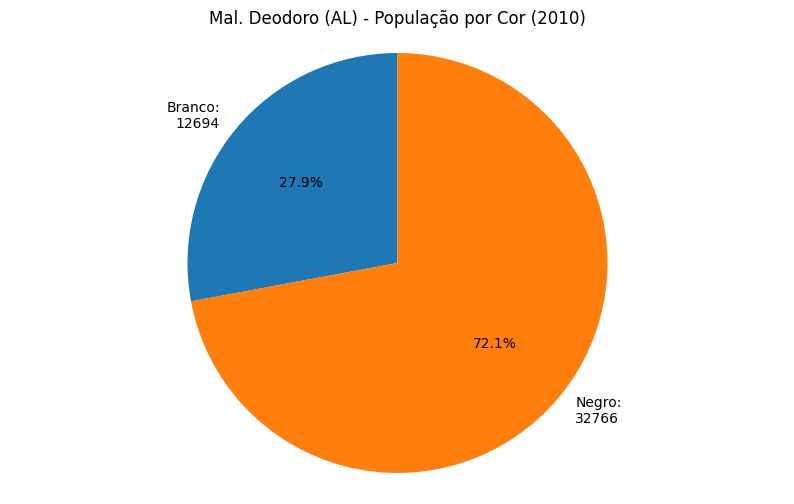

In [251]:
# Filtrando df e montando pop_cor_df para gráfico
df = DF_População_Municipios[[
                             'nome_municipio',
                             'Cor', 'Sexo', 'Situação de Domicílio',
                             'População 2010'
                              ]]

df = df[(df['Sexo'] == 'Total Sexo') & (df['Situação de Domicílio'] == 'Total Situação de Domicílio') & ((df['Cor'] == 'Negro') | (df['Cor'] == 'Branco'))  ]
df.drop(['Sexo', 'Situação de Domicílio'], axis = 1, inplace = True )
df['População 2010'] = df['População 2010'].replace('-', 0)

# replace the values in the 'nome_municipio' column
df['nome_municipio'] = df['nome_municipio'].replace(X_labels)
# Transforma object em int dtype
df['População 2010'] = df['População 2010'].apply(lambda x: pd.to_numeric(x, errors='coerce'))

# Loop de criação dos pie charts para pop_cor_df
set_munic = set(df['nome_municipio'].tolist())

for municipio in set_munic:
    pop_sexo_df = df[df['nome_municipio'] == municipio].pivot(index='nome_municipio', columns='Cor', values='População 2010')
    
    homem_pop = pop_sexo_df['Branco'][0]
    mulher_pop = pop_sexo_df['Negro'][0]
    
    labels = [f'Branco:\n{pop_sexo_df["Branco"][0]}', f'Negro:\n{pop_sexo_df["Negro"][0]}']
    sizes = [homem_pop, mulher_pop]
    
    fig1, ax1 = plt.subplots()
    ax1.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90)
    ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
    plt.title(f"{municipio} - População por Cor (2010)")
    
    save_graph('Pie_Pop por Cor 2010', municipio)

    plt.show()

Gráficos Pizza Perfil População: Situação Domiciliar (O.K.)

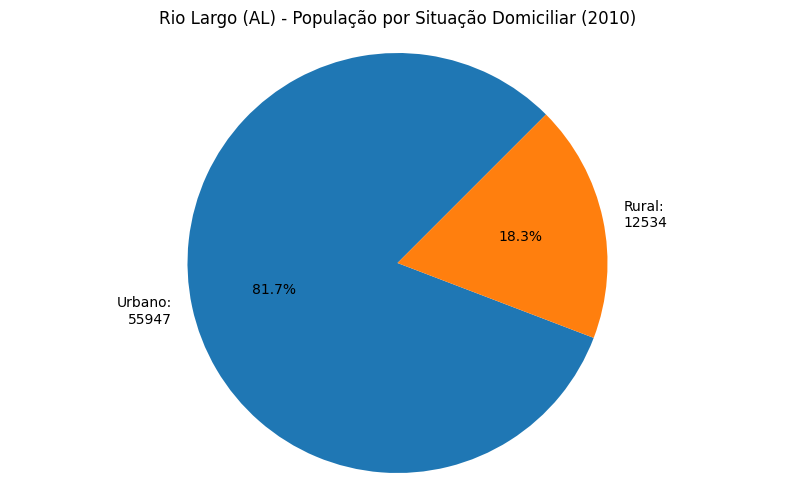

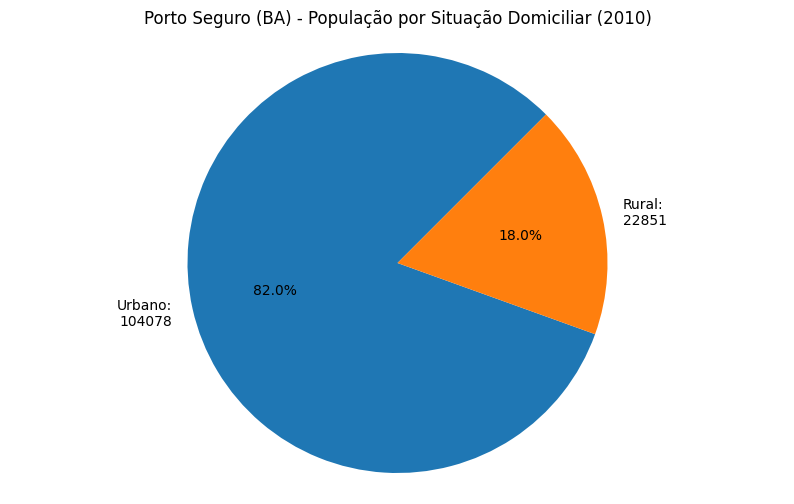

Recife (PE) pie chart failed. Added to Errors_list


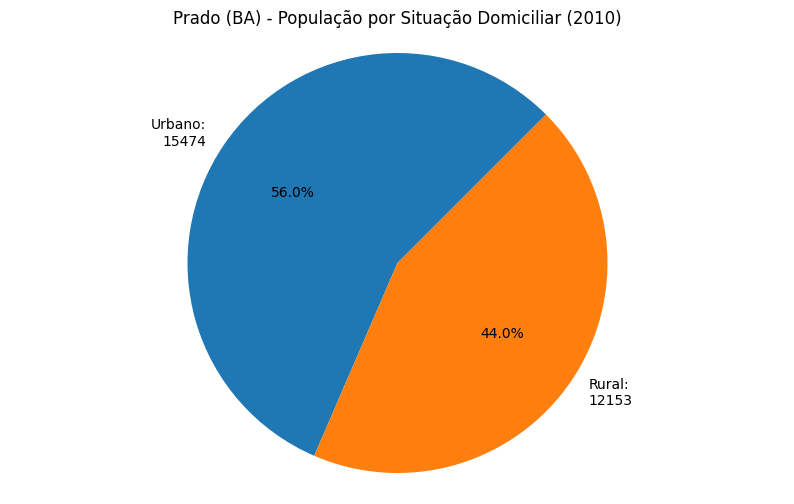

Paulista (PE) pie chart failed. Added to Errors_list


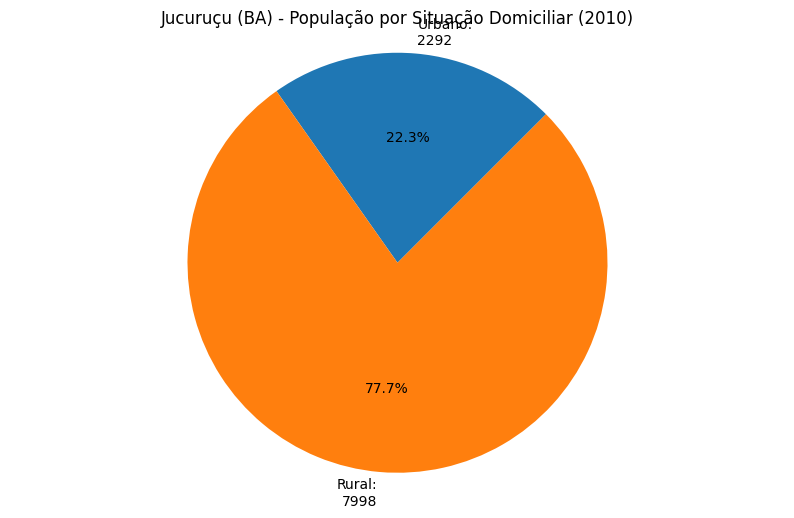

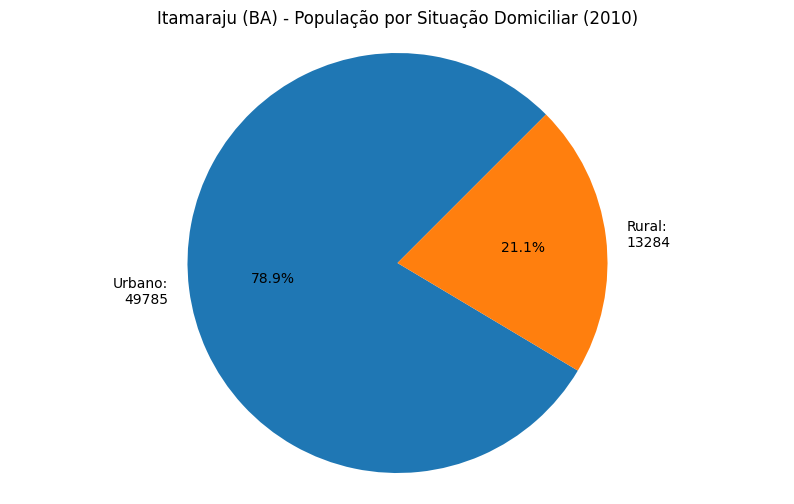

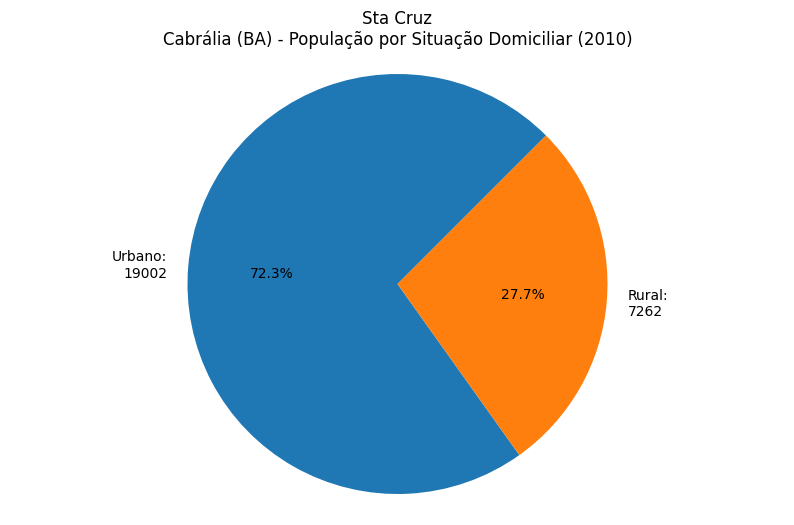

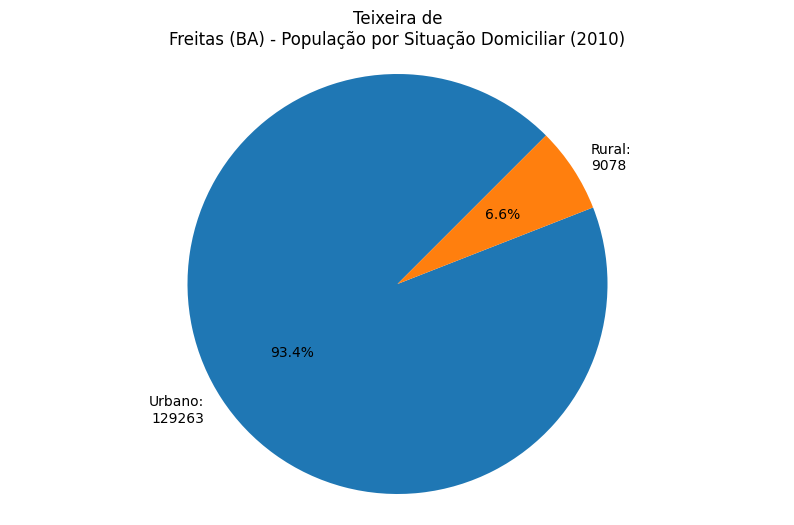

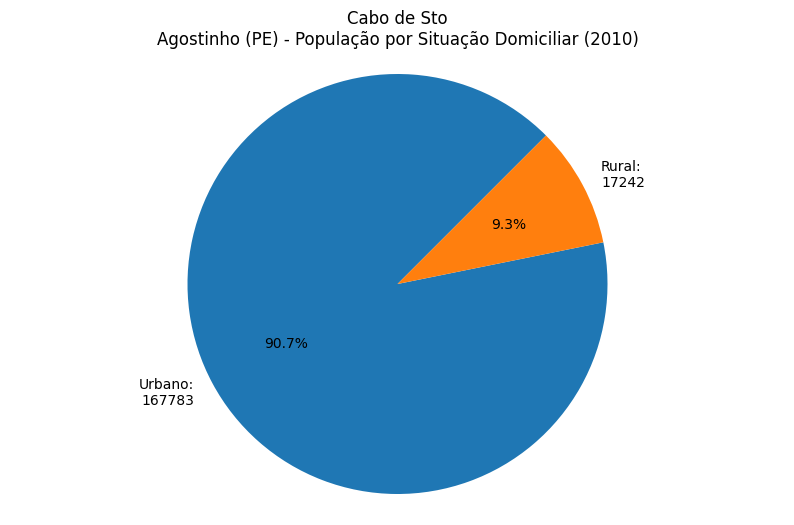

...

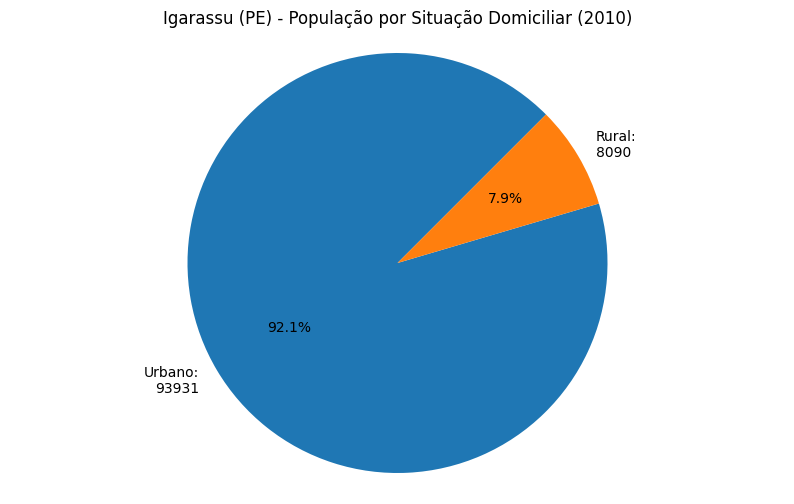

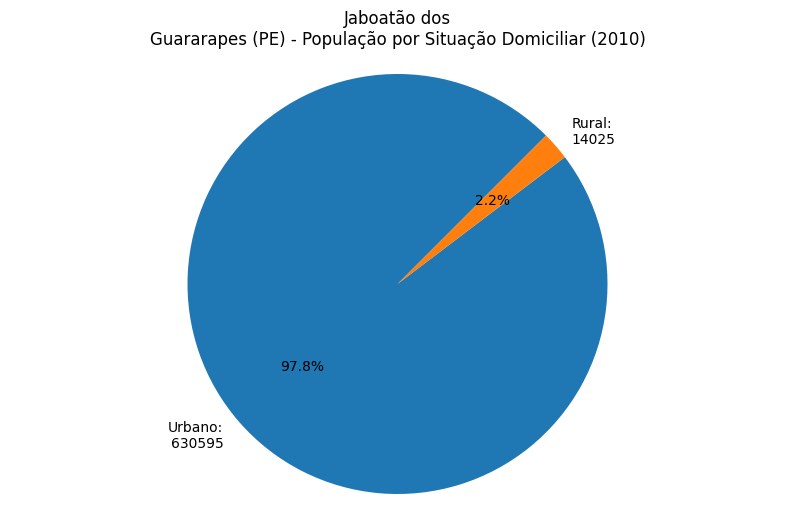

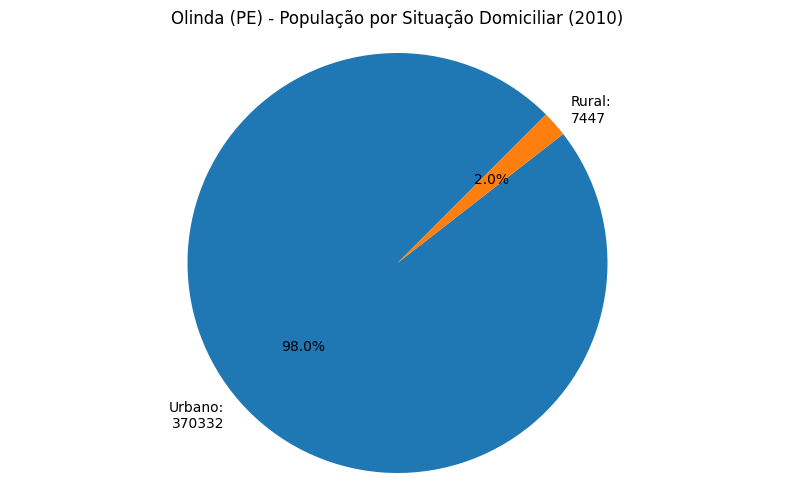

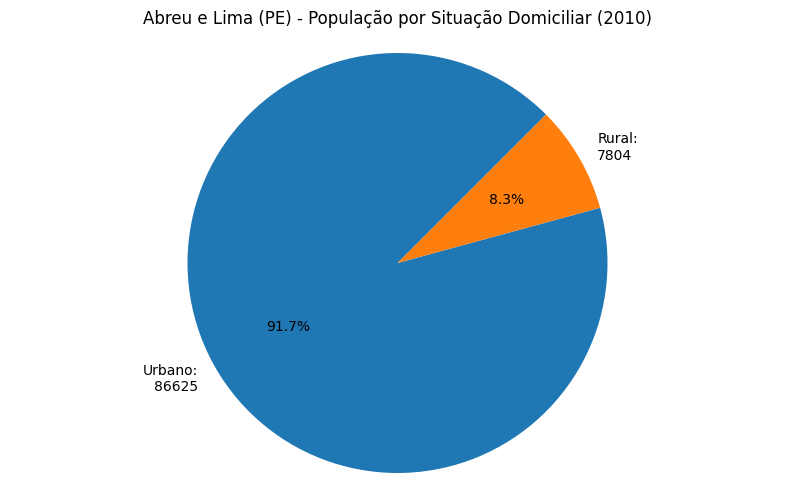

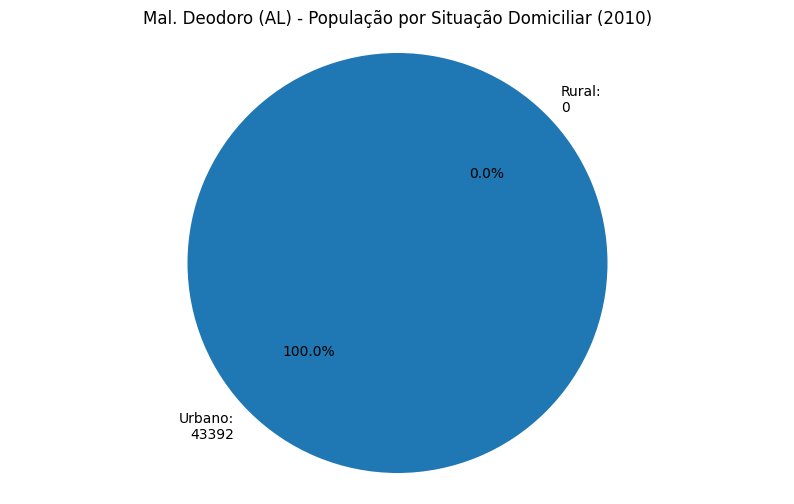

In [252]:
# Filtrando df e montando pop_situ_domic_df para gráfico
df = DF_População_Municipios[[
                             'nome_municipio',
                             'Cor', 'Sexo', 'Situação de Domicílio',
                             'População 2010'
                              ]]

df = df[(df['Sexo'] == 'Total Sexo') & (df['Cor'] == 'Total Cor') & ((df['Situação de Domicílio'] == 'Urbano') | (df['Situação de Domicílio'] == 'Rural'))  ]
df.drop(['Sexo', 'Cor'], axis = 1, inplace = True )
df['População 2010'] = df['População 2010'].replace('-', 0)

# Loop de criação dos pie charts para pop_situ_domic_df
set_munic = set(df['nome_municipio'].tolist())

# replace the values in the 'nome_municipio' column
df['nome_municipio'] = df['nome_municipio'].replace(X_labels)
# Transforma object em int dtype
df['População 2010'] = df['População 2010'].apply(lambda x: pd.to_numeric(x, errors='coerce'))

# Loop de criação dos pie charts para pop_cor_df
set_munic = set(df['nome_municipio'].tolist())

Errors_list.clear()

for municipio in set_munic:
    try:
        pop_sexo_df = df[df['nome_municipio'] == municipio].pivot(index='nome_municipio', columns='Situação de Domicílio', values='População 2010')
        homem_pop = pop_sexo_df['Urbano'][0]
        mulher_pop = pop_sexo_df['Rural'][0]
    except:
        print(f'{municipio} pie chart failed. Added to Errors_list')
    else:
        labels = [f'Urbano:\n{pop_sexo_df["Urbano"][0]}', f'Rural:\n{pop_sexo_df["Rural"][0]}']
        sizes = [homem_pop, mulher_pop]
        
        fig1, ax1 = plt.subplots()
        ax1.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=45)
        ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
        plt.title(f"{municipio} - População por Situação Domiciliar (2010)")
        
        save_graph('Pie_Pop por Situação Domiciliar 2010', municipio)

        plt.show()

## Gráficos Educação

#### Plots: DF_Dados_Educação_Censo_91_10_AL_BA_PE

Gráfico Municipal segmentação educacional da população dos municípios 1991-2010 (O.K)


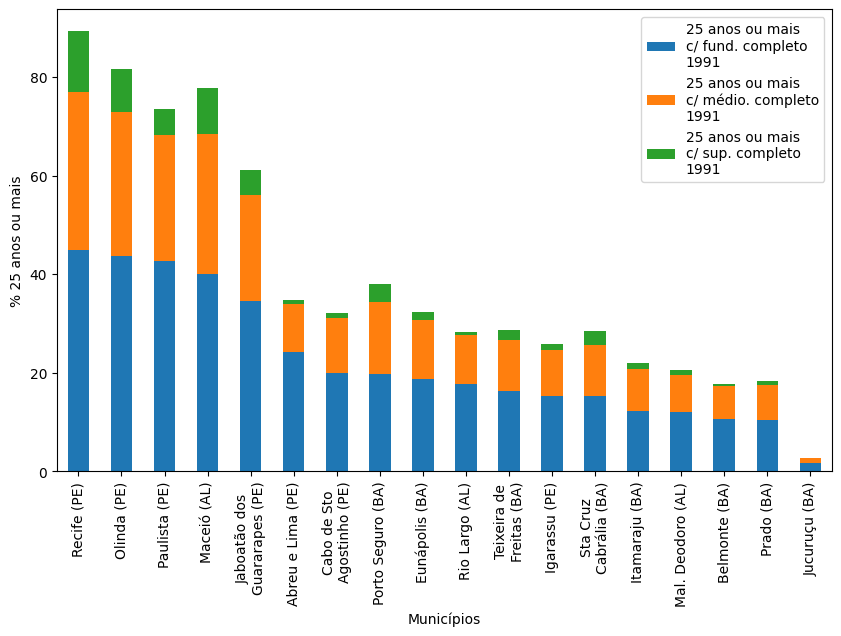

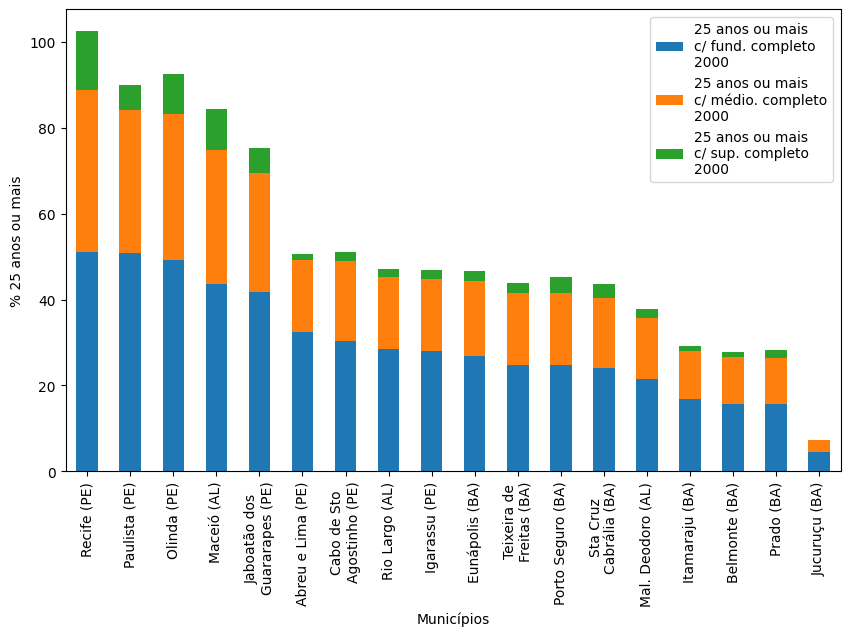

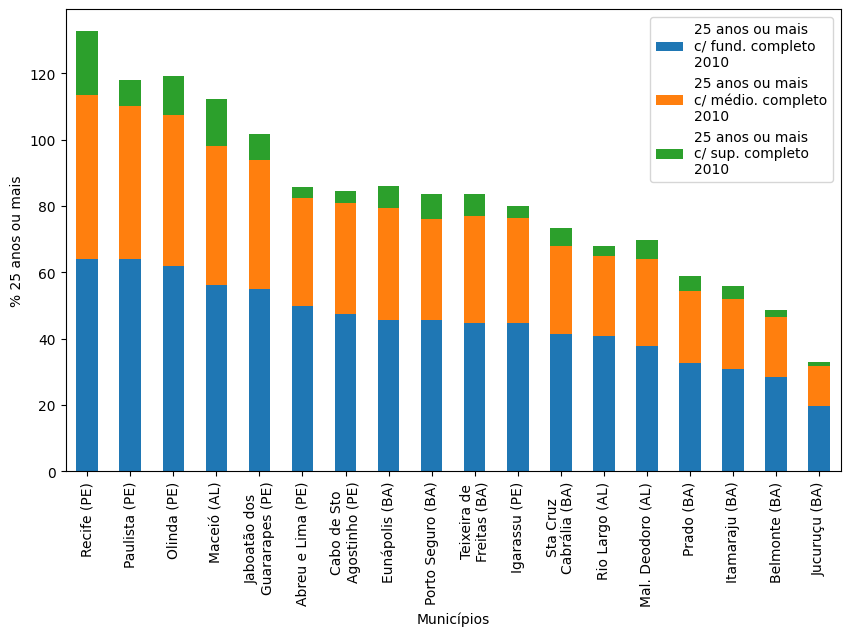

In [253]:
#Criando df para gráfico de estrutura educacional dos municípios comparados

df = DF_Dados_Educação_Censo_91_10_AL_BA_PE

df = df[[
        'nome_municipio',
        '% de 25 anos ou mais de idade com ensino fundamental completo 1991',
        '% de 25 anos ou mais de idade com ensino fundamental completo 2000', 
        '% de 25 anos ou mais de idade com ensino fundamental completo 2010',
        '% de 25 anos ou mais de idade com ensino médio completo 1991',       
        '% de 25 anos ou mais de idade com ensino médio completo 2000',
        '% de 25 anos ou mais de idade com ensino médio completo 2010',      
        '% de 25 anos ou mais de idade com ensino superior completo 1991',    
        '% de 25 anos ou mais de idade com ensino superior completo 2000',   
        '% de 25 anos ou mais de idade com ensino superior completo 2010'   
        ]]

# Filtrando apenas municipios do projeto
df = df[(df['nome_municipio'].isin(Municipios))]

# Diminuindo nomes das colunas
var1 = '25 anos ou mais\nc/ fund. completo\n1991'
var2 = '25 anos ou mais\nc/ fund. completo\n2000'
var3 = '25 anos ou mais\nc/ fund. completo\n2010'
var4 = '25 anos ou mais\nc/ médio. completo\n1991'
var5 = '25 anos ou mais\nc/ médio. completo\n2000'
var6 = '25 anos ou mais\nc/ médio. completo\n2010'
var7 = '25 anos ou mais\nc/ sup. completo\n1991'
var8 = '25 anos ou mais\nc/ sup. completo\n2000'
var9 = '25 anos ou mais\nc/ sup. completo\n2010'


cols = [
        var1,
        var2,
        var3,
        var4,
        var5,
        var6,
        var7,
        var8,
        var9
        ]

new_names = {
            '% de 25 anos ou mais de idade com ensino fundamental completo 1991' : var1,
            '% de 25 anos ou mais de idade com ensino fundamental completo 2000' : var2,
            '% de 25 anos ou mais de idade com ensino fundamental completo 2010' : var3,
            '% de 25 anos ou mais de idade com ensino médio completo 1991'       : var4,
            '% de 25 anos ou mais de idade com ensino médio completo 2000'       : var5,
            '% de 25 anos ou mais de idade com ensino médio completo 2010'       : var6,
            '% de 25 anos ou mais de idade com ensino superior completo 1991'    : var7,
            '% de 25 anos ou mais de idade com ensino superior completo 2000'    : var8,
            '% de 25 anos ou mais de idade com ensino superior completo 2010'    : var9
            }
df = df.rename(columns = new_names)

# Transforma nomes em 'nome_municipio'
df['nome_municipio'] = df['nome_municipio'].replace(X_labels)
# Transforma object em int dtype
df[cols].apply(lambda x: pd.to_numeric(x, errors='coerce'))

# Produzindo gráfico de barras empilhado com níveis por municípios para 1991

df = df.sort_values(var1, ascending=False)
ax = df.plot(x="nome_municipio", y=[
                                    var1, 
                                    var4, 
                                    var7
                                    ], kind="bar", rot=0, stacked=True)
_ = ax.legend(bbox_to_anchor=(.745,.998), loc='upper left')
_ = plt.xticks(rotation=90)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('% 25 anos ou mais')
plt.xlabel('Municípios')

save_graph('Bar_Perfil Educacional da População 1991', 'Municipios')

# Produzindo gráfico de barras empilhado com níveis por municípios para 2000

df = df.sort_values(var2, ascending=False)
ax = df.plot(x="nome_municipio", y=[
                                    var2, 
                                    var5, 
                                    var8
                                    ], kind="bar", rot=0, stacked=True)
_ = ax.legend(bbox_to_anchor=(.745,.998), loc='upper left')
_ = plt.xticks(rotation=90)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('% 25 anos ou mais')
plt.xlabel('Municípios')

save_graph('Bar_Perfil Educacional da População 2000', 'Municipios')

# Produzindo gráfico de barras empilhado com níveis por municípios para 2010
df = df.sort_values(var3, ascending=False)
ax = df.plot(x="nome_municipio", y=[
                                    var3,
                                    var6, 
                                    var9
                                    ], kind="bar", rot=0, stacked=True)
_ = ax.legend(bbox_to_anchor=(.745,.998), loc='upper left')
_ = plt.xticks(rotation=90)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('% 25 anos ou mais')
plt.xlabel('Municípios')

save_graph('Bar_Perfil Educacional da População 2010', 'Municipios')





Gráfico Comparado expectativa de anos de estudo aos 18 anos entre 1991 e 2010 (O.K.)

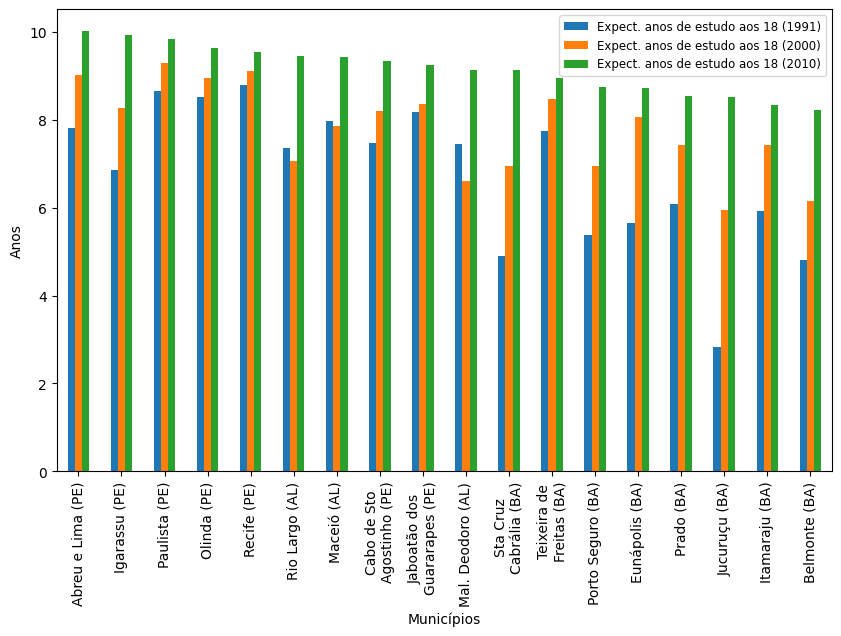

In [254]:
# Criando df para expectativa de anos de estudo aos 18 anos entre 1991 e 2010

df = DF_Dados_Educação_Censo_91_10_AL_BA_PE

df = df[[
        'nome_municipio',
        'Expectativa de anos de estudo aos 18 anos de idade 1991',
        'Expectativa de anos de estudo aos 18 anos de idade 2000',
        'Expectativa de anos de estudo aos 18 anos de idade 2010'
                                        ]]

# Filtrando apenas municipios do projeto
df = df[(df['nome_municipio'].isin(Municipios))]

# Diminuindo nomes das colunas
new_names = {
            'Expectativa de anos de estudo aos 18 anos de idade 1991' : 'Expect. anos de estudo aos 18 (1991)',
            'Expectativa de anos de estudo aos 18 anos de idade 2000' : 'Expect. anos de estudo aos 18 (2000)',
            'Expectativa de anos de estudo aos 18 anos de idade 2010' : 'Expect. anos de estudo aos 18 (2010)'
            }
df = df.rename(columns = new_names)

# Transforma nomes em 'nome_municipio'
df['nome_municipio'] = df['nome_municipio'].replace(X_labels)
# # Transforma object em int dtype
# df[cols].apply(lambda x: pd.to_numeric(x, errors='coerce'))

# Criando gráfico de barras agregadas por municípios em ordem decrescente
sorted_df = df.sort_values('Expect. anos de estudo aos 18 (2010)', ascending=False)
sorted_df.plot(kind='bar', figsize=(10,6), x = 'nome_municipio')
plt.ylabel('Anos')
plt.xlabel('Municípios')
plt.legend(loc='best', prop = {'size' :8.5})

save_graph('Bar_ Expect Anos de Estudo 91-2010', 'Municipios')



#### Plots: DF_Educação_Municipios

Preparando DF

In [255]:
df = DF_Educação_Municipios

Educação_Jovens_2010_df = df[[
                            'nome_municipio',
                            '% de 0 a 5 anos de idade na escola 2010',
                            '% de 5 a 6 anos na escola',
                            '% de 6 a 14 anos de idade na escola 2010',                            
                            '% de 11 a 13 anos nos anos finais do fundamental ou com fundamental completo',
                            '% de 15 a 17 anos com fundamental completo',
                            '% de 15 a 17 anos de idade na escola 2010',
                            '% de 18 a 20 anos com médio completo',
                            '% de 18 anos ou mais com fundamental completo',
                             ]]

new_names = {
            '% de 0 a 5 anos de idade na escola 2010'  : '%_0_a_5_na_escola',
            '% de 5 a 6 anos na escola'                : '%_5_a_6_na_escola',
            '% de 6 a 14 anos de idade na escola 2010' : '%_6_a_14_na_escola',
            '% de 15 a 17 anos de idade na escola 2010': '%_15_a_17_na_escola',

            '% de 11 a 13 anos nos anos finais do fundamental ou com fundamental completo': '11 a 13\nfund.completo\nou concluindo',
            '% de 15 a 17 anos com fundamental completo'                                  : '15 a 17\nfund.completo',
            '% de 18 a 20 anos com médio completo'                                        : '18 a 29\nmedio completo',
            '% de 18 anos ou mais com fundamental completo'                               : '18 ou mais\nfund.completo'
            }

Educação_Jovens_2010_df = Educação_Jovens_2010_df.rename(columns = new_names)


Gráfico Municipal % Crianças na Escola (O.K)

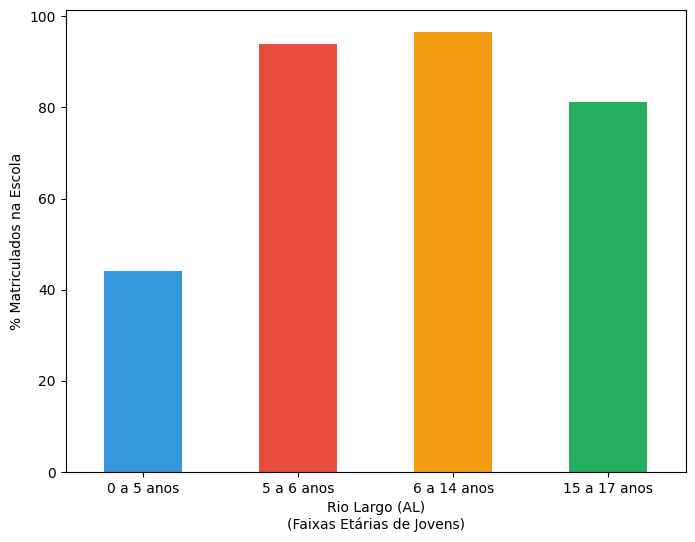

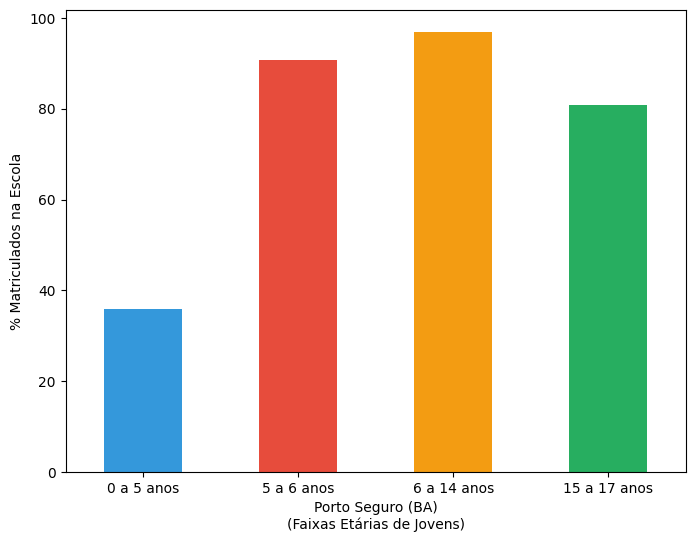

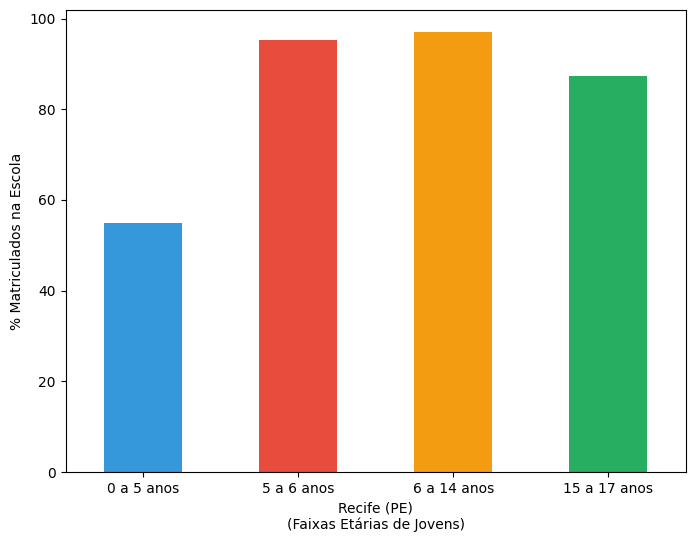

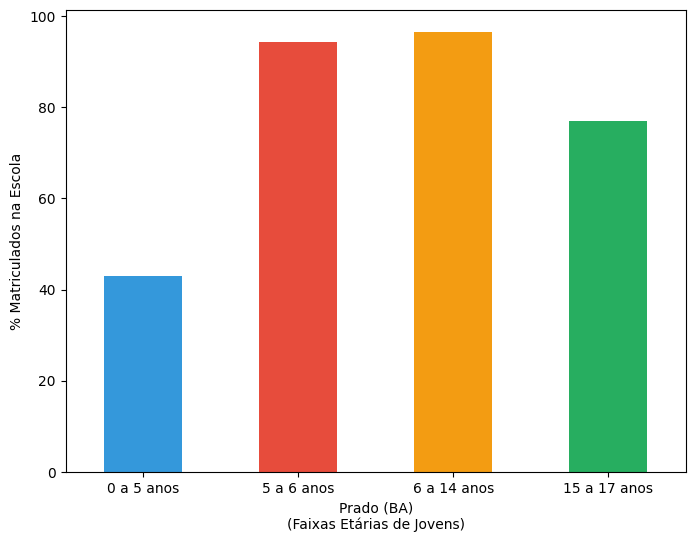

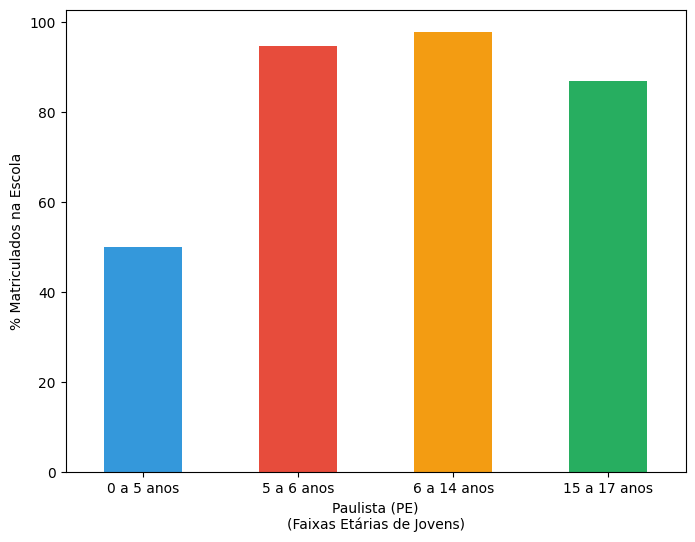

...

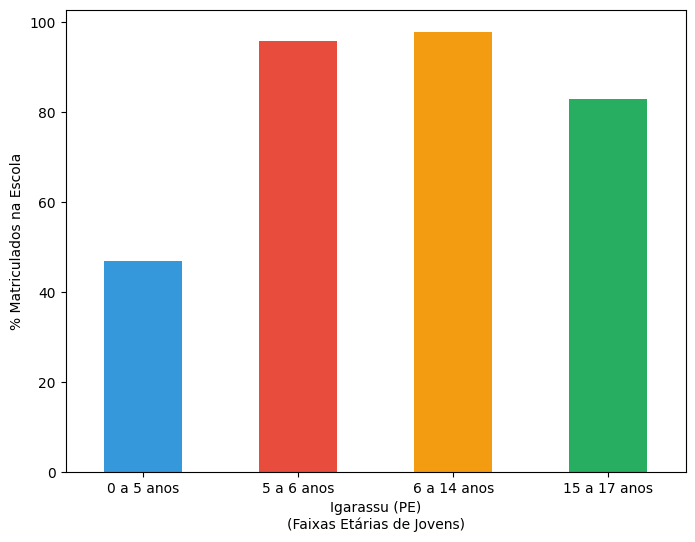

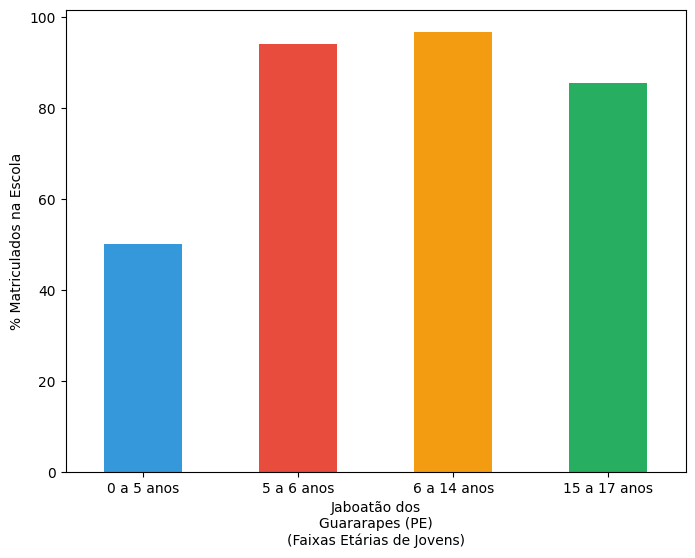

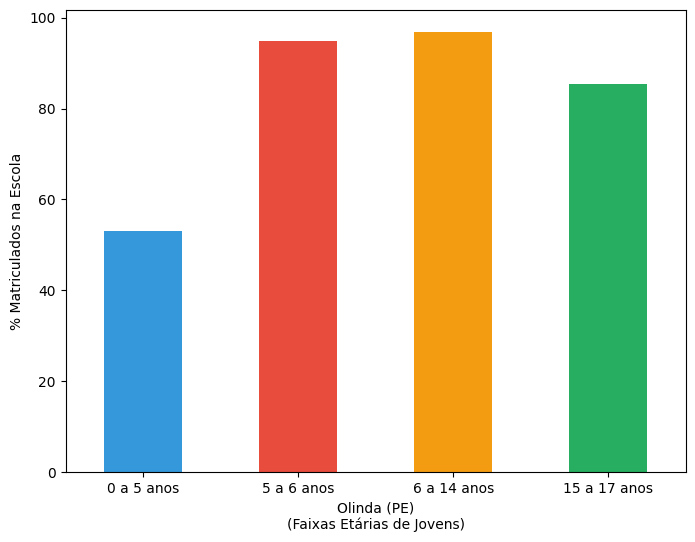

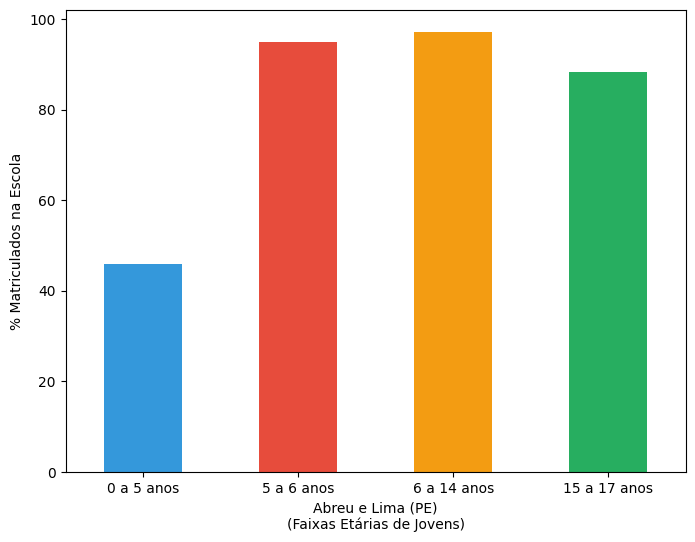

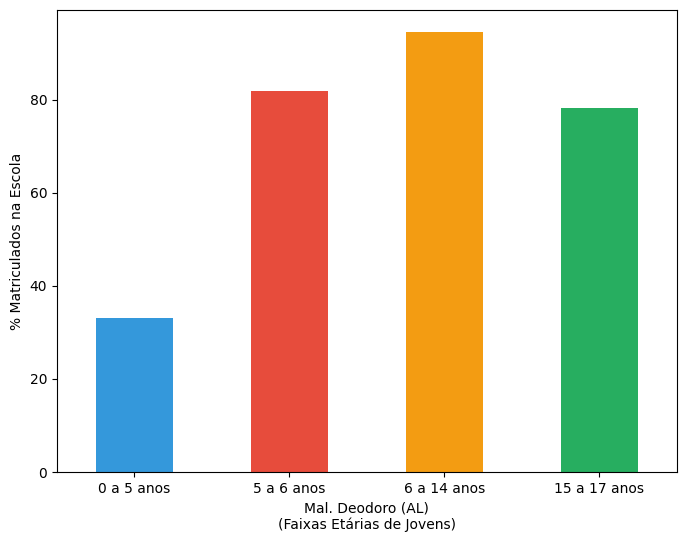

In [256]:
# Produzindo loop de gráfico para % de crianças na escola para cada município

df = Educação_Jovens_2010_df[[
    'nome_municipio',
    '%_0_a_5_na_escola',
    '%_5_a_6_na_escola',
    '%_6_a_14_na_escola',
    '%_15_a_17_na_escola'
]]

new_names = {
            '%_0_a_5_na_escola'  : '0 a 5 anos',
            '%_5_a_6_na_escola'  : '5 a 6 anos',
            '%_6_a_14_na_escola' : '6 a 14 anos',
            '%_15_a_17_na_escola': '15 a 17 anos'
            }
df = df.rename(columns = new_names)

cols = [ '0 a 5 anos',
         '5 a 6 anos',
        '6 a 14 anos',
        '15 a 17 anos']

# Transforma nomes em 'nome_municipio'
df['nome_municipio'] = df['nome_municipio'].replace(X_labels)

# # Transforma object em int dtype
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors='coerce'), axis = 1)

# Loop produz gráficos para cada município no DF
for munic in set_munic:
        dfx = df

        # Filter df with munic
        dfx = dfx[dfx['nome_municipio'] == munic]
        dfx.set_index('nome_municipio')

        # Define colors for the bars
        # colors = [colors] * 4

        # Plot the bar graph
        ax = dfx.iloc[0, 1:].plot(kind='bar', color = [c, m, y, g], figsize=(8, 6))

        # Set the x and y axis labels
        ax.set_xlabel(f'{munic}\n(Faixas Etárias de Jovens)')
        ax.set_ylabel('% Matriculados na Escola')
        plt.xticks(rotation = 0)
        # Save plot to save_path
        save_graph('Bar_% de Jovens na Escola por Faixa Etária', munic)

        # Show the plot
        plt.show()



Gráfico % Grau de Formação dos Jovens (O.K.)

C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\2571272536.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['nome_municipio'] = df['nome_municipio'].replace(X_labels)
C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\2571272536.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors='coerce'), axis = 1)


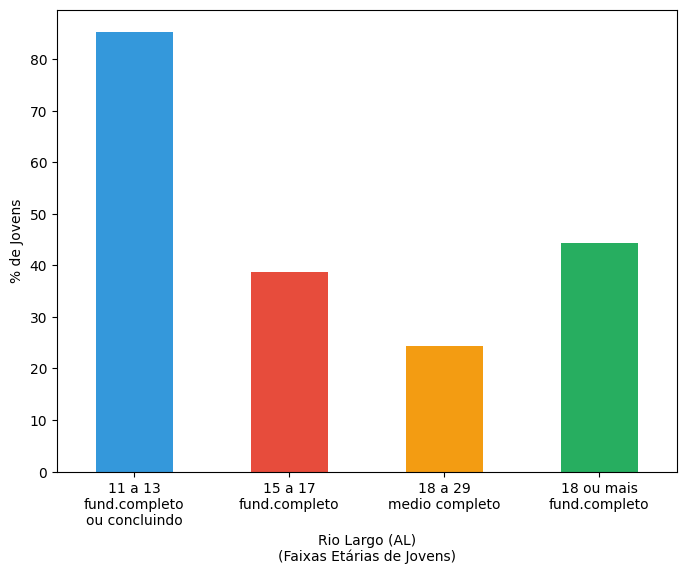

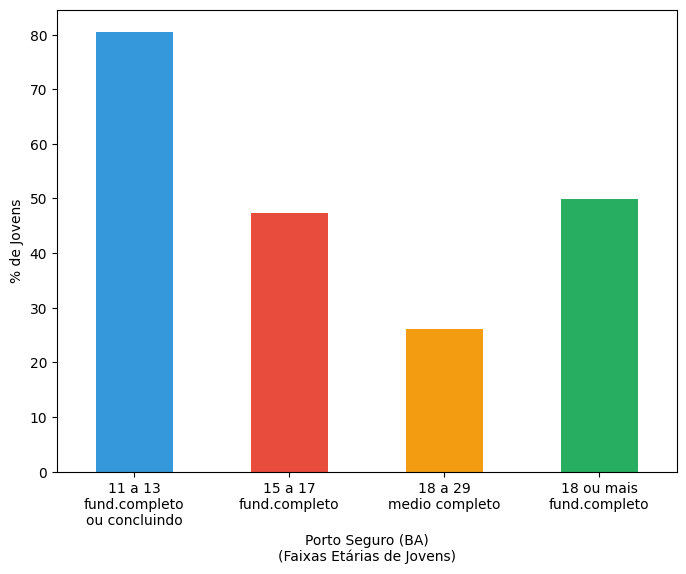

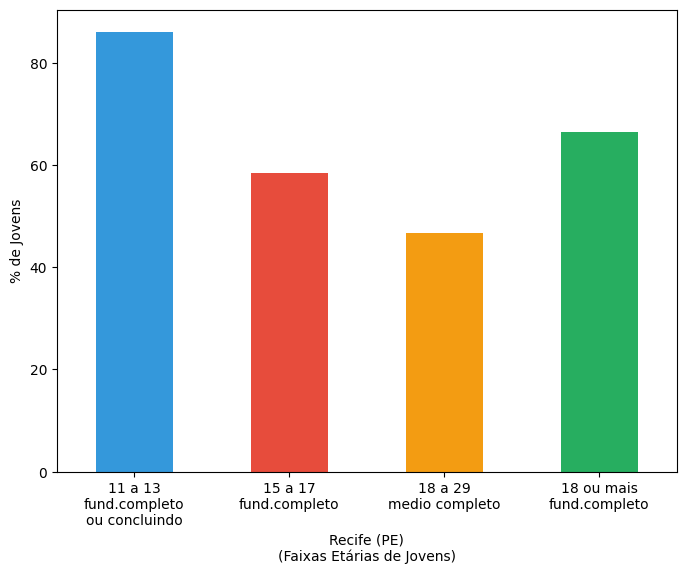

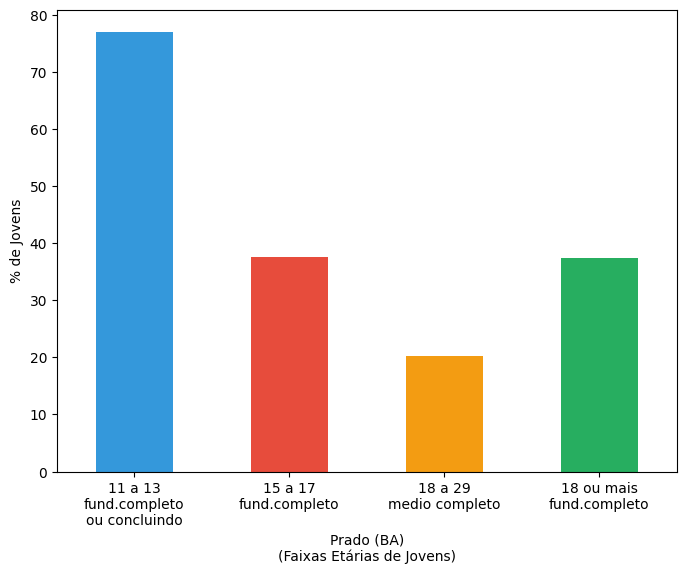

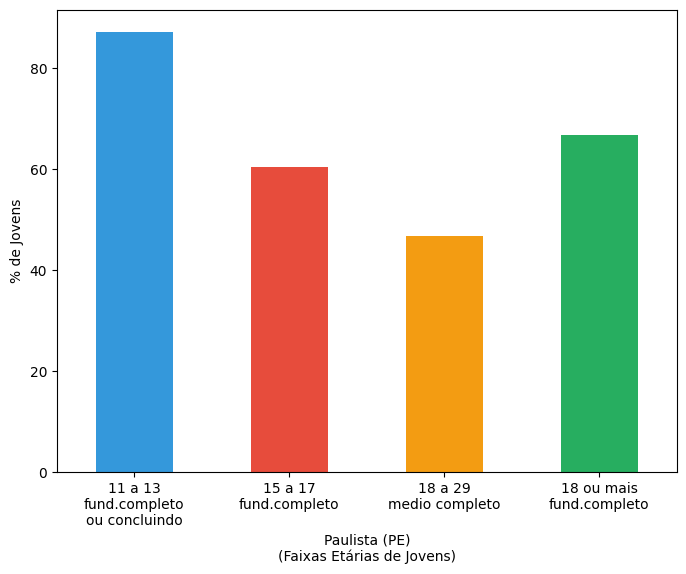

...

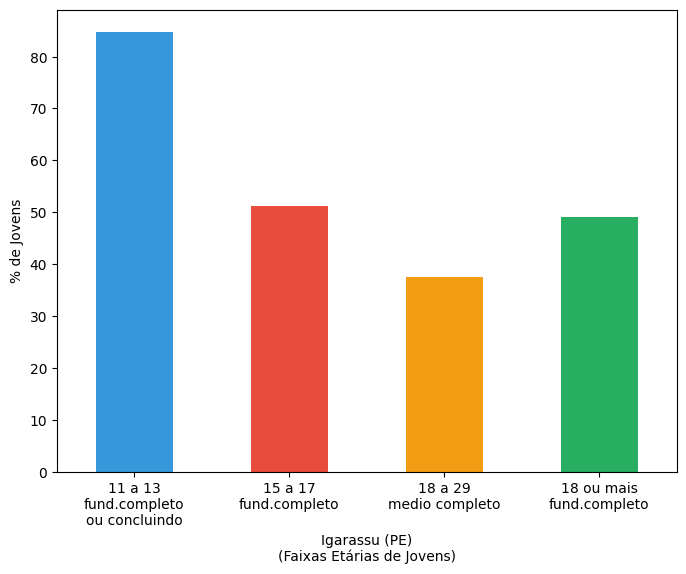

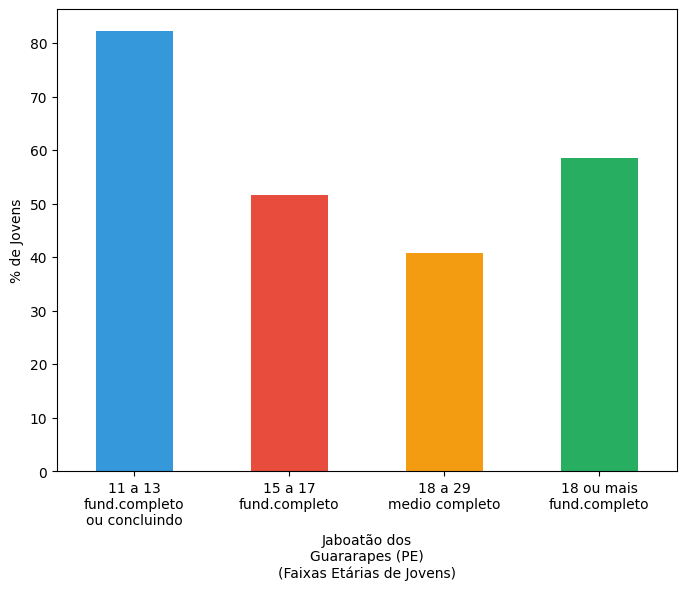

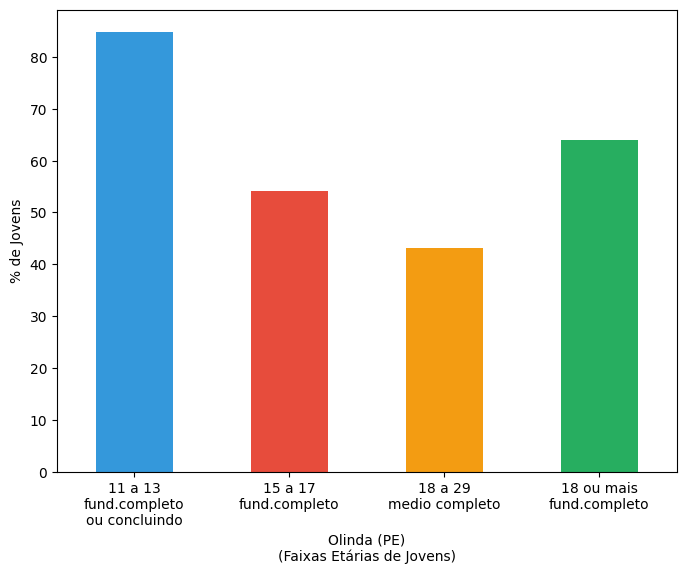

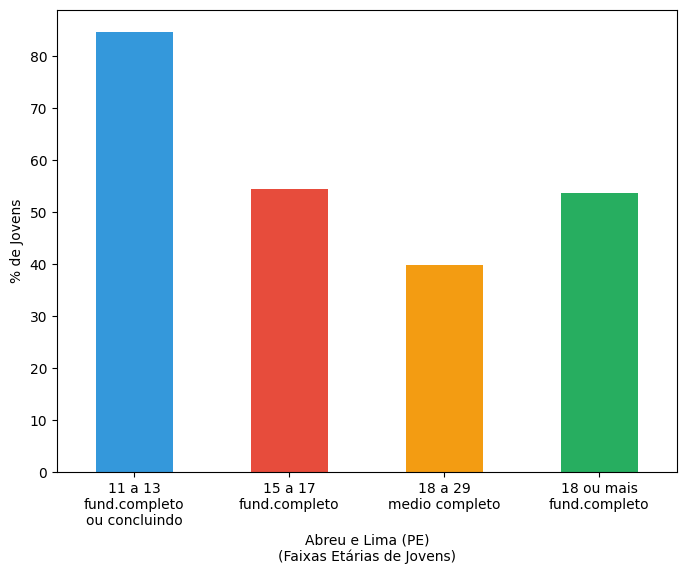

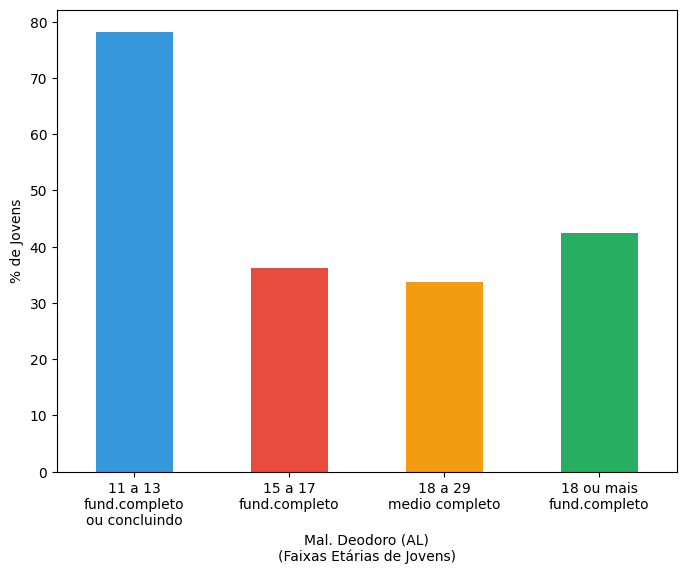

In [257]:
# Produzindo loop de gráfico para % de jovens formados



df = Educação_Jovens_2010_df[[
                                            'nome_municipio',
                                            '11 a 13\nfund.completo\nou concluindo',
                                            '15 a 17\nfund.completo',
                                            '18 a 29\nmedio completo',
                                            '18 ou mais\nfund.completo'
                                            ]]

cols =   [ 
        '11 a 13\nfund.completo\nou concluindo',
        '15 a 17\nfund.completo',
        '18 a 29\nmedio completo',
        '18 ou mais\nfund.completo'
        ]


# Transforma nomes em 'nome_municipio'
df['nome_municipio'] = df['nome_municipio'].replace(X_labels)

# # Transforma object em numeric dtype
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors='coerce'), axis = 1)




# Loop produz gráficos para cada município no DF
set_munic = set(df['nome_municipio'].tolist())
for munic in set_munic:
        dfx = df

        # Filter df with munic
        dfx = dfx[dfx['nome_municipio'] == munic]
        dfx.set_index('nome_municipio')

        # Define colors for the bars
        # colors = [colors] * 4

        # Plot the bar graph
        ax = dfx.iloc[0, 1:].plot(kind='bar', color = [c, m, y, g], figsize=(8, 6))

        # Set the x and y axis labels
        ax.set_xlabel(f'{munic}\n(Faixas Etárias de Jovens)')
        ax.set_ylabel('% de Jovens')
        plt.xticks(rotation = 0)
        # Save plot to save_path
        save_graph('Bar_% Grau de Formação de Jovens por Faixa Etária', munic)

        # Show the plot
        plt.show()

Gráfico Comparado IDHM Educação (OK)

C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\363098438.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  IDH_Municipios_Educação_df[cols_to_convert] = IDH_Municipios_Educação_df[cols_to_convert].apply(lambda x: pd.to_numeric(x, errors='coerce'))


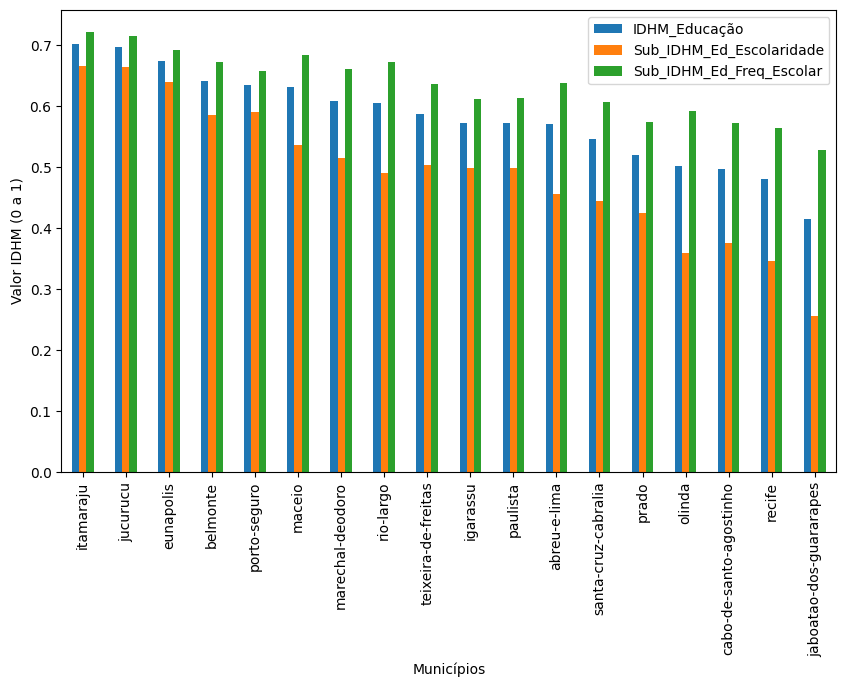

In [278]:
# Preparando dfs com índices IDH de educação

df = DF_Educação_Municipios

IDH_Municipios_Educação_df = df[[
                                'nome_municipio',
                                'IDHM Educação',
                                'Subíndice de escolaridade - IDHM Educação',
                                'Subíndice de frequência escolar - IDHM Educação'
                                ]]

# convertendo colunas para valores numéricos
cols_to_convert = [
                  'IDHM Educação',
                  'Subíndice de escolaridade - IDHM Educação',
                  'Subíndice de frequência escolar - IDHM Educação'
                  ]

IDH_Municipios_Educação_df[cols_to_convert] = IDH_Municipios_Educação_df[cols_to_convert].apply(lambda x: pd.to_numeric(x, errors='coerce'))

# Transformando nomes de colunas
new_names = {
            'IDHM Educação' : 'IDHM_Educação',
            'Subíndice de escolaridade - IDHM Educação' : 'Sub_IDHM_Ed_Escolaridade',
            'Subíndice de frequência escolar - IDHM Educação' : 'Sub_IDHM_Ed_Freq_Escolar'
            }

IDH_Municipios_Educação_df = IDH_Municipios_Educação_df.rename(columns = new_names)

# plotando gráfico comparativo de IDHM Educação para municípios
sorted_df = IDH_Municipios_Educação_df.sort_values('IDHM_Educação', ascending=False)
sorted_df.plot(kind='bar', figsize=(10,6), x = 'nome_municipio')
plt.xticks(rotation=90)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Valor IDHM (0 a 1)')
plt.xlabel(f'Municípios')

save_graph('Bar_IDHM Educação', 'Municipios')

C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\2167129578.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors='coerce'))
C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\2167129578.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['nome_municipio'] = df['nome_municipio'].replace(X_labels)


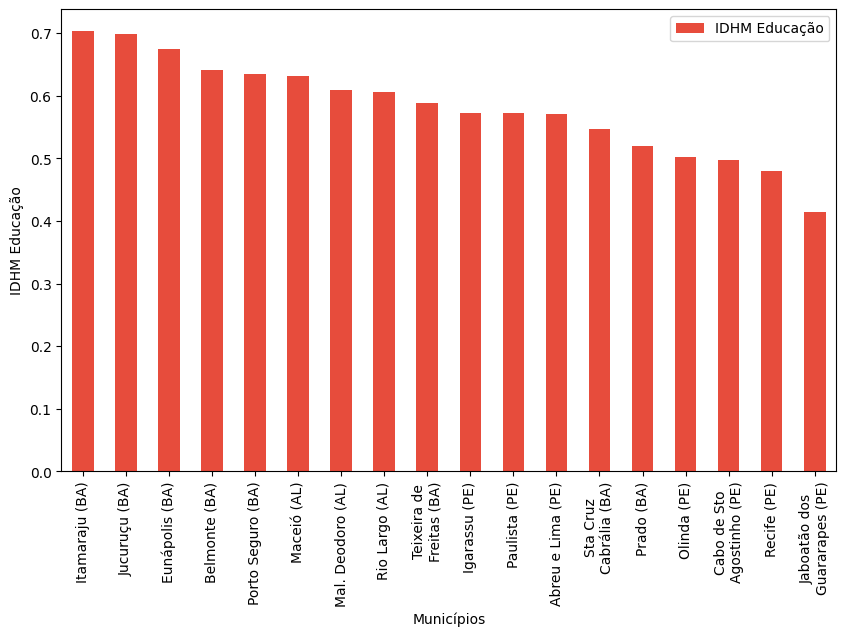

In [259]:
# Preparando dfs com índices IDH de educação

df = DF_Educação_Municipios

df = df[[
        'nome_municipio',
        'IDHM Educação'
        ]]                        

# convertendo colunas para valores numéricos
cols = [
    'IDHM Educação'
        ]

df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors='coerce'))

# replace the values in the 'nome_municipio' column
df['nome_municipio'] = df['nome_municipio'].replace(X_labels)


# Criando gráfico
sorted_df = df.sort_values('IDHM Educação', ascending=False)
sorted_df.plot(kind='bar', figsize=(10,6), x = 'nome_municipio', color = m)
plt.xticks(rotation=90)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('IDHM Educação')
plt.xlabel(f'Municípios')

save_graph('Bar_IDHM Educação', 'Municipios')

Gráfcico Comparado IVS Capital Humano (OK)

C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\406675067.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors='coerce'))


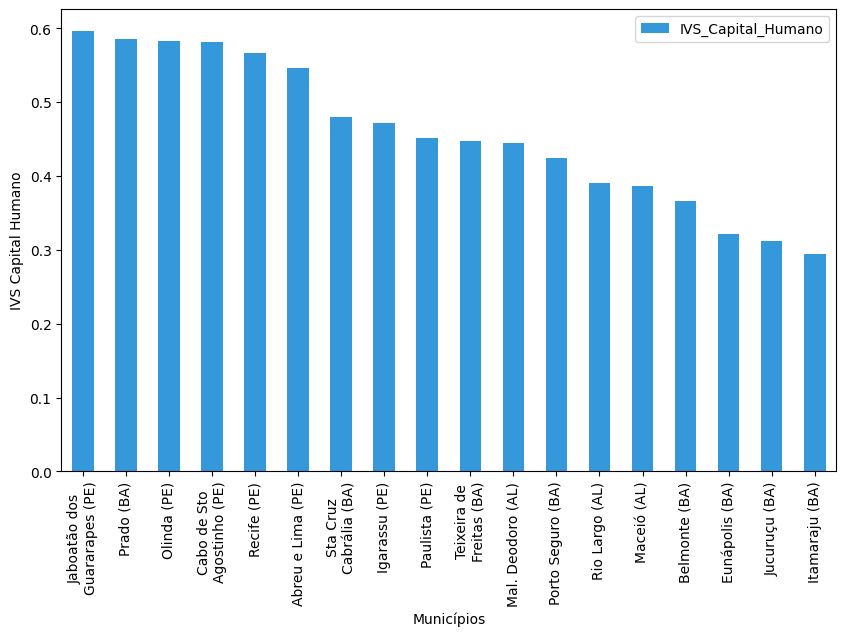

In [260]:
# Preparando df IVS

df = DF_Educação_Municipios

df = df[[
                                'nome_municipio',
                                'IVS Capital Humano'
                                ]]                        

# convertendo colunas para valores numéricos
cols = [
                  'IVS Capital Humano'
                  ]

df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors='coerce'))

# Transformando nomes de colunas
new_names = {
            'IVS Capital Humano' : 'IVS_Capital_Humano'
            }

df = df.rename(columns = new_names)

# replace the values in the 'nome_municipio' column
df['nome_municipio'] = df['nome_municipio'].replace(X_labels)


# Criando gráfico
sorted_df = df.sort_values('IVS_Capital_Humano', ascending=False)
sorted_df.plot(kind='bar', figsize=(10,6), x = 'nome_municipio', color = [c,m,y,p,g,t,a]*4)
plt.xticks(rotation=90)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('IVS Capital Humano')
plt.xlabel(f'Municípios')

save_graph('Bar_IVS Cap Humano', 'Municipios')


Gráfico Municipal Taxas de Distorção Idade-Série

C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\3855715508.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Distorção_Idade_Série_df[cols_to_convert] = Distorção_Idade_Série_df[cols_to_convert].apply(lambda x: pd.to_numeric(x, errors = 'coerce'))


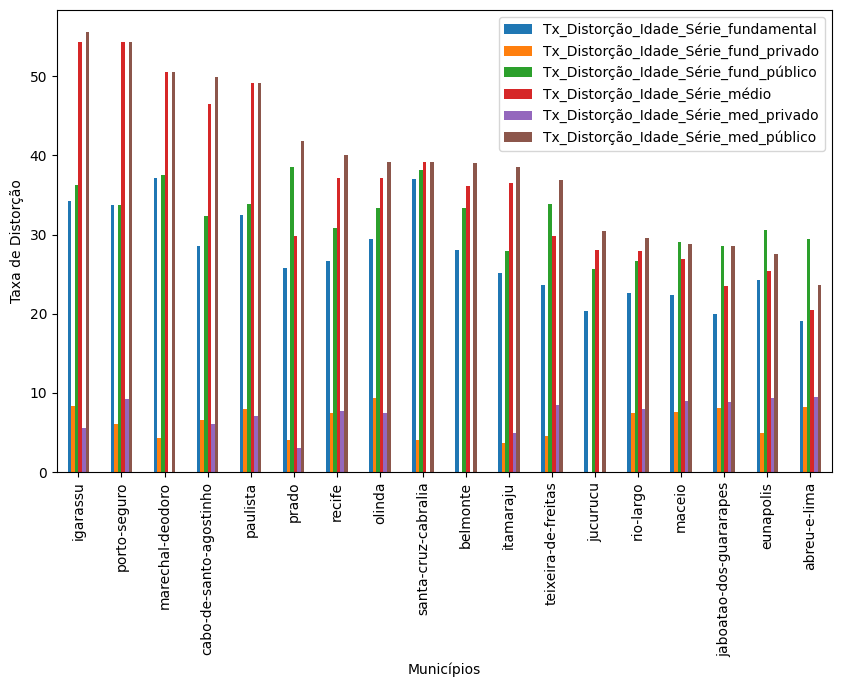

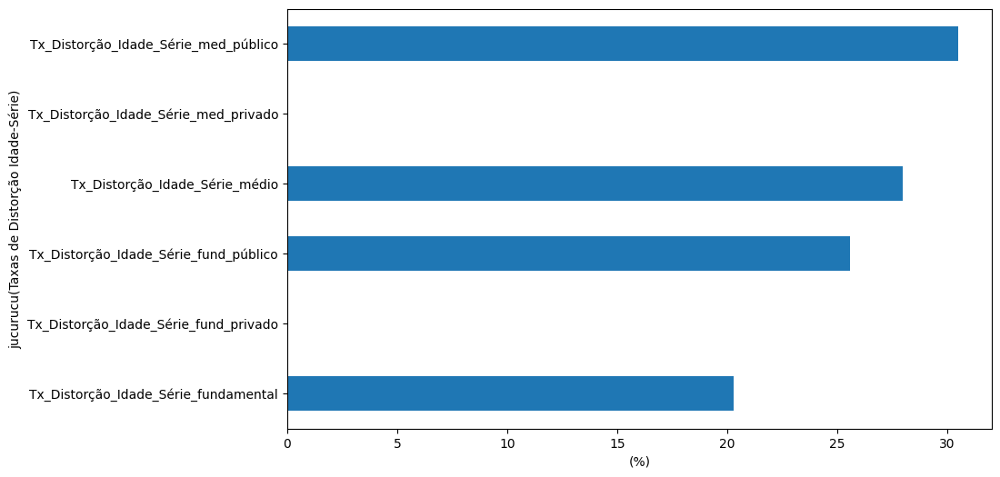

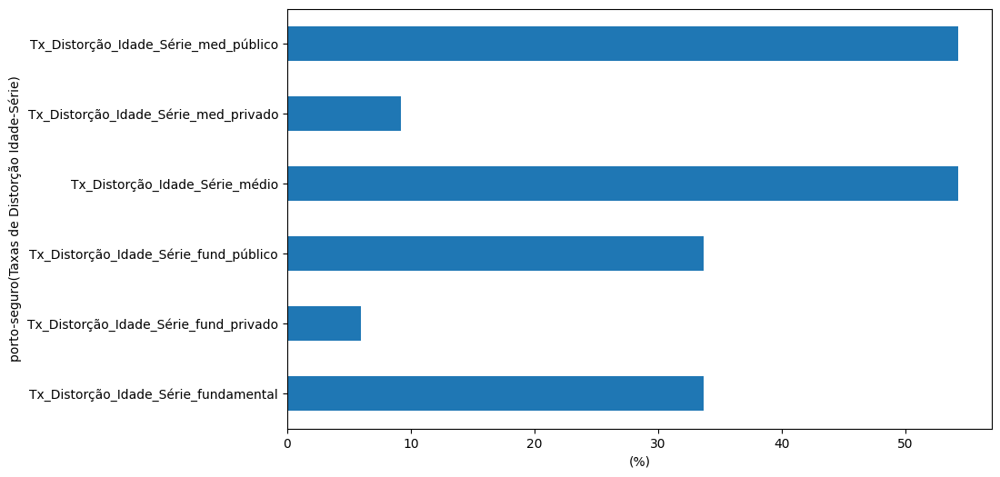

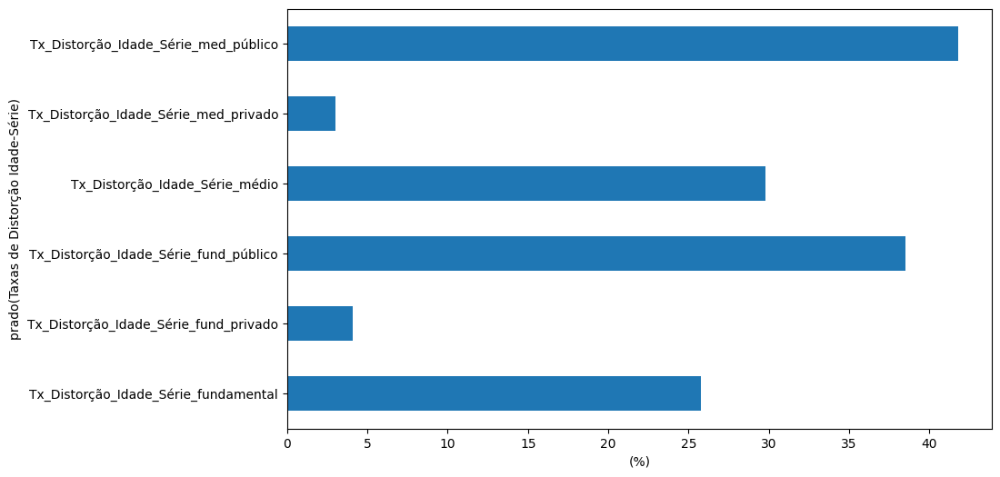

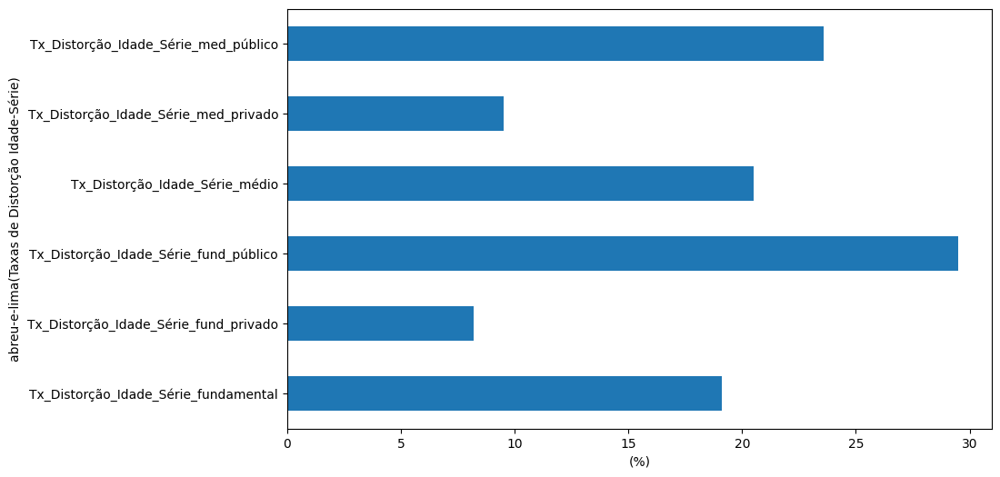

...

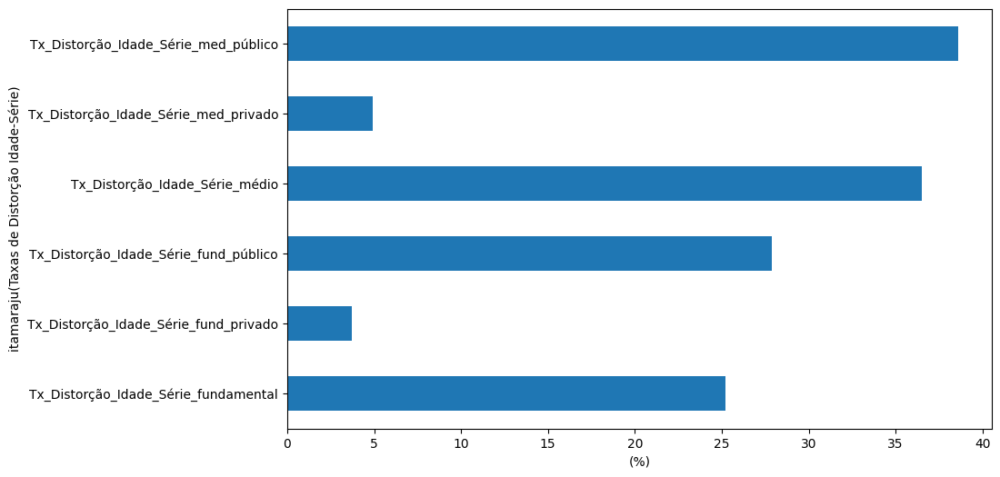

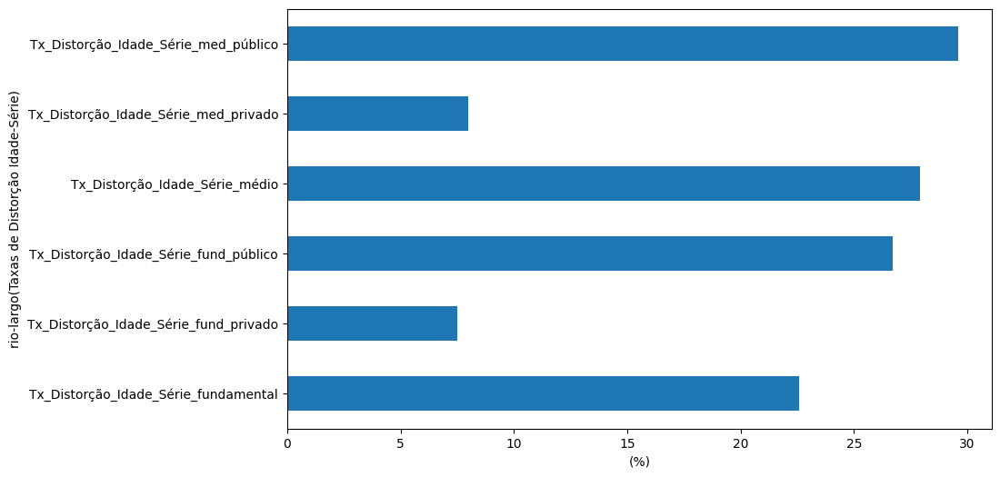

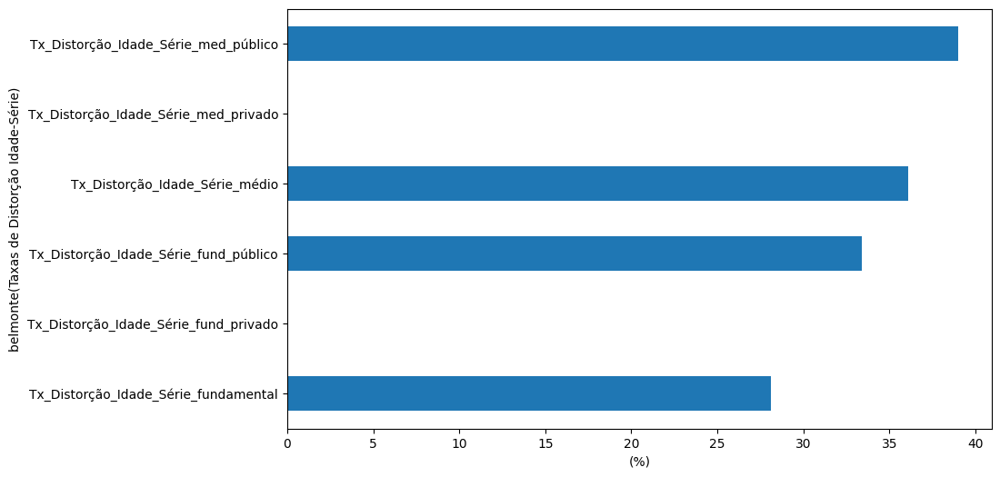

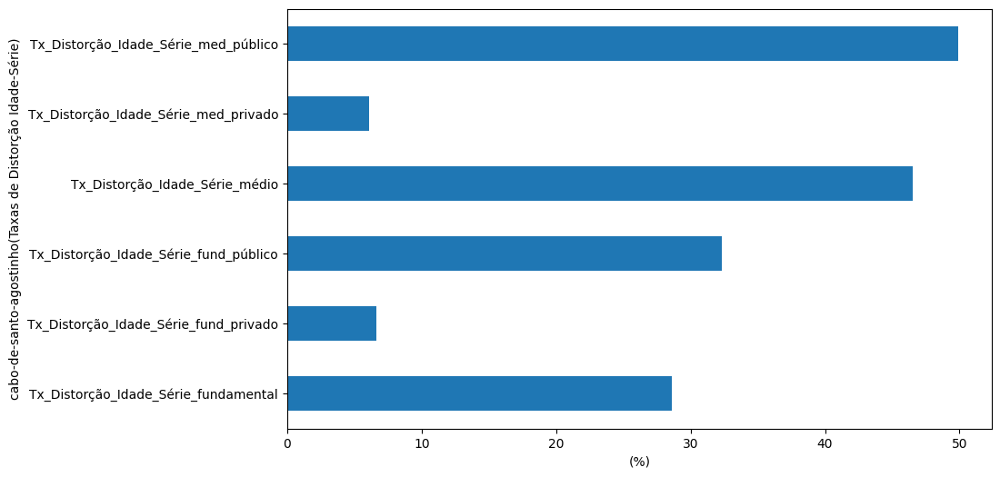

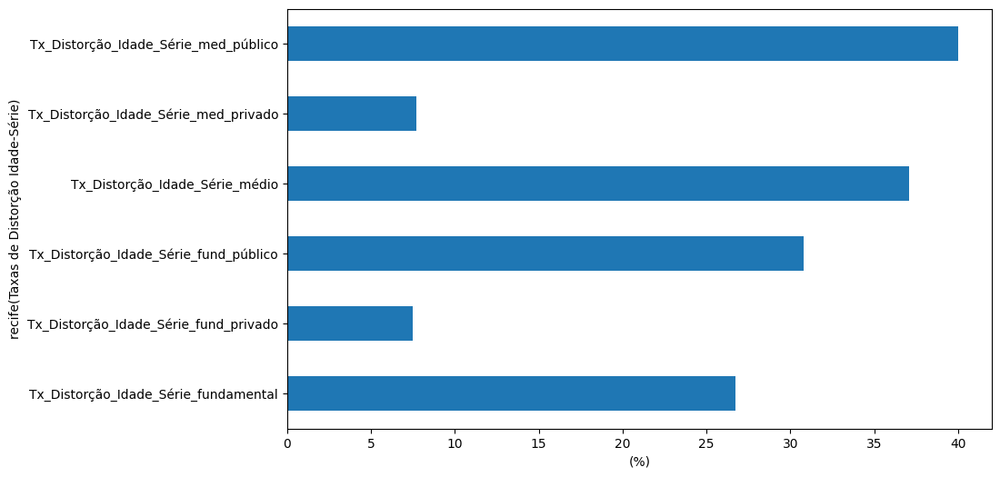

In [265]:
# Criando df para gráfico de taxas de distoção idade-série comparadas por municípios
df = DF_Educação_Municipios
Distorção_Idade_Série_df = df[[
                            'nome_municipio',
                            'Taxa de Distorção Idade-Série no fundamental 2017',
                            'Taxa de Distorção Idade-Série no fundamental na rede privada 2017',
                            'Taxa de Distorção Idade-Série no fundamental na rede pública 2017',
                            'Taxa de Distorção Idade-Série no médio 2017',
                            'Taxa de Distorção Idade-Série no médio na rede privada 2017',
                            'Taxa de Distorção Idade-Série no médio na rede pública 2017'
                              ]]

# convertendo colunas para valores numéricos
cols_to_convert = [
                  'Taxa de Distorção Idade-Série no fundamental 2017',
                  'Taxa de Distorção Idade-Série no fundamental na rede privada 2017',
                  'Taxa de Distorção Idade-Série no fundamental na rede pública 2017',
                  'Taxa de Distorção Idade-Série no médio 2017',
                  'Taxa de Distorção Idade-Série no médio na rede privada 2017',
                  'Taxa de Distorção Idade-Série no médio na rede pública 2017'
                  ]

Distorção_Idade_Série_df[cols_to_convert] = Distorção_Idade_Série_df[cols_to_convert].apply(lambda x: pd.to_numeric(x, errors = 'coerce'))

# Transformando nomes de colunas
new_names = {
            'Taxa de Distorção Idade-Série no fundamental 2017'                : 'Tx_Distorção_Idade_Série_fundamental',
            'Taxa de Distorção Idade-Série no fundamental na rede privada 2017': 'Tx_Distorção_Idade_Série_fund_privado',
            'Taxa de Distorção Idade-Série no fundamental na rede pública 2017': 'Tx_Distorção_Idade_Série_fund_público',
            'Taxa de Distorção Idade-Série no médio 2017'                      : 'Tx_Distorção_Idade_Série_médio',
            'Taxa de Distorção Idade-Série no médio na rede privada 2017'      : 'Tx_Distorção_Idade_Série_med_privado',
            'Taxa de Distorção Idade-Série no médio na rede pública 2017'      : 'Tx_Distorção_Idade_Série_med_público'
            }

Distorção_Idade_Série_df = Distorção_Idade_Série_df.rename(columns = new_names)


# plotando gráfico comparativo de IDHM Educação para municípios
sorted_df = Distorção_Idade_Série_df.sort_values('Tx_Distorção_Idade_Série_med_público', ascending=False)
sorted_df.plot(kind='bar', figsize=(10,6), x = 'nome_municipio')
plt.xticks(rotation=90)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Taxa de Distorção')
plt.xlabel(f'Municípios')

# Loop para produção de gráfico individuais para cada município da Distorção Idade-Série
set_munic = set(Distorção_Idade_Série_df['nome_municipio'].tolist())

for munic in set_munic:
    df = Distorção_Idade_Série_df

    # Filter df with munic
    df = df[df['nome_municipio'] == munic]

    # Transpose the data frame
    df = df.set_index('nome_municipio').T

    # Create the bar chart
    ax = df.plot(kind='barh', legend=False)

    # Edit the graph
    plt.xlabel('(%)')
    plt.ylabel(f'{munic}(Taxas de Distorção Idade-Série)')

    # Save plot to save_path
    plt.savefig(f'{save_path}\\Bar_Distorção_Idade_Série_{munic}_2017')

    # Show the plot
    plt.show()


Gráfico Comparativo e Municipal Estrutura Escolar 

C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\3092522089.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Estrutura_Escolar_df[cols_to_convert] = Estrutura_Escolar_df[cols_to_convert].apply(lambda x: pd.to_numeric(x, errors = 'coerce'))


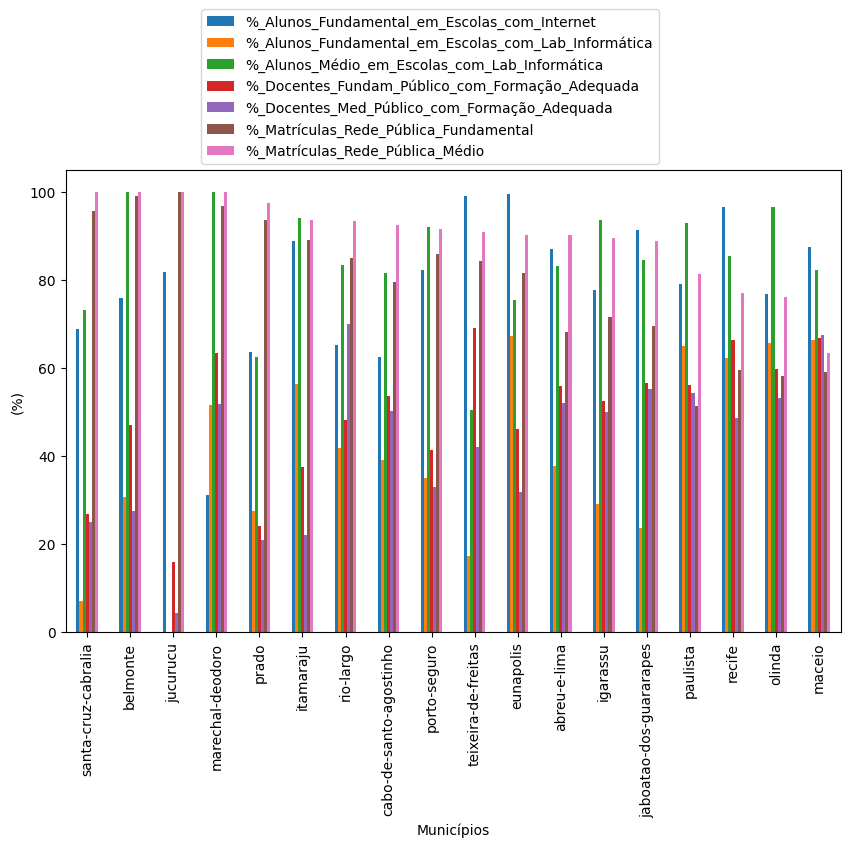

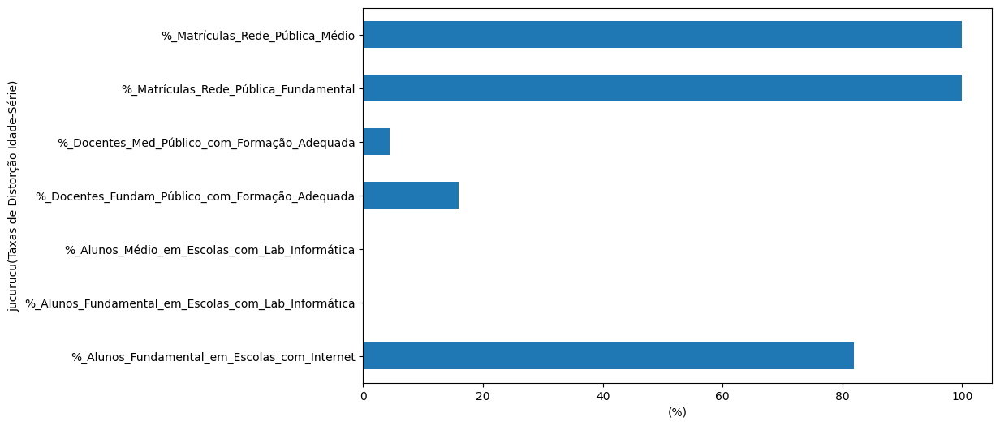

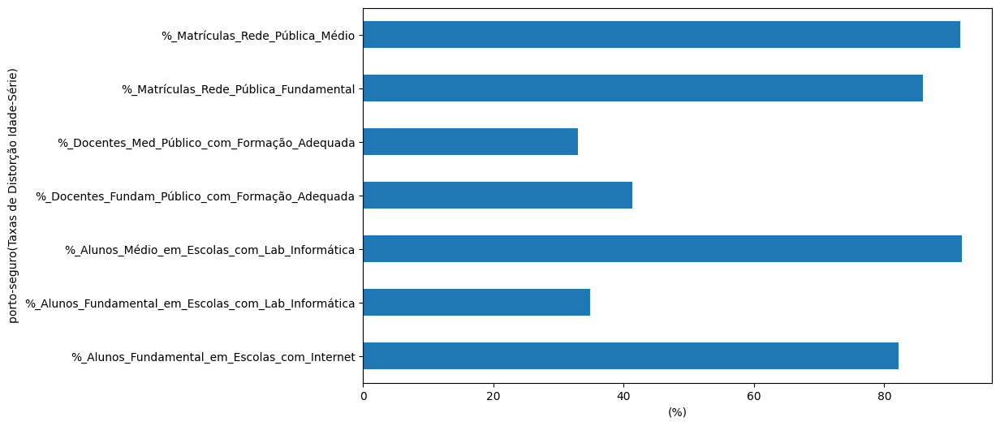

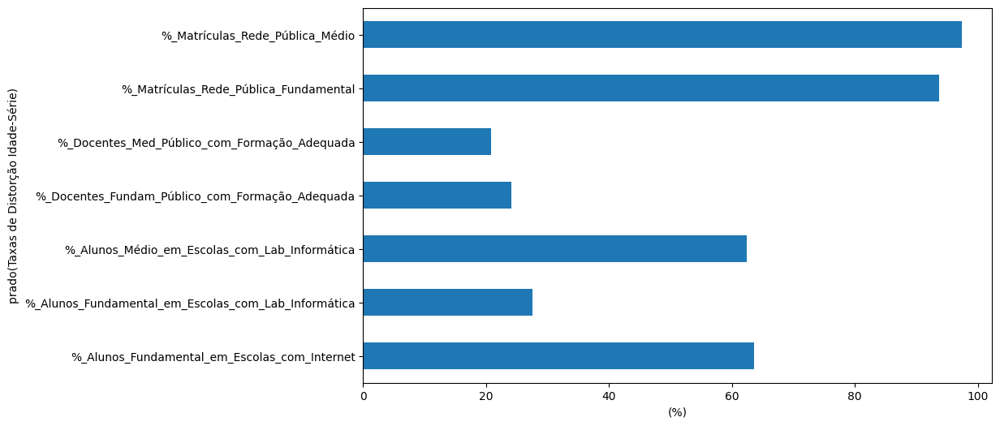

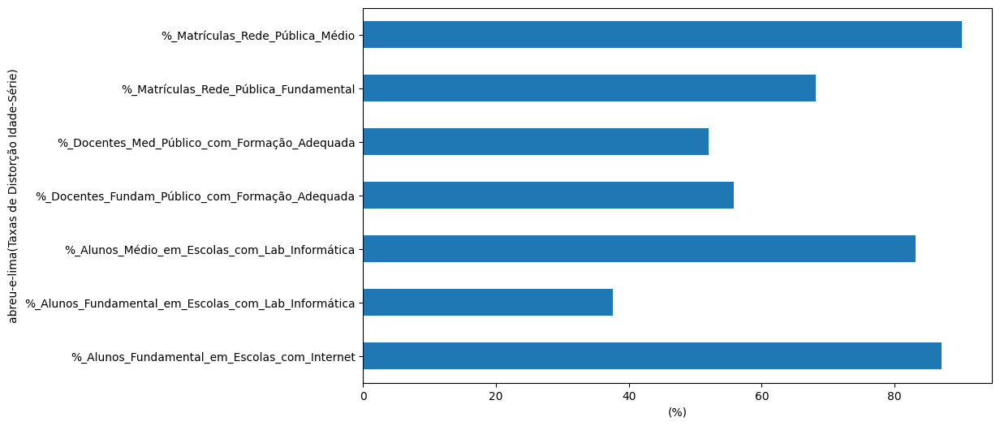

...

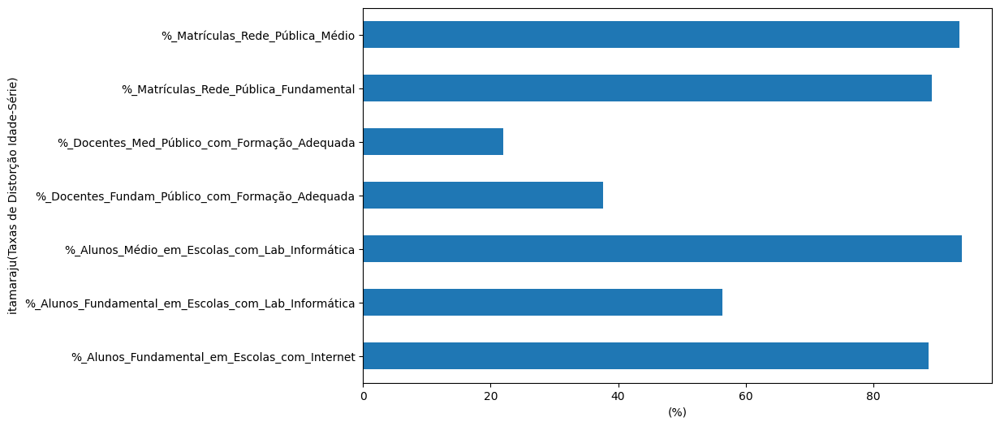

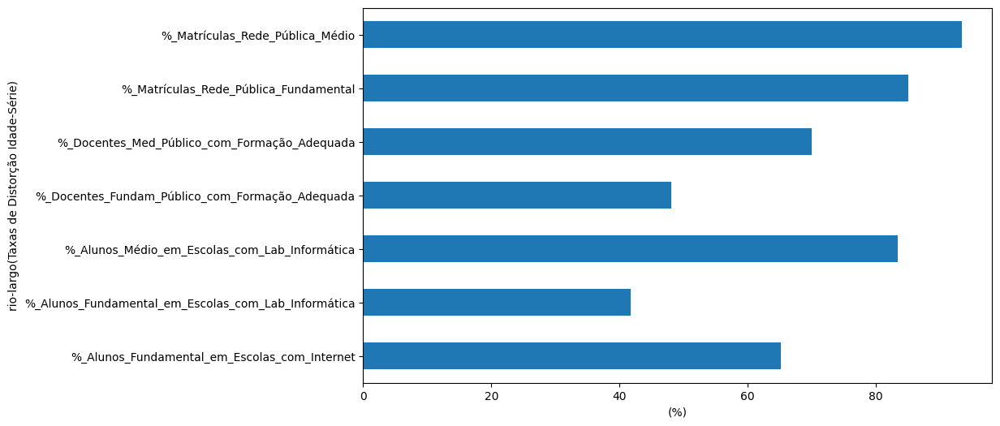

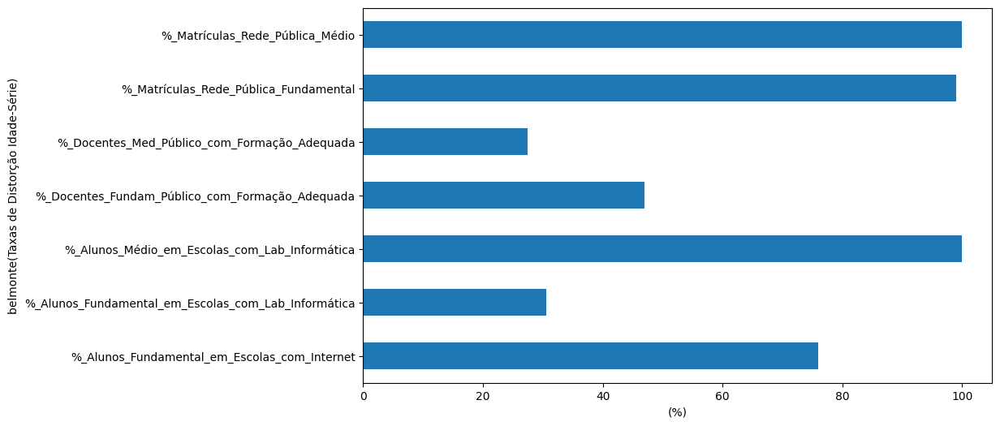

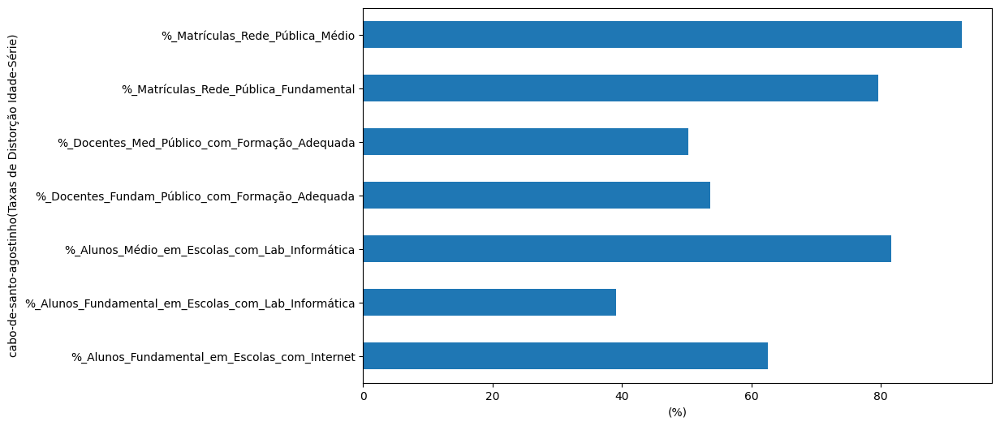

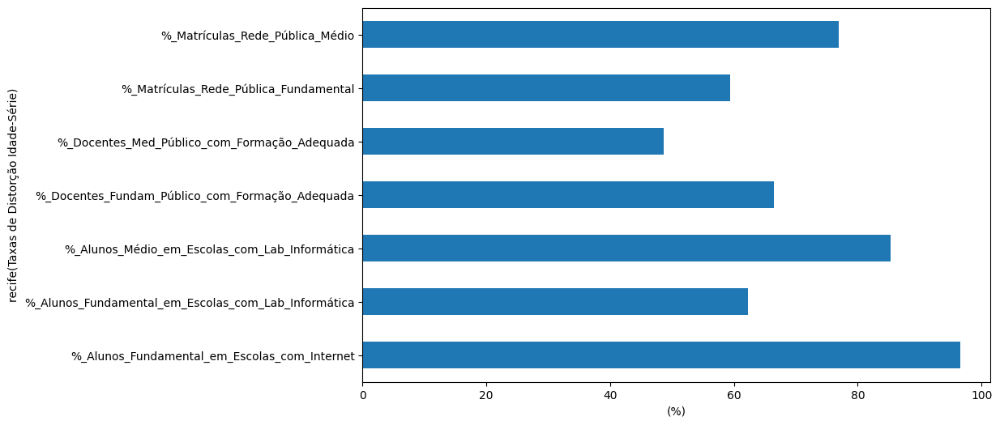

In [267]:
# Criando df para gráfico de estrutura escolar pública comparadas por municípios
df = DF_Educação_Municipios
Estrutura_Escolar_df = df[[
                            'nome_municipio',
                            '% de alunos do ensino fundamental em escolas com internet 2017',
                            '% de alunos do ensino fundamental em escolas com laboratório de informática 2017',
                            '% de alunos do ensino médio em escolas com laboratório de informática 2017',
                            '% de docentes na rede pública do fundamental com formação adequada 2017',
                            '% de docentes na rede pública do médio com formação adequada 2017',
                            '% de matrículas da rede pública no ensino fundamental 2017',
                            '% de matrículas da rede pública no ensino médio 2017',
                              ]]

# convertendo colunas para valores numéricos
cols_to_convert = [
                    '% de alunos do ensino fundamental em escolas com internet 2017',
                    '% de alunos do ensino fundamental em escolas com laboratório de informática 2017',
                    '% de alunos do ensino médio em escolas com laboratório de informática 2017',
                    '% de docentes na rede pública do fundamental com formação adequada 2017',
                    '% de docentes na rede pública do médio com formação adequada 2017',
                    '% de matrículas da rede pública no ensino fundamental 2017',
                    '% de matrículas da rede pública no ensino médio 2017',
                  ]

Estrutura_Escolar_df[cols_to_convert] = Estrutura_Escolar_df[cols_to_convert].apply(lambda x: pd.to_numeric(x, errors = 'coerce'))

# Transformando nomes de colunas
new_names = {
            '% de alunos do ensino fundamental em escolas com internet 2017'                  : '%_Alunos_Fundamental_em_Escolas_com_Internet',
            '% de alunos do ensino fundamental em escolas com laboratório de informática 2017': '%_Alunos_Fundamental_em_Escolas_com_Lab_Informática',
            '% de alunos do ensino médio em escolas com laboratório de informática 2017'      : '%_Alunos_Médio_em_Escolas_com_Lab_Informática',
            '% de docentes na rede pública do fundamental com formação adequada 2017'         : '%_Docentes_Fundam_Público_com_Formação_Adequada',
            '% de docentes na rede pública do médio com formação adequada 2017'               : '%_Docentes_Med_Público_com_Formação_Adequada',
            '% de matrículas da rede pública no ensino fundamental 2017'                      : '%_Matrículas_Rede_Pública_Fundamental',
            '% de matrículas da rede pública no ensino médio 2017'                            : '%_Matrículas_Rede_Pública_Médio'
            }

Estrutura_Escolar_df = Estrutura_Escolar_df.rename(columns = new_names)


# plotando gráfico comparativo de Estrutura Escolar entre municípios
sorted_df = Estrutura_Escolar_df.sort_values('%_Matrículas_Rede_Pública_Médio', ascending=False)
sorted_df.plot(kind='bar', figsize=(10,6), x = 'nome_municipio')
plt.xticks(rotation=90)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('(%)')
plt.xlabel(f'Municípios')
plt.legend(bbox_to_anchor=(.47,.998), loc='lower center')


# Loop para produção de gráfico individuais para cada município da Distorção Idade-Série
set_munic = set(Estrutura_Escolar_df['nome_municipio'].tolist())

for munic in set_munic:
    df = Estrutura_Escolar_df

    # Filter df with munic
    df = df[df['nome_municipio'] == munic]

    # Transpose the data frame
    df = df.set_index('nome_municipio').T

    # Create the bar chart
    ax = df.plot(kind='barh', legend=False)

    # Edit the graph
    plt.xlabel('(%)')
    plt.ylabel(f'{munic}(Taxas de Distorção Idade-Série)')

    # Save plot to save_path
    plt.savefig(f'{save_path}\\Bar_Estrutura_Escolar_{munic}_2017')

    # Show the plot
    plt.show()


Gráfico Comparativo IDEB 2017

C:\Users\João Flavio\AppData\Local\Temp\ipykernel_20200\2528059665.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  IDEB_2017_df[cols_to_convert] = IDEB_2017_df[cols_to_convert].apply(lambda x: pd.to_numeric(x, errors = 'coerce'))


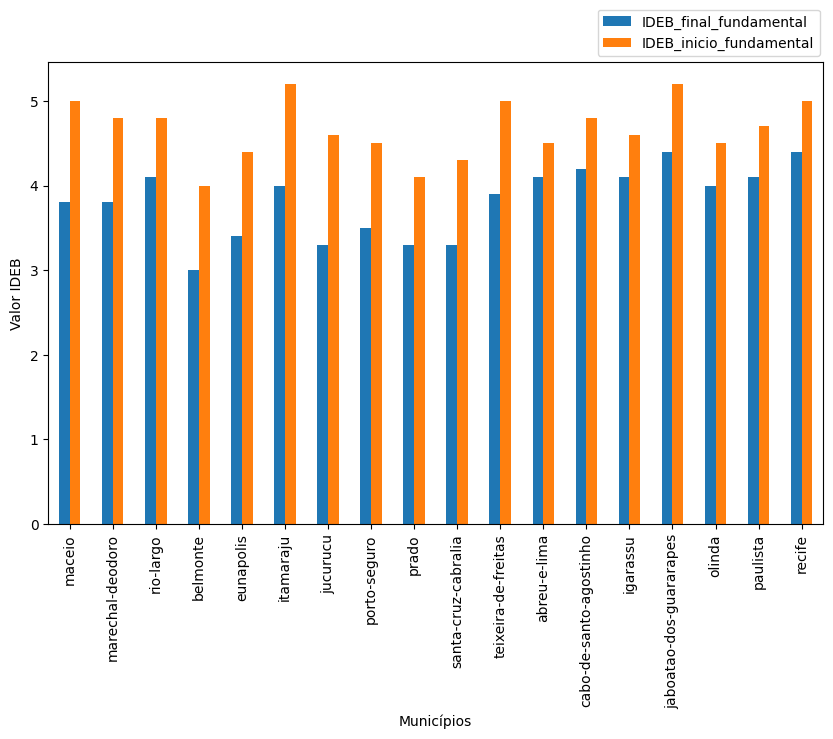

In [279]:
# Criando df para gráficos do IDEB para comparação entre municípios
df = DF_Educação_Municipios
IDEB_2017_df = df[[
                 'nome_municipio',
                 'IDEB anos finais do ensino fundamental 2017',
                 'IDEB anos iniciais do ensino fundamental 2017'
                 ]]

# convertendo valores mistos em colunas para numéricos
cols_to_convert = [
                 'IDEB anos finais do ensino fundamental 2017',
                 'IDEB anos iniciais do ensino fundamental 2017'
                 ]

IDEB_2017_df[cols_to_convert] = IDEB_2017_df[cols_to_convert].apply(lambda x: pd.to_numeric(x, errors = 'coerce'))

# renomeando as colunas
new_names =  {
            'IDEB anos finais do ensino fundamental 2017'  : 'IDEB_final_fundamental',
            'IDEB anos iniciais do ensino fundamental 2017': 'IDEB_inicio_fundamental'
            } 

IDEB_2017_df = IDEB_2017_df.rename(columns = new_names)

# plotando gráfico comparativo do IDEB 2017 entre municípios
sorted_df = IDEB_2017_df.sort_values('IDEB_inicio_fundamental', ascending=True)
IDEB_2017_df.plot(kind='bar', figsize=(10,6), x = 'nome_municipio')
plt.xticks(rotation=90)
plt.ticklabel_format(style='plain', axis='y')
plt.ylabel('Valor IDEB')
plt.xlabel(f'Municípios')
plt.legend(bbox_to_anchor=(.7,.998), loc='best')
save_graph('Bar_IDEB Fundamental', 'Municipios')

## Gráficos PIB, Renda e Ocupação

Gráfico PIB (valores adicionados básicos) 2020

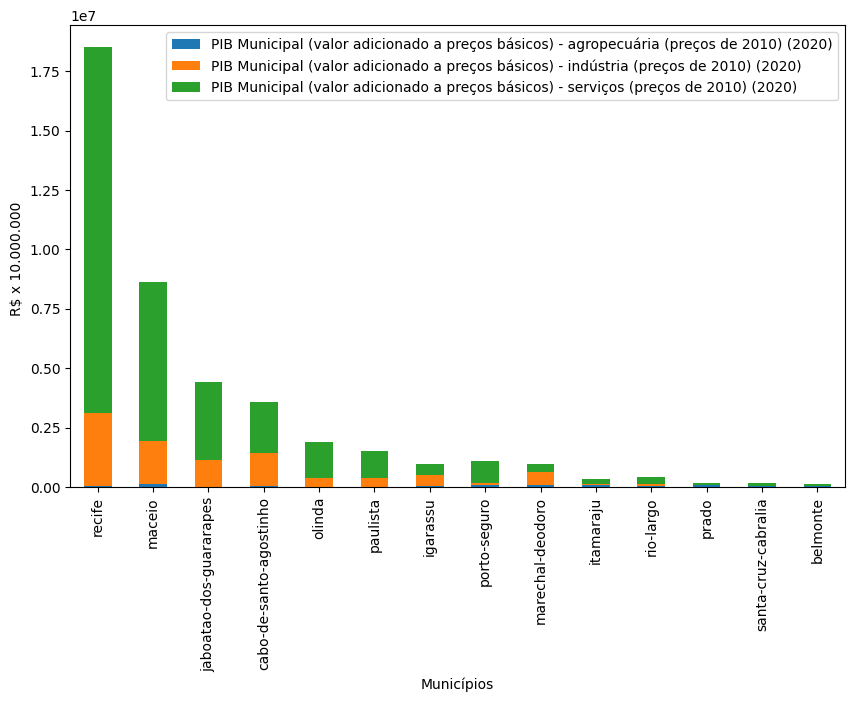

In [280]:
# Plotando gráficos PIB (valores adicionados básicos) 2020
df = DF_PIB_Municipal_1970_2020[DF_PIB_Municipal_1970_2020['nome_municipio'].isin(Municipios)]

df = df.sort_values('PIB Municipal - preços de mercado (preços de 2010) (2010)', ascending = False)

df.plot(
        x = 'nome_municipio',
        y = [
            'PIB Municipal (valor adicionado a preços básicos) - agropecuária (preços de 2010) (2020)',
            'PIB Municipal (valor adicionado a preços básicos) - indústria (preços de 2010) (2020)',
            'PIB Municipal (valor adicionado a preços básicos) - serviços (preços de 2010) (2020)'
            ],
        kind = 'bar',
        stacked = True
        )
plt.xlabel('Municípios')
plt.ylabel('R$ x 10.000.000 ')
save_graph('PIB 2020 Municipios', 'Municipios')

#! Valores Adicionados Básicos são apenas fatores componentes parciais do PIB. O IBGE em séries revisadas já divulga outros valores ajustados.


#### Plots: DF_Renda_e_Ocupação_Municipios

Gráfico comparativo 'IDHM Renda'

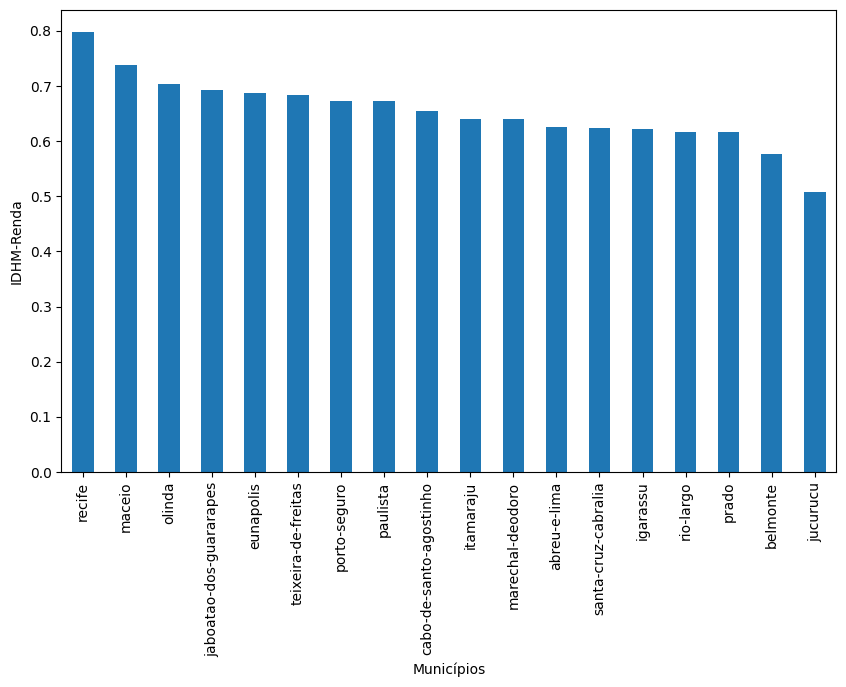

In [281]:
# Gráfico comparativo 'IDHM Renda'

df = DF_Renda_e_Ocupação_Municipios.copy()

# Resume df necessário
df = df[['nome_municipio', 'IDHM Renda', 'Sexo', "Cor", 'Situação de Domicílio']]
df = df[(df['Sexo'] == "Total Sexo") & (df['Cor'] == "Total Cor") & (df['Situação de Domicílio'] == "Total Situação de Domicílio") ]
df.drop(['Sexo', "Cor", 'Situação de Domicílio'], axis = 1, inplace = True)

# Converte dtype da coluna para número
df['IDHM Renda']= pd.to_numeric(df['IDHM Renda'])

df = df.sort_values('IDHM Renda', ascending = False)

df.plot(
        x = 'nome_municipio',
        y = 'IDHM Renda',
        kind = 'bar',
        legend = False
        )
plt.xlabel('Municípios')
plt.ylabel('IDHM-Renda')

save_graph('Bar_IDHM Renda', 'Municipios')

Gráfico comparativo 'IVS Trabalho e Renda'

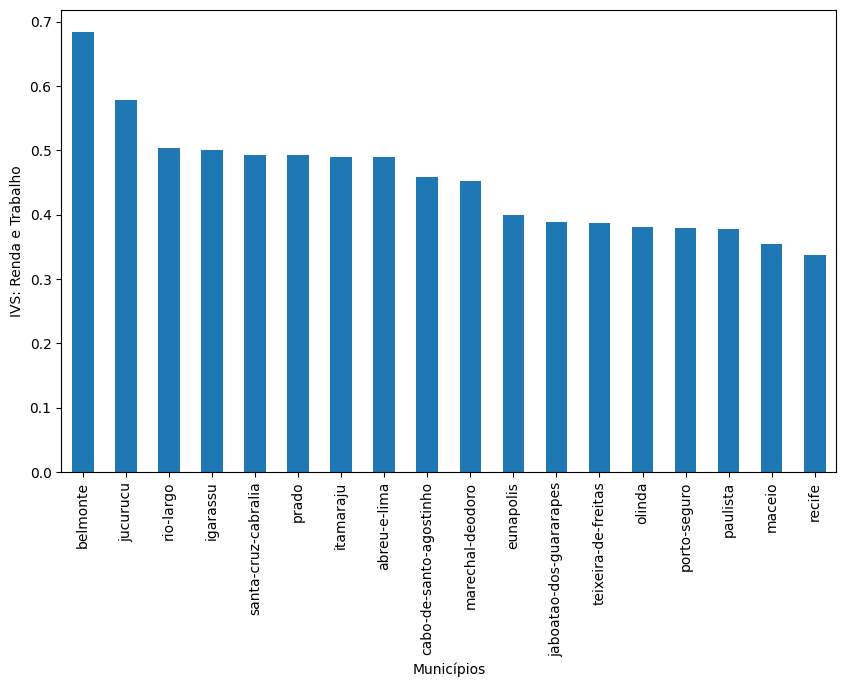

In [282]:
# Gráfico comparativo 'IVS Trabalho e Renda'

df = DF_Renda_e_Ocupação_Municipios.copy()

# Resume df necessário
df = df[['nome_municipio', 'IVS Renda e Trabalho', 'Sexo', "Cor", 'Situação de Domicílio']]
df = df[(df['Sexo'] == "Total Sexo") & (df['Cor'] == "Total Cor") & (df['Situação de Domicílio'] == "Total Situação de Domicílio") ]
df.drop(['Sexo', "Cor", 'Situação de Domicílio'], axis = 1, inplace = True)

# Converte dtype da coluna para número
df['IVS Renda e Trabalho'] = pd.to_numeric(df['IVS Renda e Trabalho'])

df = df.sort_values('IVS Renda e Trabalho', ascending = False)

df.plot(
        x = 'nome_municipio',
        y = 'IVS Renda e Trabalho',
        kind = 'bar',
        legend = False
        )
plt.xlabel('Municípios')
plt.ylabel('IVS: Renda e Trabalho')

save_graph('Bar_IVS Trabalho e Renda', 'Municipios')

Gráfico comparativo 'Grau de formalização dos ocupados - 18 anos ou mais'

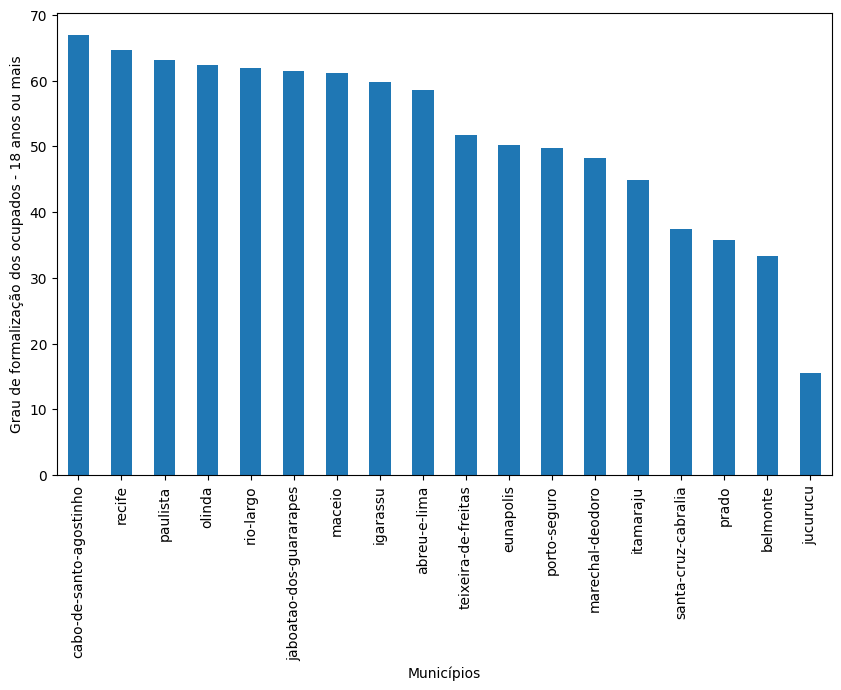

In [283]:
# Gráfico comparativo 'Grau de formalização dos ocupados - 18 anos ou mais'

df = DF_Renda_e_Ocupação_Municipios.copy()

var = 'Grau de formalização dos ocupados - 18 anos ou mais'

# Resume df necessário
df = df[['nome_municipio', var, 'Sexo', "Cor", 'Situação de Domicílio']]
df = df[(df['Sexo'] == "Total Sexo") & (df['Cor'] == "Total Cor") & (df['Situação de Domicílio'] == "Total Situação de Domicílio") ]
df.drop(['Sexo', "Cor", 'Situação de Domicílio'], axis = 1, inplace = True)


# Converte dtype da coluna para número
df[var] = pd.to_numeric(df[var])

df = df.sort_values(var, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = var,
        kind = 'bar',
        legend = False
        )
plt.xlabel('Municípios')
plt.ylabel(var)

save_graph('Bar_Grau de formalização dos ocupados - 18 anos ou mais', 'Municipios')


 Gráfico comparativo 'Taxa de desocupação da população de 18 anos ou mais de idade'

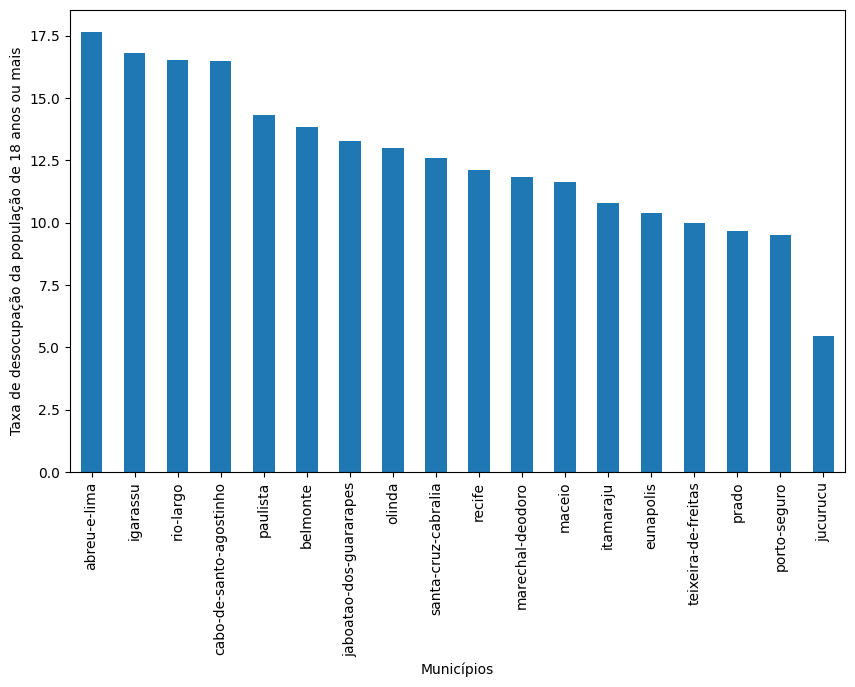

In [285]:
# Gráfico comparativo 'Taxa de desocupação da população de 18 anos ou mais de idade'

df = DF_Renda_e_Ocupação_Municipios.copy()

var = 'Taxa de desocupação da população de 18 anos ou mais de idade'

# Resume df necessário
df = df[['nome_municipio', var, 'Sexo', "Cor", 'Situação de Domicílio']]
df = df[(df['Sexo'] == "Total Sexo") & (df['Cor'] == "Total Cor") & (df['Situação de Domicílio'] == "Total Situação de Domicílio") ]
df.drop(['Sexo', "Cor", 'Situação de Domicílio'], axis = 1, inplace = True)


# Converte dtype da coluna para número
df[var] = pd.to_numeric(df[var])

df = df.sort_values(var, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = var,
        kind = 'bar',
        legend = False
        )
plt.xlabel('Municípios')
plt.ylabel('Taxa de desocupação da população de 18 anos ou mais')

save_graph('Bar_Taxa de desocupação pop 18 anos ou mais', 'Municipios')


Gráfico comparativo 'Renda per capita', 'Renda per capita dos vulneráveis à pobreza' e 'Rendimento médio dos ocupados - 18 anos ou mais'

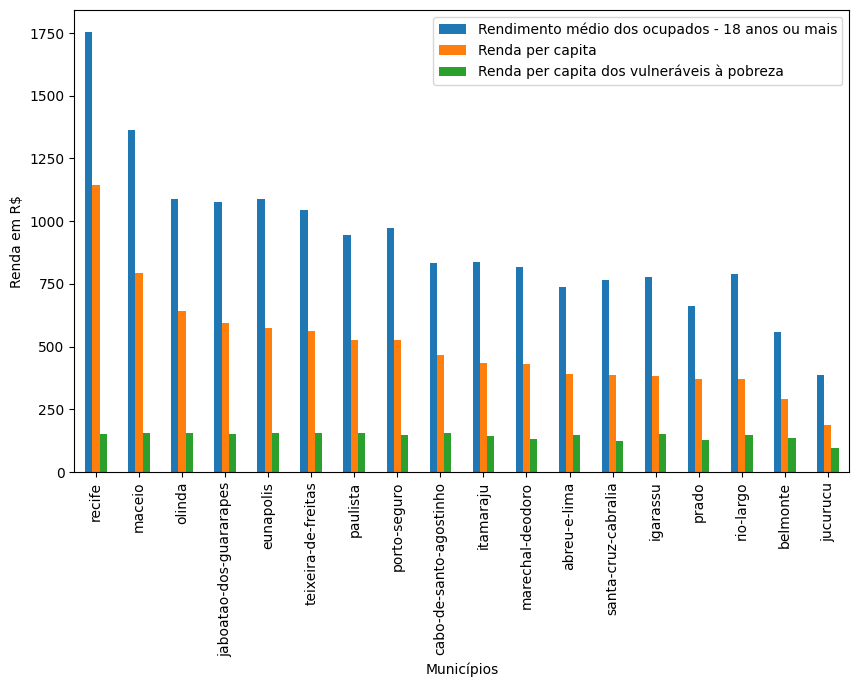

In [286]:
# Gráfico comparativo 'Renda per capita', 'Renda per capita dos vulneráveis à pobreza' e 'Rendimento médio dos ocupados - 18 anos ou mais'

df = DF_Renda_e_Ocupação_Municipios.copy()

var1 = 'Renda per capita'
var2 = 'Renda per capita dos vulneráveis à pobreza'
var3 = 'Rendimento médio dos ocupados - 18 anos ou mais'

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, 'Sexo', "Cor", 'Situação de Domicílio']]
df = df[(df['Sexo'] == "Total Sexo") & (df['Cor'] == "Total Cor") & (df['Situação de Domicílio'] == "Total Situação de Domicílio") ]
df.drop(['Sexo', "Cor", 'Situação de Domicílio'], axis = 1, inplace = True)


# Converte dtype da coluna para número
df[var1] = pd.to_numeric(df[var1])
df[var2] = pd.to_numeric(df[var2])
df[var3] = pd.to_numeric(df[var3])

df = df.sort_values('Renda per capita', ascending = False)

df.plot(
        x = 'nome_municipio',
        y = [var3, var1, var2],
        kind = 'bar',
        legend = True
        )
plt.xlabel('Municípios')
plt.ylabel('Renda em R$')

save_graph('Bar_Renda per capita vulneráveis e ocupados', 'Municipios')

Gráfico municipal Faixas etárias da PEA

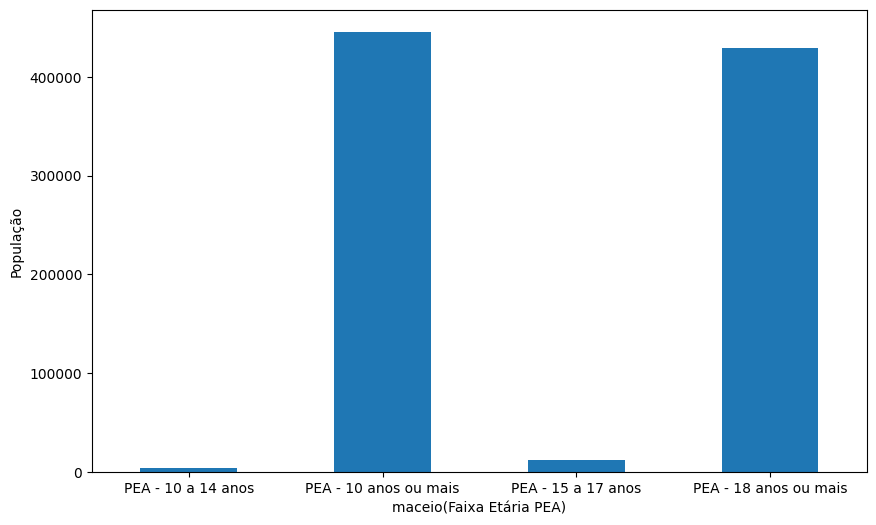

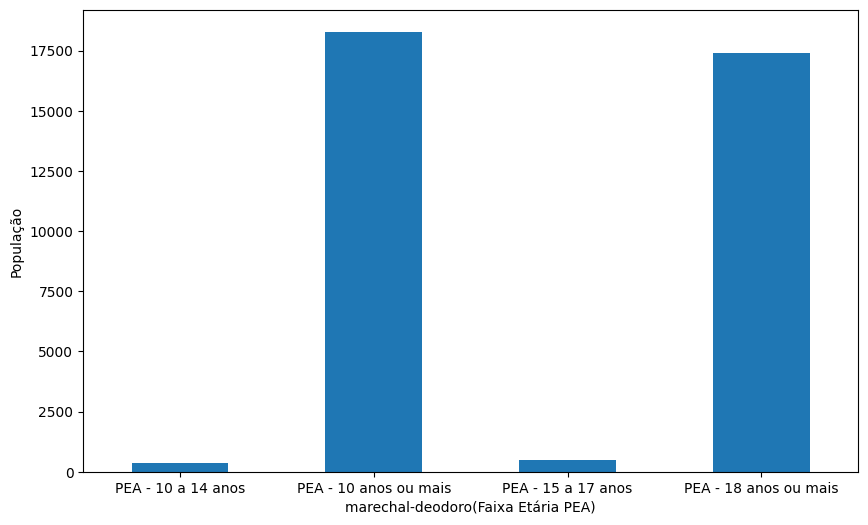

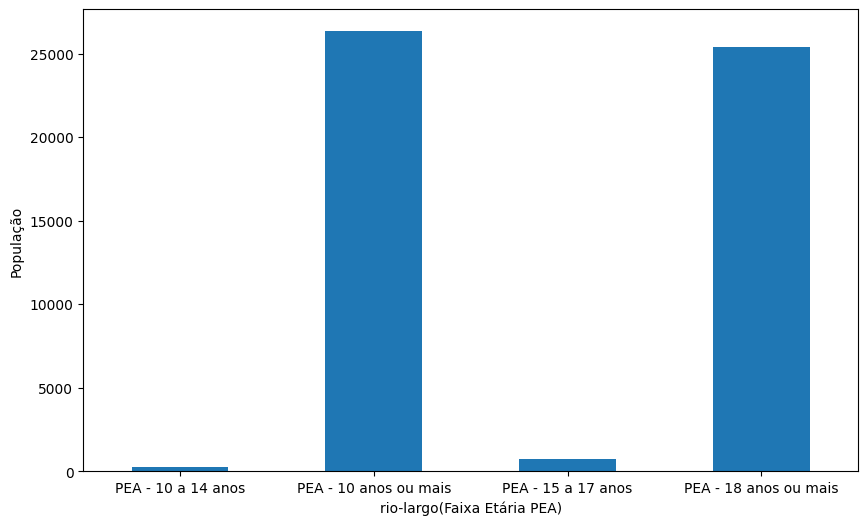

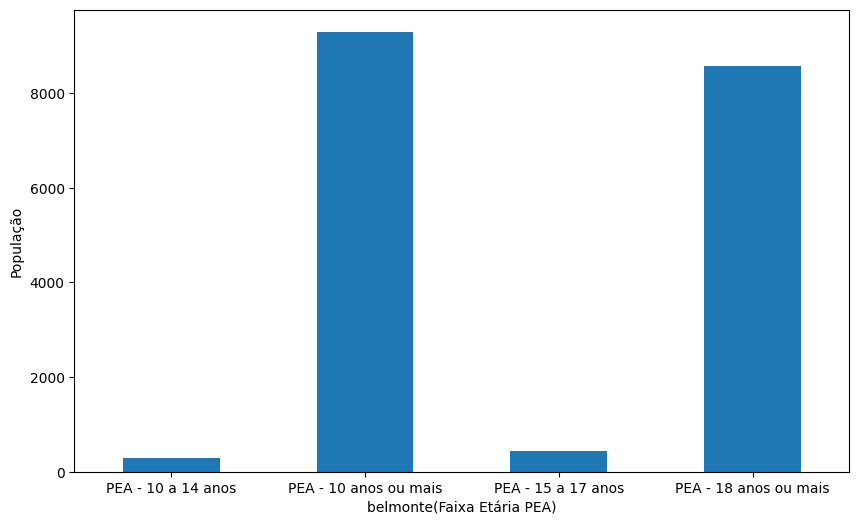

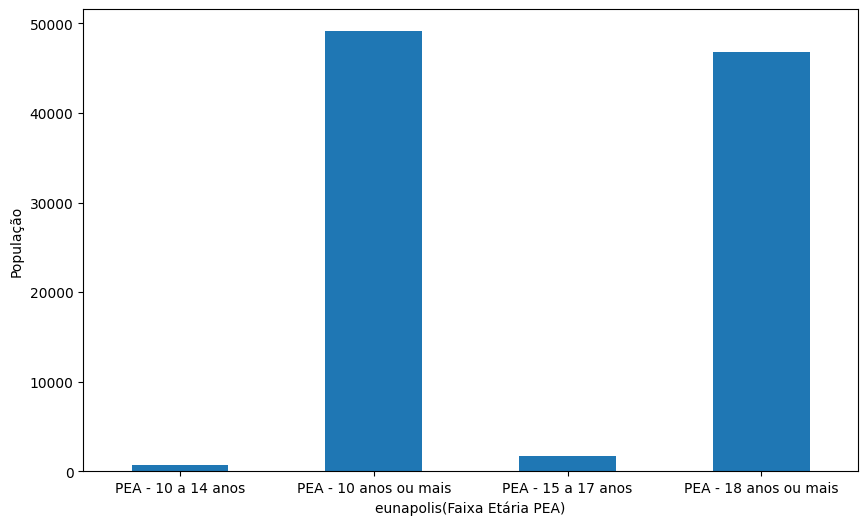

...

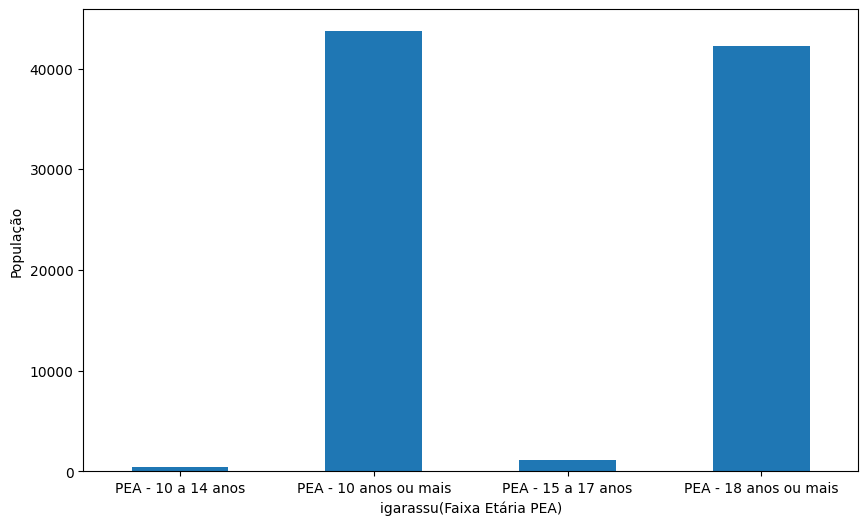

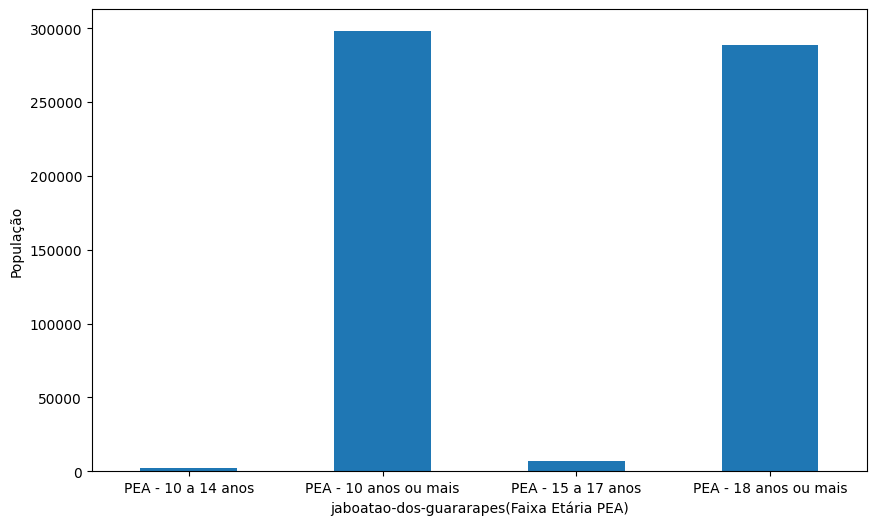

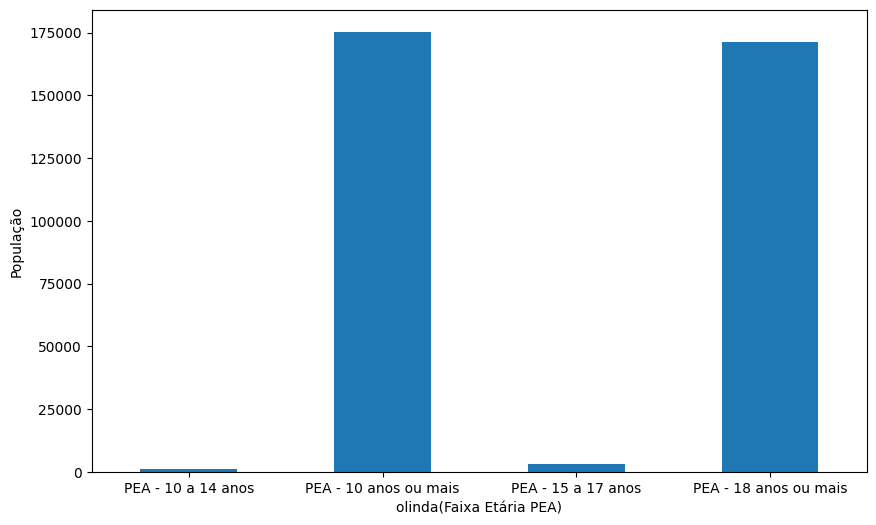

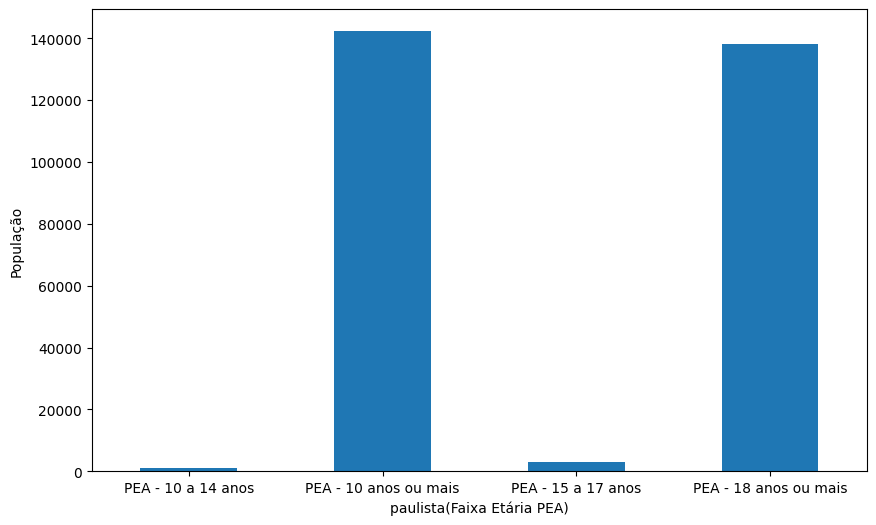

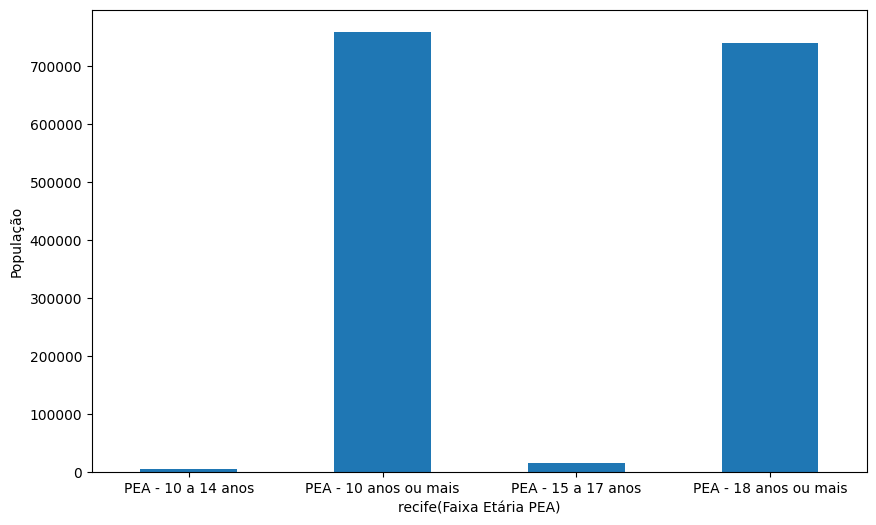

In [287]:
# Gráfico municipal Faixas etárias da PEA - Dúvidas sobre a relevância desses gráficos. Stand By

df = DF_Renda_e_Ocupação_Municipios.copy()

var1 = 'PEA - 10 a 14 anos'
var2 = 'PEA - 10 anos ou mais'
var3 = 'PEA - 15 a 17 anos'
var4 = 'PEA - 18 anos ou mais'
cols = [var1, var2, var3, var4]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, var4, 'Sexo', "Cor", 'Situação de Domicílio']]
df = df[(df['Sexo'] == "Total Sexo") & (df['Cor'] == "Total Cor") & (df['Situação de Domicílio'] == "Total Situação de Domicílio") ]
df.drop(['Sexo', "Cor", 'Situação de Domicílio'], axis = 1, inplace = True)


# Converte dtype da coluna para número
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

# Loop produz gráficos para cada município no DF
for munic in Municipios:
    df_loop = df

    # Filter df with munic
    df_loop = df_loop[df_loop['nome_municipio'] == munic]

    # Transpose the data frame
    df_loop = df_loop.set_index('nome_municipio').T

    # Create the bar chart
    ax = df_loop.plot(kind='bar', legend=False)

    # Set the x-axis tick labels
    ax.set_xticklabels(df_loop.index)

    # Edit the graph
    plt.xticks(rotation=0)
    plt.ticklabel_format(style='plain', axis='y')
    plt.ylabel('População')
    plt.xlabel(f'{munic}(Faixa Etária PEA)')

    #Save plot to save_path
    plt.savefig(f'{save_path}\\Bar_%_Jovens_na_Escola_{munic}')

    # Show the plot
    plt.show()


Gráfico municipal % de categorias de escolaridade entre ocupados 18 ou mais.

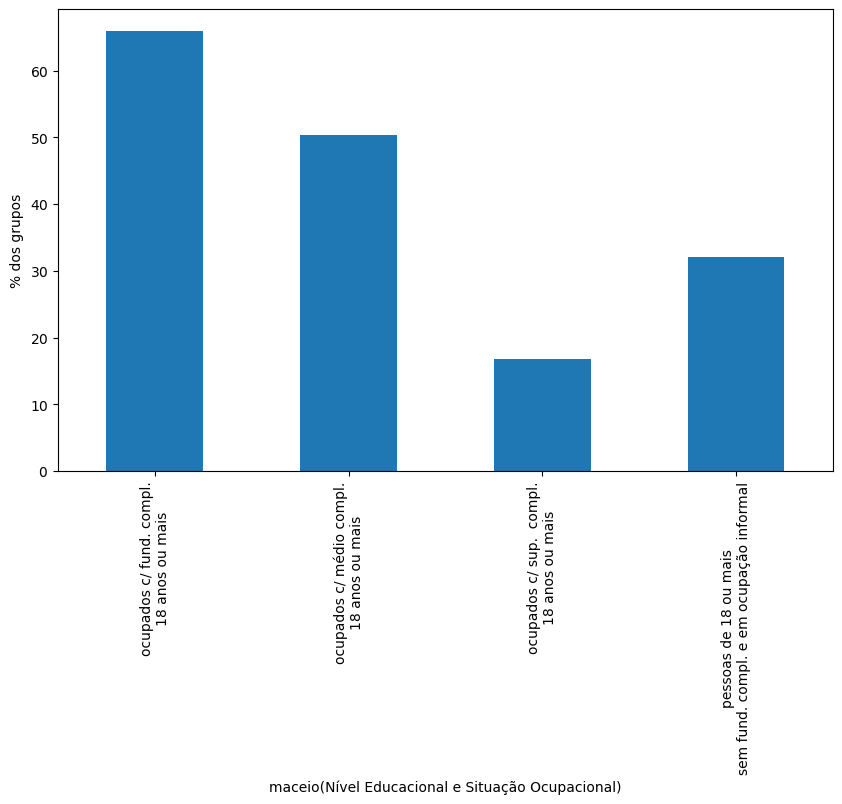

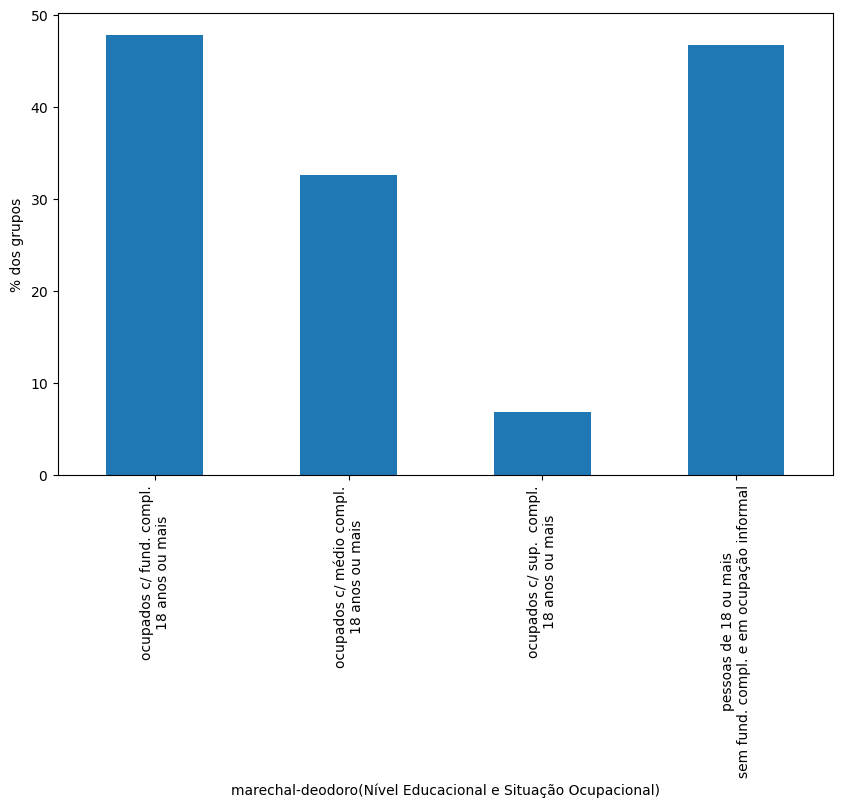

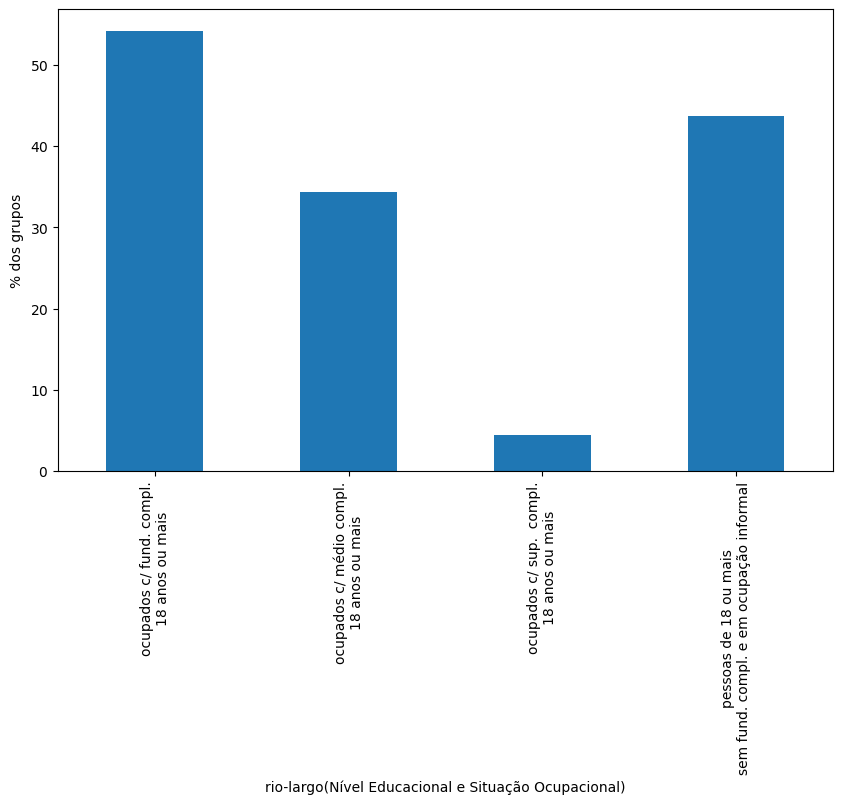

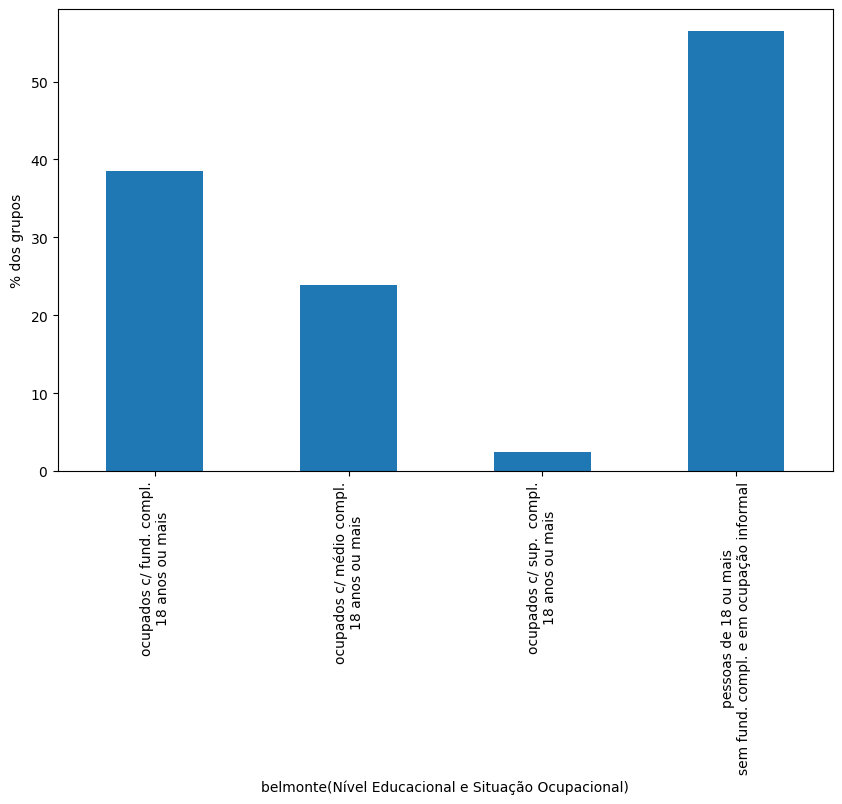

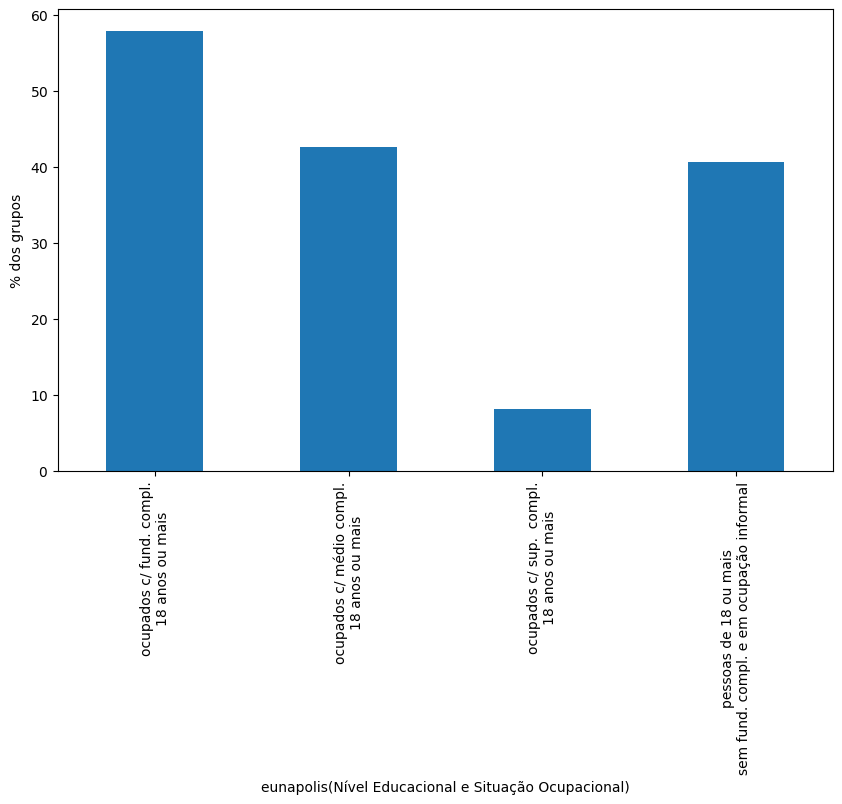

...

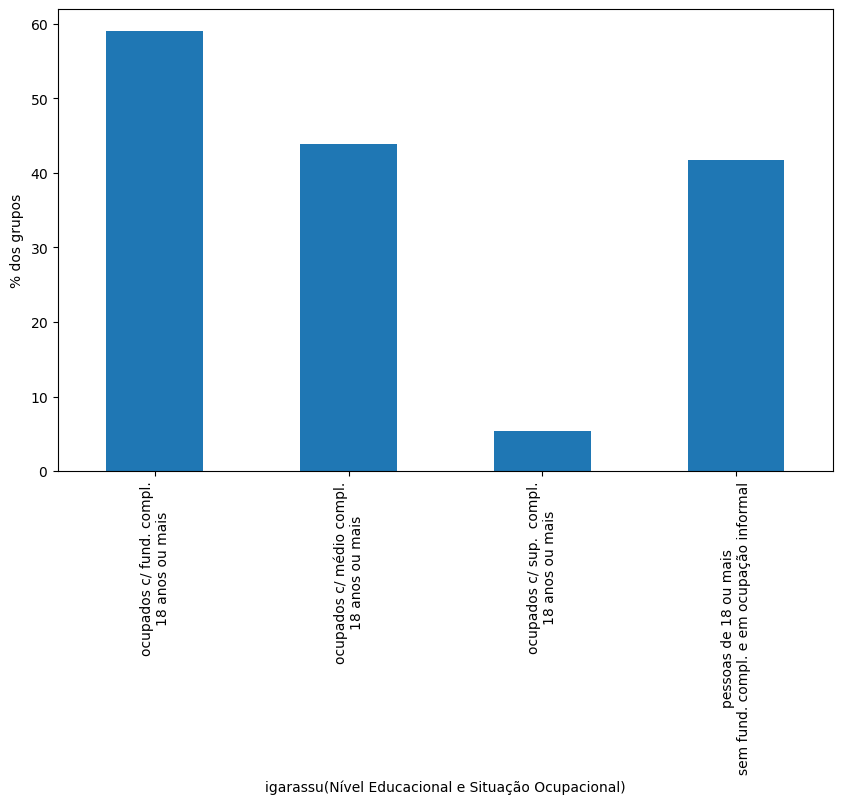

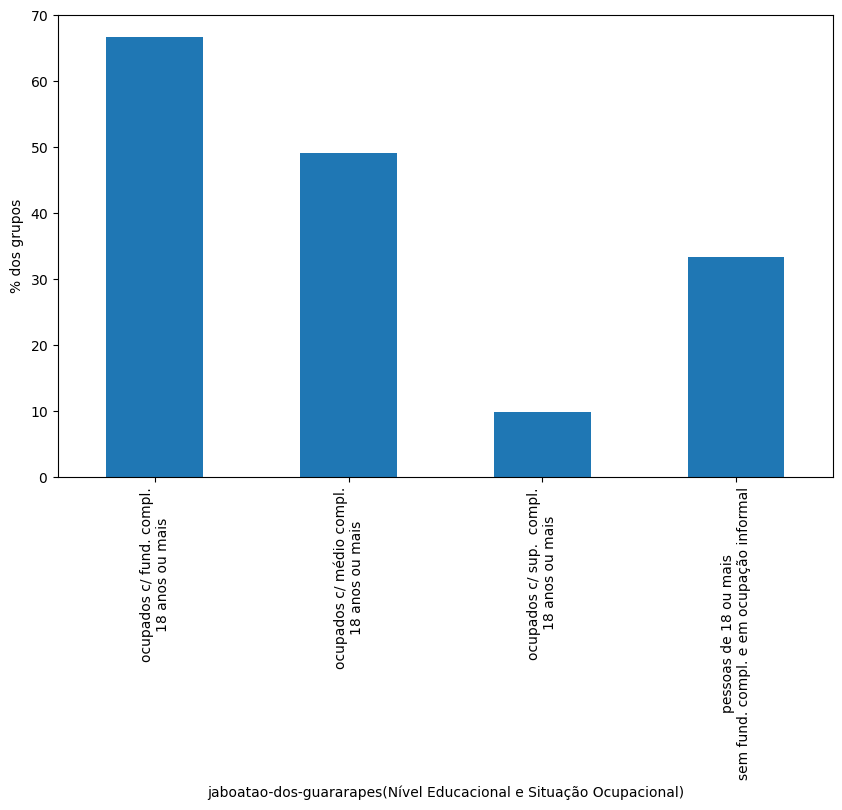

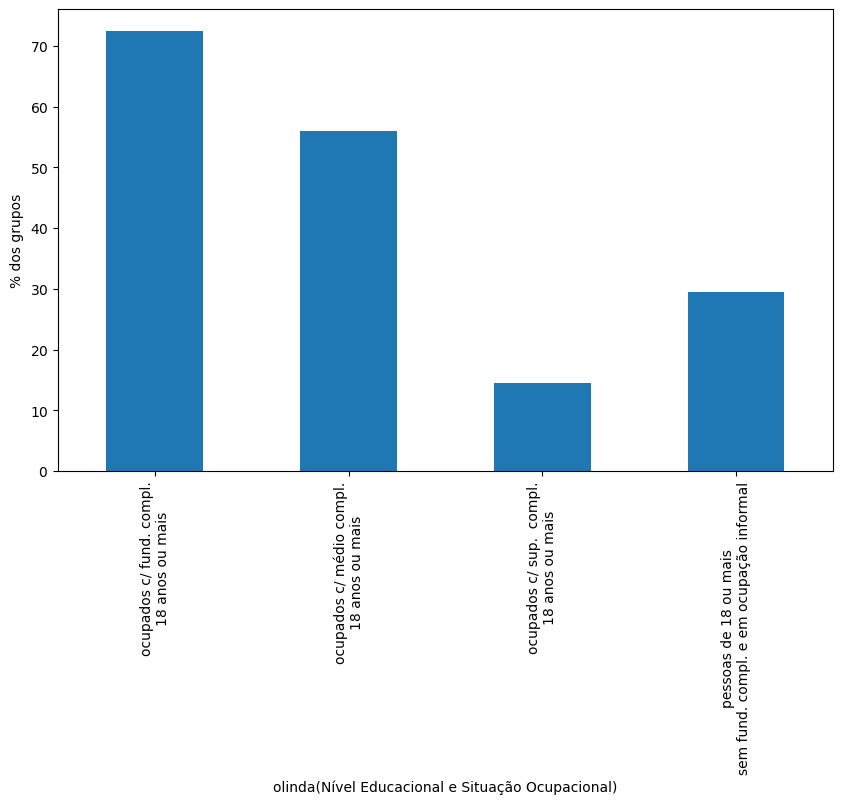

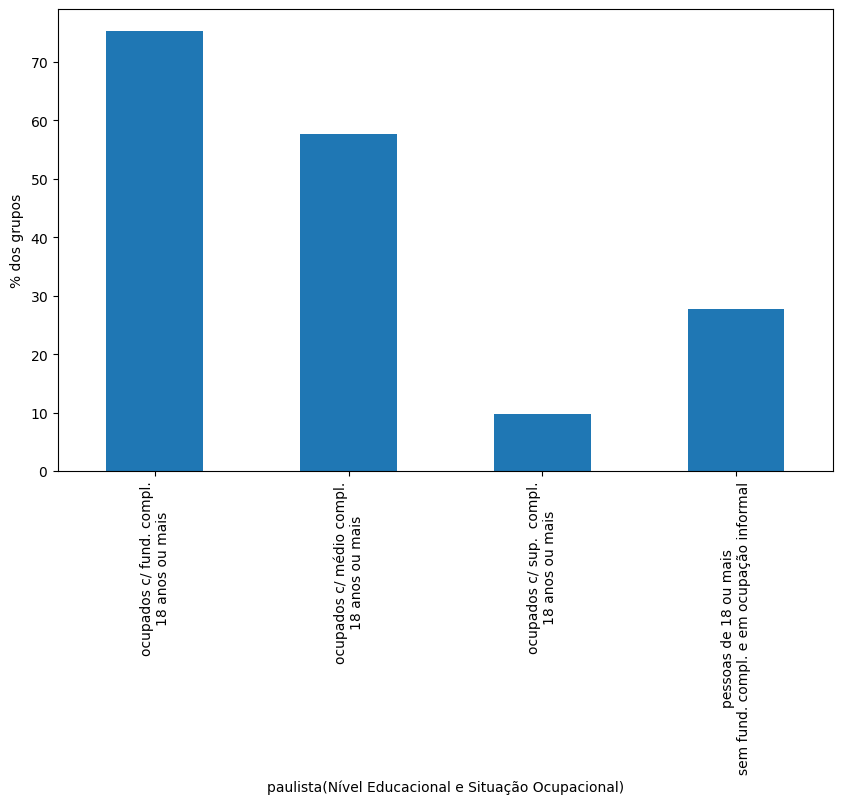

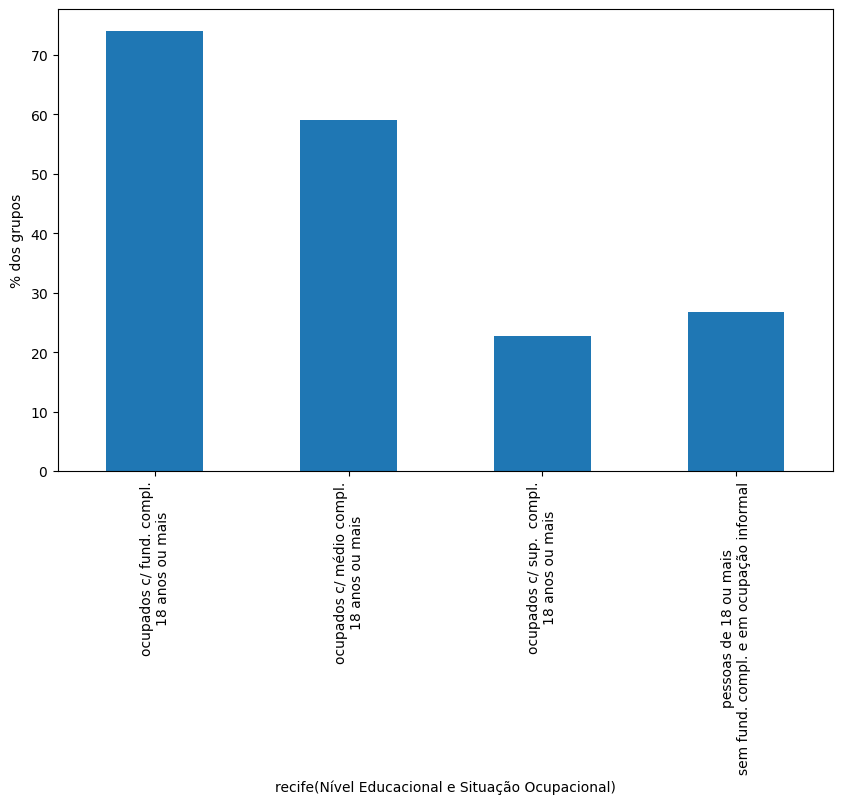

In [288]:
# Gráfico municipal % de categorias de escolaridade entre ocupados 18 ou mais.

df = DF_Renda_e_Ocupação_Municipios.copy()

var1 = '% dos ocupados com fundamental completo - 18 anos ou mais'
var2 = '% dos ocupados com médio completo - 18 anos ou mais'
var3 = '% dos ocupados com superior completo - 18 anos ou mais'
var4 = '% de pessoas de 18 anos ou mais sem fundamental completo e em ocupação informal'
# var5 = '% dos ocupados sem rendimento - 18 anos ou mais'
cols = [var1, var2, var3, var4]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, var4, 'Sexo', "Cor", 'Situação de Domicílio']]
df = df[(df['Sexo'] == "Total Sexo") & (df['Cor'] == "Total Cor") & (df['Situação de Domicílio'] == "Total Situação de Domicílio") ]
df.drop(['Sexo', "Cor", 'Situação de Domicílio'], axis = 1, inplace = True)

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

# Renomeia nomes de colunas adicionando quebra de linhas
df.rename({
        var1: 'ocupados c/ fund. compl.\n18 anos ou mais',
        var2: 'ocupados c/ médio compl.\n18 anos ou mais',
        var3: 'ocupados c/ sup.  compl.\n18 anos ou mais',
        var4: 'pessoas de 18 ou mais\nsem fund. compl. e em ocupação informal'
        }, axis = 1, inplace = True)

# Define set_munic como os que constam no df
set_munic = set(df['nome_municipio'].tolist())

# Loop produz gráficos para cada município no DF
for munic in Municipios:
   df_loop = df

   # Filter df with munic
   df_loop = df_loop[df_loop['nome_municipio'] == munic]

   # Transpose the data frame
   df_loop = df_loop.set_index('nome_municipio').T

   # Create the bar chart
   ax = df_loop.plot(kind='bar', legend=False)

   # Set the x-axis tick labels
   ax.set_xticklabels(df_loop.index)

   # Edit the graph
   plt.xticks(rotation=90)
   # plt.ticklabel_format(style='plain', axis='x')
   plt.gca().yaxis.set_major_formatter(ScalarFormatter(useMathText=True))
   plt.ylabel('% dos grupos')
   plt.xlabel(f'{munic}(Nível Educacional e Situação Ocupacional)')

   # Save plot to save_path
   plt.savefig(f'{save_path}\\Bar_%_Nível_Educacional_Situação_Ocupacional_{munic}')

   # Show the plot
   plt.show()

Gráfico municipal % empregados com e sem carteira

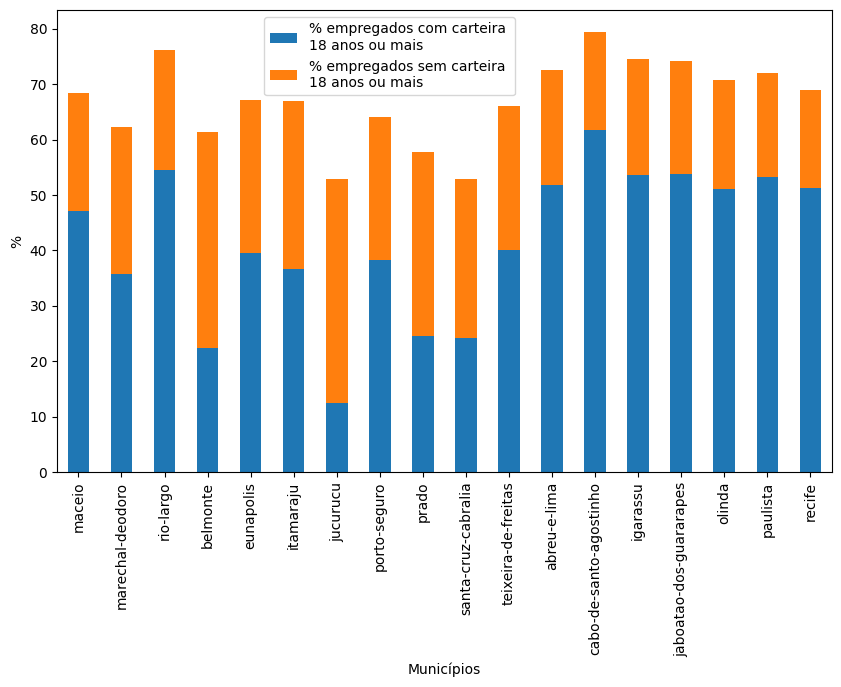

In [289]:
# Gráfico municipal % empregados com e sem carteira

df = DF_Renda_e_Ocupação_Municipios.copy()

var1 = '% de empregados com carteira - 18 anos ou mais'
var2 = '% de empregados sem carteira - 18 anos ou mais'
cols = [var1, var2]

# Resume df necessário
df = df[['nome_municipio', var1, var2, 'Sexo', "Cor", 'Situação de Domicílio']]
df = df[(df['Sexo'] == "Total Sexo") & (df['Cor'] == "Total Cor") & (df['Situação de Domicílio'] == "Total Situação de Domicílio") ]
df.drop(['Sexo', "Cor", 'Situação de Domicílio'], axis = 1, inplace = True)

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

# Renomeia nomes de colunas adicionando quebra de linhas
df.rename({
        var1: '% empregados com carteira\n18 anos ou mais',
        var2: '% empregados sem carteira \n18 anos ou mais',
        }, axis = 1, inplace = True)

# Plota stacked bar graph
df.plot(
        x = 'nome_municipio',
        y = [
            '% empregados com carteira\n18 anos ou mais',
            '% empregados sem carteira \n18 anos ou mais',            
            ],
        kind = 'bar',
        stacked = True
        )
plt.xlabel('Municípios')
plt.ylabel('%')
plt.legend(bbox_to_anchor=(.6,1), loc='best')

save_graph('Bar_% Empregados com e sem carteira', 'Municipios')


##### Plots: DF_Renda_Detalhada_91_10_AL_BA_PE

Gráfico municipal Renda Domiciliar por Quintiles e décimo mais rico (O.K)

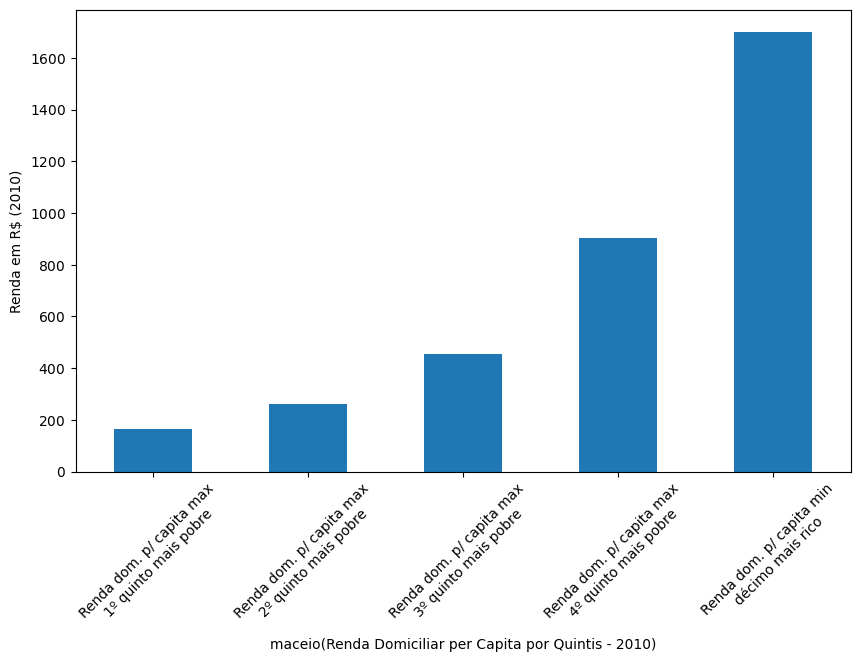

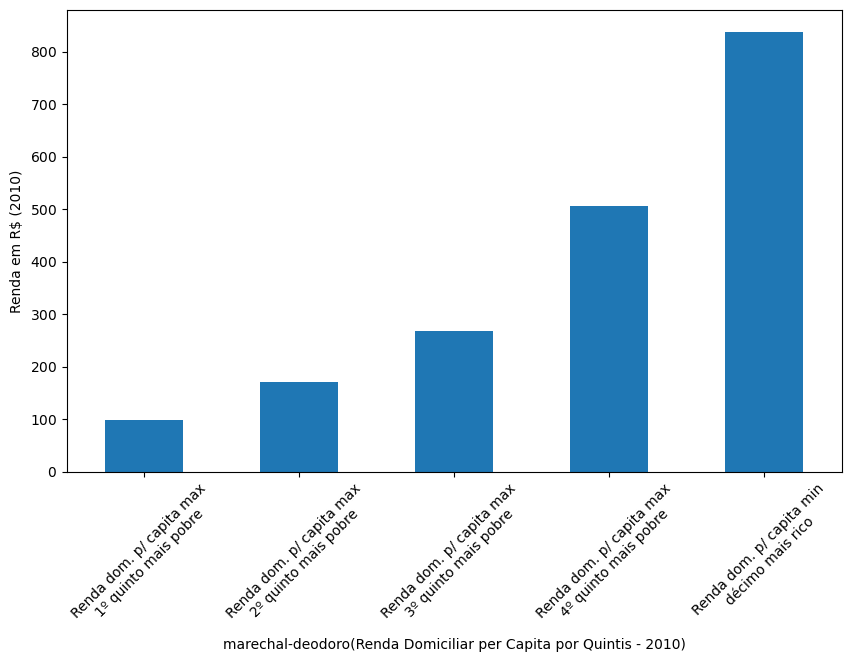

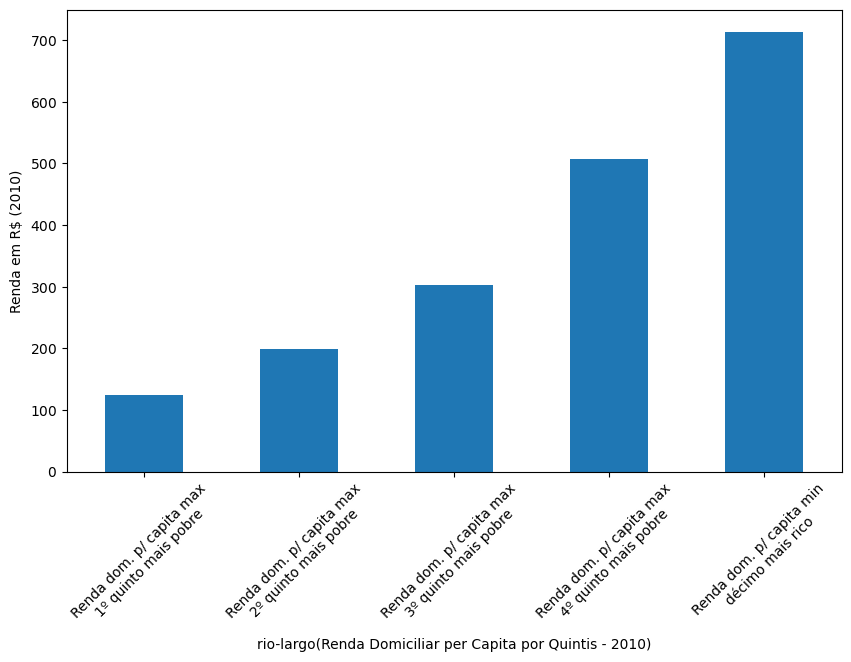

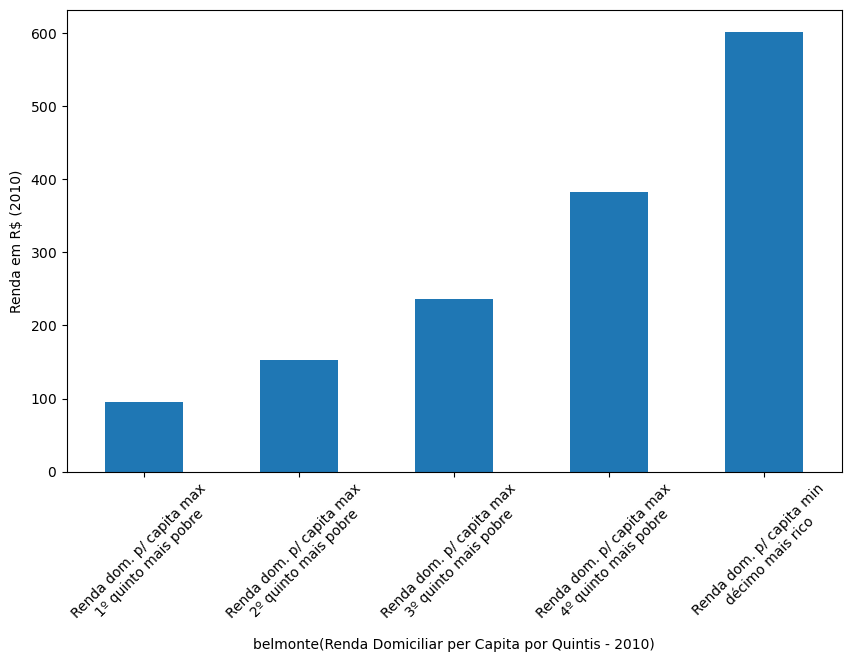

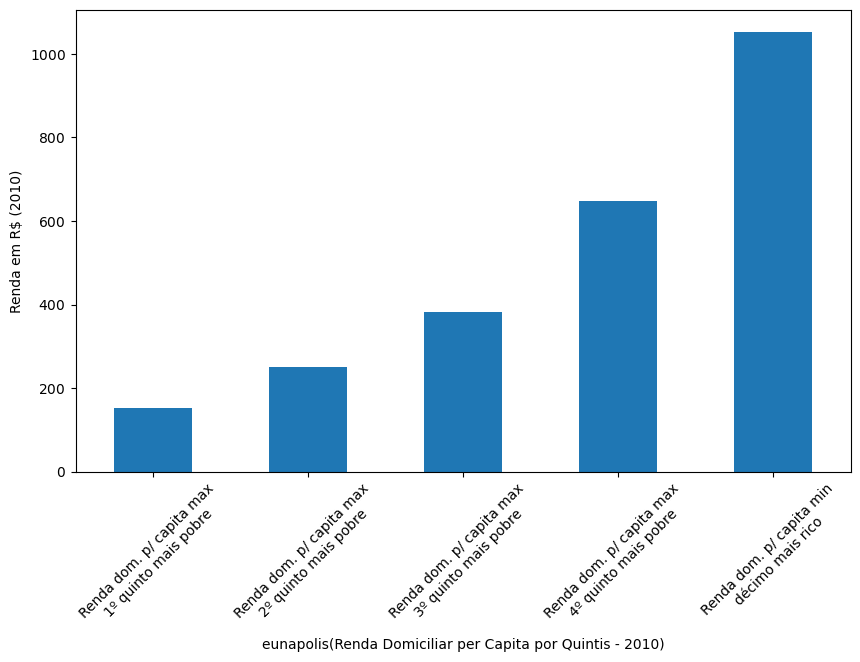

...

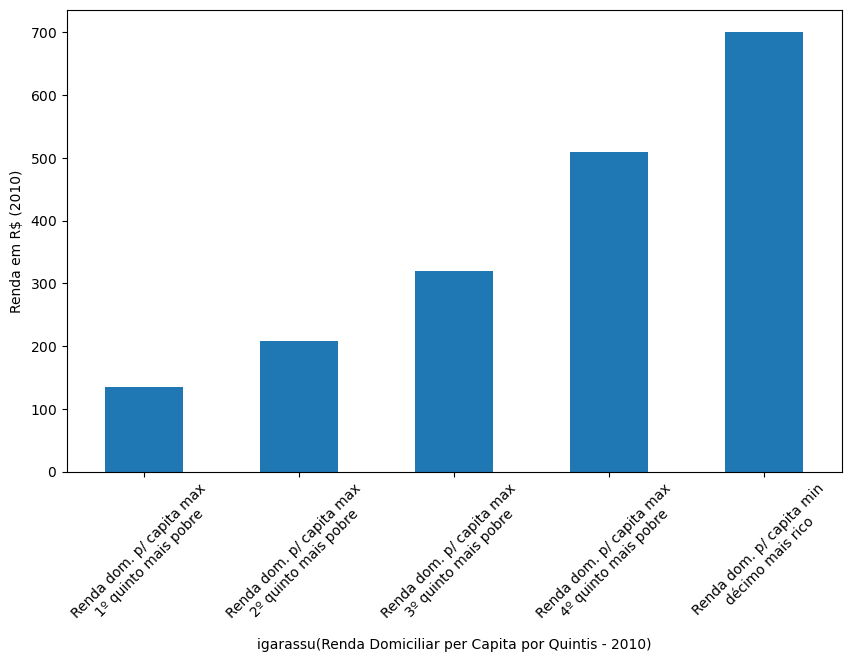

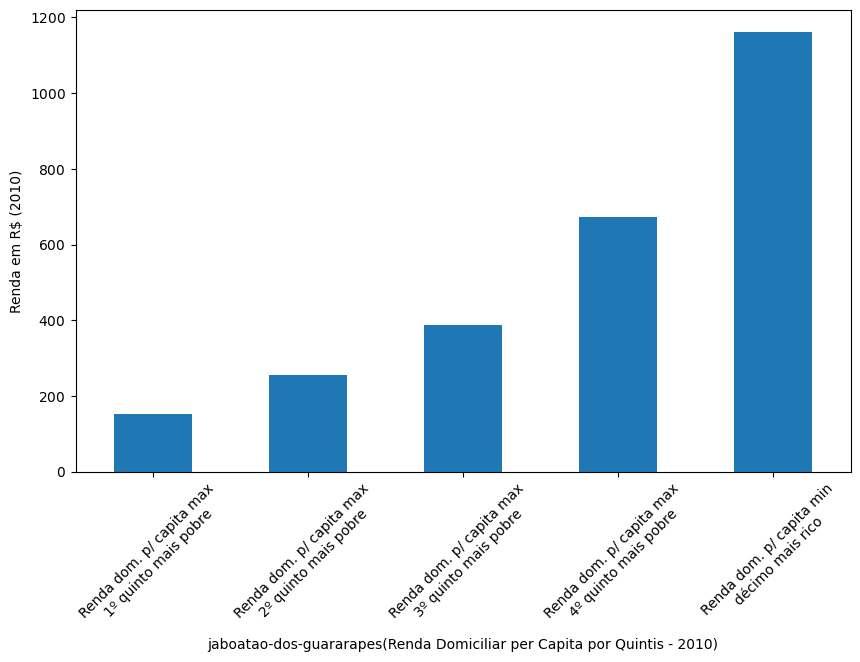

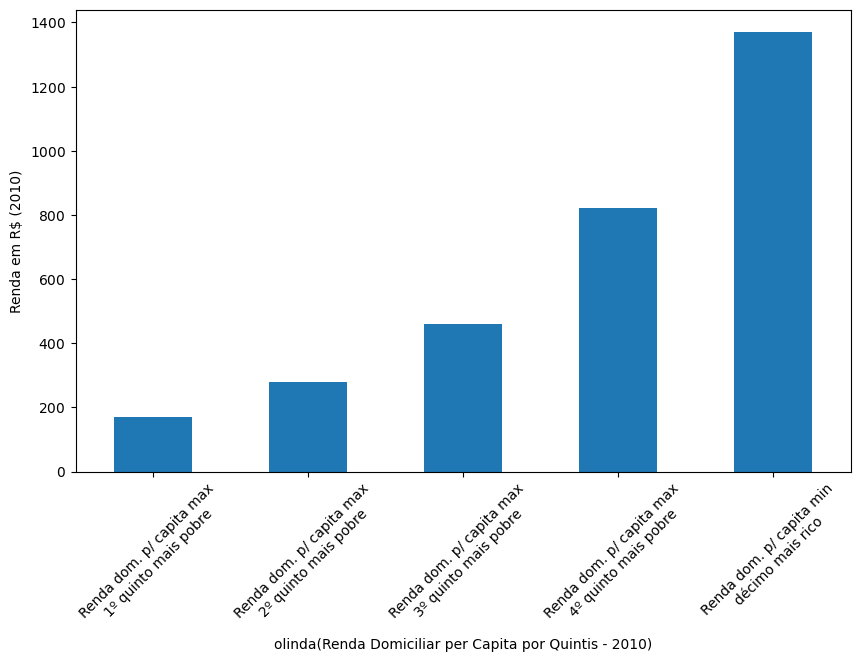

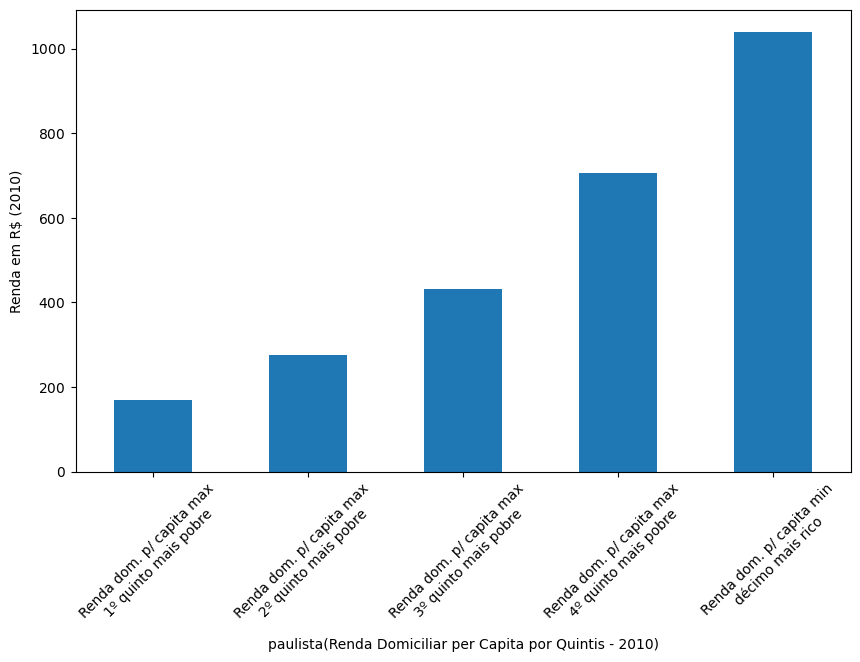

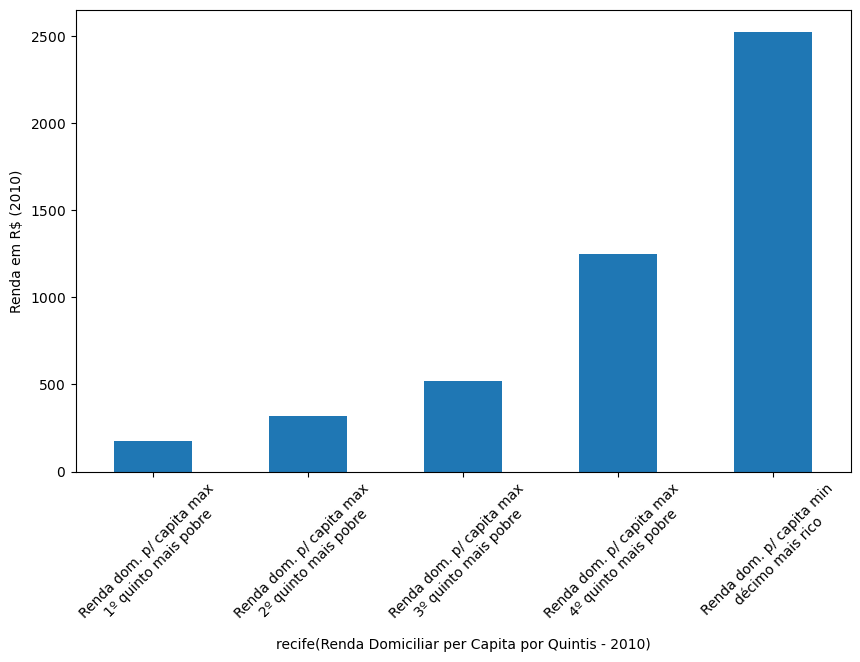

In [291]:
# Gráfico municipal Renda Domiciliar por Quintiles e décimo mais rico

df = DF_Renda_Detalhada_91_10_AL_BA_PE.copy()

var1 = 'Renda domiciliar per capita máxima do 1º quinto mais pobre 2010'
var2 = 'Renda domiciliar per capita máxima do 2º quinto mais pobre 2010'
var3 = 'Renda domiciliar per capita máxima do 3º quinto mais pobre 2010'
var4 = 'Renda domiciliar per capita máxima do 4º quinto mais pobre 2010'
var5 = 'Renda domiciliar per capita mínima do décimo mais rico 2010'
cols = [var1, var2, var3, var4, var5]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, var4, var5]]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

# Renomeia nomes de colunas adicionando quebra de linhas
df.rename({
        var1: 'Renda dom. p/ capita max\n1º quinto mais pobre',
        var2: 'Renda dom. p/ capita max\n2º quinto mais pobre',
        var3: 'Renda dom. p/ capita max\n3º quinto mais pobre',
        var4: 'Renda dom. p/ capita max\n4º quinto mais pobre',
        var5: 'Renda dom. p/ capita min\ndécimo mais rico'
        }, axis = 1, inplace = True)

# Define save path para armazenamento dos plots
save_path = 'C:\\Users\\João Flavio\\Desktop\\Code\\PyProjects\\Leonard\\Saved Graphs'

# Define set_munic como os que constam no df
set_munic = set(df['nome_municipio'].tolist())

# Loop produz gráficos para cada município no DF
for munic in Municipios:
   df_loop = df

   # Filter df with munic
   df_loop = df_loop[df_loop['nome_municipio'] == munic]

   # Transpose the data frame
   df_loop = df_loop.set_index('nome_municipio').T

   # Create the bar chart
   ax = df_loop.plot(kind='bar', legend=False)

   # Set the x-axis tick labels
   ax.set_xticklabels(df_loop.index)

   # Edit the graph
   plt.xticks(rotation=45)
   # plt.ticklabel_format(style='plain', axis='x')
   plt.gca().yaxis.set_major_formatter(ScalarFormatter(useMathText=True))
   plt.ylabel('Renda em R$ (2010)')
   plt.xlabel(f'{munic}(Renda Domiciliar per Capita por Quintis - 2010)')

   # Save plot to save_path
   plt.savefig(f'{save_path}\\Bar_Renda Domiciliar por Quintis - 2010_{munic}', dpi = 300, bbox_inches = 'tight')

   # Show the plot
   plt.show()

##### Plots: DF_Estratificação_Renda_91_10_AL_BA_PE

Gráfico Municipal população dos quintis de renda domiciliar per capita #! Esses valores tão estranhos, não vou confiar nesse df. Stand By

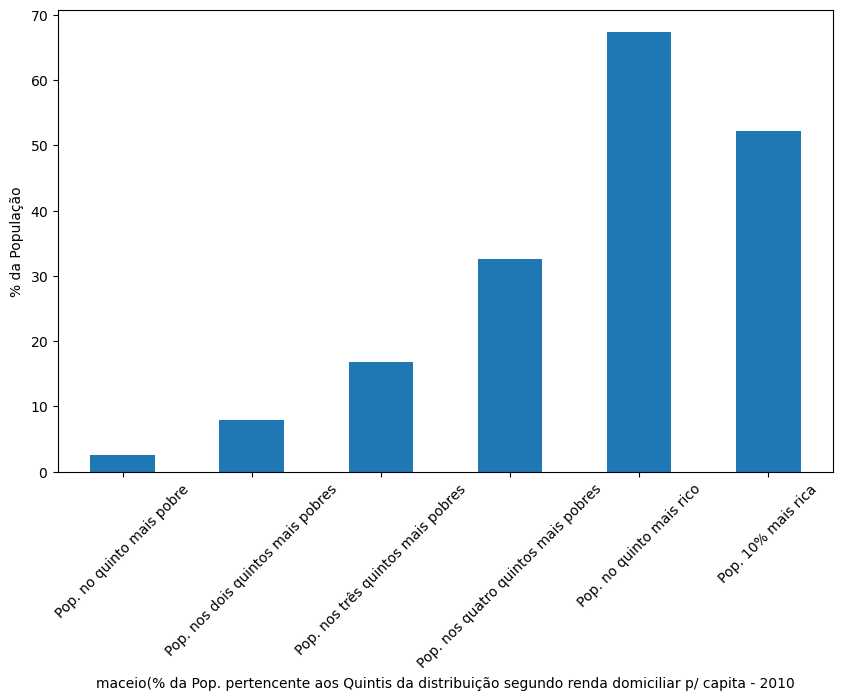

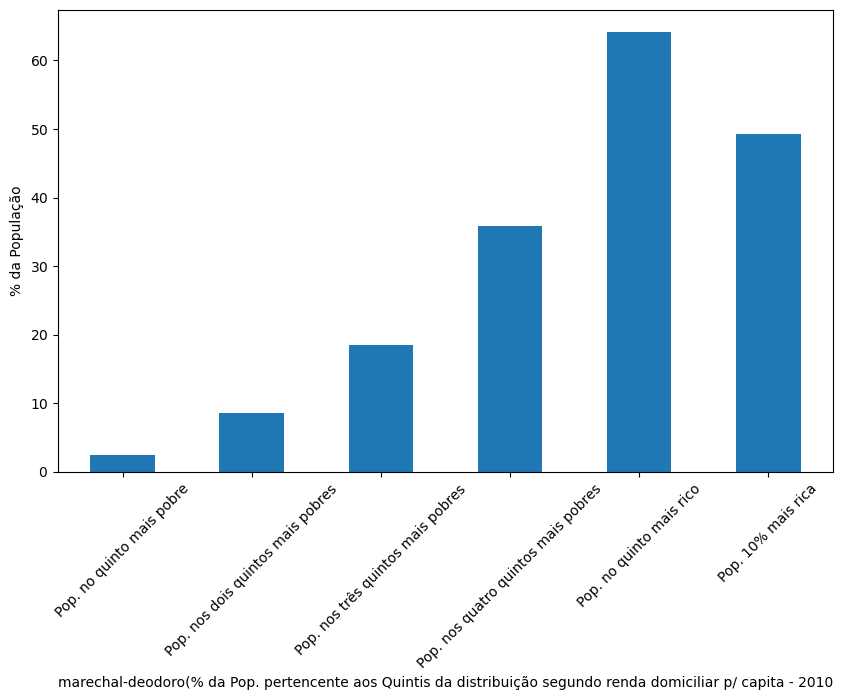

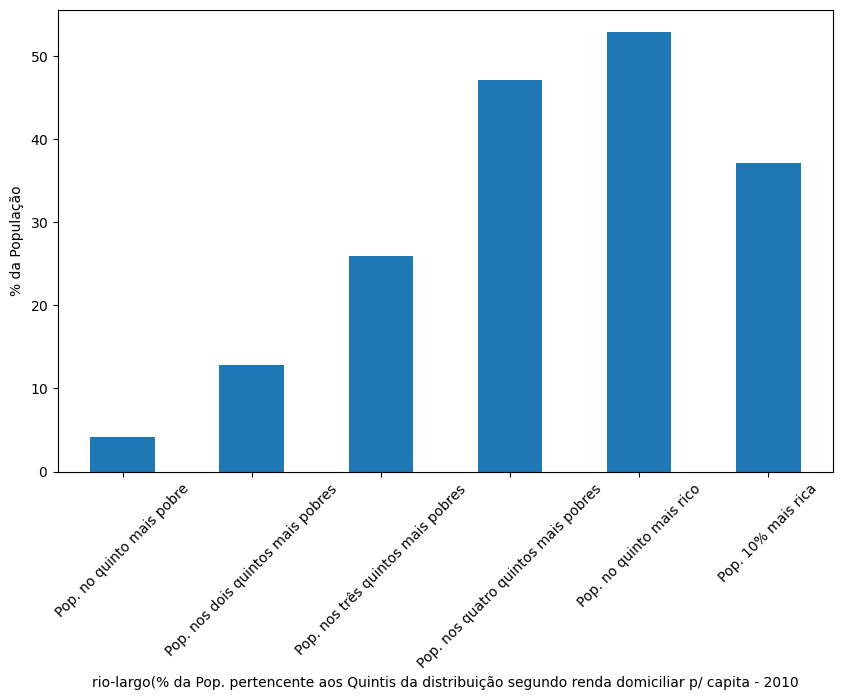

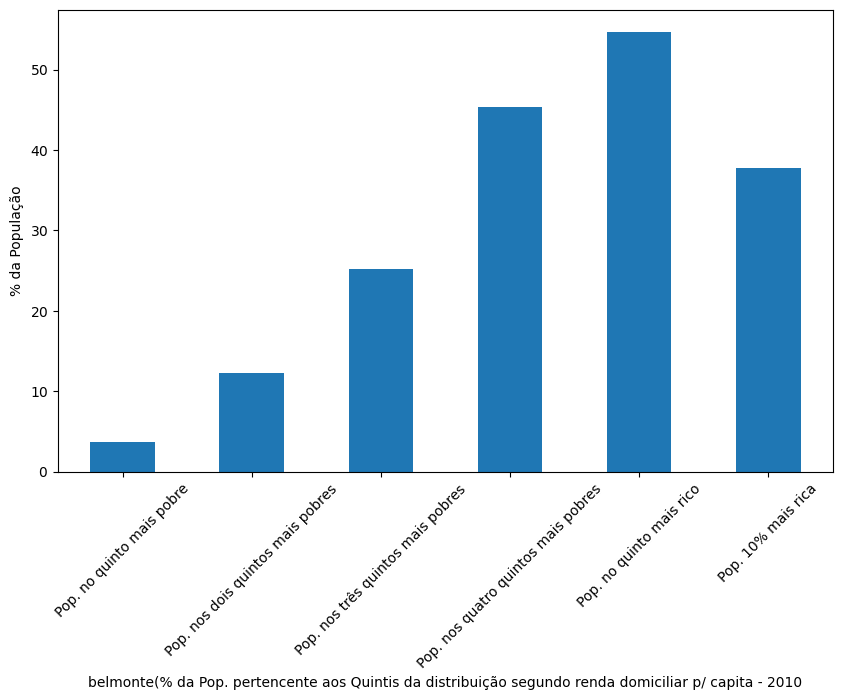

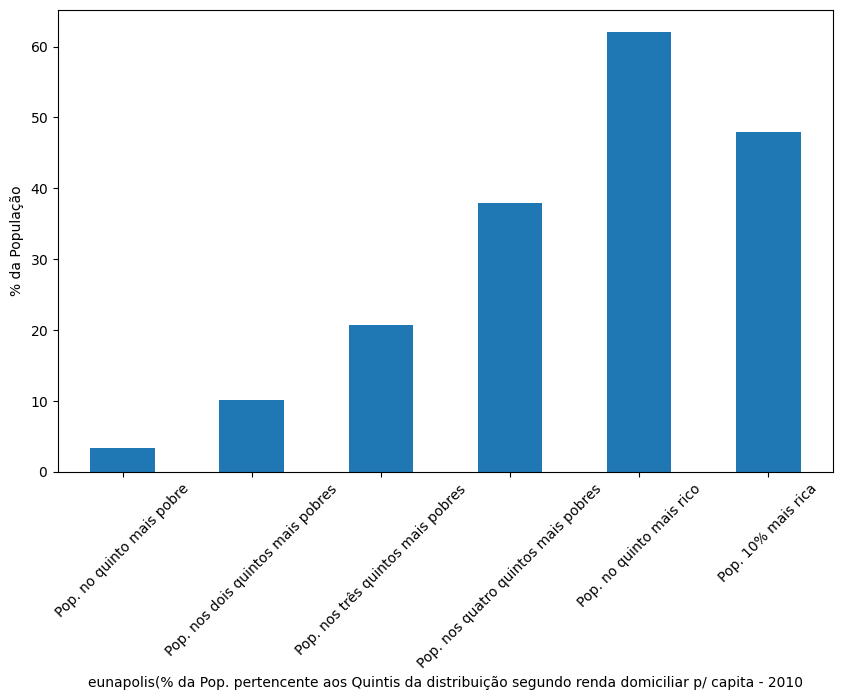

...

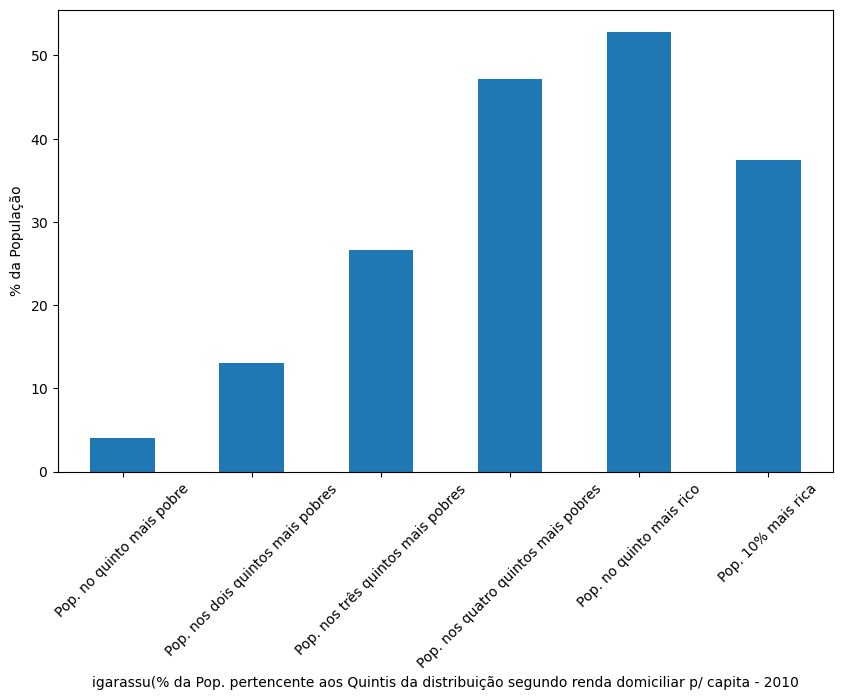

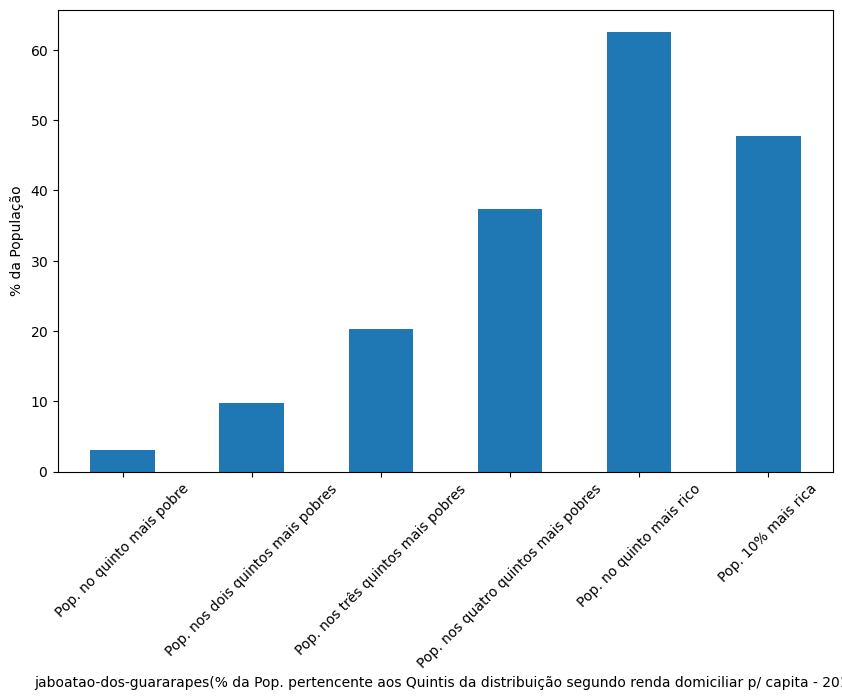

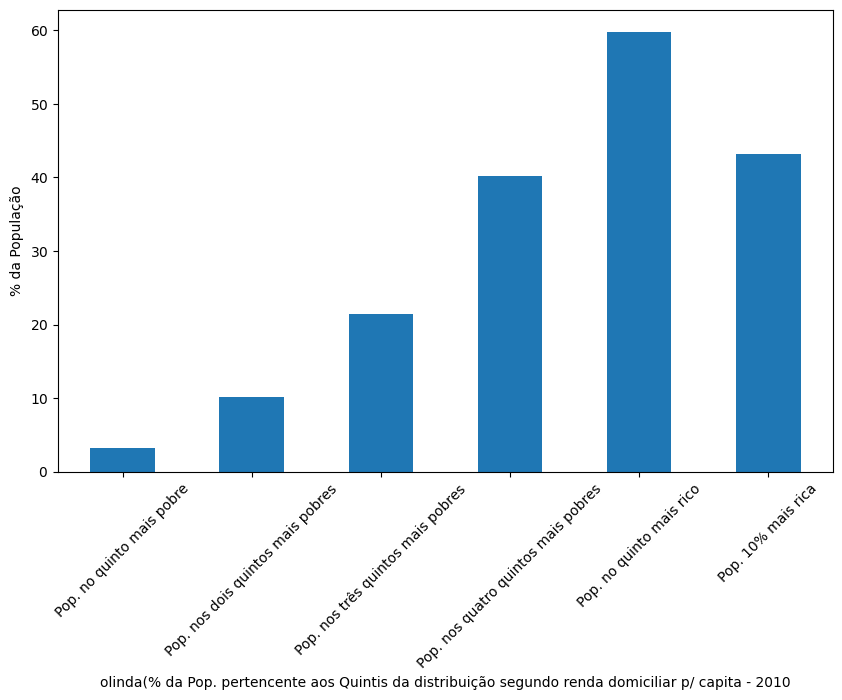

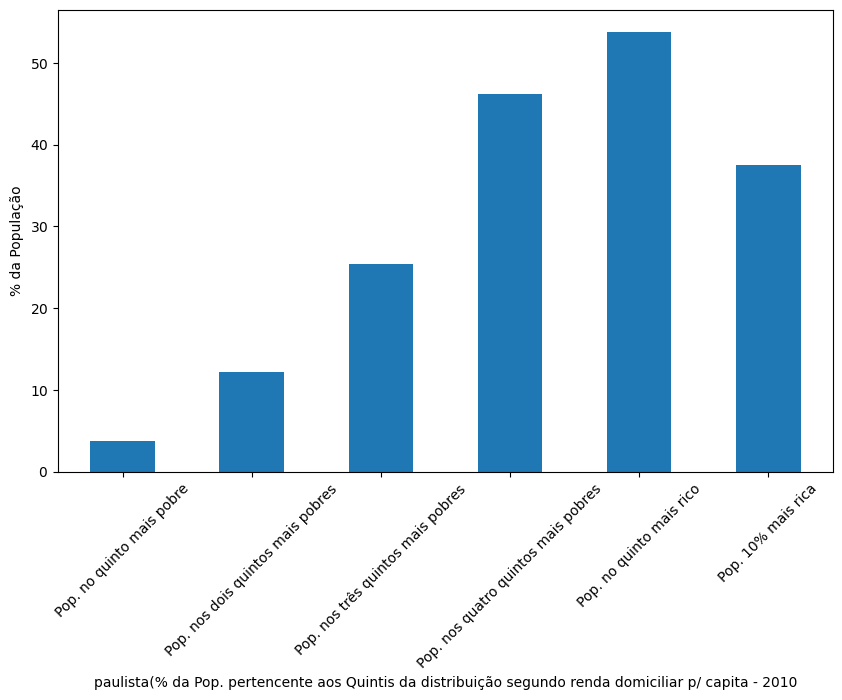

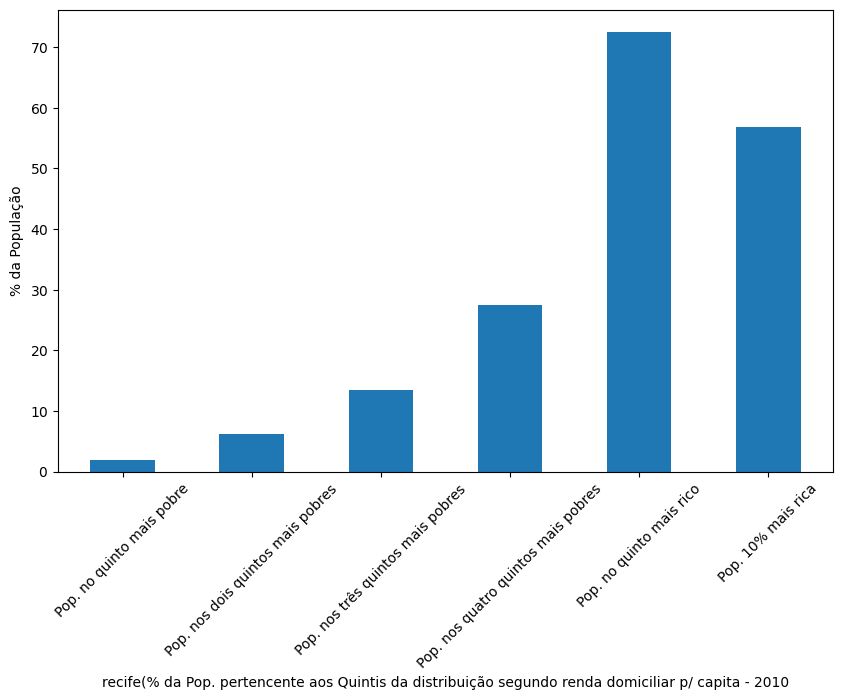

In [292]:
# Gráfico Municipal população dos quintis de renda domiciliar per capita #! Esses valores tão estranhos, não vou confiar nesse df. Stand By

df = DF_Estratificação_Renda_91_10_AL_BA_PE.copy()

var1 = '% indivíduos pertencentes ao quinto mais pobre da distribuição dos indivíduos segundo a renda domiciliar per capita 2010'
var2 = '% indivíduos pertencentes aos dois quintos mais pobres da distribuição dos indivíduos segundo a renda domiciliar per capita 2010'
var3 = '% indivíduos pertencentes aos três quintos mais pobres da distribuição dos indivíduos segundo a renda domiciliar per capita 2010'
var4 = '% indivíduos pertencentes aos quatro quintos mais pobres da distribuição dos indivíduos segundo a renda domiciliar per capita 2010'
var5 = '% indivíduos pertencentes ao quinto mais rico da distribuição dos indivíduos segundo a renda domiciliar per capita 2010'
var6 = '10% mais ricos 2010'
cols = [var1, var2, var3, var4, var5, var6]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, var4, var5, var6]]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

# Renomeia nomes de colunas adicionando quebra de linhas
df.rename({
        var1: 'Pop. no quinto mais pobre',
        var2: 'Pop. nos dois quintos mais pobres',
        var3: 'Pop. nos três quintos mais pobres',
        var4: 'Pop. nos quatro quintos mais pobres',
        var5: 'Pop. no quinto mais rico',
        var6: 'Pop. 10% mais rica'
        }, axis = 1, inplace = True)

# Define set_munic como os que constam no df
set_munic = set(df['nome_municipio'].tolist())

# Loop produz gráficos para cada município no DF
for munic in Municipios:
   df_loop = df

   # Filter df with munic
   df_loop = df_loop[df_loop['nome_municipio'] == munic]

   # Transpose the data frame
   df_loop = df_loop.set_index('nome_municipio').T

   # Create the bar chart
   ax = df_loop.plot(kind='bar', legend=False)

   # Set the x-axis tick labels
   ax.set_xticklabels(df_loop.index)

   # Edit the graph
   plt.xticks(rotation=45)
   # plt.ticklabel_format(style='plain', axis='x')
   plt.gca().yaxis.set_major_formatter(ScalarFormatter(useMathText=True))
   plt.ylabel('% da População')
   plt.xlabel(f'{munic}(% da Pop. pertencente aos Quintis da distribuição segundo renda domiciliar p/ capita - 2010')

   # Save plot to save_path
#    plt.savefig(f'{save_path}\\Bar_Renda Domiciliar por Quintis - 2010_{munic}')

   # Show the plot
   plt.show()

Gráfico Municipal % dos ocupados por faixa salarial (O.K)

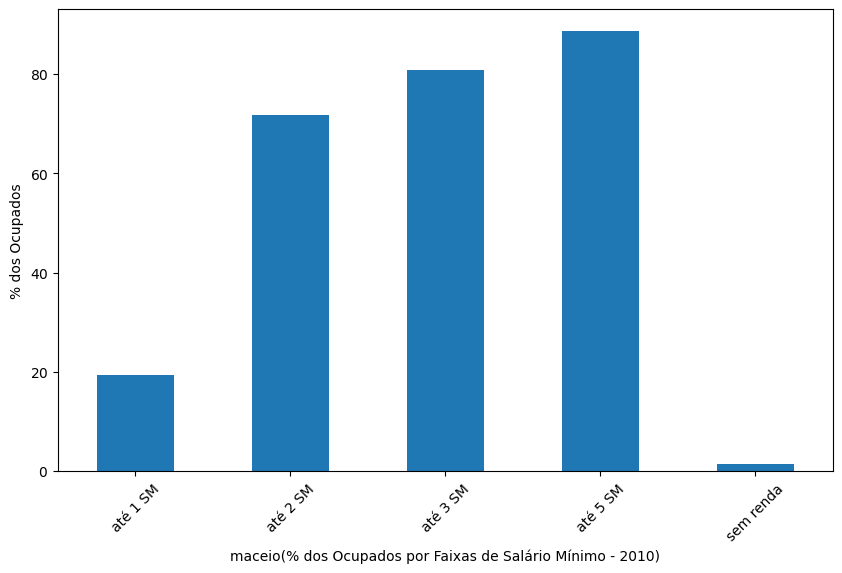

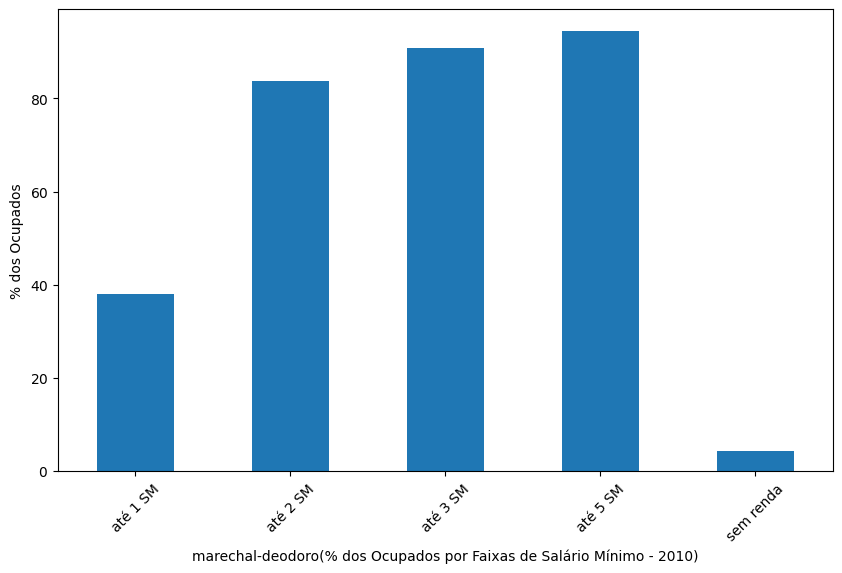

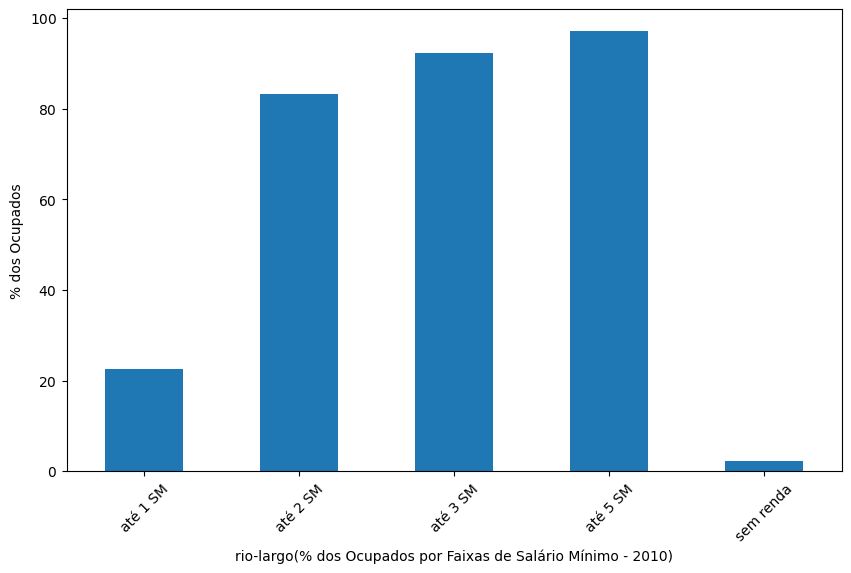

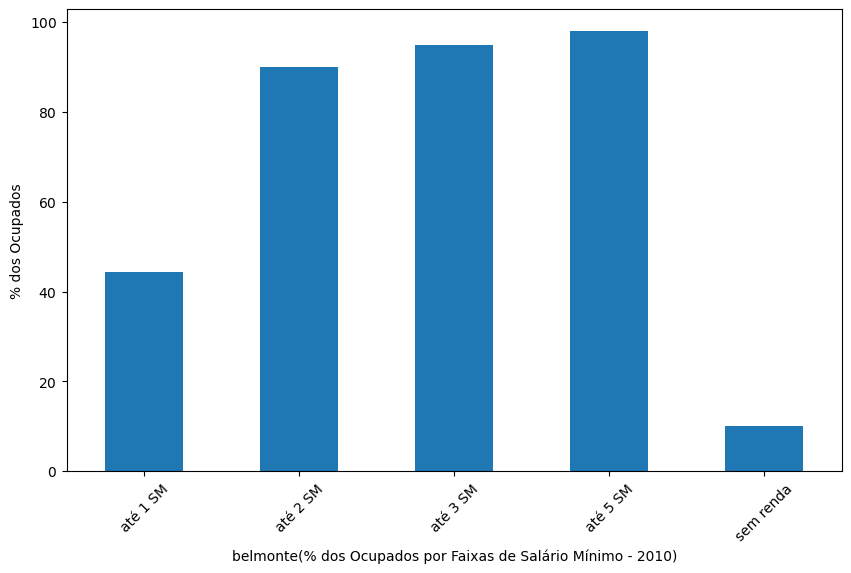

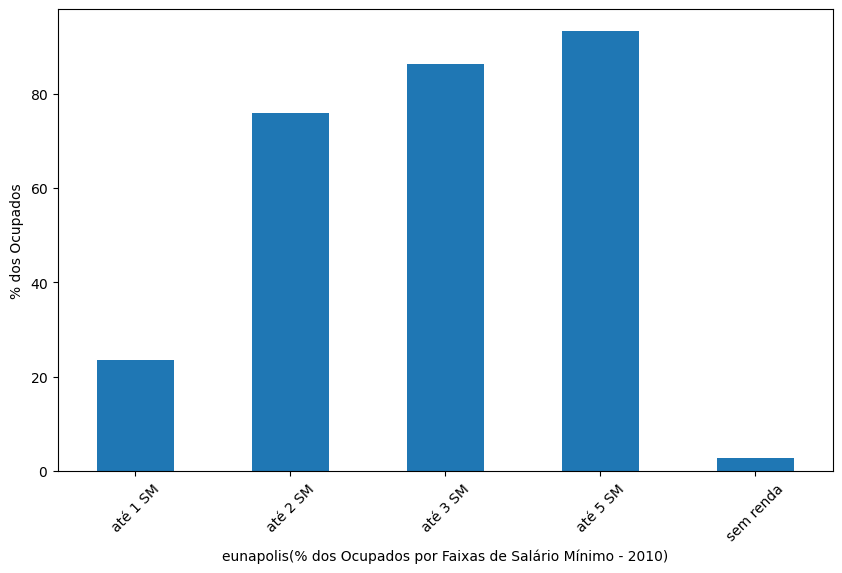

...

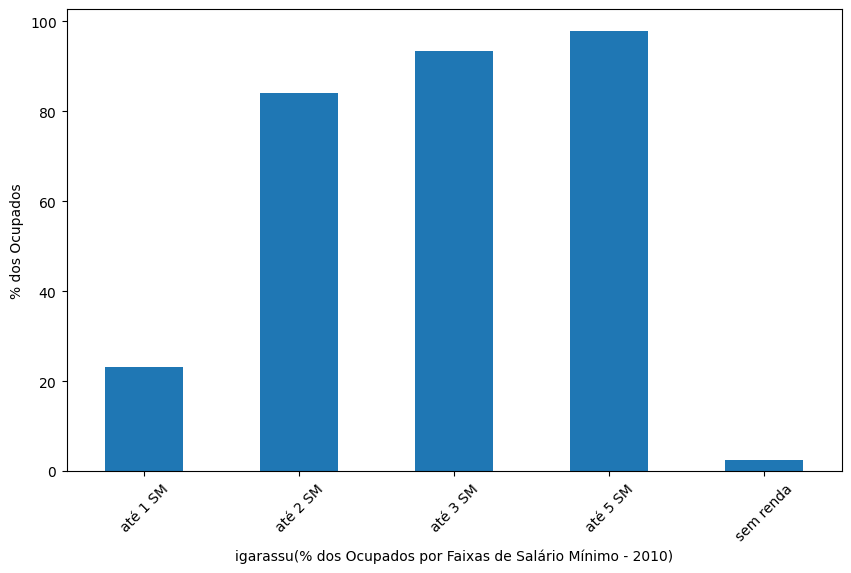

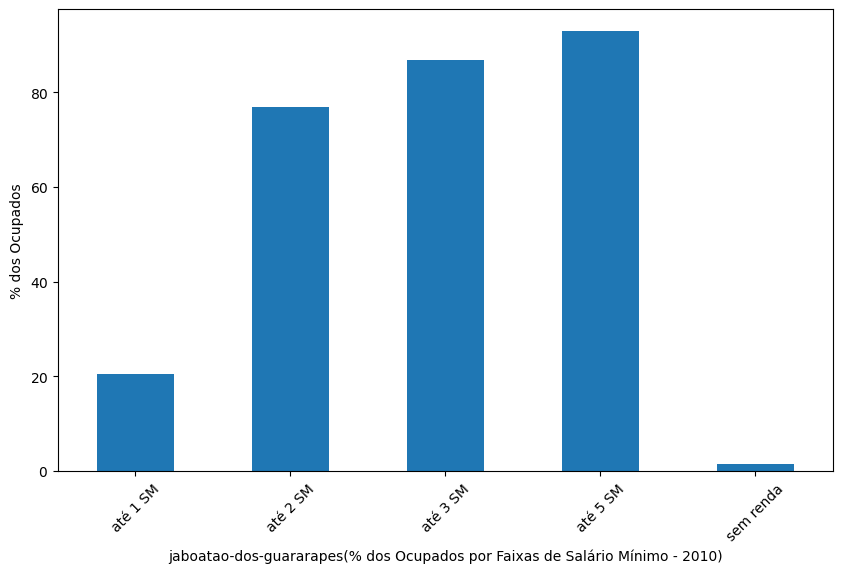

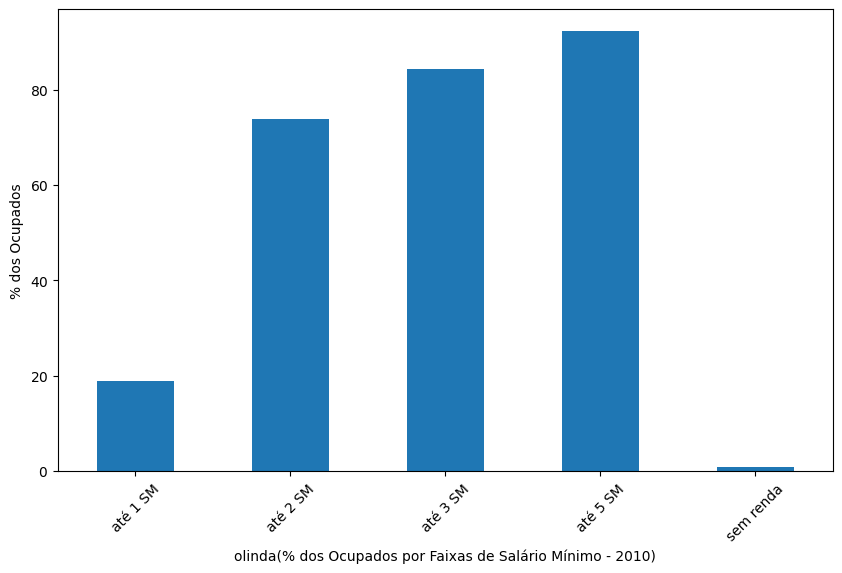

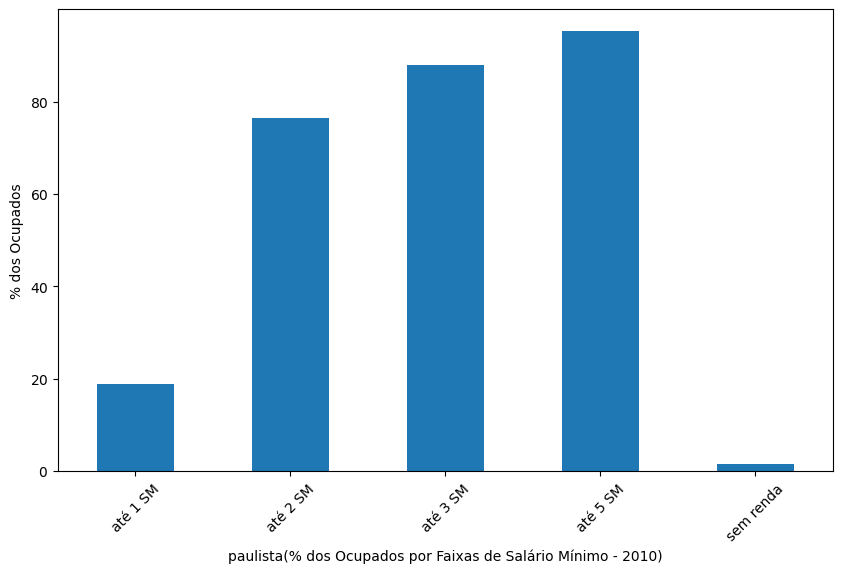

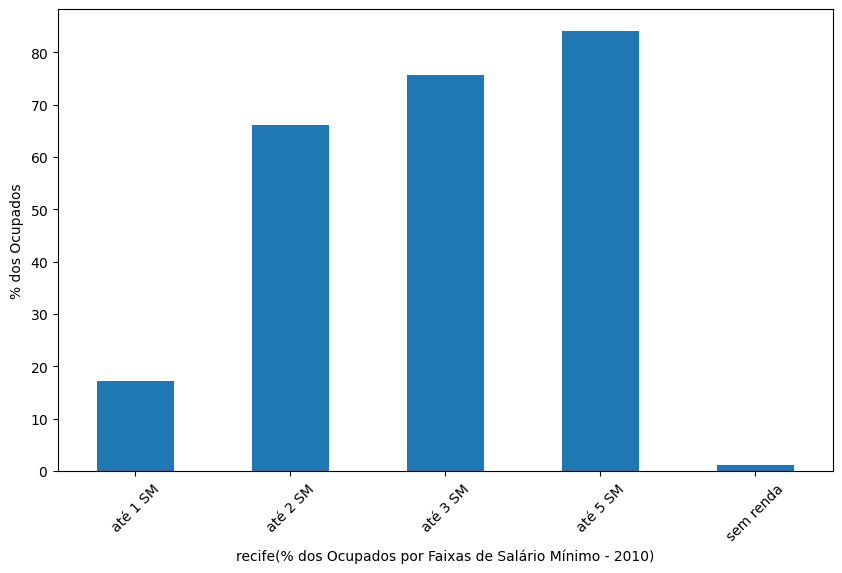

In [293]:
# Gráfico Municipal % dos ocupados por faixa salarial

df = DF_Estratificação_Renda_91_10_AL_BA_PE.copy()

var1 = '% dos ocupados com rendimento de até 1 salário mínimo 2010'
var2 = '% dos ocupados com rendimento de até 2 salários mínimo 2010'
var3 = '% dos ocupados com rendimento de até 3 salários mínimo 2010'
var4 = '% dos ocupados com rendimento de até 5 salários mínimo 2010'
var5 = '% dos ocupados sem rendimento 2010'
cols = [var1, var2, var3, var4, var5]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, var4, var5]]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

# Renomeia nomes de colunas adicionando quebra de linhas
df.rename({
        var1: 'até 1 SM',
        var2: 'até 2 SM',
        var3: 'até 3 SM',
        var4: 'até 5 SM',
        var5: 'sem renda'
        }, axis = 1, inplace = True)

# Define set_munic como os que constam no df
set_munic = set(df['nome_municipio'].tolist())

# Loop produz gráficos para cada município no DF
for munic in Municipios:
   df_loop = df

   # Filter df with munic
   df_loop = df_loop[df_loop['nome_municipio'] == munic]

   # Transpose the data frame
   df_loop = df_loop.set_index('nome_municipio').T

   # Create the bar chart
   ax = df_loop.plot(kind='bar', legend=False)

   # Set the x-axis tick labels
   ax.set_xticklabels(df_loop.index)

   # Edit the graph
   plt.xticks(rotation=45)
   # plt.ticklabel_format(style='plain', axis='x')
   plt.gca().yaxis.set_major_formatter(ScalarFormatter(useMathText=True))
   plt.ylabel('% dos Ocupados')
   plt.xlabel(f'{munic}(% dos Ocupados por Faixas de Salário Mínimo - 2010)')

   # Save plot to save_path
   plt.savefig(f'{save_path}\\Bar_% dos Ocupados por Faixas de Salário Mínimo - 2010_{munic}', dpi = 300, bbox_inches='tight' )

   # Show the plot
   plt.show()


##### Plots: DF_Medidas_Desigualdade_Censo_91_10_AL_BA_PE APRENDER GRAFICO LINHA VOLTAR NO FINAL

Gráfico comparativo 'Índice de Gini 2010'

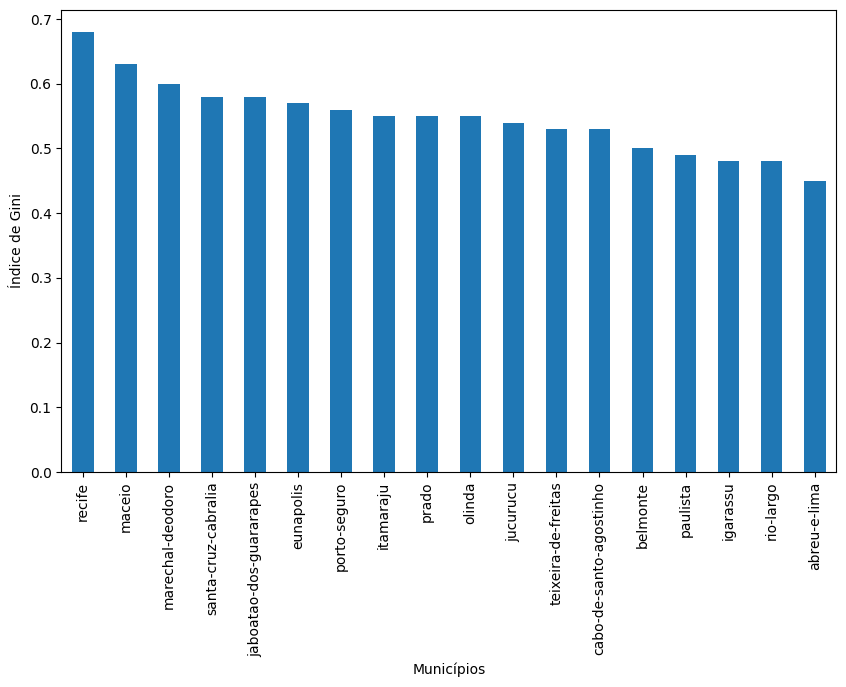

In [294]:
# Gráfico comparativo 'Índice de Gini 2010'

df = DF_Medidas_Desigualdade_Censo_91_10_AL_BA_PE.copy()

cols = ['Índice de Gini 2010']

# Resume df necessário
df = df[['nome_municipio', 'Índice de Gini 2010']]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

df = df.sort_values('Índice de Gini 2010', ascending = False)

df.plot(
        x = 'nome_municipio',
        y = 'Índice de Gini 2010',
        kind = 'bar',
        legend = False
        )
plt.xlabel('Municípios')
plt.ylabel('Índice de Gini')

save_graph('Bar_Indice de Gini', 'Municipios')

Gráfico comparativo 'Razão 10% mais ricos / 40% mais pobres 2010'

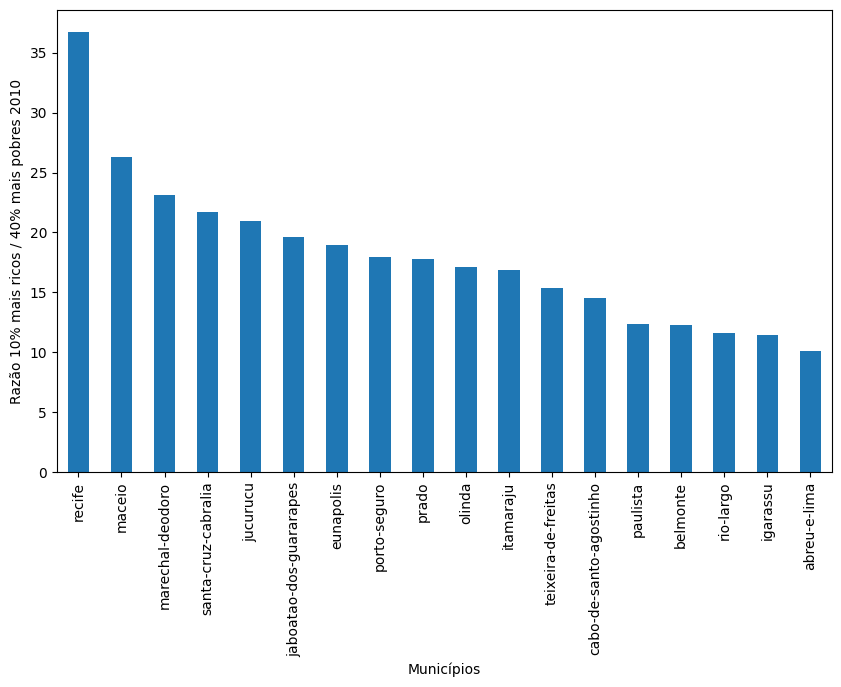

In [299]:
# Gráfico comparativo 'Razão 10% mais ricos / 40% mais pobres 2010'

df = DF_Medidas_Desigualdade_Censo_91_10_AL_BA_PE.copy()

var = 'Razão 10% mais ricos / 40% mais pobres 2010'

cols = [var]

# Resume df necessário
df = df[['nome_municipio', var]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

df = df.sort_values(var, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = var,
        kind = 'bar',
        legend = False
        )
plt.xlabel('Municípios')
plt.ylabel(var)

save_graph('Bar_Razão 10% mais ricos_40% mais pobres', 'Municipios')

Gráfico comparativo 'Razão 20% mais ricos / 40% mais pobres 2010'

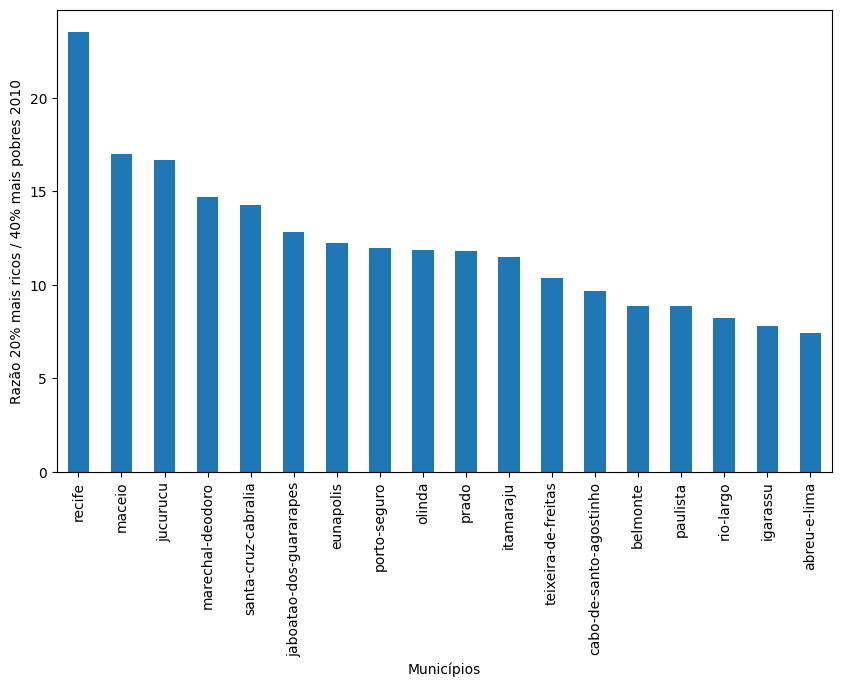

In [300]:
# Gráfico comparativo 'Razão 20% mais ricos / 40% mais pobres 2010'

df = DF_Medidas_Desigualdade_Censo_91_10_AL_BA_PE.copy()

var = 'Razão 20% mais ricos / 40% mais pobres 2010'

cols = [var]

# Resume df necessário
df = df[['nome_municipio', var]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

df = df.sort_values(var, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = var,
        kind = 'bar',
        legend = False
        )
plt.xlabel('Municípios')
plt.ylabel(var)

save_graph('Bar_Razão 20% mais ricos_40% mais pobres', 'Municipios')

##### Plots: DF_Pobreza_e_Vulnerabilidade_Municipios

Gráfico comparativo IDH e componentes

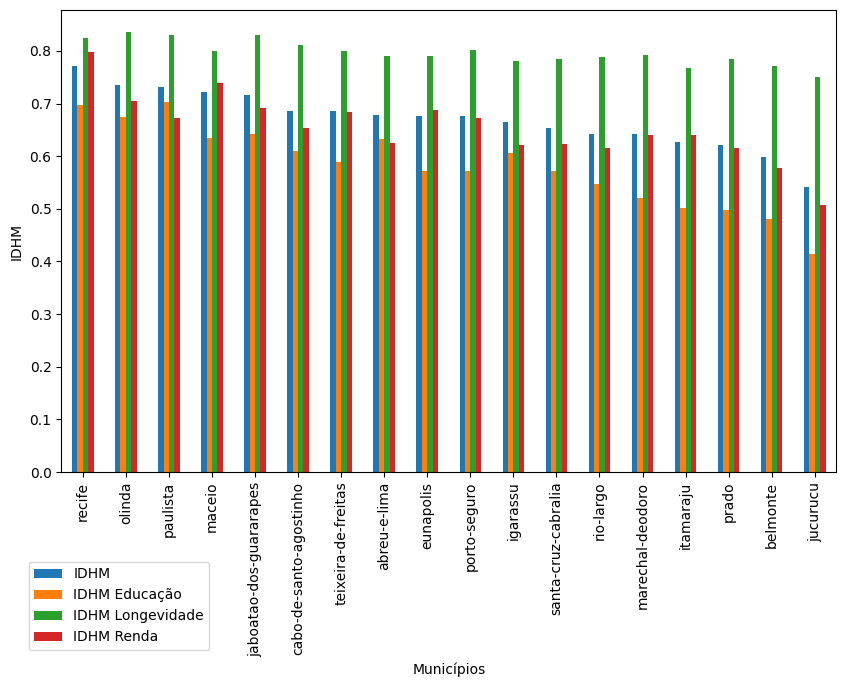

In [301]:
# Gráfico comparativo 'IDHM','IDHM Educação','IDHM Longevidade','IDHM Renda'

df = DF_Pobreza_e_Vulnerabilidade_Municipios.copy()

var  = 'IDHM'
var2 = 'IDHM Educação'
var3 = 'IDHM Longevidade'
var4 = 'IDHM Renda'

cols = [var, var2, var3, var4]

# Resume df necessário
df = df[['nome_municipio', var, var2, var3, var4, 'Sexo', "Cor", 'Situação de Domicílio']]
df = df[(df['Sexo'] == "Total Sexo") & (df['Cor'] == "Total Cor") & (df['Situação de Domicílio'] == "Total Situação de Domicílio")]
df.drop(['Sexo', "Cor", 'Situação de Domicílio'], axis = 1, inplace = True)
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

# Reordena df conforme valor da variável indicada
df = df.sort_values(var, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = cols,
        kind = 'bar',
        legend = True
        )
plt.xlabel('Municípios')
plt.ylabel(var)
plt.legend(bbox_to_anchor=(.2,-0.4), loc='lower right')

save_graph('Bar_Componentes IDHM', 'Municipios')


Gráfico Municipal 'IDHM','IDHM Educação','IDHM Longevidade','IDHM Renda'

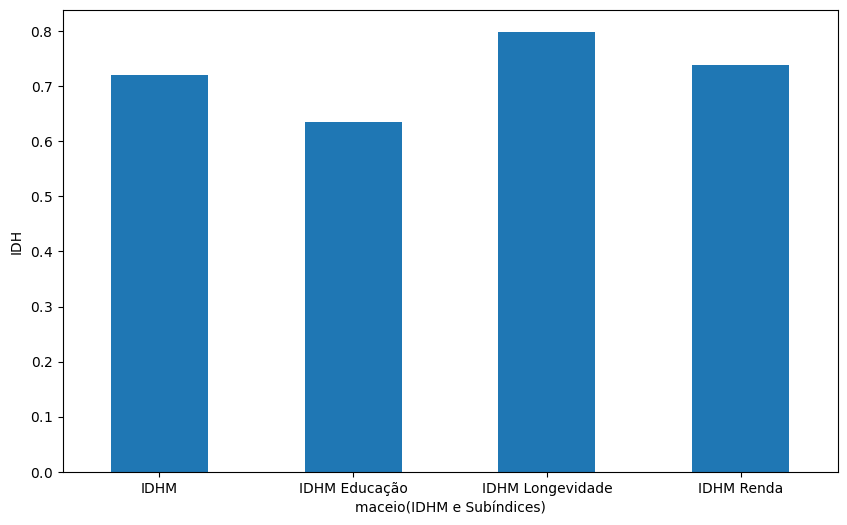

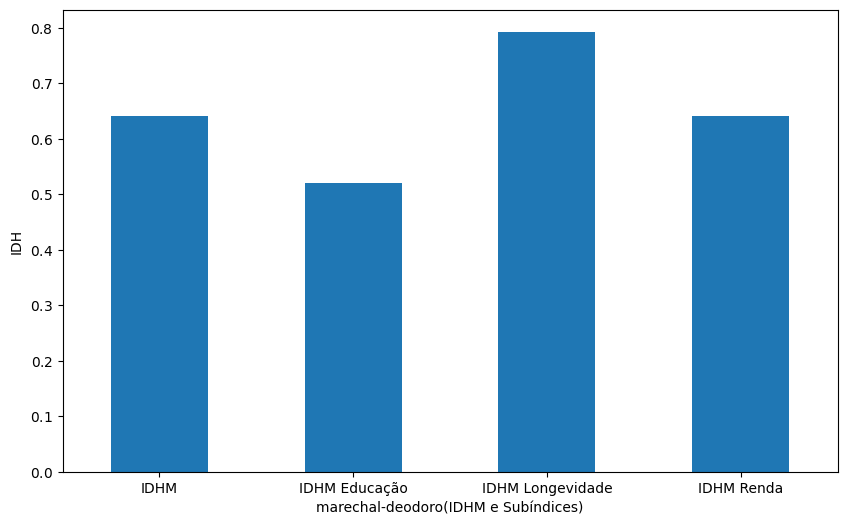

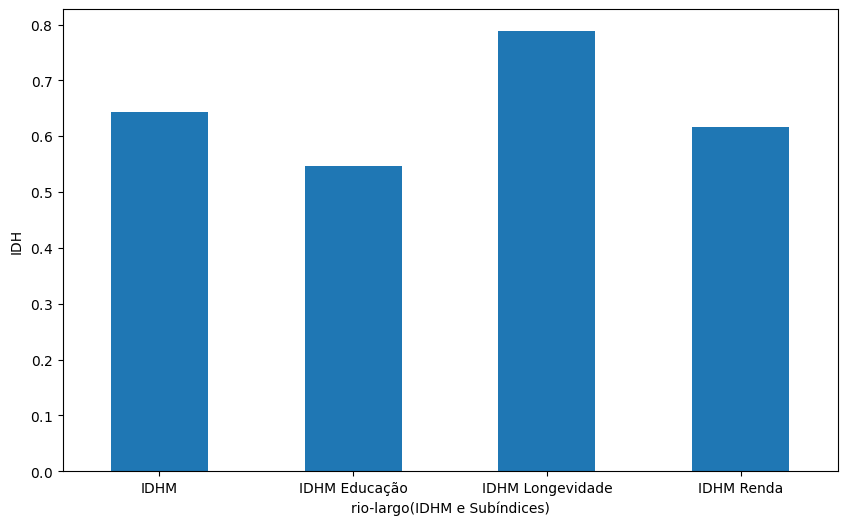

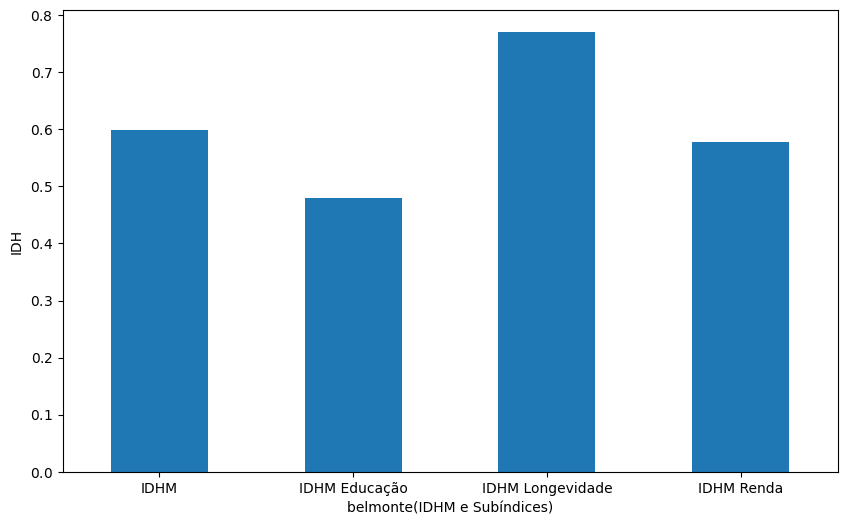

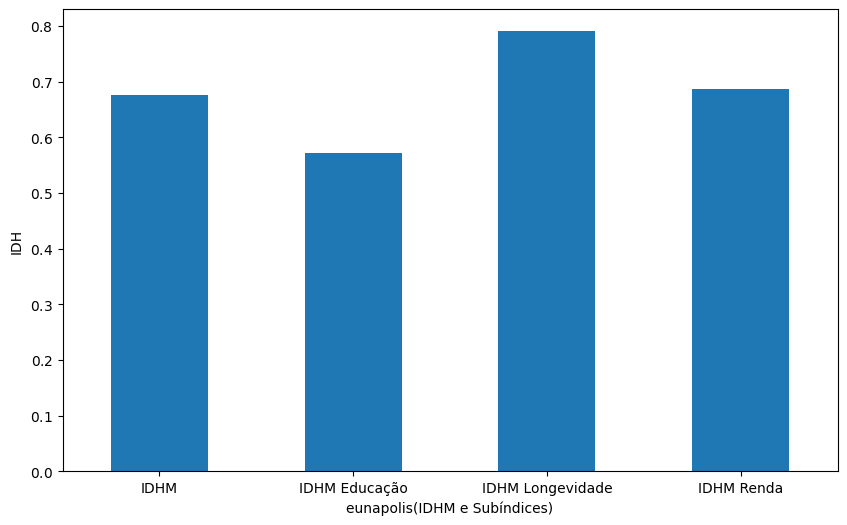

...

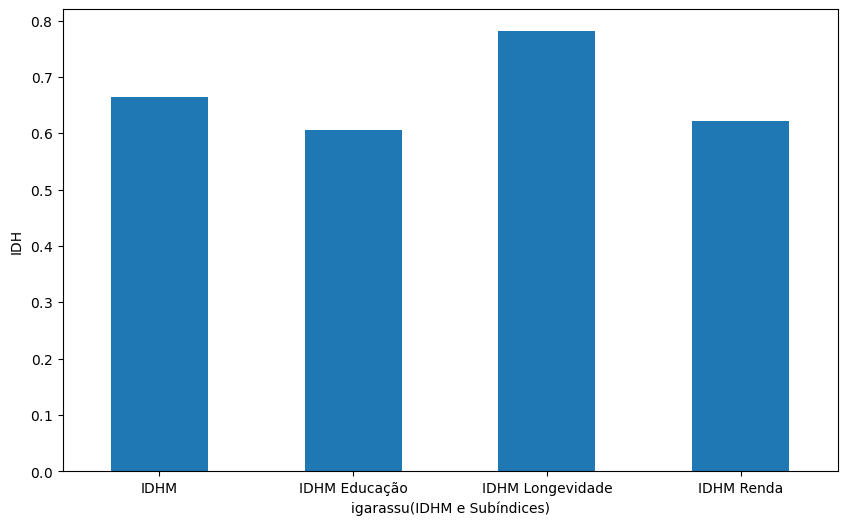

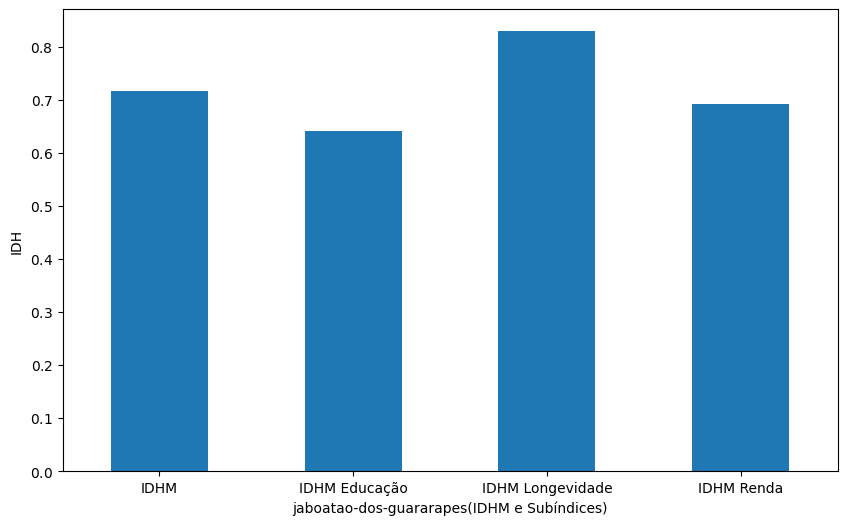

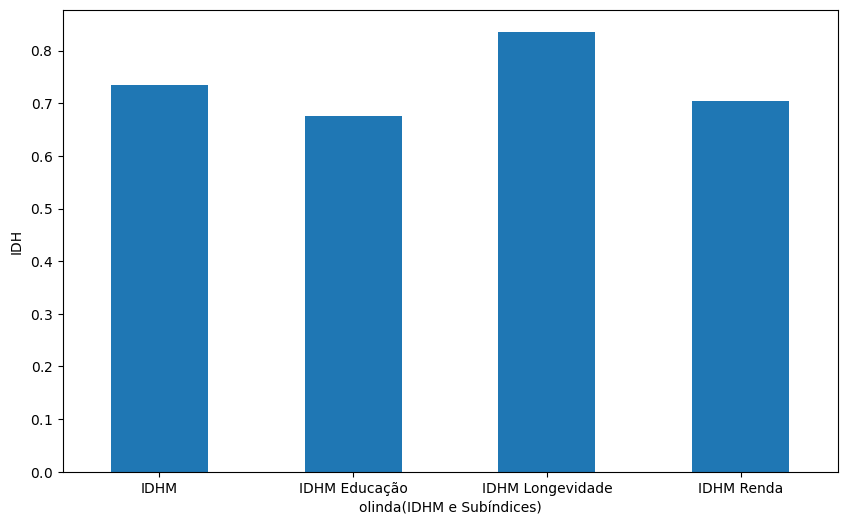

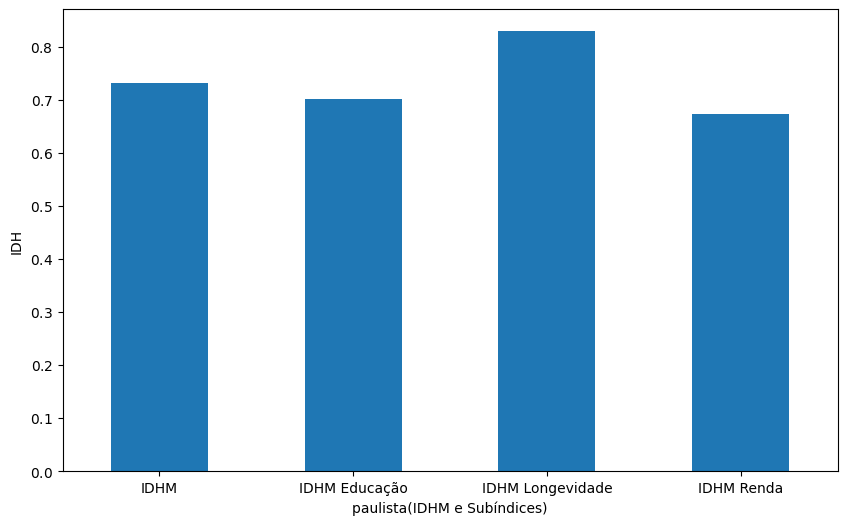

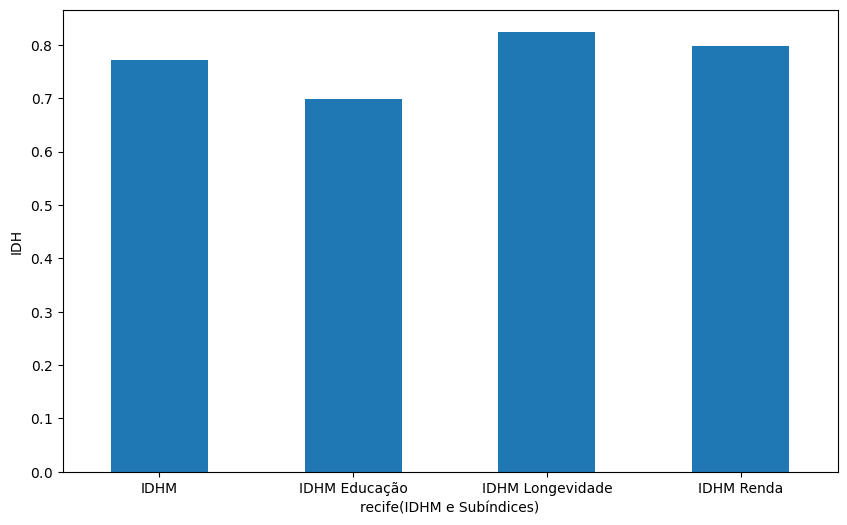

In [302]:
# Gráfico Municipal 'IDHM','IDHM Educação','IDHM Longevidade','IDHM Renda'

df = DF_Pobreza_e_Vulnerabilidade_Municipios.copy()

var  = 'IDHM'
var2 = 'IDHM Educação'
var3 = 'IDHM Longevidade'
var4 = 'IDHM Renda'

cols = [var, var2, var3, var4]

# Resume df necessário
df = df[['nome_municipio', var, var2, var3, var4, 'Sexo', "Cor", 'Situação de Domicílio']]
df = df[(df['Sexo'] == "Total Sexo") & (df['Cor'] == "Total Cor") & (df['Situação de Domicílio'] == "Total Situação de Domicílio")]
df.drop(['Sexo', "Cor", 'Situação de Domicílio'], axis = 1, inplace = True)
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

# Define set_munic como os que constam no df
set_munic = set(df['nome_municipio'].tolist())

# Loop produz gráficos para cada município no DF
for munic in Municipios:
   df_loop = df

   # Filter df with munic
   df_loop = df_loop[df_loop['nome_municipio'] == munic]

   # Transpose the data frame
   df_loop = df_loop.set_index('nome_municipio').T

   # Create the bar chart
   ax = df_loop.plot(kind='bar', legend=False)

   # Set the x-axis tick labels
   ax.set_xticklabels(df_loop.index)

   # Edit the graph
   plt.xticks(rotation=0)
   # plt.ticklabel_format(style='plain', axis='x')
   plt.gca().yaxis.set_major_formatter(ScalarFormatter(useMathText=True))
   plt.ylabel('IDH')
   plt.xlabel(f'{munic}(IDHM e Subíndices)')

   # Save plot to save_path
   plt.savefig(f'{save_path}\\Bar_IDHM + Componentes_{munic}')

   # Show the plot
   plt.show()

Gráfico Comparativo 'IVS', 'IVS Capital Humano', 'IVS Infraestrutura Urbana', 'IVS Renda e Trabalho'

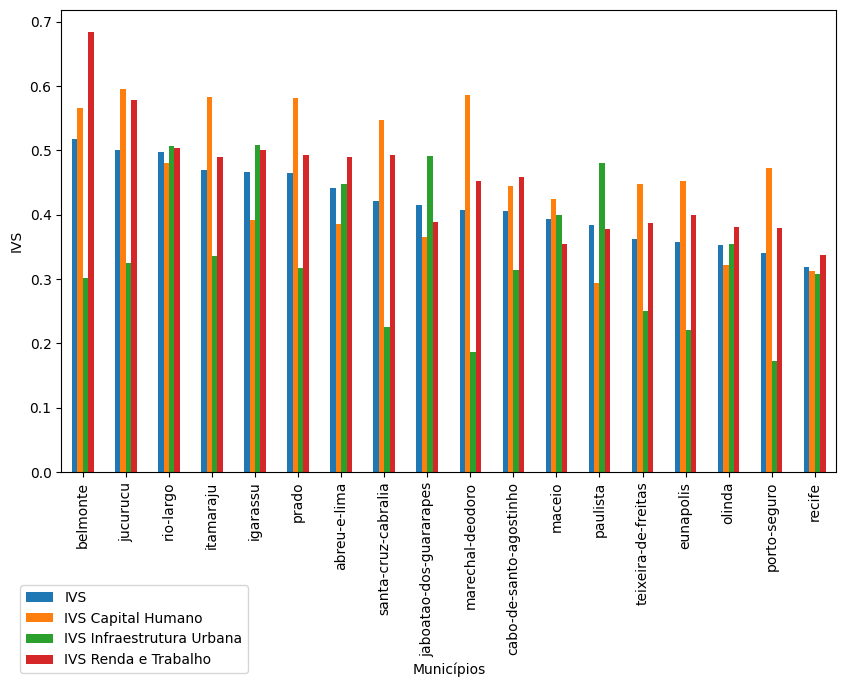

In [303]:
# Gráfico comparativo 'IVS', 'IVS Capital Humano', 'IVS Infraestrutura Urbana', 'IVS Renda e Trabalho'

df = DF_Pobreza_e_Vulnerabilidade_Municipios.copy()

var  = 'IVS'
var2 = 'IVS Capital Humano'
var3 = 'IVS Infraestrutura Urbana'
var4 = 'IVS Renda e Trabalho'

cols = [var, var2, var3, var4]

# Resume df necessário
df = df[['nome_municipio', var, var2, var3, var4, 'Sexo', "Cor", 'Situação de Domicílio']]
df = df[(df['Sexo'] == "Total Sexo") & (df['Cor'] == "Total Cor") & (df['Situação de Domicílio'] == "Total Situação de Domicílio")]
df.drop(['Sexo', "Cor", 'Situação de Domicílio'], axis = 1, inplace = True)
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

# Reordena df conforme valor da variável indicada
df = df.sort_values(var, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = cols,
        kind = 'bar',
        legend = True
        )
plt.xlabel('Municípios')
plt.ylabel(var)
plt.legend(bbox_to_anchor=(.25,-0.45), loc='lower right')

save_graph('Bar_Componentes IVS', 'Municipios')

Gráfico Municipal 'IVS', 'IVS Capital Humano', 'IVS Infraestrutura Urbana', 'IVS Renda e Trabalho'

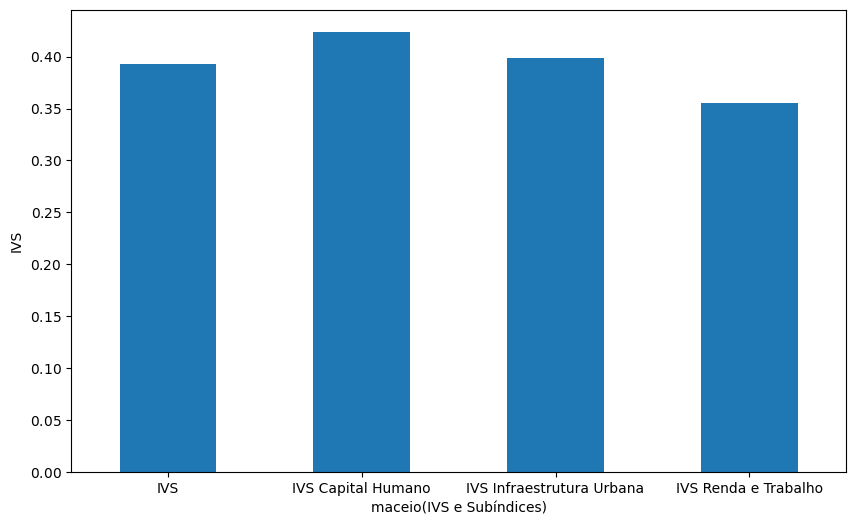

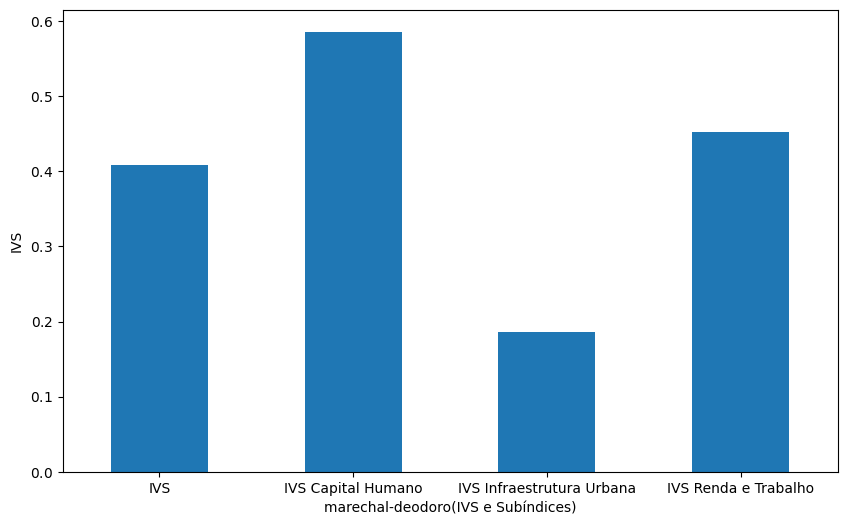

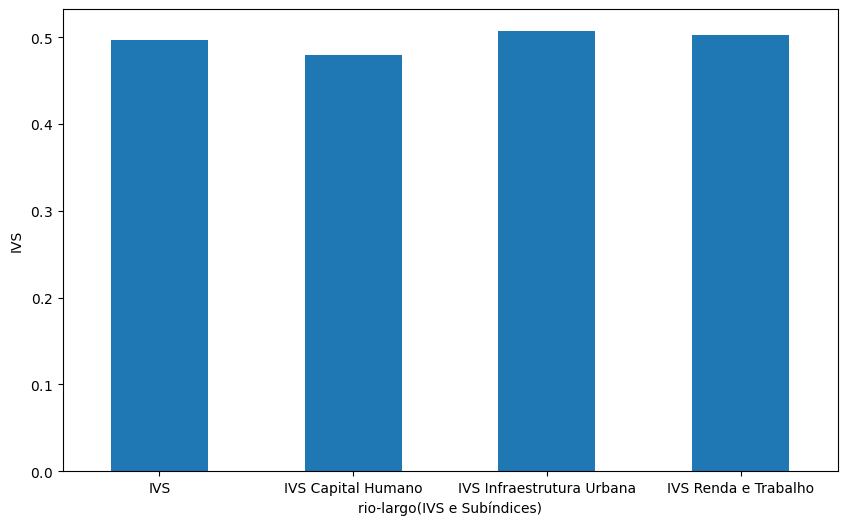

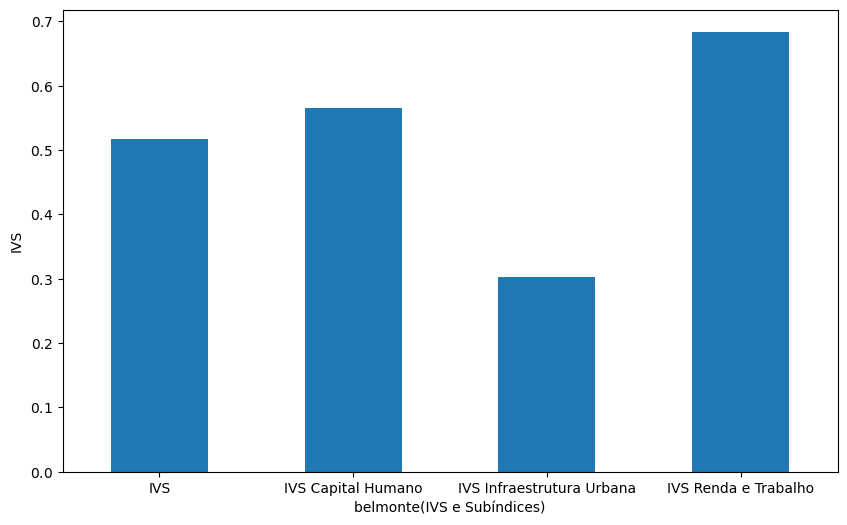

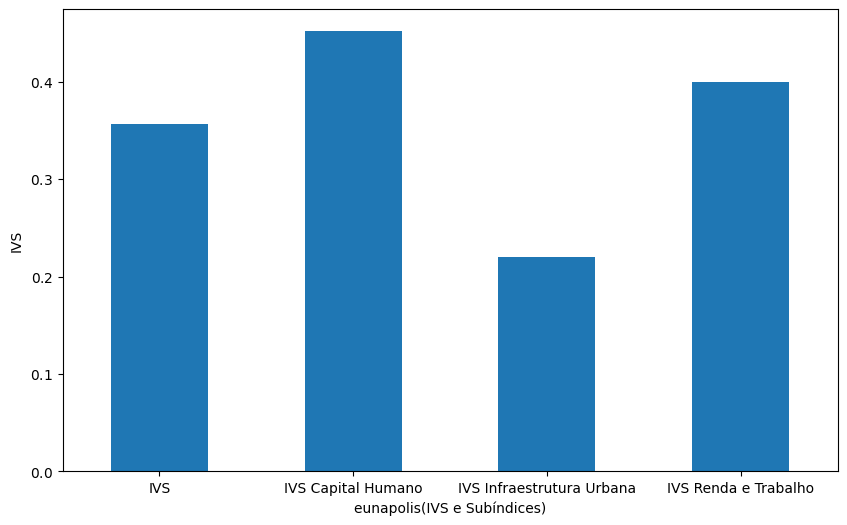

...

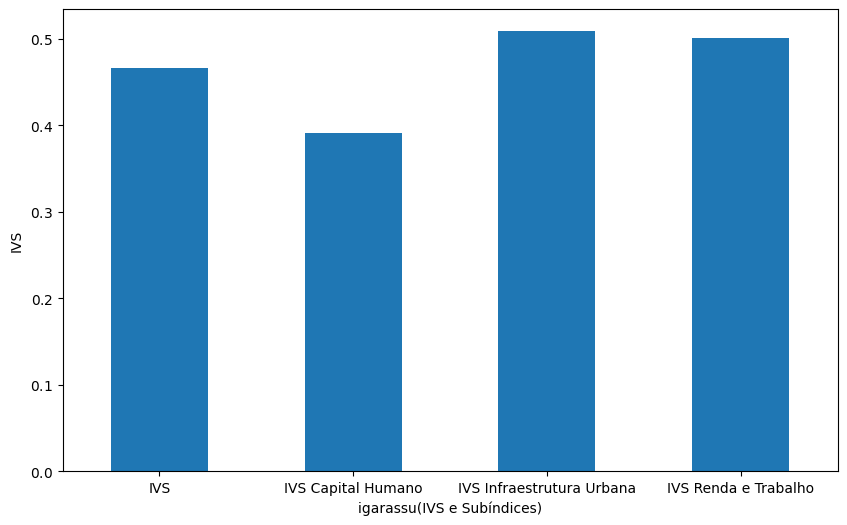

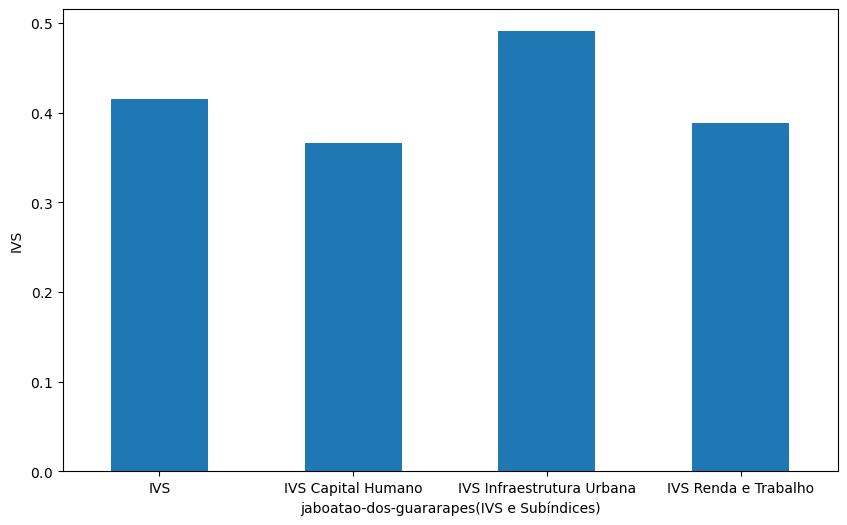

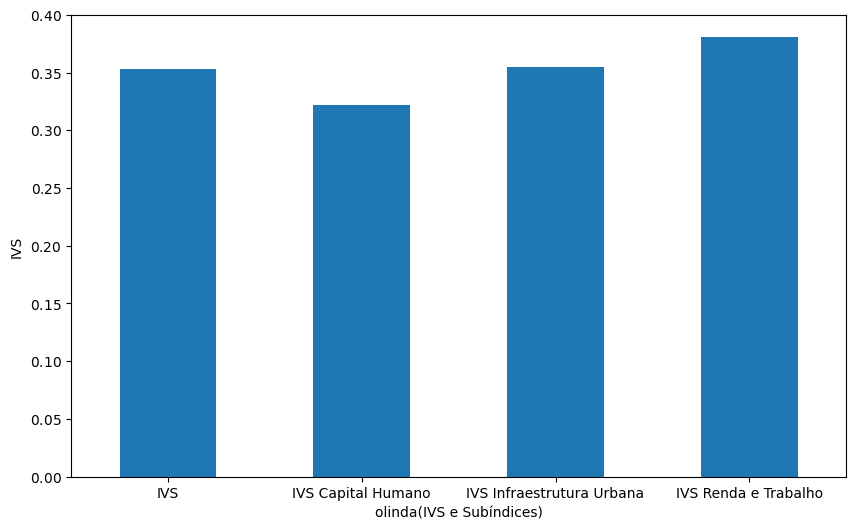

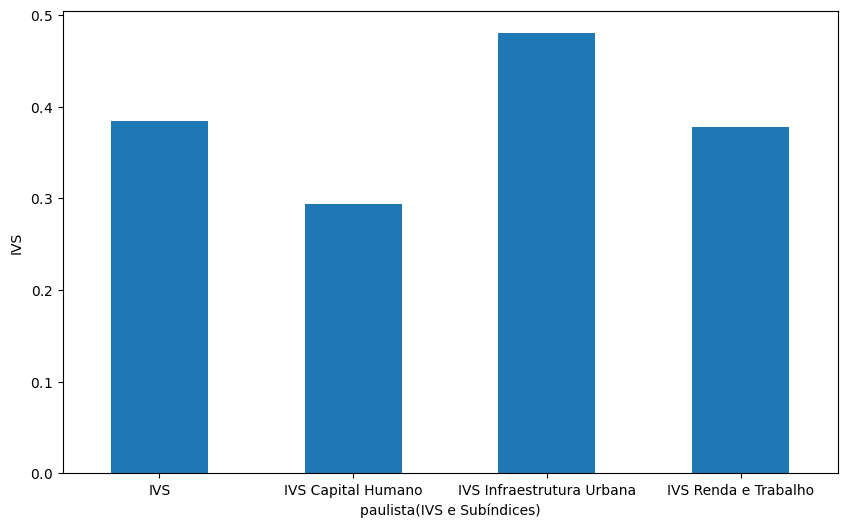

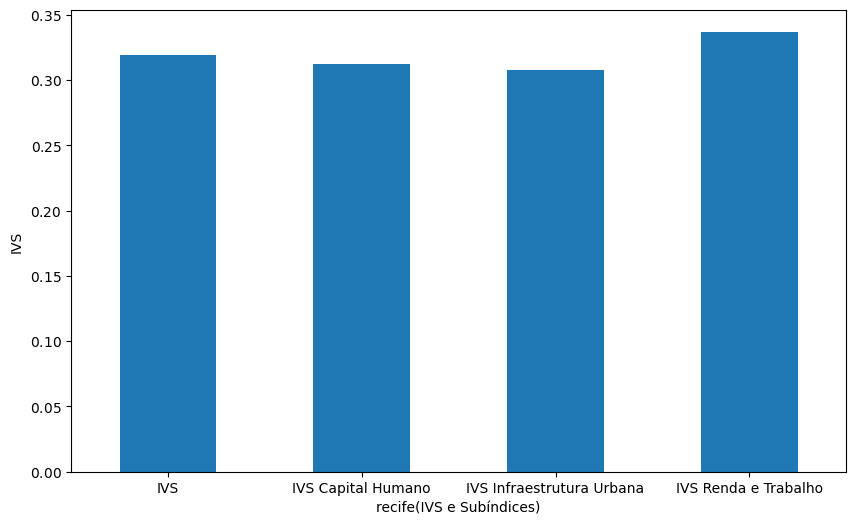

In [304]:
# Gráfico Municipal 'IVS', 'IVS Capital Humano', 'IVS Infraestrutura Urbana', 'IVS Renda e Trabalho'

df = DF_Pobreza_e_Vulnerabilidade_Municipios.copy()

var  = 'IVS'
var2 = 'IVS Capital Humano'
var3 = 'IVS Infraestrutura Urbana'
var4 = 'IVS Renda e Trabalho'

cols = [var, var2, var3, var4]

# Resume df necessário
df = df[['nome_municipio', var, var2, var3, var4, 'Sexo', "Cor", 'Situação de Domicílio']]
df = df[(df['Sexo'] == "Total Sexo") & (df['Cor'] == "Total Cor") & (df['Situação de Domicílio'] == "Total Situação de Domicílio")]
df.drop(['Sexo', "Cor", 'Situação de Domicílio'], axis = 1, inplace = True)
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

# Define set_munic como os que constam no df
set_munic = set(df['nome_municipio'].tolist())

# Loop produz gráficos para cada município no DF
for munic in Municipios:
   df_loop = df

   # Filter df with munic
   df_loop = df_loop[df_loop['nome_municipio'] == munic]

   # Transpose the data frame
   df_loop = df_loop.set_index('nome_municipio').T

   # Create the bar chart
   ax = df_loop.plot(kind='bar', legend=False)

   # Set the x-axis tick labels
   ax.set_xticklabels(df_loop.index)

   # Edit the graph
   plt.xticks(rotation=0)
   # plt.ticklabel_format(style='plain', axis='x')
   plt.gca().yaxis.set_major_formatter(ScalarFormatter(useMathText=True))
   plt.ylabel('IVS')
   plt.xlabel(f'{munic}(IVS e Subíndices)')

   # Save plot to save_path
   plt.savefig(f'{save_path}\\Bar_IVS + Componentes_{munic}')

   # Show the plot
   plt.show()

Gráfico Comparativo 'Mortalidade até 5 anos de idade'

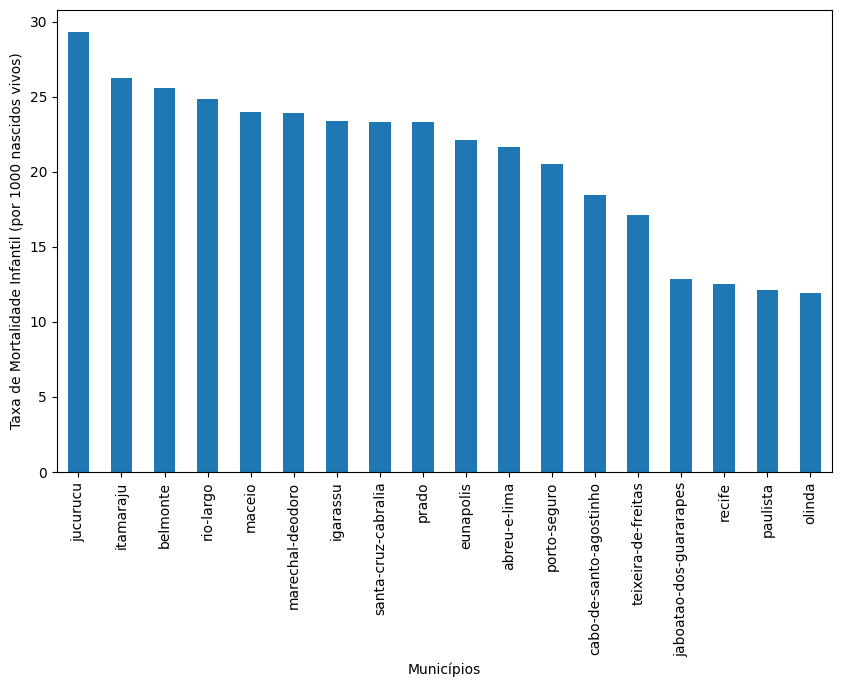

In [306]:
# Gráfico Comparativo 'Mortalidade até 5 anos de idade'

df = DF_Pobreza_e_Vulnerabilidade_Municipios.copy()

var  = 'Mortalidade até 5 anos de idade'

cols = [var]

# Resume df necessário
df = df[['nome_municipio', var, 'Sexo', "Cor", 'Situação de Domicílio']]
df = df[(df['Sexo'] == "Total Sexo") & (df['Cor'] == "Total Cor") & (df['Situação de Domicílio'] == "Total Situação de Domicílio")]
df.drop(['Sexo', "Cor", 'Situação de Domicílio'], axis = 1, inplace = True)
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

# Reordena df conforme valor da variável indicada
df = df.sort_values(var, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = cols,
        kind = 'bar',
        legend = False
        )
plt.xlabel('Municípios')
plt.ylabel('Taxa de Mortalidade Infantil (por 1000 nascidos vivos)')

save_graph('Bar_Taxa Mortalidade Infantil', 'Municipios')

Gráfico Comparativo  indicadores de vulnerabilidade infantojuvenil

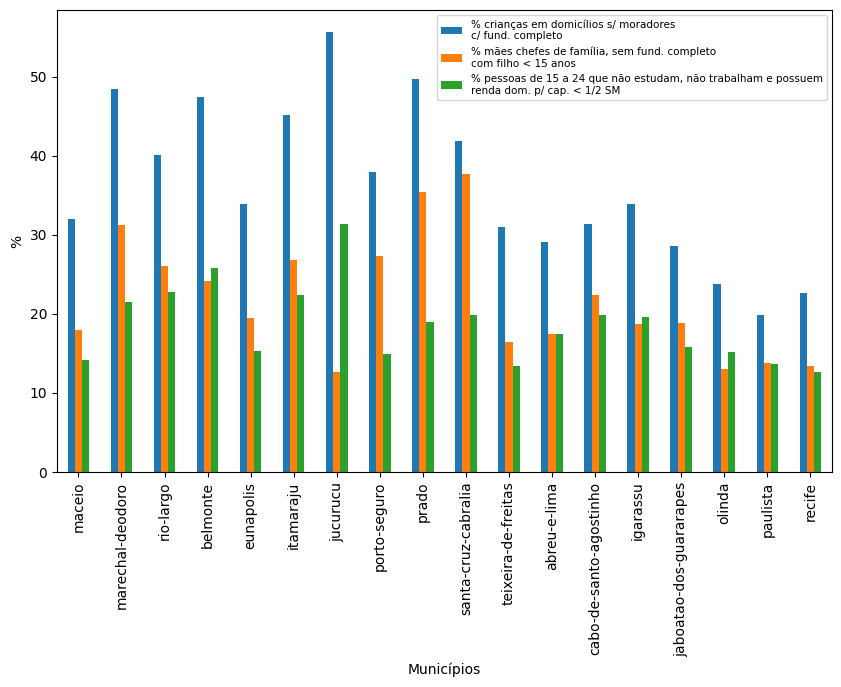

In [307]:
# Gráfico de: 
# '% de crianças que vivem em domicílios em que nenhum dos moradores tem o ensino fundamental completo',
# '% de mães chefes de família, sem fundamental completo e com filho menor de 15 anos de idade',
# '% de pessoas de 15 a 24 anos que não estudam, não trabalham e possuem renda domiciliar per capita igual ou inferior a meio salário mínimo (de 2010)'

df = DF_Pobreza_e_Vulnerabilidade_Municipios.copy()

var1 = '% de crianças que vivem em domicílios em que nenhum dos moradores tem o ensino fundamental completo'
var2 = '% de mães chefes de família, sem fundamental completo e com filho menor de 15 anos de idade'
var3 = '% de pessoas de 15 a 24 anos que não estudam, não trabalham e possuem renda domiciliar per capita igual ou inferior a meio salário mínimo (de 2010)'

cols = [var1, var2, var3]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, 'Sexo', "Cor", 'Situação de Domicílio']]
df = df[(df['Sexo'] == "Total Sexo") & (df['Cor'] == "Total Cor") & (df['Situação de Domicílio'] == "Total Situação de Domicílio")]
df.drop(['Sexo', "Cor", 'Situação de Domicílio'], axis = 1, inplace = True)
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

# Renomeia nomes de colunas adicionando quebra de linhas
df.rename({
        var1: '% crianças em domicílios s/ moradores\nc/ fund. completo',
        var2: '% mães chefes de família, sem fund. completo\ncom filho < 15 anos',
        var3: '% pessoas de 15 a 24 que não estudam, não trabalham e possuem\nrenda dom. p/ cap. < 1/2 SM'
        }, axis = 1, inplace = True)

# Reatribui nomes às variáveis
var1 = '% crianças em domicílios s/ moradores\nc/ fund. completo'
var2 = '% mães chefes de família, sem fund. completo\ncom filho < 15 anos'
var3 = '% pessoas de 15 a 24 que não estudam, não trabalham e possuem\nrenda dom. p/ cap. < 1/2 SM'
cols = [var1, var2, var3]

df.plot(
        x = 'nome_municipio',
        y = cols,
        kind = 'bar',
        legend = True
        )
plt.xlabel('Municípios')
plt.ylabel('%')
plt.legend(loc='best', prop = {'size' :7.5})

save_graph('Bar_Indicadores Vulnerabilidade Infantojuvenil', 'Municipios')


Gráfico Comparativo de 'População vulnerável de 15 a 24 anos'

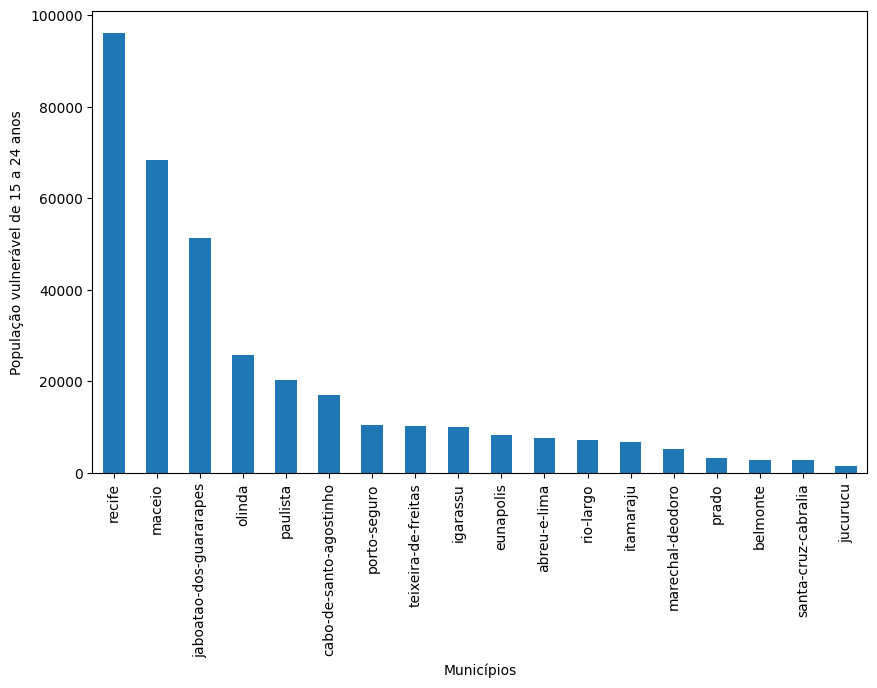

In [308]:
# Gráfico de 'População vulnerável de 15 a 24 anos'

df = DF_Pobreza_e_Vulnerabilidade_Municipios.copy()

var1 = 'População vulnerável de 15 a 24 anos'

cols = [var1]

# Resume df necessário
df = df[['nome_municipio', var1, 'Sexo', "Cor", 'Situação de Domicílio']]
df = df[(df['Sexo'] == "Total Sexo") & (df['Cor'] == "Total Cor") & (df['Situação de Domicílio'] == "Total Situação de Domicílio")]
df.drop(['Sexo', "Cor", 'Situação de Domicílio'], axis = 1, inplace = True)
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

df = df.sort_values(var1, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = var1,
        kind = 'bar',
        legend = False
        )
plt.xlabel('Municípios')
plt.ylabel(var1)

save_graph('Bar_População vulnerável de 15 a 24 anos', 'Municipios')

Gráfico Gráfico Comparativo 'Taxa de atividade das pessoas de 10 a 14 anos de idade'



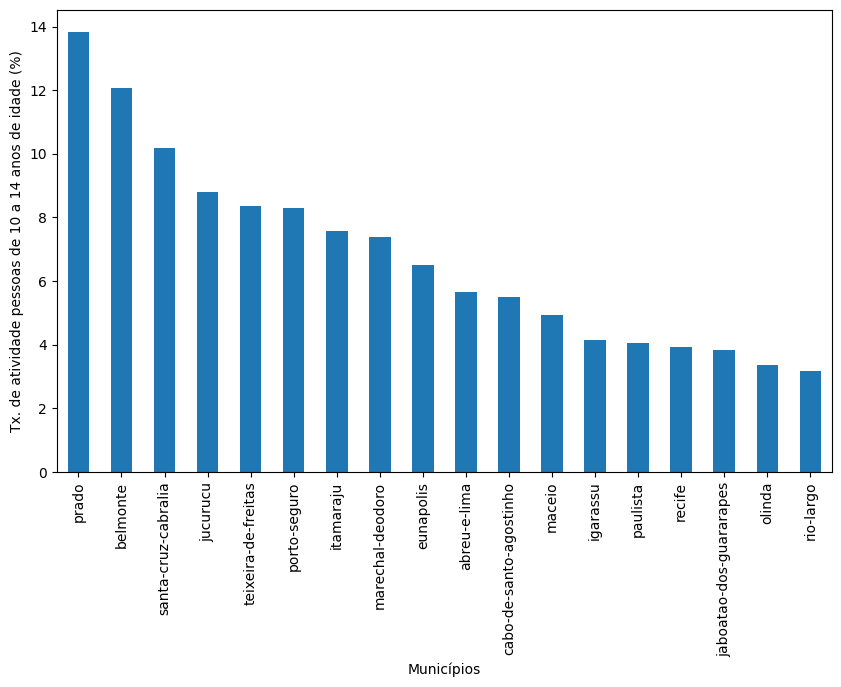

In [309]:
# Gráfico de 'Taxa de atividade das pessoas de 10 a 14 anos de idade'

df = DF_Pobreza_e_Vulnerabilidade_Municipios.copy()

var1 = 'Taxa de atividade das pessoas de 10 a 14 anos de idade'
cols = [var1]

# Resume df necessário
df = df[['nome_municipio', var1, 'Sexo', "Cor", 'Situação de Domicílio']]
df = df[(df['Sexo'] == "Total Sexo") & (df['Cor'] == "Total Cor") & (df['Situação de Domicílio'] == "Total Situação de Domicílio")]
df.drop(['Sexo', "Cor", 'Situação de Domicílio'], axis = 1, inplace = True)
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

df = df.sort_values(var1, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = var1,
        kind = 'bar',
        legend = False
        )
plt.xlabel('Municípios')
plt.ylabel(f'Tx. de atividade pessoas de 10 a 14 anos de idade (%)')

save_graph('Bar_Tx. de atividade pessoas de 10 a 14 anos de idade', 'Municipios')

Gráfico Comparativo 'População em domicílios vulneráveis e com idoso'

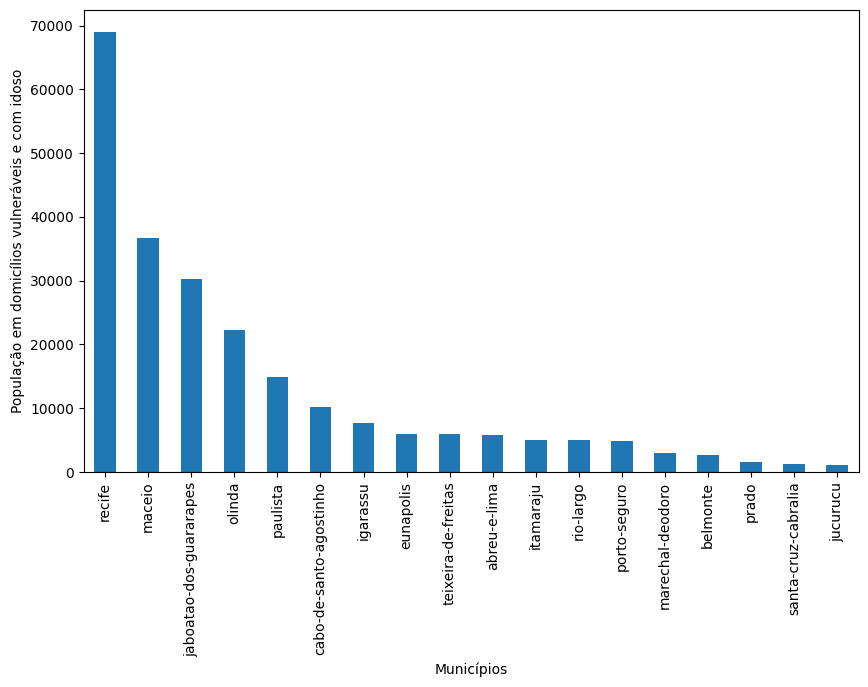

In [310]:
# Gráfico Comparativo 'População em domicílios vulneráveis e com idoso'
df = DF_Pobreza_e_Vulnerabilidade_Municipios.copy()

var1 = 'População em domicílios vulneráveis e com idoso'
cols = [var1]

# Resume df necessário
df = df[['nome_municipio', var1, 'Sexo', "Cor", 'Situação de Domicílio']]
df = df[(df['Sexo'] == "Total Sexo") & (df['Cor'] == "Total Cor") & (df['Situação de Domicílio'] == "Total Situação de Domicílio")]
df.drop(['Sexo', "Cor", 'Situação de Domicílio'], axis = 1, inplace = True)
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

df = df.sort_values(var1, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = var1,
        kind = 'bar',
        legend = False
        )
plt.xlabel('Municípios')
plt.ylabel(var1)

save_graph('População em domicílios vulneráveis e com idoso', 'Municipios')

Gráfico Comparativo '% de pessoas em domicílios com renda per capita inferior a meio salário mínimo (de 2010) e dependentes de idosos'

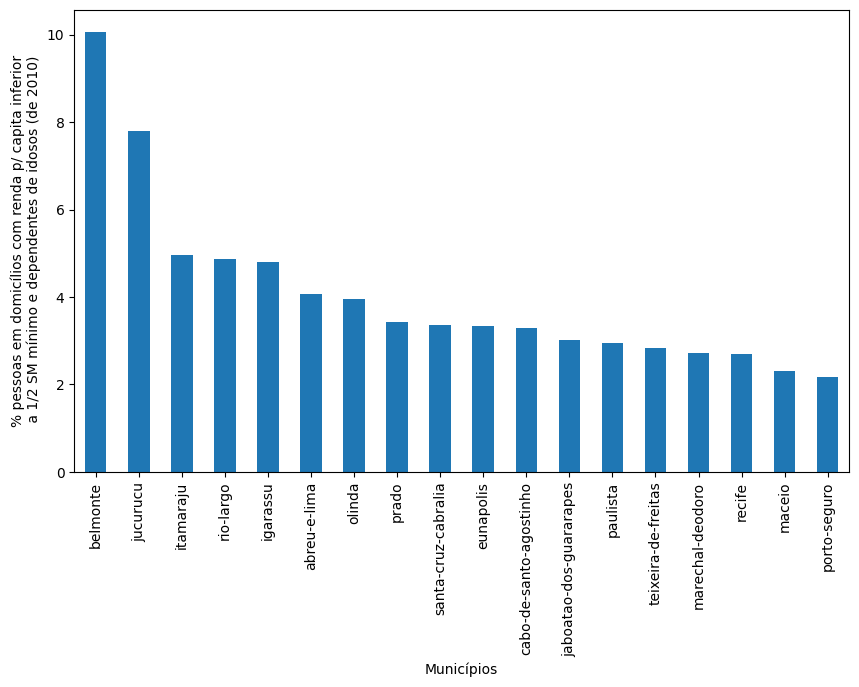

In [311]:
# Gráfico Comparativo '% de pessoas em domicílios com renda per capita inferior a meio salário mínimo (de 2010) e dependentes de idosos'

df = DF_Pobreza_e_Vulnerabilidade_Municipios.copy()

var1 = '% de pessoas em domicílios com renda per capita inferior a meio salário mínimo (de 2010) e dependentes de idosos'
cols = [var1]

# Resume df necessário
df = df[['nome_municipio', var1, 'Sexo', "Cor", 'Situação de Domicílio']]
df = df[(df['Sexo'] == "Total Sexo") & (df['Cor'] == "Total Cor") & (df['Situação de Domicílio'] == "Total Situação de Domicílio")]
df.drop(['Sexo', "Cor", 'Situação de Domicílio'], axis = 1, inplace = True)
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

df = df.sort_values(var1, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = var1,
        kind = 'bar',
        legend = False
        )
plt.xlabel('Municípios')
plt.ylabel('% pessoas em domicílios com renda p/ capita inferior\n a 1/2 SM mínimo e dependentes de idosos (de 2010)')

save_graph('% de pessoas em dom com renda p capita inf a meio salário e dependentes de idosos', 'Municipios')

#### Plots DF_Mapa_INSAN_Municipios

Gráfico Comparativo DF_Mapa_INSAN_Municipios

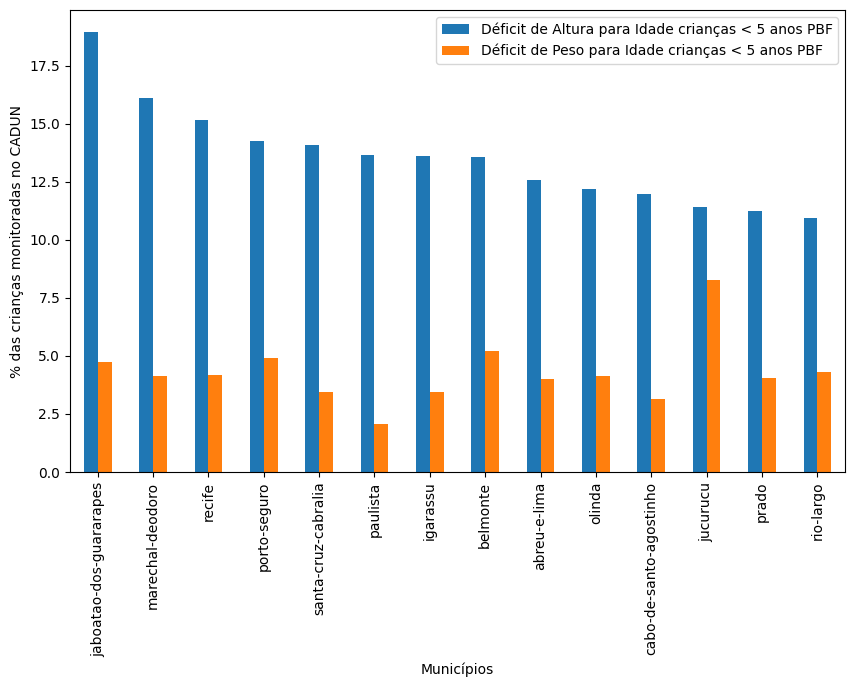

In [314]:
# Gráfico Comparativo 'Déficit de Altura para Idade crianças < 5 anos PBF', 'Déficit de Peso para Idade crianças < 5 anos PBF'

df = DF_Mapa_INSAN_Municipios.copy()

var = 'Déficit de Altura para Idade crianças < 5 anos PBF'
var2 = 'Déficit de Peso para Idade crianças < 5 anos PBF'

cols = [var, var2]

# Resume df necessário
df = df[['nome_municipio', var, var2]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

df = df.sort_values(var, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = cols,
        kind = 'bar',
        legend = True
        )
plt.xlabel('Municípios')
plt.ylabel('% das crianças monitoradas no CADUN')

save_graph('Déficit de Altura e Peso para Idade abaixo de 5 anos PBF', 'Municipios')

##### Plots: DF_Abaixo_Linha_de_Pobreza_Kcal_91_2010 GRÁFICO LINHA. VOLTAR DEPOIS

#### Plots: DF_Abaixo_Linha_de_Pobreza_Kcal_91_2010

 Gráfico '% de extremamente pobres 2010', '% de pobres 2010', '% de vulneráveis à pobreza 2010'

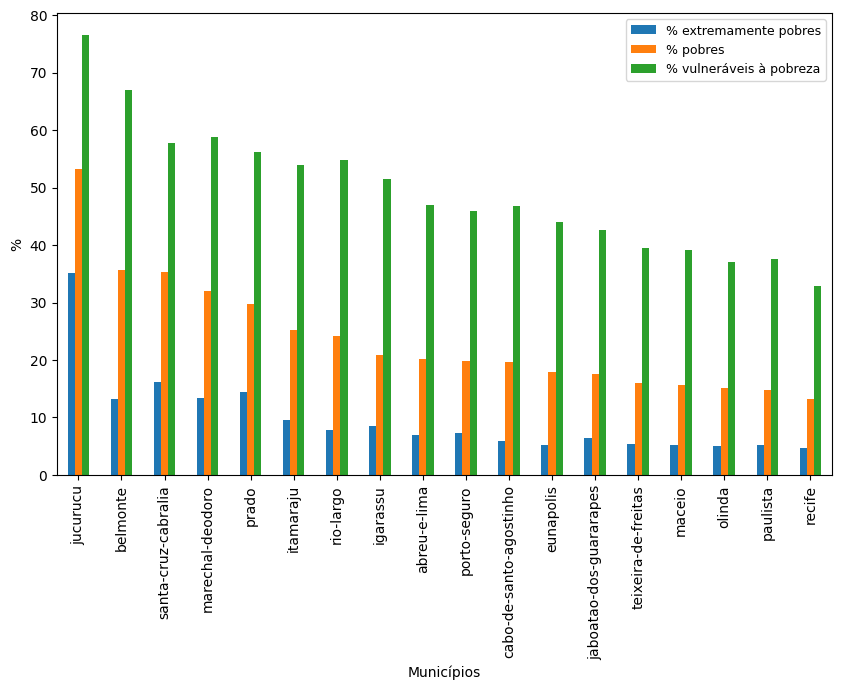

In [315]:
# Gráfico comparativo '% de extremamente pobres 2010', '% de pobres 2010', '% de vulneráveis à pobreza 2010'

df = DF_Prop_Pobreza_Renda_91_10_AL_BA_PE.copy()

var1 = '% de extremamente pobres 2010'
var2 = '% de pobres 2010'
var3 = '% de vulneráveis à pobreza 2010'

cols = [var1, var2, var3]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3]]

df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

# Renomeia nomes de colunas adicionando quebra de linhas
df.rename({
        var1: '% extremamente pobres',
        var2: '% pobres',
        var3: '% vulneráveis à pobreza'
        }, axis = 1, inplace = True)

# Reatribui nomes às variáveis
var1 = '% extremamente pobres'
var2 = '% pobres'
var3 = '% vulneráveis à pobreza'
cols = [var1, var2, var3]

# Reordena colunas
df = df.sort_values(var2, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = cols,
        kind = 'bar',
        legend = True
        )
plt.xlabel('Municípios')
plt.ylabel('%')
plt.legend(loc='best', prop = {'size' :9})

save_graph('Bar_% extrem pobres vulneraveis e pobres 2010', 'Municipios')

Gráfico Comparativo  'Renda per capita dos extremamente pobres 2010',  'Renda per capita dos pobres 2010',  'Renda per capita dos vulneráveis à pobreza 2010'

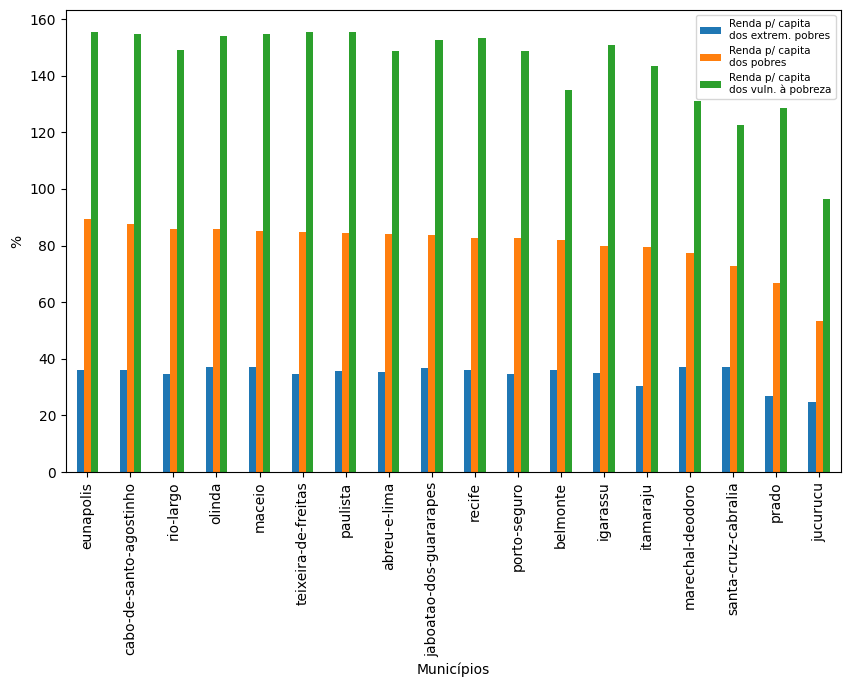

In [316]:
# Gráfico comparativo  'Renda per capita dos extremamente pobres 2010', 'Renda per capita dos pobres 2010', 'Renda per capita dos vulneráveis à pobreza 2010'

df = DF_Prop_Pobreza_Renda_91_10_AL_BA_PE.copy()

var1 = 'Renda per capita dos extremamente pobres 2010'
var2 = 'Renda per capita dos pobres 2010'
var3 = 'Renda per capita dos vulneráveis à pobreza 2010'

cols = [var1, var2, var3]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3]]

df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

# Renomeia nomes de colunas adicionando quebra de linhas
new_var1 = 'Renda p/ capita\ndos extrem. pobres'
new_var2 = 'Renda p/ capita\ndos pobres'
new_var3 = 'Renda p/ capita\ndos vuln. à pobreza'

df.rename({
        var1: new_var1,
        var2: new_var2,
        var3: new_var3
        }, axis = 1, inplace = True)

# Reatribui nomes às variáveis
var1 = new_var1
var2 = new_var2
var3 = new_var3
cols = [var1, var2, var3]

# Reordena colunas
df = df.sort_values(var2, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = cols,
        kind = 'bar',
        legend = True
        )
plt.xlabel('Municípios')
plt.ylabel('%')
plt.legend(loc='best', prop = {'size' :7.5})

save_graph('Bar_renda per capita dos extrem pobres vulneraveis e pobres 2010', 'Municipios')

#### Plots: DF_Prop_Crianças_Pobres_91_10_AL_BA_PE

Gráfico Comparativo '% de crianças com até 14 anos de idade extremamente pobres 2010', '% de crianças pobres 2010', '% de crianças vulneráveis à pobreza 2010'

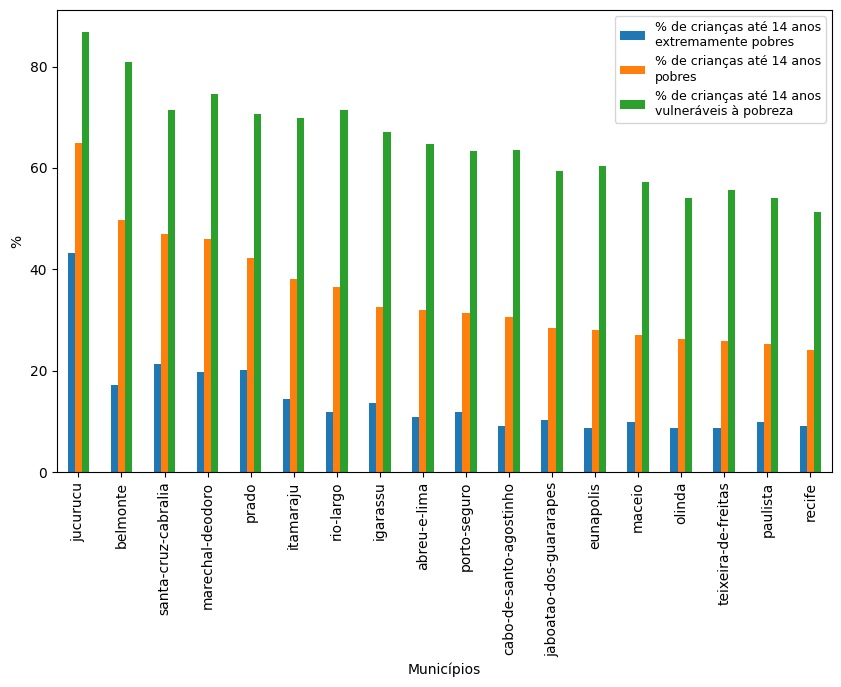

In [317]:
# Gráfico '% de crianças com até 14 anos de idade extremamente pobres 2010', '% de crianças pobres 2010', '% de crianças vulneráveis à pobreza 2010'

df = DF_Prop_Crianças_Pobres_91_10_AL_BA_PE.copy()

var1 = '% de crianças com até 14 anos de idade extremamente pobres 2010'
var2 = '% de crianças pobres 2010'
var3 = '% de crianças vulneráveis à pobreza 2010'

cols = [var1, var2, var3]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3]]

df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

# Renomeia nomes de colunas adicionando quebra de linhas
new_var1 = '% de crianças até 14 anos\nextremamente pobres'
new_var2 = '% de crianças até 14 anos\npobres'
new_var3 = '% de crianças até 14 anos\nvulneráveis à pobreza'

df.rename({
        var1: new_var1,
        var2: new_var2,
        var3: new_var3
        }, axis = 1, inplace = True)

# Reatribui nomes às variáveis
var1 = new_var1
var2 = new_var2
var3 = new_var3
cols = [var1, var2, var3]

# Reordena colunas
df = df.sort_values(var2, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = cols,
        kind = 'bar',
        legend = True
        )
plt.xlabel('Municípios')
plt.ylabel('%')
plt.legend(loc='best', prop = {'size' :9})

save_graph('Bar_% crianças abaixo de 14 extrem pobres vulneraveis e pobres 2010', 'Municipios')


## Gráficos Infraestrutura urbana e AGSN

#### Plots: DF_Prop_Pop_Sem_Infraestrutura_91_10_AL_BA_PE

Gráfico Comparado % Populção em domicílios com infraestrurura

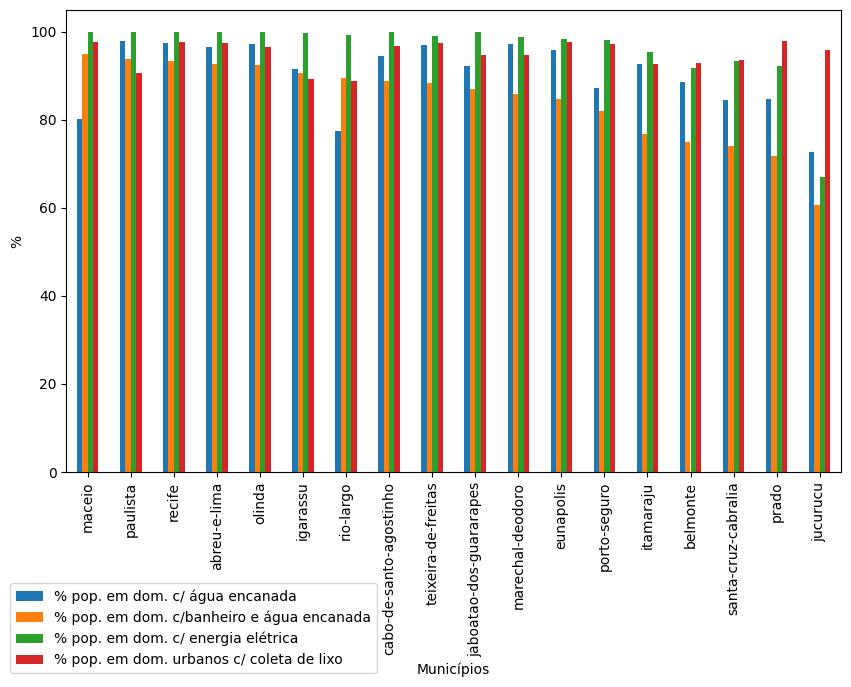

In [318]:
# Gráfico:
# '% da população em domicílios com água encanada 2010', 
# '% da população que vive em domicílios com banheiro e água encanada 2010',
# '% de pessoas em domicílios com energia elétrica 2010',  
# '% de pessoas em domicílios urbanos com coleta de lixo 2010',  


df = DF_Prop_Pop_Sem_Infraestrutura_91_10_AL_BA_PE.copy()

var1 = '% da população em domicílios com água encanada 2010'
var2 = '% da população que vive em domicílios com banheiro e água encanada 2010'                                       
var3 = '% de pessoas em domicílios com energia elétrica 2010'
var5 = '% de pessoas em domicílios urbanos com coleta de lixo 2010'
cols = [var1, var2, var3, var5]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, var5]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce'))

# Renomeia nomes de colunas adicionando quebra de linhas
new_var1 = '% pop. em dom. c/ água encanada'
new_var2 = '% pop. em dom. c/banheiro e água encanada'                                       
new_var3 = '% pop. em dom. c/ energia elétrica'
new_var4 = '% pop. em dom. c/ densidade > a 2 pessoas p/ dorm.'
new_var5 = '% pop. em dom. urbanos c/ coleta de lixo'
new_var6 = '% pop. em dom. c/ paredes que não sejam de alvenaria ou madeira aparelhada'

df.rename({
        var1: new_var1,
        var2: new_var2,
        var3: new_var3,
        var5: new_var5
        }, axis = 1, inplace = True)
cols = [new_var1, new_var2, new_var3, new_var5]

# Reordena colunas
df = df.sort_values(new_var2, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = cols,
        kind = 'bar',
        legend = True
        )
plt.xlabel('Municípios')
plt.ylabel('%')
# plt.legend(loc='best', prop = {'size' :9})
plt.legend(bbox_to_anchor=(0.41,-0.45), loc='lower right')

save_graph('Bar_% Populção em domicílios com infraestrurura 2010', 'Municipios')

Gráfico Municipal % Populção em domicílios com infraestrurura 2000 x 2010 (O.K.)

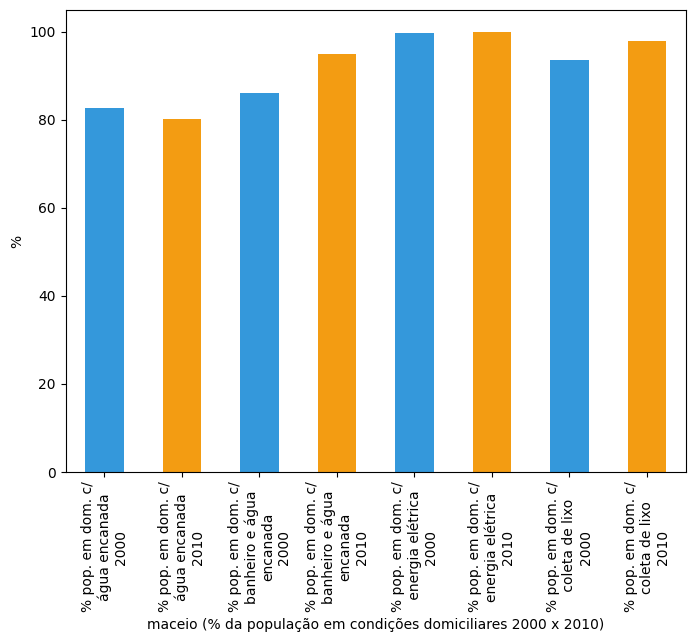

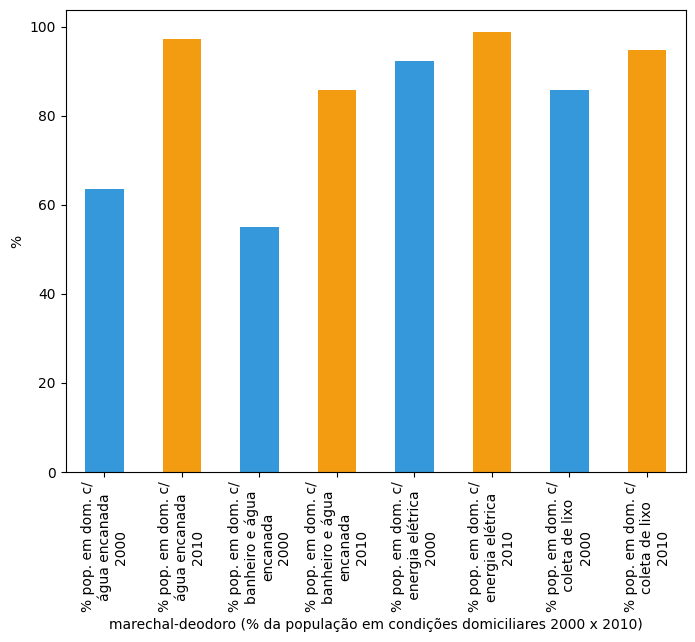

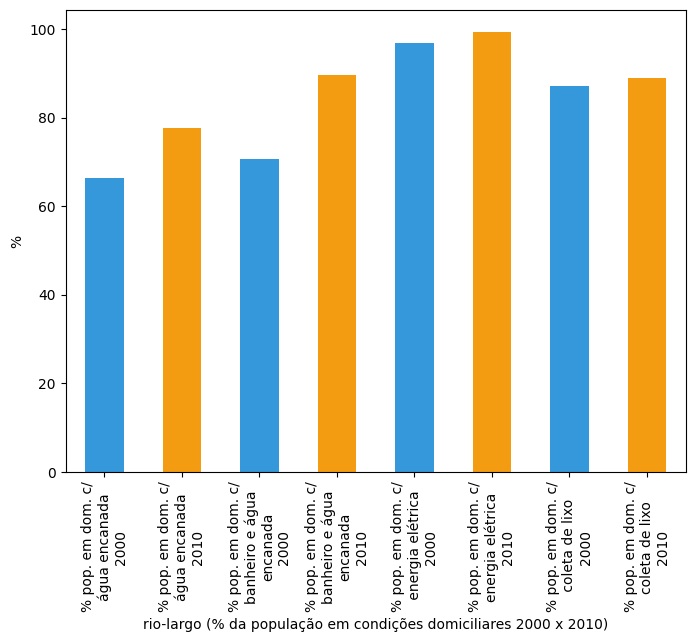

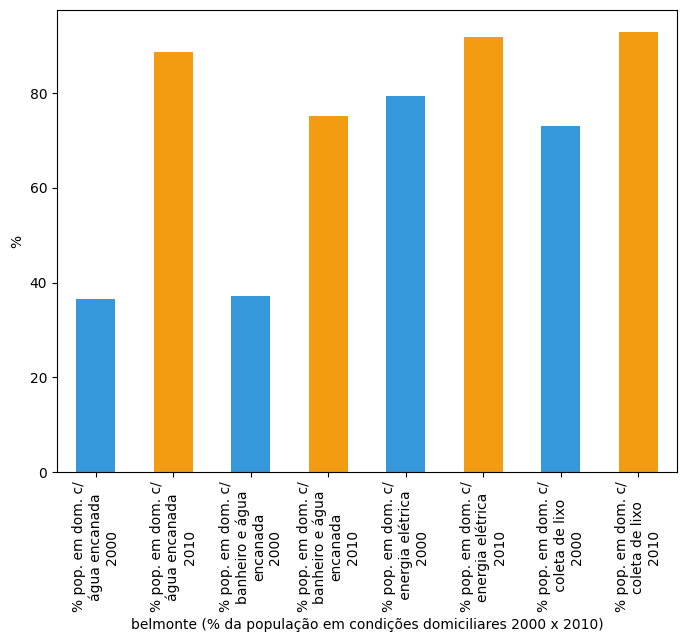

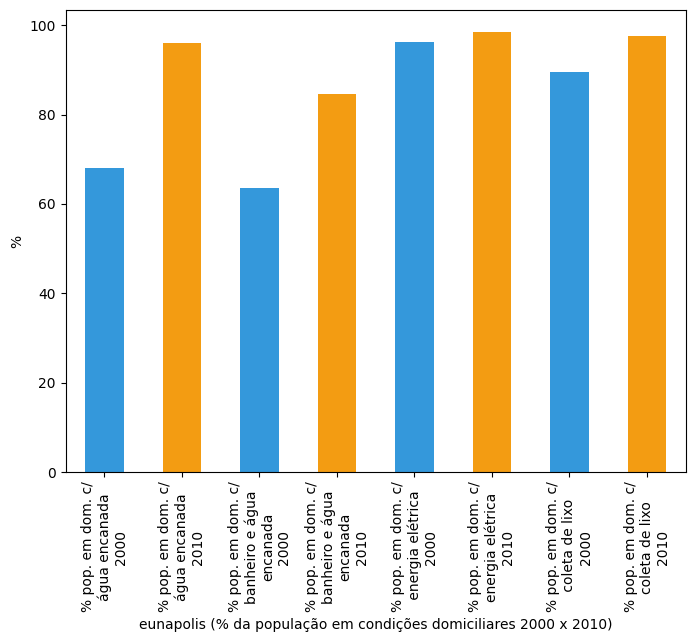

...

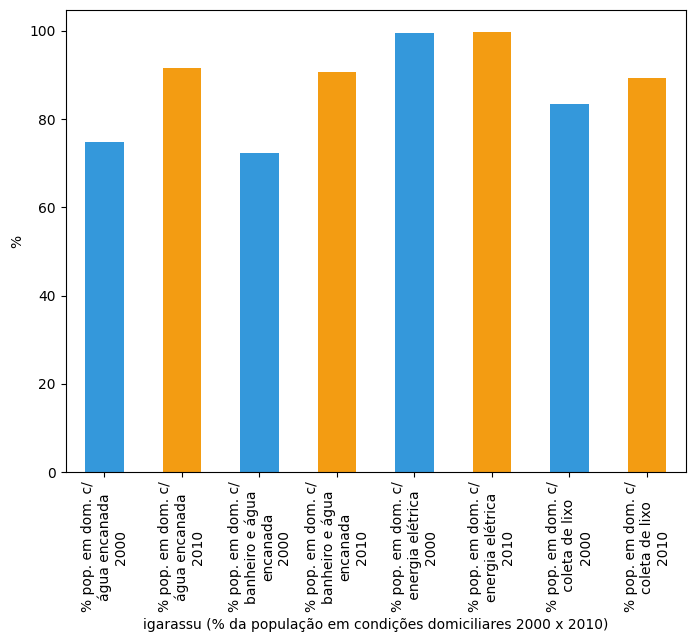

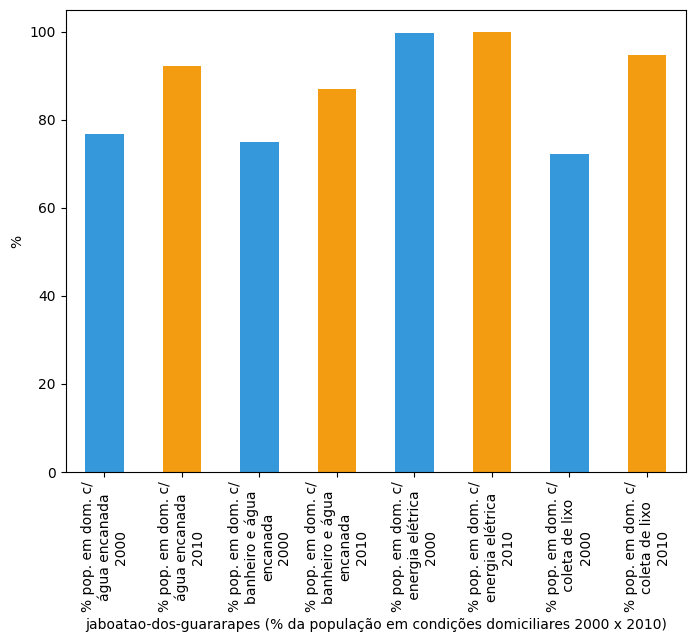

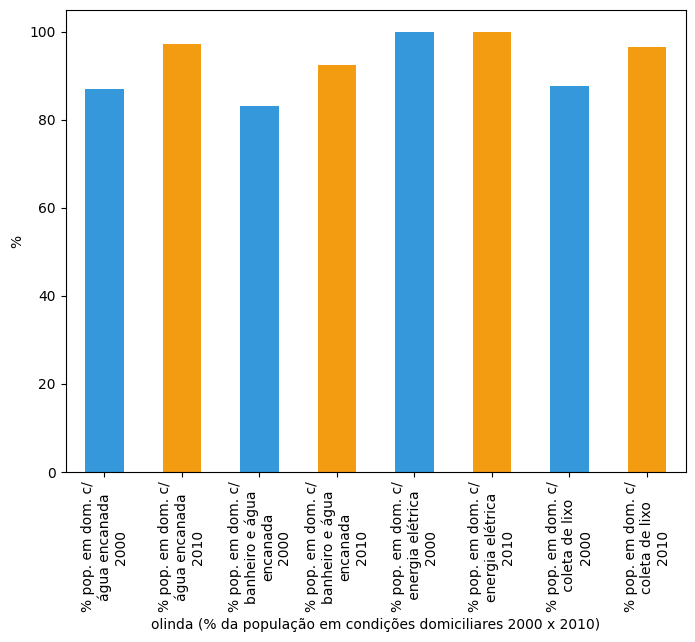

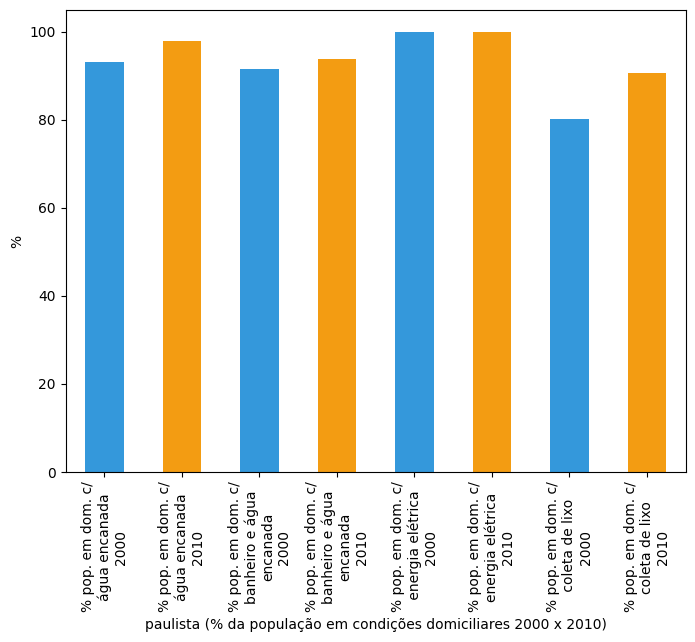

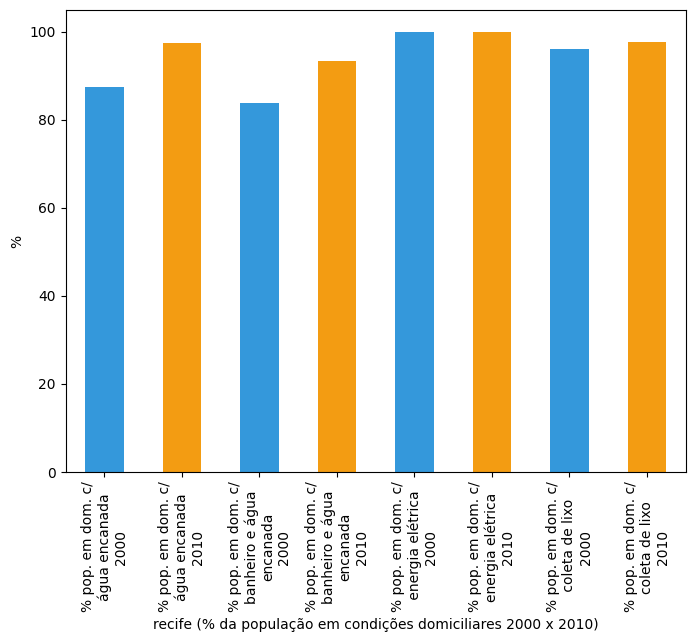

In [319]:
# Gráfico: 
# '% da população em domicílios com água encanada 2010'
# '% da população em domicílios com água encanada 2000'
# '% da população que vive em domicílios com banheiro e água encanada 2010'
# '% da população que vive em domicílios com banheiro e água encanada 2000'
# '% de pessoas em domicílios com energia elétrica 2010'
# '% de pessoas em domicílios urbanos com coleta de lixo 2010'
# '% de pessoas em domicílios urbanos com coleta de lixo 2000'

df = DF_Prop_Pop_Sem_Infraestrutura_91_10_AL_BA_PE.copy()

var1 = '% da população em domicílios com água encanada 2010'
var11 = '% da população em domicílios com água encanada 2000'
var2 = '% da população que vive em domicílios com banheiro e água encanada 2010'
var22 = '% da população que vive em domicílios com banheiro e água encanada 2000'
var3 = '% de pessoas em domicílios com energia elétrica 2010'
var33 = '% de pessoas em domicílios com energia elétrica 2000'
var5 = '% de pessoas em domicílios urbanos com coleta de lixo 2010'
var55 = '% de pessoas em domicílios urbanos com coleta de lixo 2000'

cols = [var11, var1, var22, var2, var33, var3, var55,  var5]

# Resume df necessário
df = df[['nome_municipio', var11, var1, var22, var2, var33, var3, var55,  var5]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce'))

# Renomeia nomes de colunas adicionando quebra de linhas
new_var1  = '% pop. em dom. c/\nágua encanada\n2010'
new_var11 = '% pop. em dom. c/\nágua encanada\n2000'
new_var2  = '% pop. em dom. c/\nbanheiro e água\nencanada\n2010'
new_var22 = '% pop. em dom. c/\nbanheiro e água\nencanada\n2000'
new_var3  = '% pop. em dom. c/\nenergia elétrica\n2010'
new_var33 = '% pop. em dom. c/\n energia elétrica\n2000'
new_var5  = '% pop. em dom. c/\ncoleta de lixo\n2010'
new_var55 = '% pop. em dom. c/\n coleta de lixo\n2000'

df.rename({
var1 : new_var1,
var11: new_var11,
var2 : new_var2,
var22: new_var22,
var3 : new_var3,
var33: new_var33,
var5 : new_var5,
var55: new_var55
        }, axis = 1, inplace = True)

# Define set_munic como apenas os que constam em 'nome_municipio' no df reduzido
set_munic = set(df['nome_municipio'].tolist())

# Define valores das cores das barras para o gráfico
blue   = '#3498db'
yellow = '#f39c12'

# Loop produz gráficos para cada município no DF
for munic in Municipios:
        dfx = df

        # Filter df with munic
        dfx = dfx[dfx['nome_municipio'] == munic]
        dfx.set_index('nome_municipio')

        # Define colors for the bars
        colors = [blue, yellow] * 4

        # Plot the bar graph
        ax = dfx.iloc[0, 1:].plot(kind='bar', color=colors, figsize=(8, 6))

        # Set the x and y axis labels
        ax.set_xlabel(f'{munic} (% da população em condições domiciliares 2000 x 2010)')
        ax.set_ylabel('%')

        # Save plot to save_path
        plt.savefig(f'{save_path}\\Bar_% da população em condições domiciliares 2000 x 2010_{munic}', dpi = 300, bbox_inches='tight' )

        # Show the plot
        plt.show()
 

Gráfico Comparado % Populção em domicílios precários

In [321]:
# Unindo DFs DF_Prop_Pop_Sem_Infraestrutura_91_10_AL_BA_PE e DF_Prop_Pop_Domicílios_Precários_91_10_AL_BA_PE

DF_Domic_Prec = pd.merge(
                        DF_Prop_Pop_Sem_Infraestrutura_91_10_AL_BA_PE, 
                        DF_Prop_Pop_Domicílios_Precários_91_10_AL_BA_PE,
                        how = 'inner',
                        on = 'nome_municipio',
                        suffixes = ('', 'remove_'))



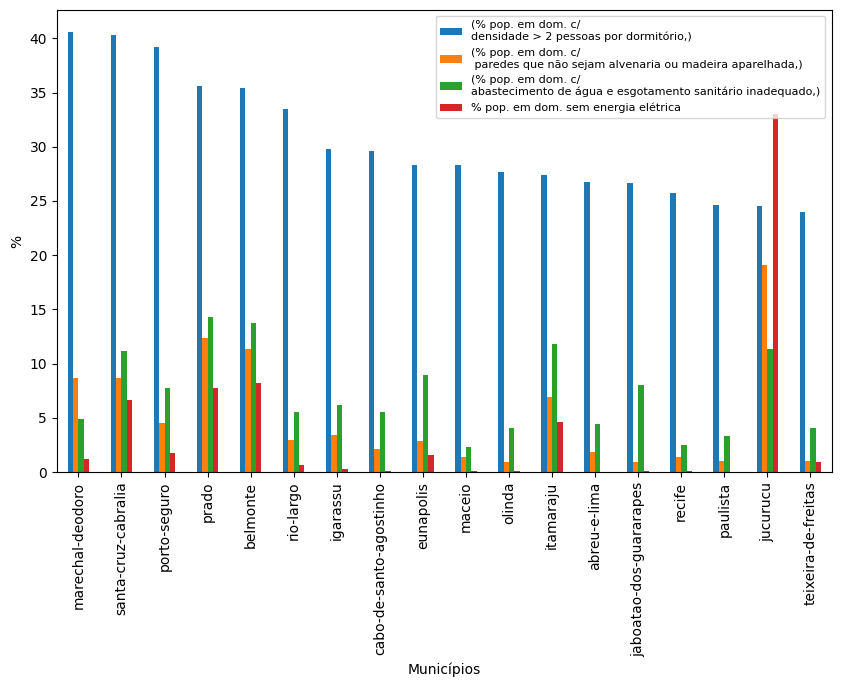

In [322]:
# Gráfico Comparado DF_Domic_Prec:
# '% da população que vive em domicílios com densidade superior a 2 pessoas por dormitório 2010'
# '% de pessoas em domicílios com abastecimento de água e esgotamento sanitário inadequados 2010'
# '% de pessoas em domicílios sem energia elétrica 2010'
# '% de pessoas em domicílios com paredes que não sejam de alvenaria ou madeira aparelhada 2010'


df = DF_Domic_Prec.copy()

var1 = '% da população que vive em domicílios com densidade superior a 2 pessoas por dormitório 2010'
var2 = '% de pessoas em domicílios com paredes que não sejam de alvenaria ou madeira aparelhada 2010'                              
var3 = '% de pessoas em domicílios com abastecimento de água e esgotamento sanitário inadequados 2010'
var5 = '% de pessoas em domicílios sem energia elétrica 2010'
cols = [var1, var2, var3, var5]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, var5]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce'))

# Renomeia nomes de colunas adicionando quebra de linhas
new_var1 = '% pop. em dom. c/\ndensidade > 2 pessoas por dormitório',
new_var2 = '% pop. em dom. c/\n paredes que não sejam alvenaria ou madeira aparelhada',                            
new_var3 = '% pop. em dom. c/\nabastecimento de água e esgotamento sanitário inadequado',
new_var5 = '% pop. em dom. sem energia elétrica'

df.rename({
        var1: new_var1,
        var2: new_var2,
        var3: new_var3,
        var5: new_var5
        }, axis = 1, inplace = True)
cols = [new_var1, new_var2, new_var3, new_var5]

# Reordena colunas
df = df.sort_values(new_var1, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = cols,
        kind = 'bar',
        legend = True
        )
plt.xlabel('Municípios')
plt.ylabel('%')
plt.legend(bbox_to_anchor=(0.74,0.877), loc='center', prop = {'size' : 8})

save_graph('Bar_% Populção em domicílios precários 2010', 'Municipios')

Gráfico Municipal % Populção em domicílios precários 2000 x 2010 (O.K.)

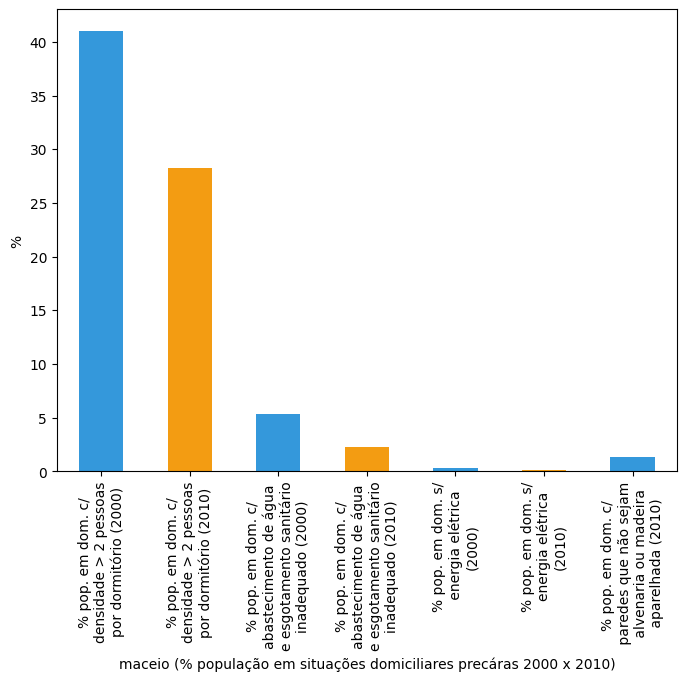

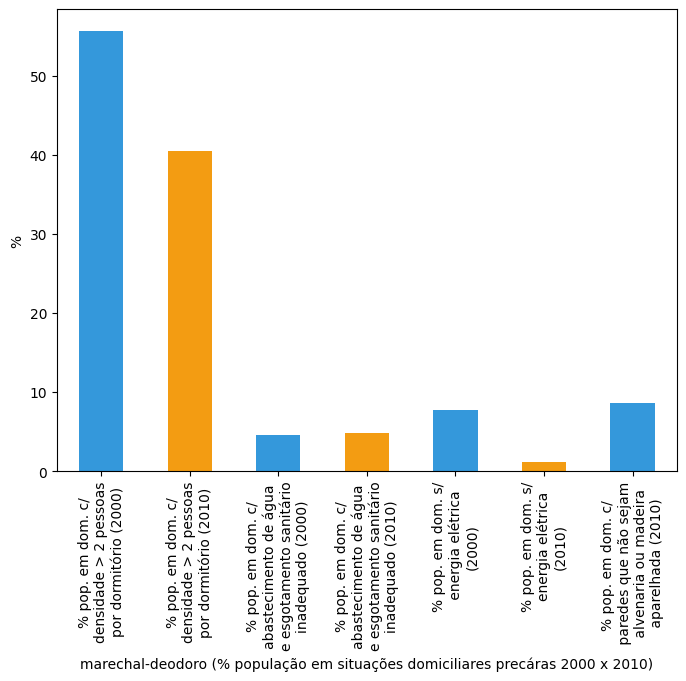

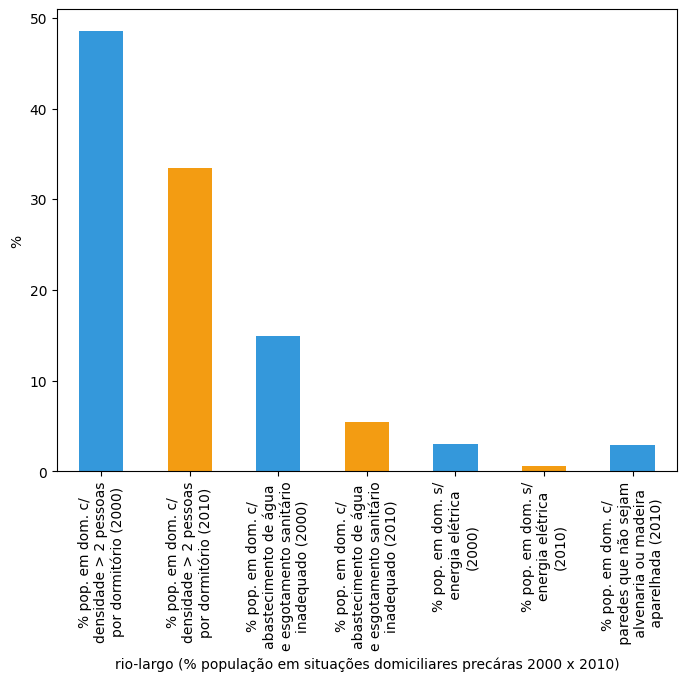

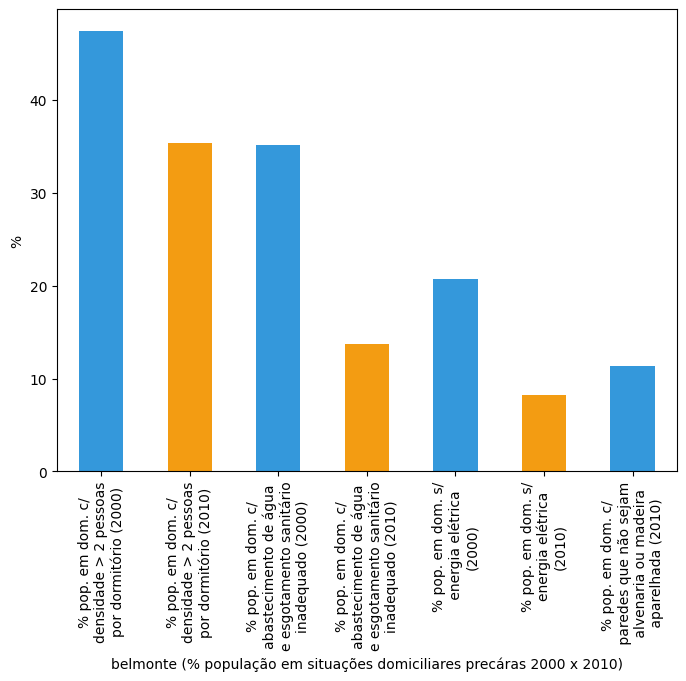

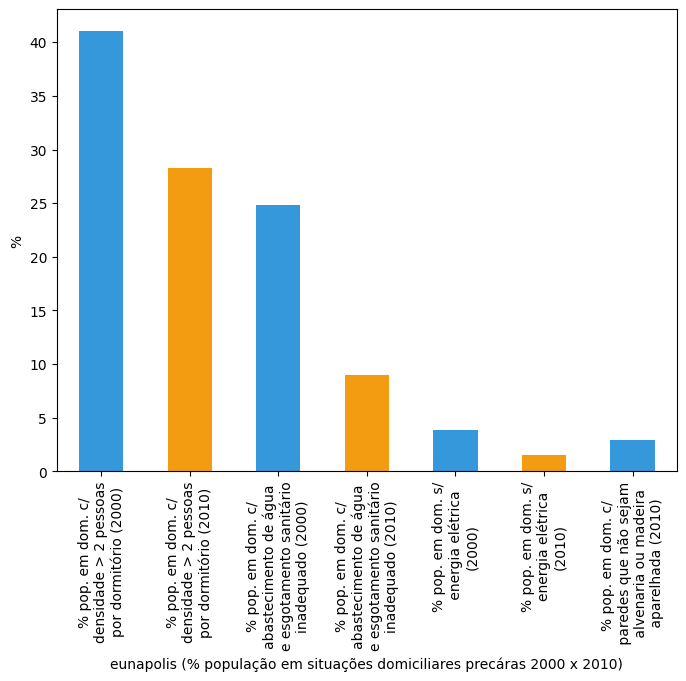

...

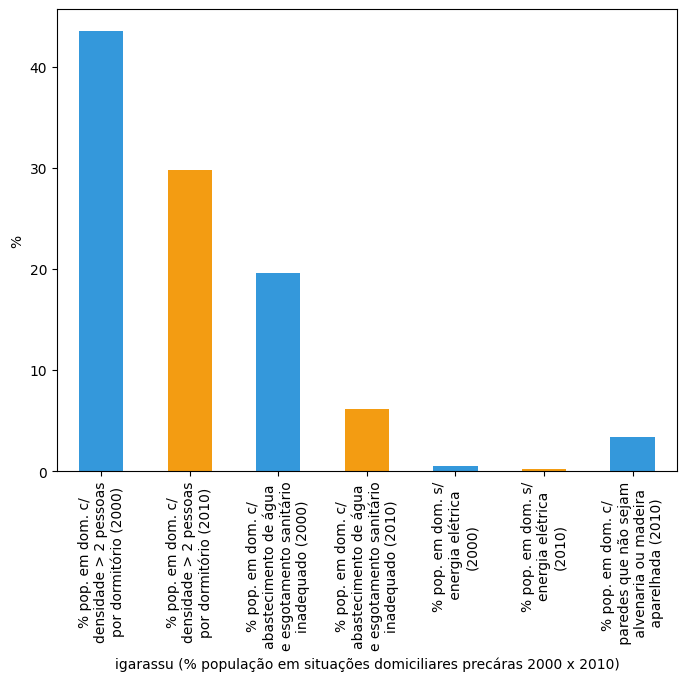

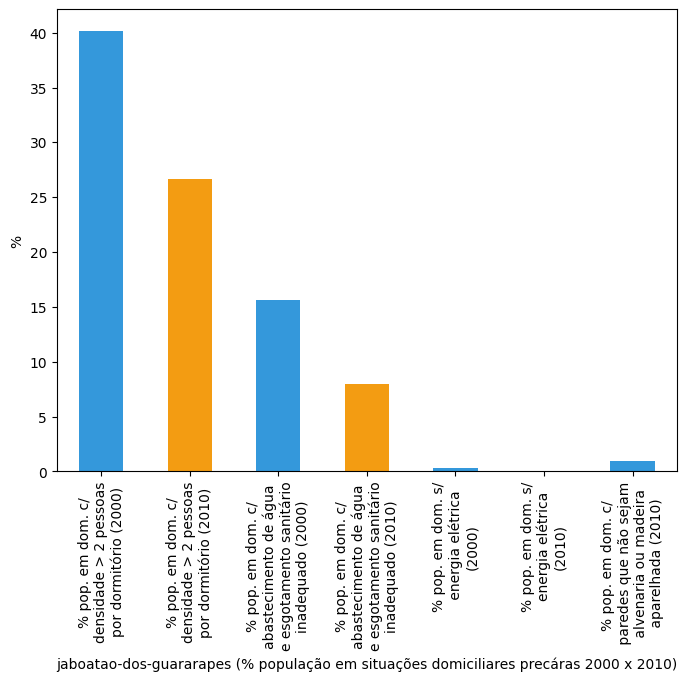

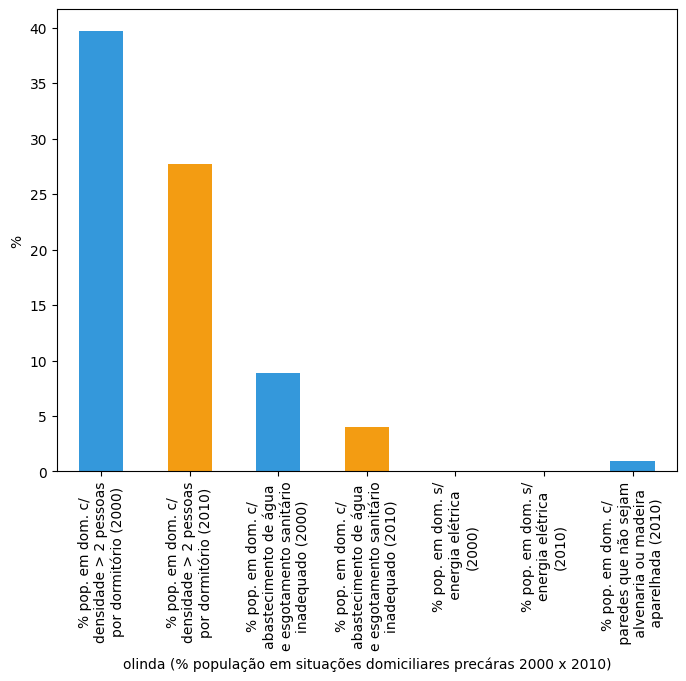

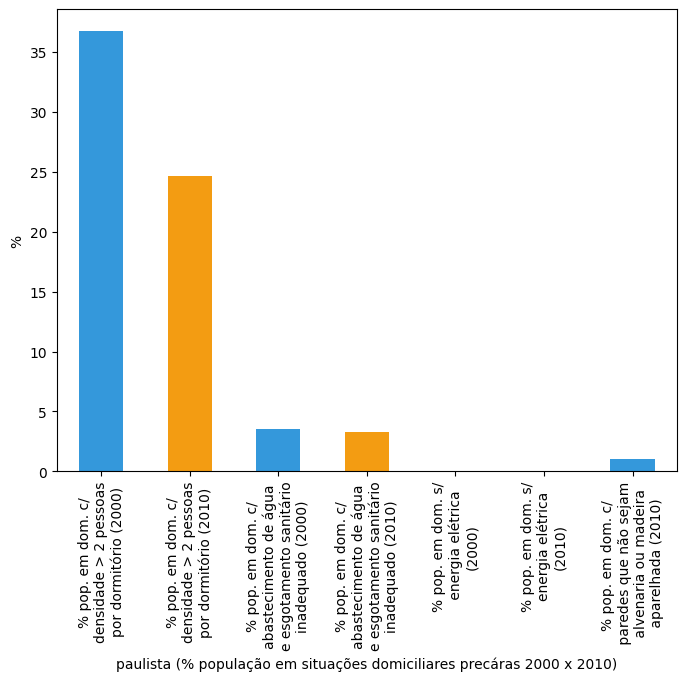

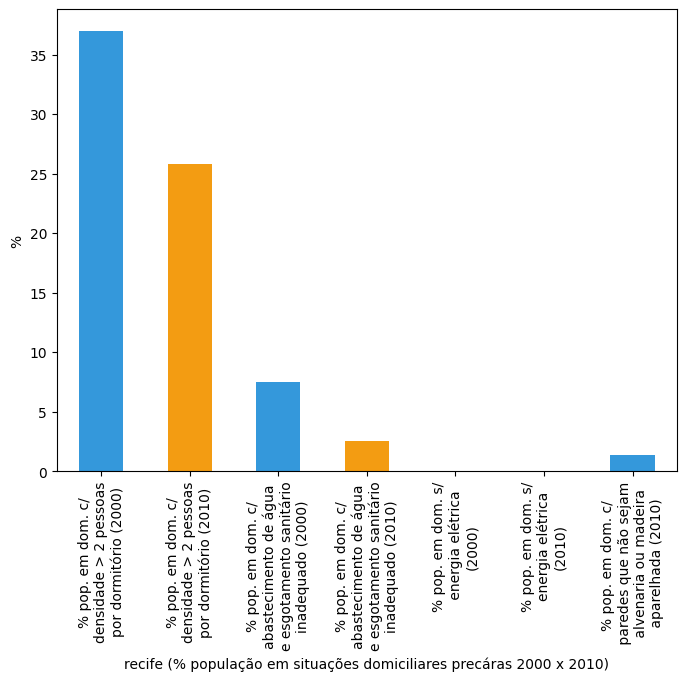

In [323]:
# Gráfico Municipal DF_Domic_Prec:

# '% da população que vive em domicílios com densidade superior a 2 pessoas por dormitório 2000',
# '% da população que vive em domicílios com densidade superior a 2 pessoas por dormitório 2010'
# '% de pessoas em domicílios com abastecimento de água e esgotamento sanitário inadequados 2000',
# '% de pessoas em domicílios com abastecimento de água e esgotamento sanitário inadequados 2010'
# '% de pessoas em domicílios sem energia elétrica 2000',
# '% de pessoas em domicílios sem energia elétrica 2010'
# '% de pessoas em domicílios com paredes que não sejam de alvenaria ou madeira aparelhada 2010'


df = DF_Domic_Prec.copy()

var1 = '% da população que vive em domicílios com densidade superior a 2 pessoas por dormitório 2010'
var11 = '% da população que vive em domicílios com densidade superior a 2 pessoas por dormitório 2000'
var2 = '% de pessoas em domicílios com abastecimento de água e esgotamento sanitário inadequados 2010'
var22 = '% de pessoas em domicílios com abastecimento de água e esgotamento sanitário inadequados 2000'
var3 = '% de pessoas em domicílios sem energia elétrica 2010'
var33 = '% de pessoas em domicílios sem energia elétrica 2000'
var5 = '% de pessoas em domicílios com paredes que não sejam de alvenaria ou madeira aparelhada 2010' 

cols = [var11, var1, var22, var2, var33, var3, var5]

# Resume df necessário
df = df[['nome_municipio', var11, var1, var22, var2, var33, var3, var5]]
df = df[df['nome_municipio'].isin(Municipios)]
# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce'))

# Renomeia nomes de colunas adicionando quebra de linhas
new_var1  = '% pop. em dom. c/\ndensidade > 2 pessoas\npor dormitório (2010)'
new_var11 = '% pop. em dom. c/\ndensidade > 2 pessoas\npor dormitório (2000)'
new_var2  = '% pop. em dom. c/\nabastecimento de água\ne esgotamento sanitário\ninadequado (2010)'
new_var22 = '% pop. em dom. c/\nabastecimento de água\ne esgotamento sanitário\ninadequado (2000)'
new_var3  = '% pop. em dom. s/\nenergia elétrica\n(2010)'
new_var33 = '% pop. em dom. s/\n energia elétrica\n(2000)'
new_var5  = '% pop. em dom. c/\n paredes que não sejam\n alvenaria ou madeira\n aparelhada (2010)' 

df.rename({
var1 : new_var1,
var11: new_var11,
var2 : new_var2,
var22: new_var22,
var3 : new_var3,
var33: new_var33,
var5 : new_var5,
        }, axis = 1, inplace = True)

# Define set_munic como apenas os que constam em 'nome_municipio' no df reduzido
set_munic = set(df['nome_municipio'].tolist())

# Define valores das cores das barras para o gráfico
blue   = '#3498db'
yellow = '#f39c12'

# Loop produz gráficos para cada município no DF
for munic in Municipios:
        dfx = df

        # Filter df with munic
        dfx = dfx[dfx['nome_municipio'] == munic]
        dfx.set_index('nome_municipio')

        # Define colors for the bars
        colors = [blue, yellow] * 4

        # Plot the bar graph
        ax = dfx.iloc[0, 1:].plot(kind='bar', color=colors, figsize=(8, 6))

        # Set the x and y axis labels
        ax.set_xlabel(f'{munic} (% população em situações domiciliares precáras 2000 x 2010)')
        ax.set_ylabel('%')

        # Save plot to save_path
        plt.savefig(f'{save_path}\\Bar_% população em situações domiciliares precárias 2000 x 2010_{munic}', dpi = 300, bbox_inches='tight' )

        # Show the plot
        plt.show()



#### Plots: DF_Prop_Pop_Sem_Saneamento_SNIS2017_91_10_AL_BA_PE

Gráfico Municipal População atendida por rede de esgoto 2017


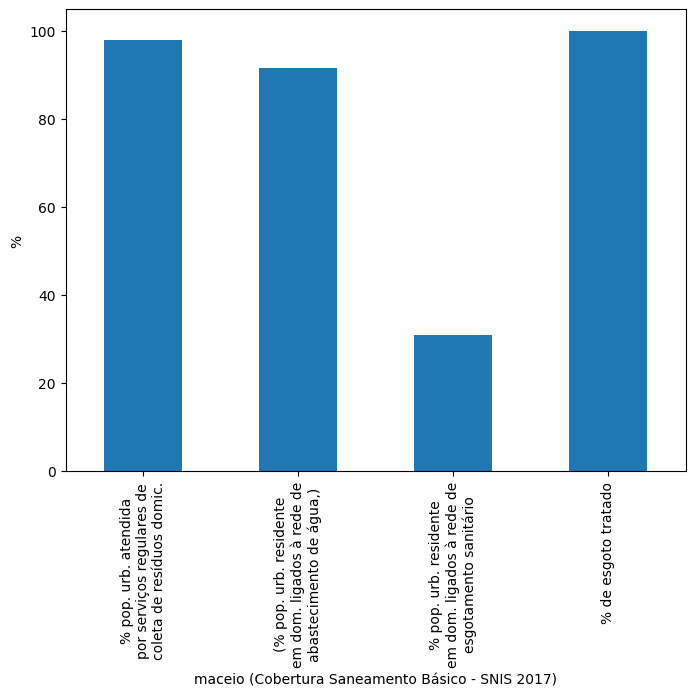

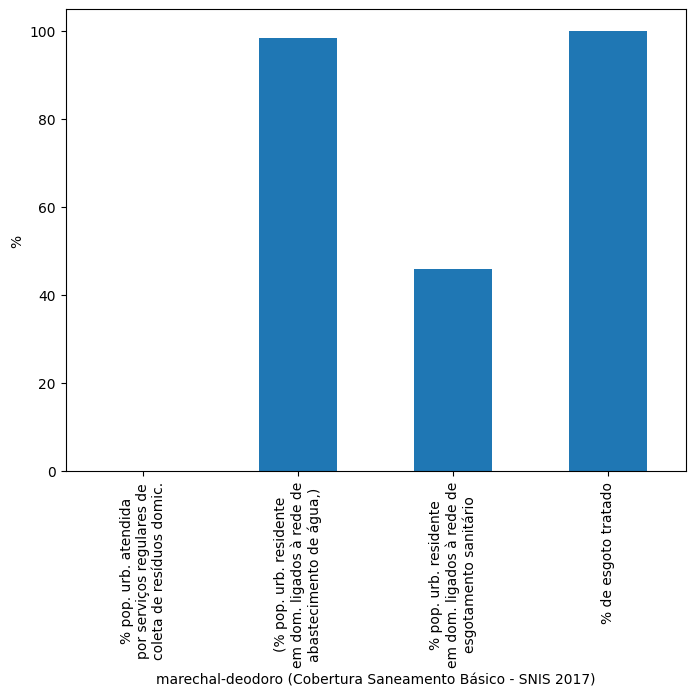

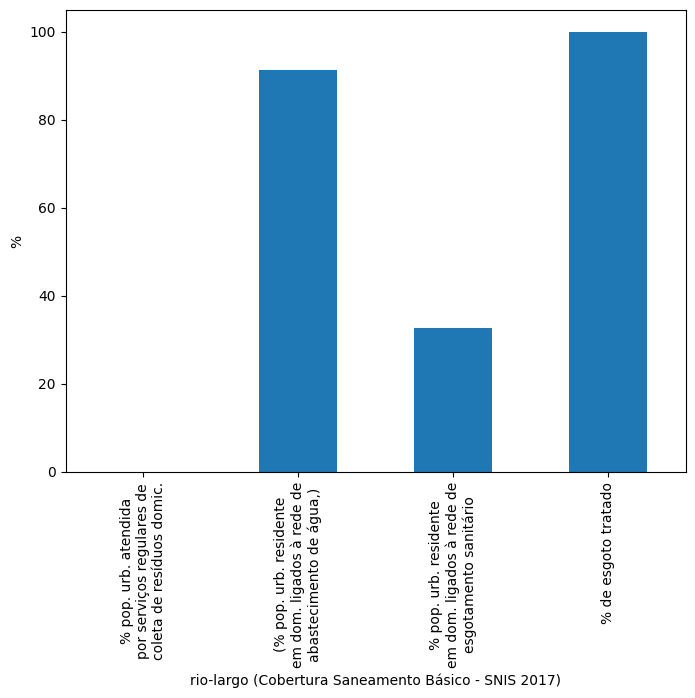

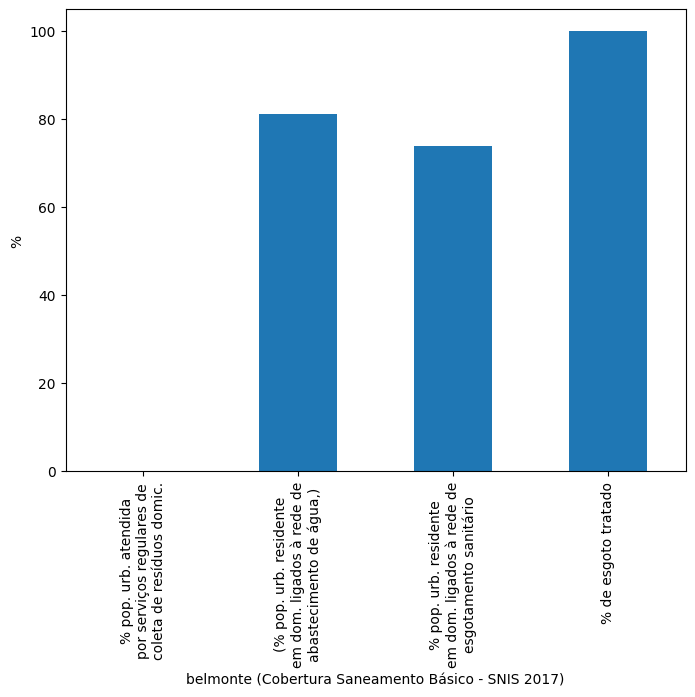

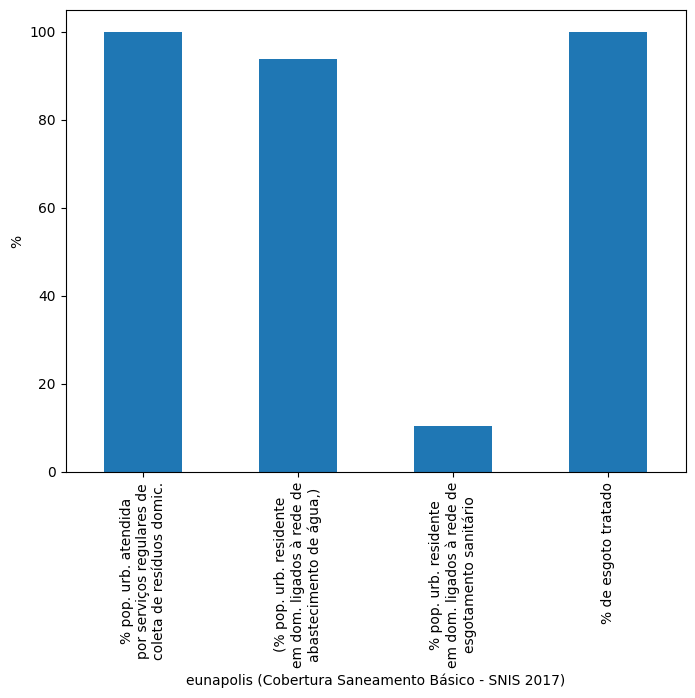

...

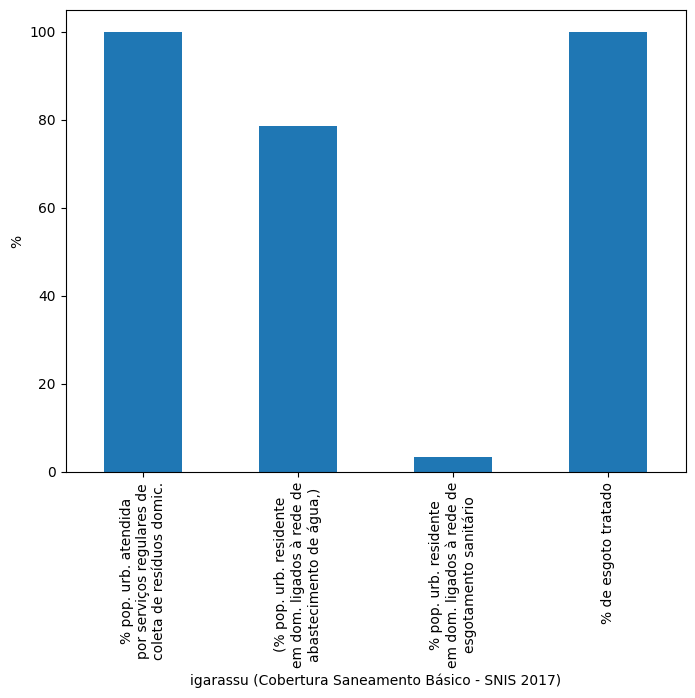

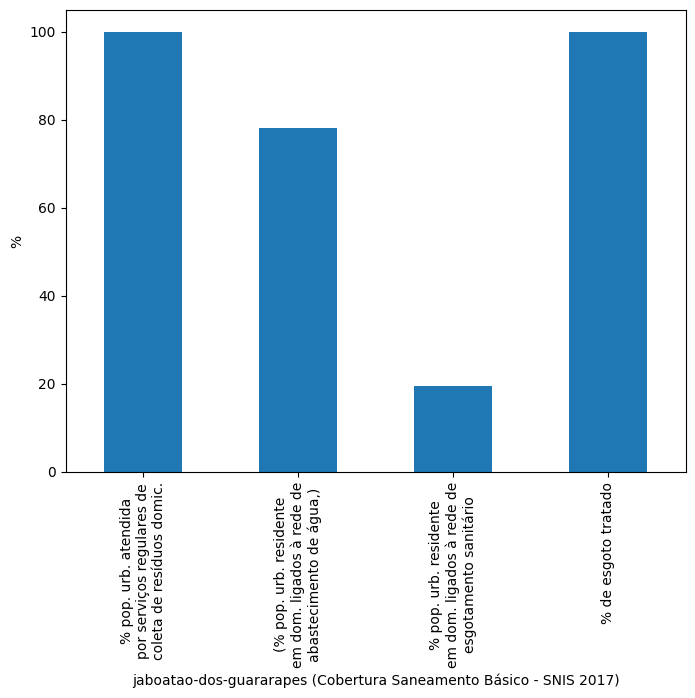

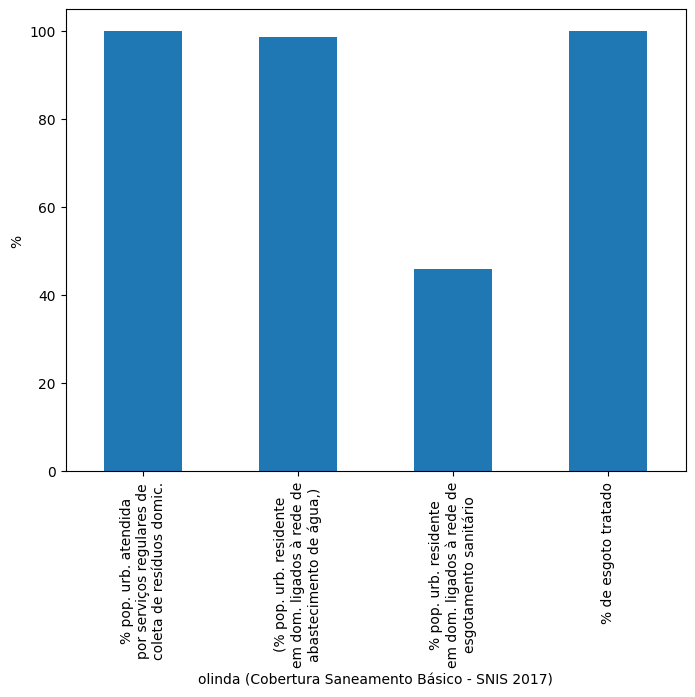

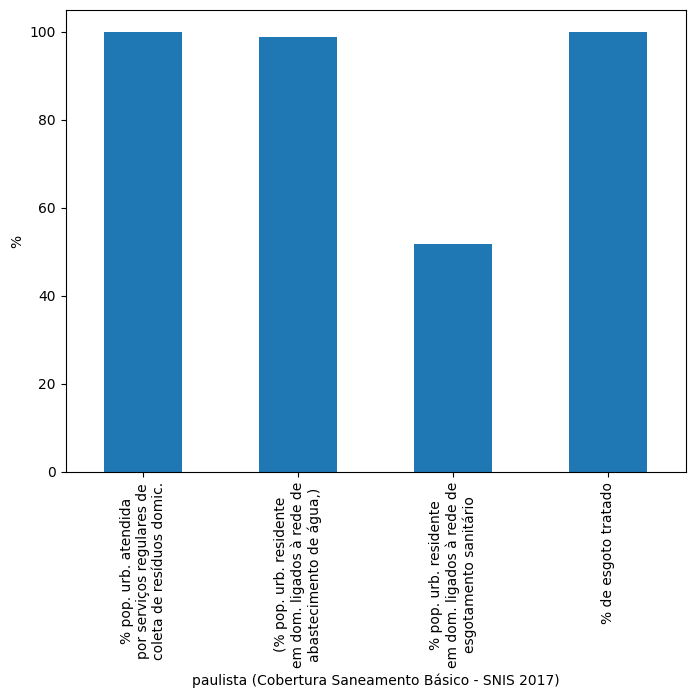

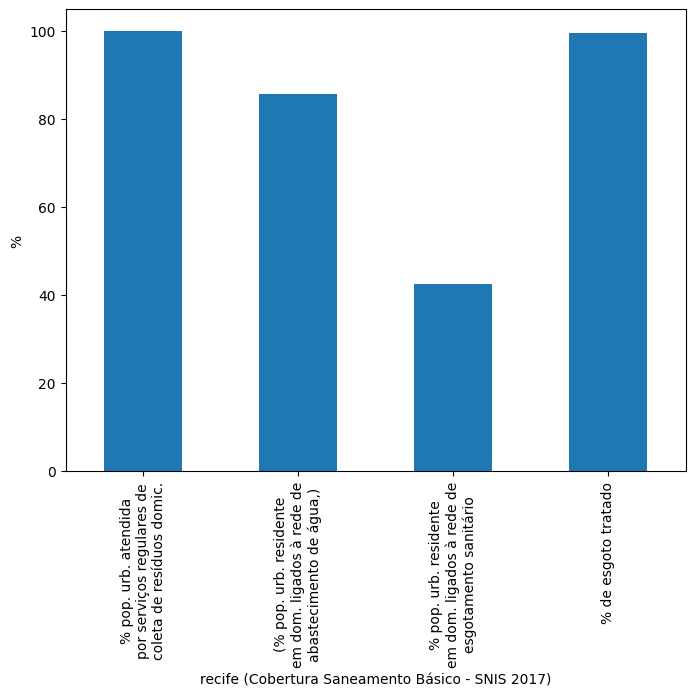

In [324]:
# Gráfico:
'% da população urbana atendida por serviços regulares de coleta de resíduos domiciliares 2017',
'% da população urbana residente em domicílios ligados à rede de abastecimento de água 2017',
'% da população urbana residente em domicílios ligados à rede de esgotamento sanitário 2017',
'% de esgoto tratado 2017'



df = DF_Prop_Pop_Sem_Saneamento_SNIS2017_91_10_AL_BA_PE.copy()

var1 = '% da população urbana atendida por serviços regulares de coleta de resíduos domiciliares 2017'
var2 = '% da população urbana residente em domicílios ligados à rede de abastecimento de água 2017'
var3 = '% da população urbana residente em domicílios ligados à rede de esgotamento sanitário 2017'
var4 = '% de esgoto tratado 2017'

cols = [var1, var2, var3,  var4]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3,  var4]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce'))

# Renomeia nomes de colunas adicionando quebra de linhas
new_var1  = '% pop. urb. atendida\npor serviços regulares de\ncoleta de resíduos domic.'
new_var2  = '% pop. urb. residente\nem dom. ligados à rede de\nabastecimento de água',
new_var3  = '% pop. urb. residente\nem dom. ligados à rede de\nesgotamento sanitário'
new_var4  = '% de esgoto tratado'

df.rename({
var1 : new_var1,
var2 : new_var2,
var3 : new_var3,
var4 : new_var4,
        }, axis = 1, inplace = True)

cols = [new_var1, new_var2, new_var3, new_var4]       

# Define set_munic como apenas os que constam em 'nome_municipio' no df reduzido
set_munic = set(df['nome_municipio'].tolist())

# Loop produz gráficos para cada município no DF
for munic in Municipios:
        dfx = df

        # Filter df with munic
        dfx = dfx[dfx['nome_municipio'] == munic]
        dfx.set_index('nome_municipio')

        # Plot the bar graph
        ax = dfx.iloc[0, 1:].plot(kind='bar', figsize=(8, 6))

        # Set the x and y axis labels
        ax.set_xlabel(f'{munic} (Cobertura Saneamento Básico - SNIS 2017)')
        ax.set_ylabel('%')

        # Save plot to save_path
        # plt.savefig(f'{save_path}\\Bar_% da população atendida por rede de esgoto SNIS 2017_{munic}')

        # Show the plot
        plt.show()

#### Plots: DF_Aglomerados_Subnormais_Municipios.
(Há 4 Nulos entre os Municípios. Os municípios 'belmonte', 'jucurucu', 'prado',  'santa-cruz-cabralia
não possuem estimativas para domicílios em AGSN.)

Gráfico Comparado Total de Domicílios x Total Domicílios em AGSN

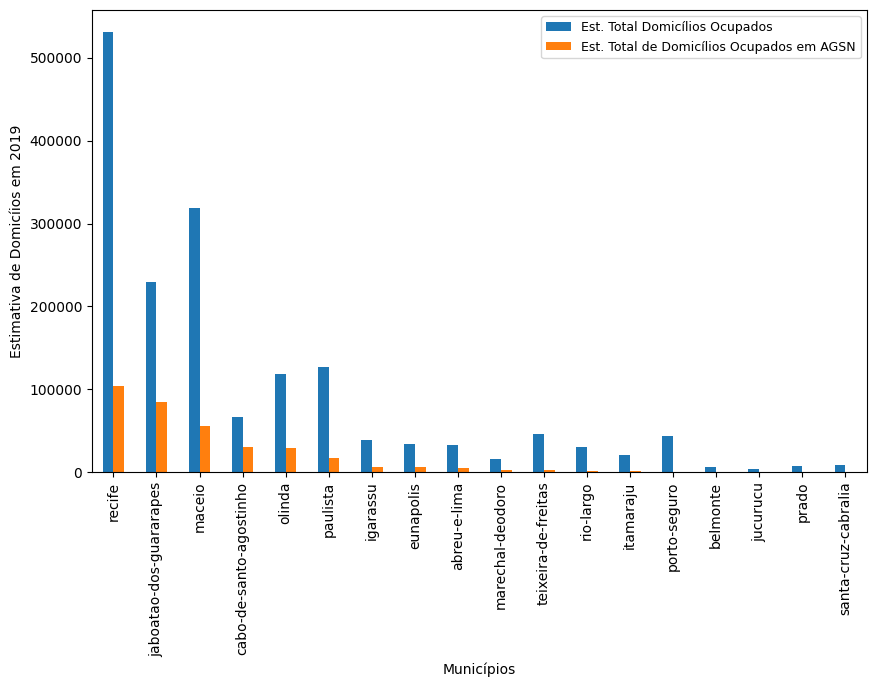

In [325]:
# Gráfico 'Est. Total Domicílios Ocupados 2019' x 'Est. Total de Domicílios Ocupados em AGSN'
#! 'belmonte', 'jucurucu', 'prado',  'santa-cruz-cabralia' = NaNs

df = DF_Aglomerados_Subnormais_Municipios.copy()

var1 = 'Est. Total Domicílios Ocupados 2019'
var2 = 'Est. Total de Domicílios Ocupados em AGSN'

cols = [var1, var2]

# Resume df necessário
df = df[['nome_municipio', var1, var2]]

df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

# Renomeia nomes de colunas adicionando quebra de linhas
new_var1 = 'Est. Total Domicílios Ocupados'
new_var2 = 'Est. Total de Domicílios Ocupados em AGSN'

df.rename({
        var1: new_var1,
        var2: new_var2
        }, axis = 1, inplace = True)

# Reatribui nomes às variáveis
var1 = new_var1
var2 = new_var2
cols = [var1, var2]

# Reordena colunas
df = df.sort_values(var2, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = cols,
        kind = 'bar',
        legend = True
        )
plt.xlabel('Municípios')
plt.ylabel('Estimativa de Domicíios em 2019')
plt.legend(loc='best', prop = {'size' :9})

save_graph('Total de Domicílios x Total Domicílios em AGSN', 'Municipios')

Gráfico Comparado % Domicílios em AGSN

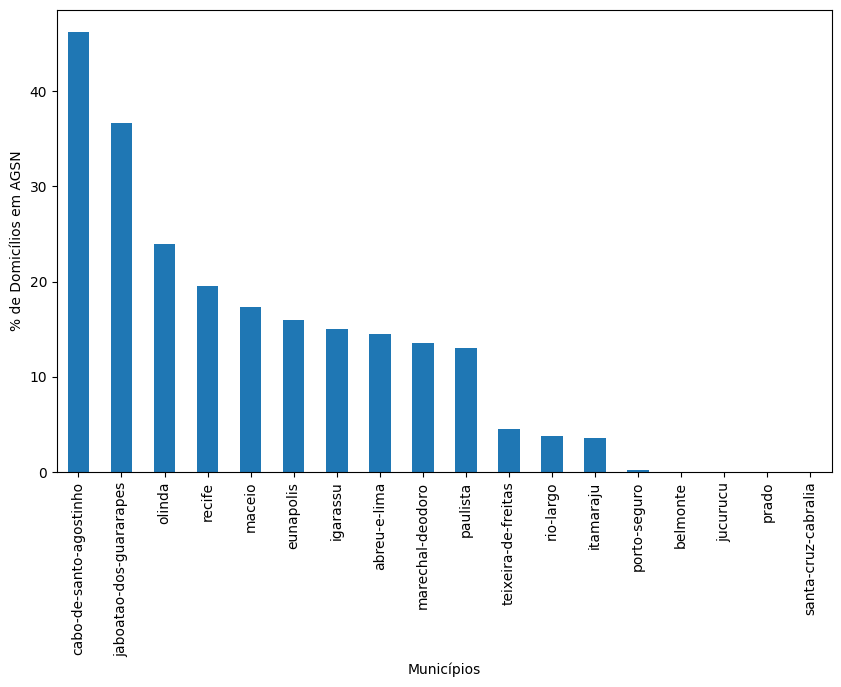

In [326]:
# Gráfico '% de Domicílios em AGSN'
#! 'belmonte', 'jucurucu', 'prado',  'santa-cruz-cabralia' NaNs

df = DF_Aglomerados_Subnormais_Municipios.copy()

var = '% de Domicílios em AGSN'

cols = [var]

# Resume df necessário
df = df[['nome_municipio', var]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

df = df.sort_values(var, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = var,
        kind = 'bar',
        legend = False
        )
plt.xlabel('Municípios')
plt.ylabel(var)

save_graph('Bar_% Domicílios em AGSN', 'Municipios')

Gráfico Pie Chart Municipal AGSN% Domicílios em AGSN

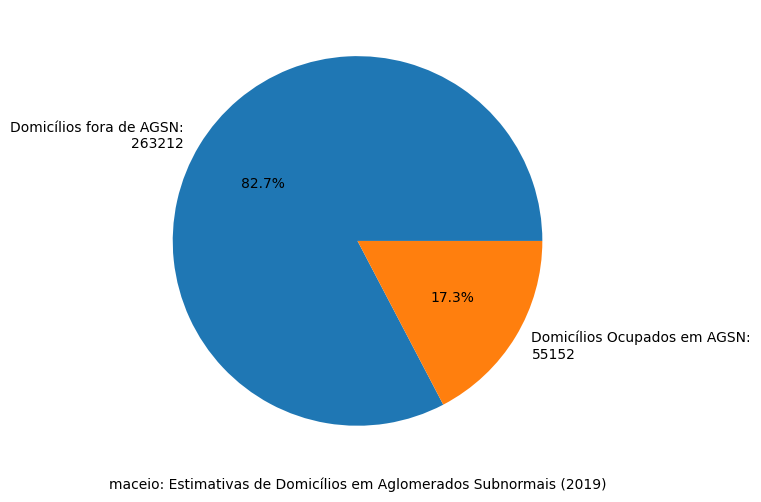

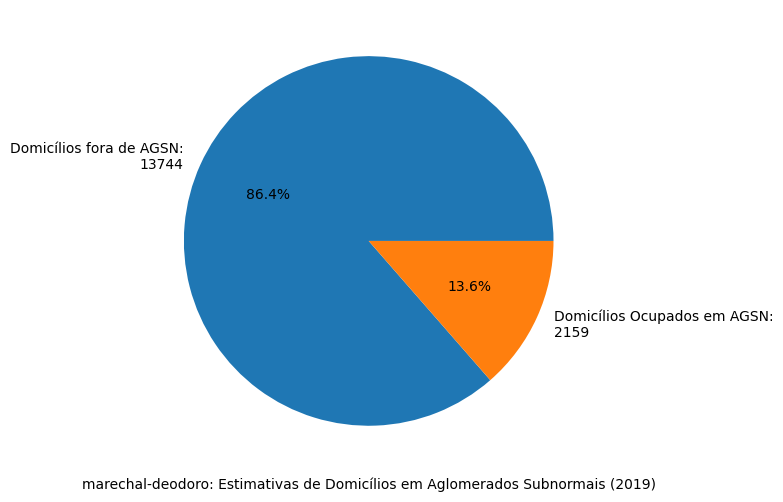

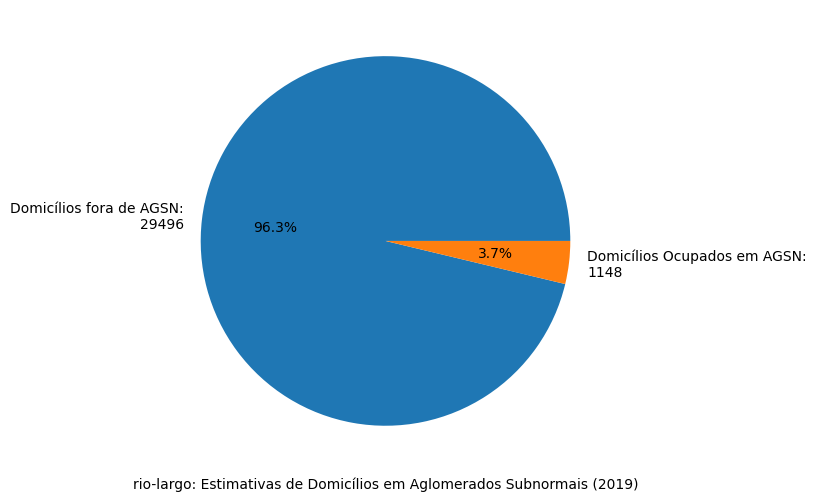

Não há valores parabelmonteMunicipio adicionado em Errors_list


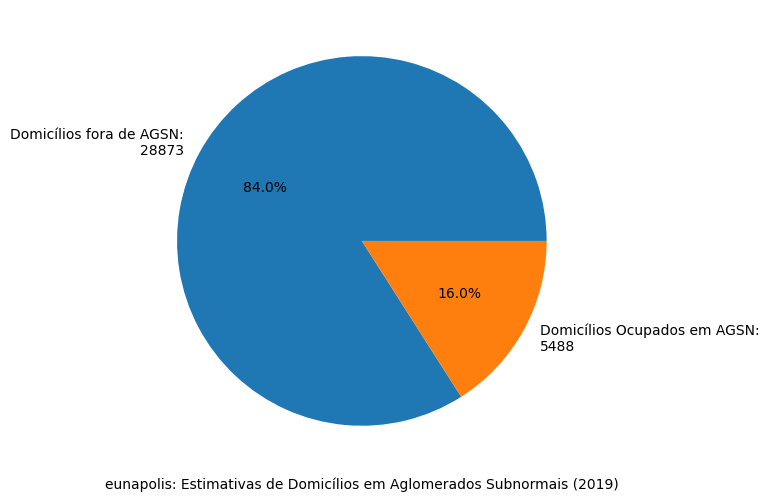

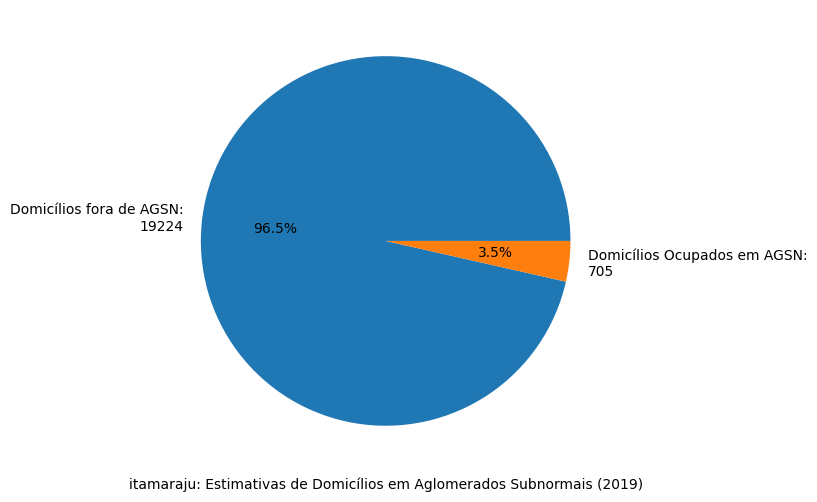

Não há valores parajucurucuMunicipio adicionado em Errors_list


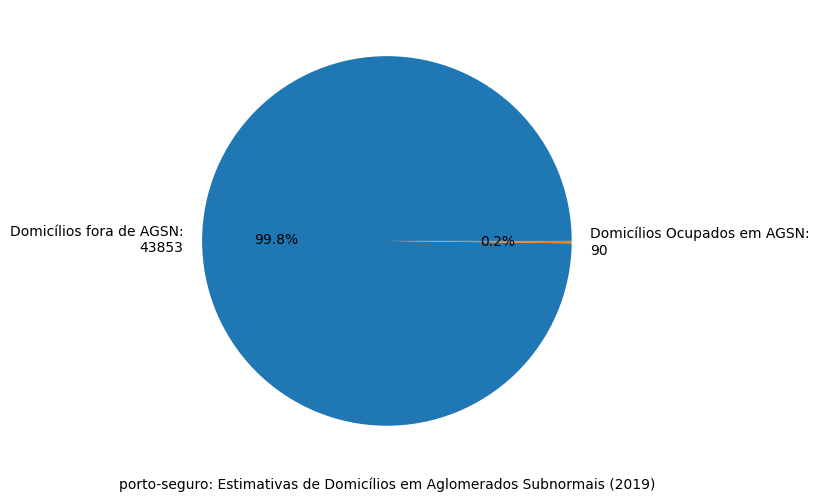

Não há valores parapradoMunicipio adicionado em Errors_list
Não há valores parasanta-cruz-cabraliaMunicipio adicionado em Errors_list


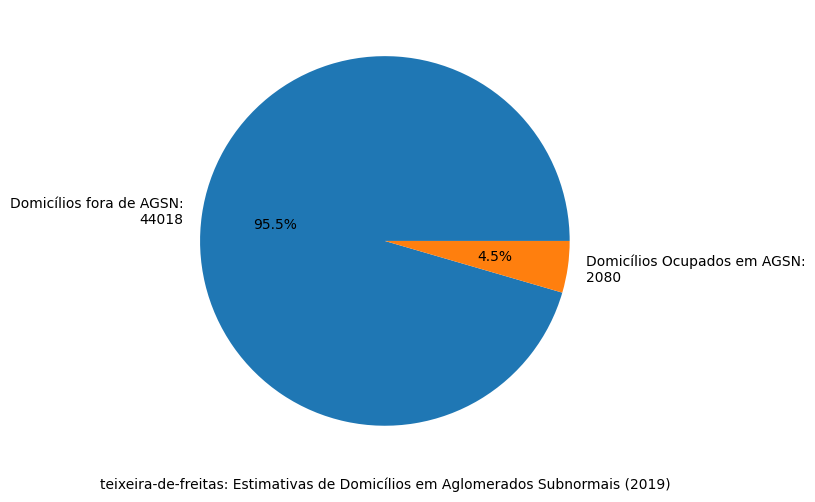

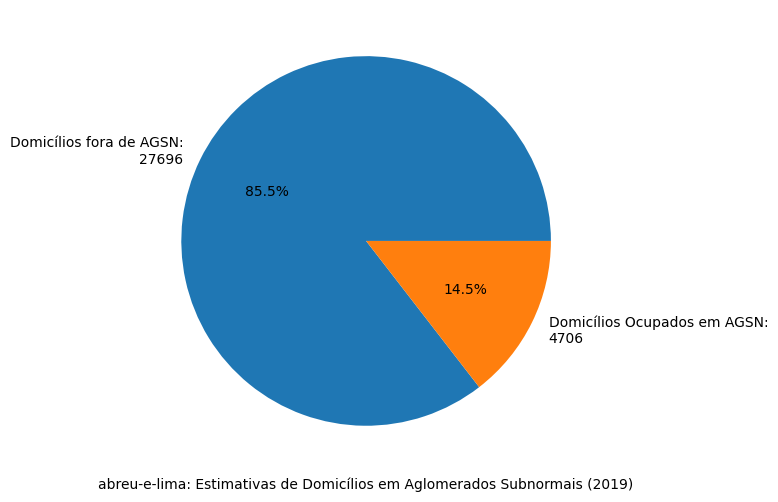

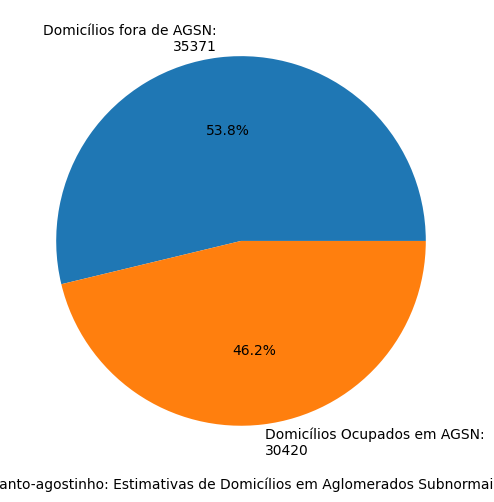

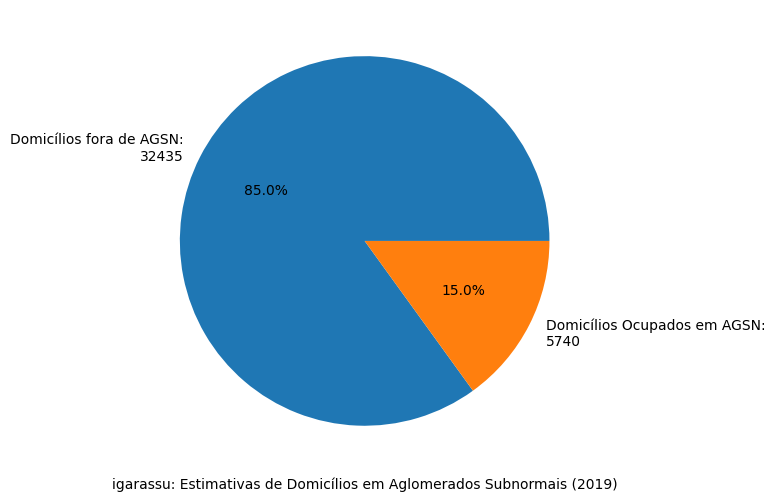

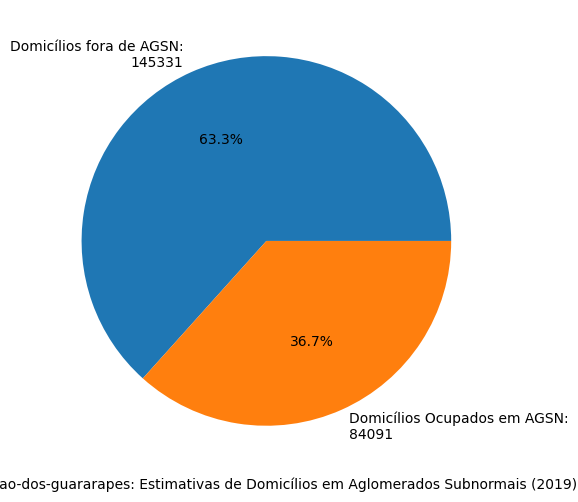

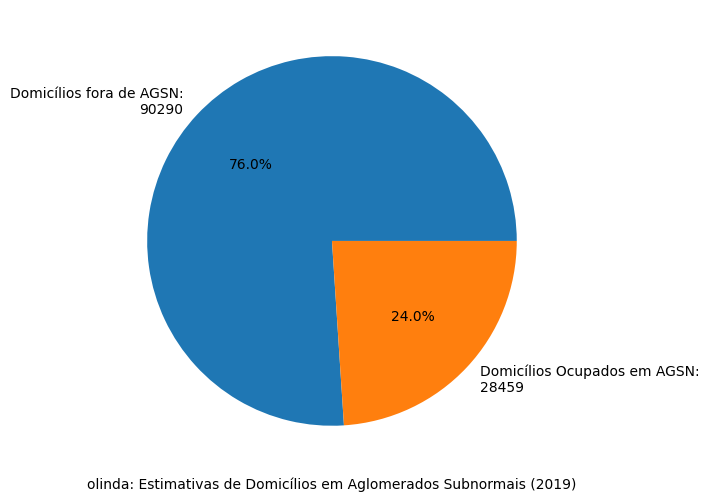

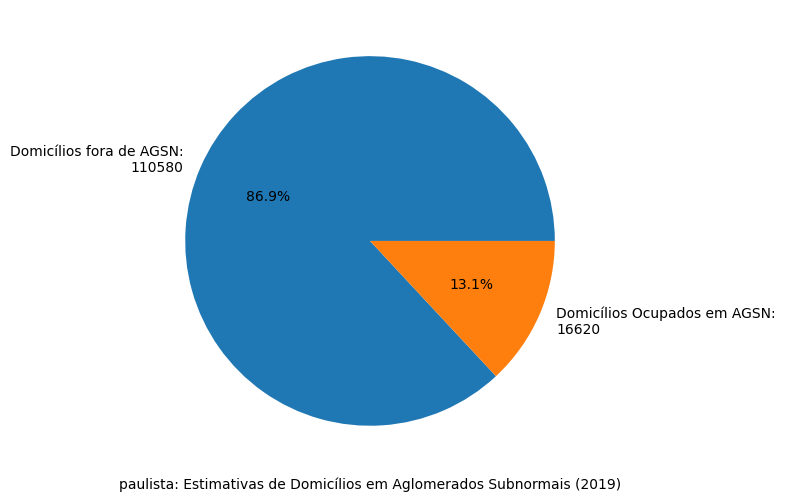

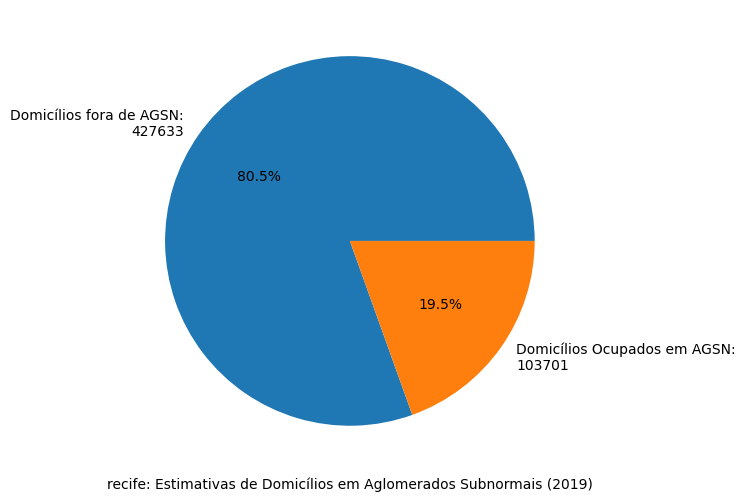

In [327]:
# Gráfico 'Est. Total Domicílios Ocupados 2019' x 'Est. Total de Domicílios Ocupados em AGSN'
#! 'belmonte', 'jucurucu', 'prado',  'santa-cruz-cabralia' NaNs

df = DF_Aglomerados_Subnormais_Municipios.copy()

var1 = 'Est. Total Domicílios Ocupados 2019'
var2 = 'Est. Total de Domicílios Ocupados em AGSN'

cols = [var1, var2]

# Resume df necessário
df = df[['nome_municipio', var1, var2]]

df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )

# Renomeia nomes de colunas adicionando quebra de linhas
new_var1 = 'Est. Total Domicílios Ocupados'
new_var2 = 'Est. Total de Domicílios Ocupados em AGSN'

df.rename({
        var1: new_var1,
        var2: new_var2
        }, axis = 1, inplace = True)

# Reatribui nomes às variáveis
var1 = new_var1
var2 = new_var2
cols = [var1, var2]

# Loop de criação dos pie charts para pop_situ_domic_df
set_munic = set(df['nome_municipio'].tolist())

df['Est. Total Domicílios fora de AGSN'] = df.apply(lambda row: row[var1] - row[var2], axis = 1)

df['Est. Total Domicílios Ocupados'].dtype

for i, row in df.iterrows():
        try:
                dfx = df[['Est. Total Domicílios fora de AGSN', 'Est. Total de Domicílios Ocupados em AGSN']]
                percents = dfx.iloc[i] / df['Est. Total Domicílios Ocupados'].iloc[i]
                label1 = f'Domicílios fora de AGSN:\n{round(df["Est. Total Domicílios fora de AGSN"].iloc[i])}'
                label2 = f'Domicílios Ocupados em AGSN:\n{round(df["Est. Total de Domicílios Ocupados em AGSN"].iloc[i])}'
                labels=[label1, label2]
                sizes = percents.values
                plt.pie(sizes, labels=labels, autopct='%1.1f%%')
        except:
                print(f'Não há valores para' + row['nome_municipio'] + 'Municipio adicionado em Errors_list')
                Errors_list.append(row['nome_municipio'])
        else:
                plt.xlabel(row['nome_municipio']+': Estimativas de Domicílios em Aglomerados Subnormais (2019)')
                plt.savefig(f'{save_path}\\Pie_% Domicilios em AGSN 2019_{row["nome_municipio"]}.png')
                plt.show()
        




## Gráficos Áreas de Risco

In [ ]:
# Colunas DF_Areas_Risco_Domic_Pessoas

# 1. Gráfico munic x estado x brasil total de domicilios em áreas de risco (d001)

# 2. Gráfico munic x estado x brasil total de moradores em áreas de risco (d004)

# 3. Gráfico com homens (d011) e mulheres (d018) em domicilios em Areas de risco

# 4. Gráfico estrutura etária da população em áreas de risco (d005 - d0010)

# 5. Gráfico domicilios com água (d025), com esgoto (d033), com esgoto em curso hídrico (d037), sem banheiro (d039), com lixo coletado (d040), com lixo em terreno ou água (d045 + d046) sem energia (d053), com gato elétrico (d051 + d052) em Áreas de Risco

# 6. Gráfico POPULAÇÂO em domicílios com agua (m025), com esgoto (m033), com esgoto em curso hídrico (m037), sem banheiro (m039), com lixo coletado (m040), com lixo jogado em terreno ou curso hídrico (m045+m046),   com energia (m048), sem energia (m053),

# 7. Gráfico domicilios sem rendimento (d069), até1/4, até 1/2, de 1/2 a 1, de 1 a 2, de 2 a 3,  de 3 a 4, 5+ (d062 - d068)

# 8. Gráfico POPULAçAO em domicilio sem rendimento (m069), até1/4, até 1/2, de 1/2 a 1, de 1 a 2, de 2 a 3,  de 3 a 4, 5+ (m062 - m068)

# 9. Total de responsaveis pelo domicilio feminino (m086), responsaveis analfabetos (m090), 

# 10. Gráfico domicilios sem rendimento chefe fem (d092), até 1/2 SM chefe fem (d093 + d094), de 1/2 a 1 SM chefe fem (d095)

# 11. Gráfico POPULAÇÃ em domicilios sem rendimento chefe fem (d100), até 1/2 SM chefe fem (m093 + m094), de 1/2 a 1 SM chefe fem (m095)

# 12. Gráfico rendimento médio domiciliar per capita munic x estado x brasil

# 13. Gráfico Domicílios em extrema vulnerabilidade 
# 	*  d115 Domicílios particulares permanentes com moradores com idade  menor ou igual a 5 anos e/ou maior ou igual a 60 anos, sem rendimento ou  com rendimento nominal mensal domiciliar per capita até ½ salário mínimo
# 	*  d121 Domicílios particulares permanentes com moradores com idade  menor ou igual a 5 anos e/ou maior ou igual a 60 anos, sem rendimento ou com rendimento nominal mensal domiciliar per capita até ½ salário mínimo, com responsável pelo domicílio não alfabetizado
# 	*  d127 Domicílios particulares permanentes com moradores com idade  menor ou igual a 5 anos e/ou maior ou igual a 60 anos, sem rendimento ou  com rendimento nominal mensal domiciliar per capita até ½ salário mínimo, sem esgoto sanitário via rede geral de esgoto ou pluvial ou fossa séptica, com responsável pelo domicílio não alfabetizado
# 	*  d133 Domicílios particulares permanentes com moradores com idade  menor ou igual a 5 anos e/ou maior ou igual a 60 anos, sem rendimento ou  com rendimento nominal mensal domiciliar per capita até ½ salário mínimo, sem esgoto sanitário via rede geral de esgoto ou pluvial ou fossa séptica

# 14. Gráfico POPULAÇÃO em Domicílios em extrema vulnerabilidade 
# 	*  m163 Moradores em domicílios particulares permanentes com idade menor ou igual a 5 anos e/ou maior ou igual a 60 anos, sem rendimento ou  com rendimento nominal mensal domiciliar per capita até ½ salário mínimo
# 	*  m169 Moradores em domicílios particulares permanentes com idade menor ou igual a 5 anos e/ou maior ou igual a 60 anos, sem rendimento ou com rendimento nominal mensal domiciliar per capita até ½ salário mínimo, com responsável pelo domicílio não alfabetizado
# 	*  m175 Moradores em domicílios particulares permanentes com idade menor ou igual a 5 anos e/ou maior ou igual a 60 anos, sem rendimento ou  com rendimento nominal mensal domiciliar per capita até ½ salário mínimo, sem esgoto sanitário via rede geral de esgoto ou pluvial ou fossa séptica, com responsável pelo domicílio não alfabetizado
# 	*  m181 Moradores em domicílios particulares permanentes com idade menor ou igual a 5 anos e/ou maior ou igual a 60 anos, sem rendimento ou  com rendimento nominal mensal domiciliar per capita até ½ salário mínimo, sem esgoto sanitário via rede geral de esgoto ou pluvial ou fossa séptica



Gráfico Total de Domicílios em AR (O.K.)

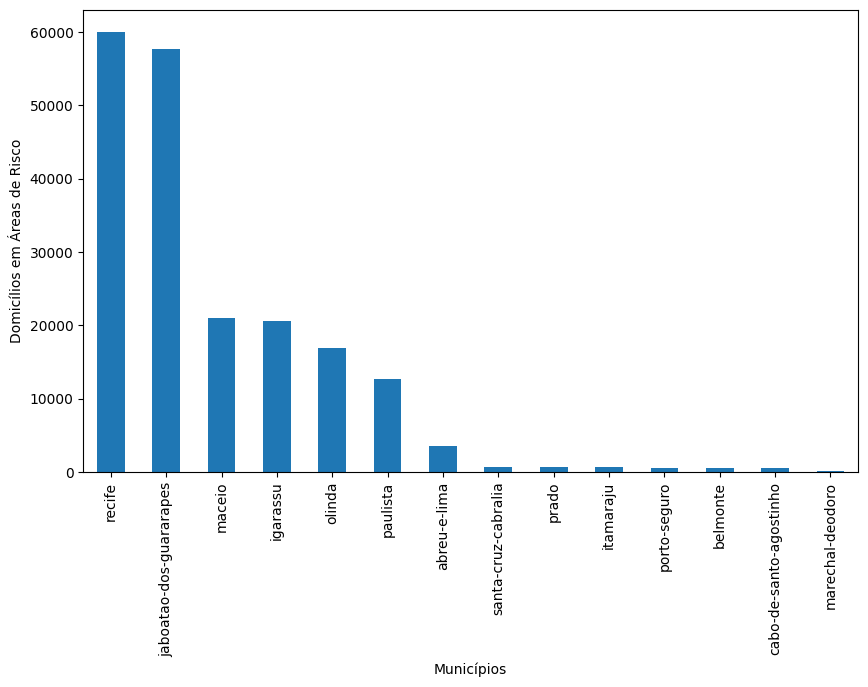

In [328]:
# Gráfico Comparado 'd001'

df = DF_Areas_Risco_Domic_Pessoas.copy()

var = 'D001'

cols = [var]

# Resume df necessário
df = df[['nome_municipio', var]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
df = df.sort_values(var, ascending = False)


# Agregando df por município e somando os valores da variável trabalhada com groupby().sum()
df = df.groupby(['nome_municipio'])[var].sum()
df = df.sort_values(ascending = False)

df.plot(
        x = 'nome_municipio',
        y = var,
        kind = 'bar',
        legend = False
        )
plt.xlabel('Municípios')
plt.ylabel('Domicílios em Áreas de Risco')

save_graph('Bar_Total de Domicílios em AR', 'Municipios')


Gráfico Comparado Pessoas em Áreas de Risco (O.K.)

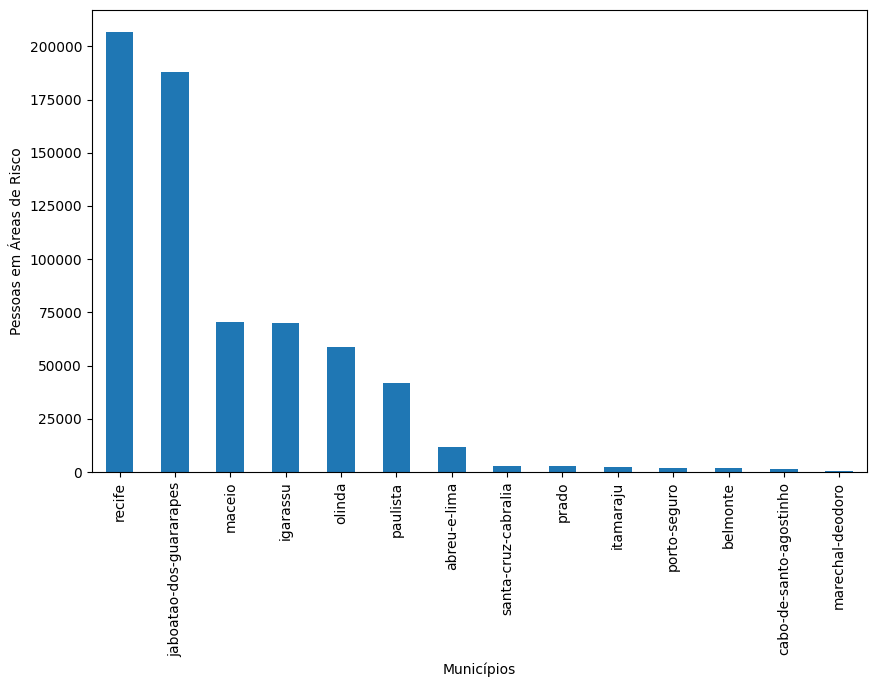

In [329]:
# Gráfico Comparado 'D004'

df = DF_Areas_Risco_Domic_Pessoas.copy()

var = 'D004'

cols = [var]

# Resume df necessário
df = df[['nome_municipio', var]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
df = df.sort_values(var, ascending = False)


# Agregando df por município e somando os valores da variável trabalhada com groupby().sum()
df = df.groupby(['nome_municipio'])[var].sum()
df = df.sort_values(ascending = False)

df.plot(
        x = 'nome_municipio',
        y = var,
        kind = 'bar',
        legend = False
        )
plt.xlabel('Municípios')
plt.ylabel('Pessoas em Áreas de Risco')

save_graph('Bar_Pessoas em AR', 'Municipios')

Gráfico Comparado Homens e Mulheres em Áreas de Risco (O.K.)

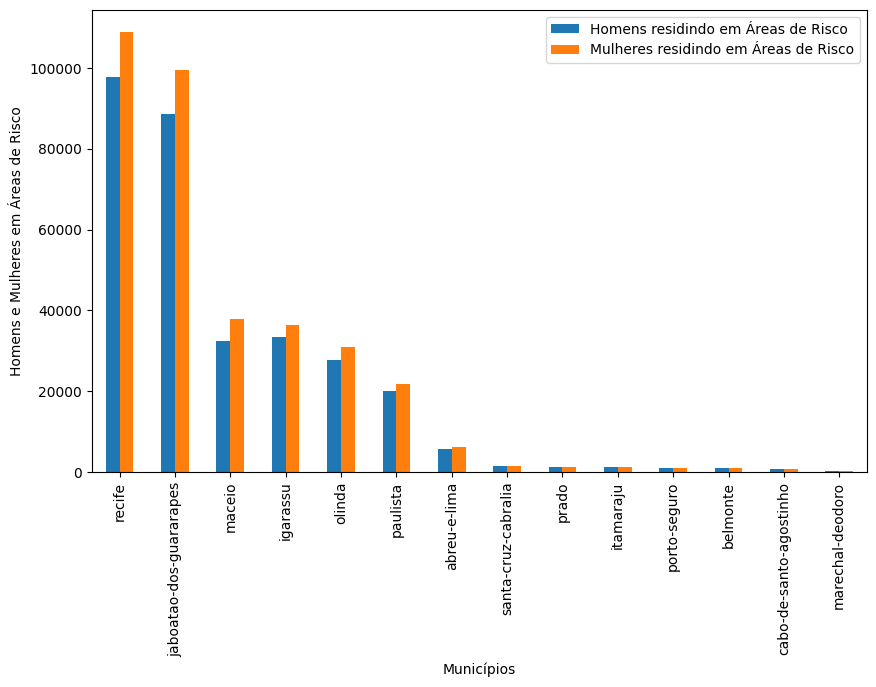

In [330]:
# Gráfico Comparado 'D011', 'D018'

df = DF_Areas_Risco_Domic_Pessoas.copy()

var1 = 'D011'
var2 = 'D018'

cols = [var1, var2]

# Resume df necessário
df = df[['nome_municipio', var1, var2]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
df = df.sort_values(var2, ascending = False)

# Armazena novos nomes de variáveis
nvar1 = 'Homens residindo em Áreas de Risco' 
nvar2 = 'Mulheres residindo em Áreas de Risco'

df.rename({var1 : nvar1, var2 : nvar2}, axis = 1, inplace = True)
cols = [nvar1, nvar2]

# Agregando df por município e somando os valores das variáveis trabalhadas com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum()
df = df.sort_values(nvar2, ascending = False)


df.plot(
        # x = 'nome_municipio',
        y = cols,
        kind = 'bar',
        legend = True
        )
plt.xlabel('Municípios')
plt.ylabel('Homens e Mulheres em Áreas de Risco')

save_graph('Bar_Homens e Mulheres em AR', 'Municipios')

Gráfico Municipal Pie Mulheres x Homens em Áreas de Risco (O.K.)

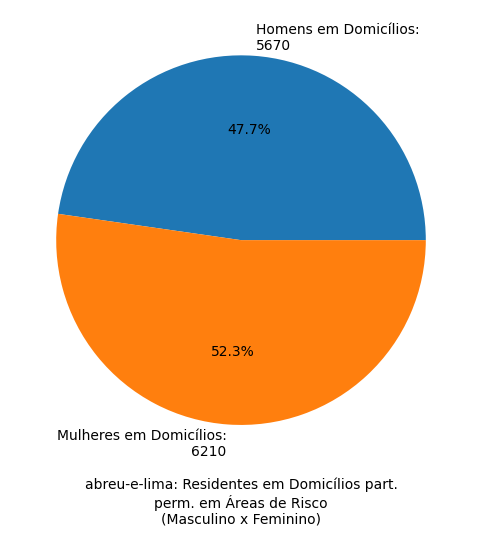

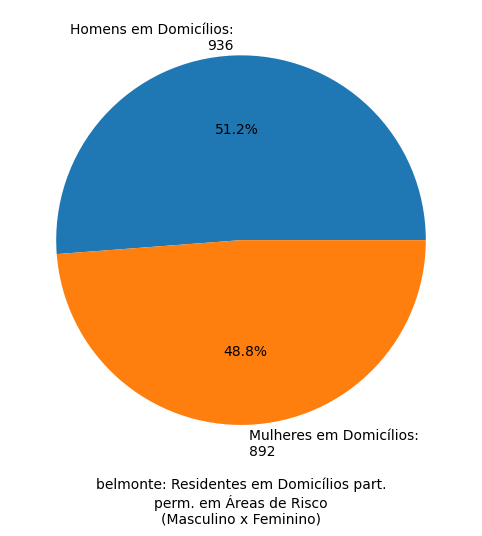

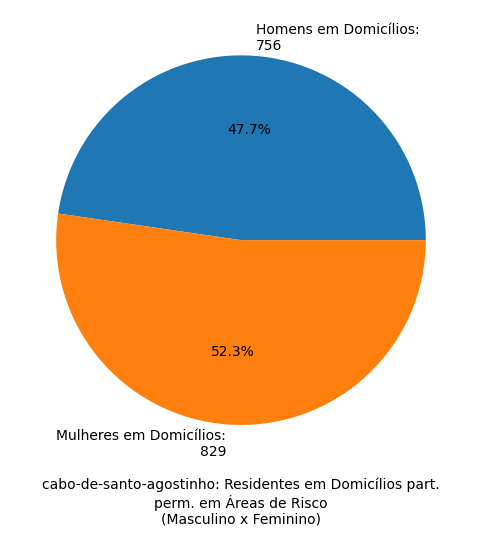

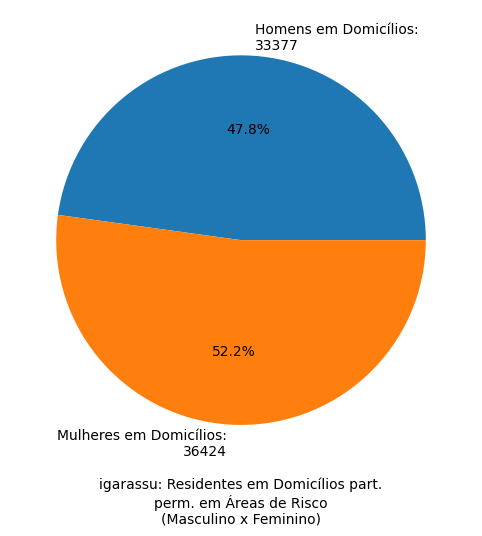

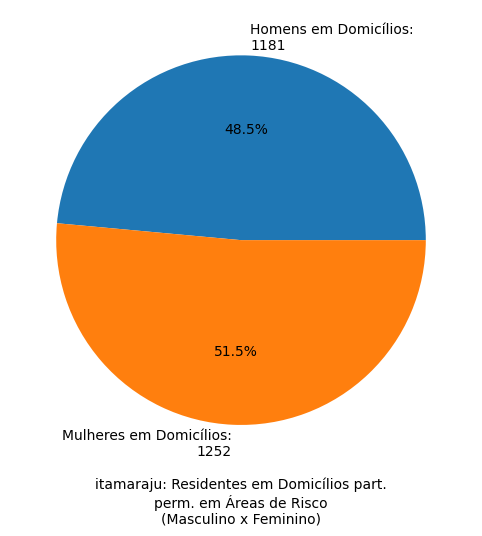

...

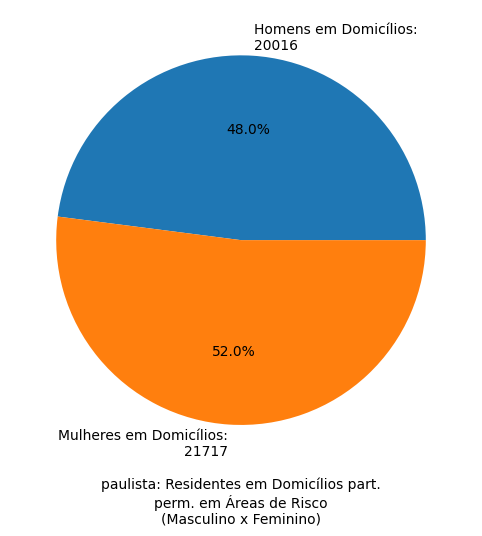

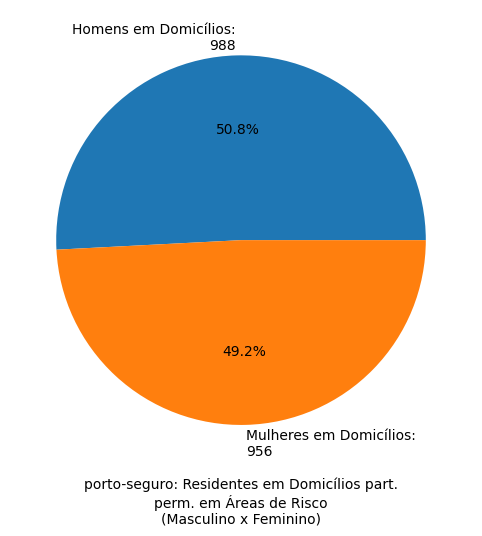

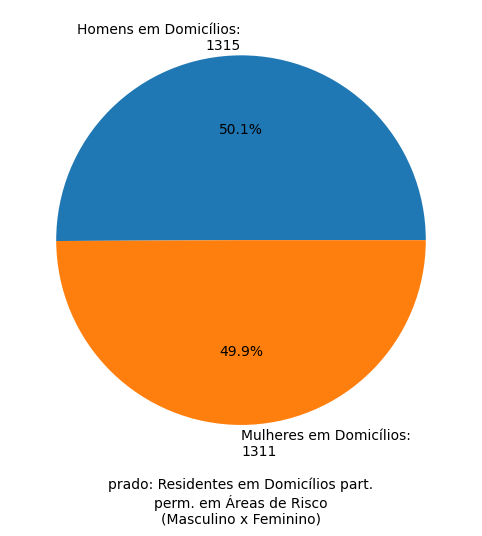

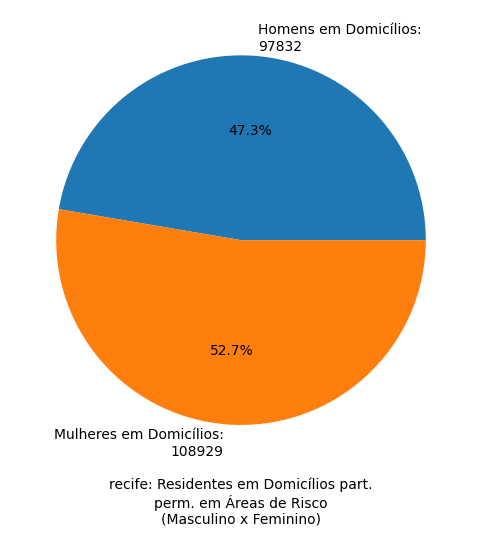

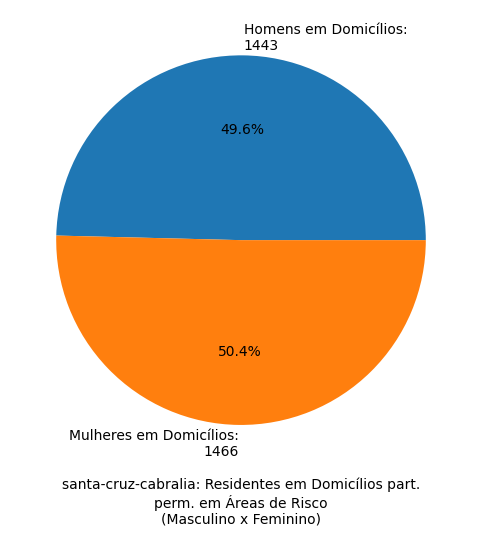

In [331]:
#Gráfico
# 'D011' 'Homens em domicílios particulares permanentes'
# 'D018' 'Mulheres em domicílios particulares permanentes'

df = DF_Areas_Risco_Domic_Pessoas.copy()

var  = 'D011'
var2 = 'D018'
cols = [var, var2]

# Resume df necessário
df = df[['nome_municipio', var, var2]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
df = df.sort_values(var, ascending = False)


# Agregando df por município e somando os valores da variável trabalhada com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum().reset_index()

# Loop de criação dos pie charts para pop_situ_domic_df

df['Est. Total'] = df.apply(lambda row: row[var] + row[var2], axis = 1)

for i, row in df.iterrows():
        try:
                dfx = df[cols]
                percents = dfx.iloc[i] / df['Est. Total'].iloc[i]
                label1 = f'Homens em Domicílios:\n{round(df[var].iloc[i])}'
                label2 = f'Mulheres em Domicílios:\n{round(df[var2].iloc[i])}'
                labels=[label1, label2]
                sizes = percents.values
                plt.pie(sizes, labels=labels, autopct='%1.1f%%')
        except:
                print(f'Não há valores para' + row['nome_municipio'] + 'Municipio adicionado em Errors_list')
                Errors_list.append(row['nome_municipio'])
        else:
                plt.xlabel(row['nome_municipio']+': Residentes em Domicílios part.\nperm. em Áreas de Risco\n(Masculino x Feminino)')
                plt.savefig(f'{save_path}\\Pie_% Residentes em Domicílios p p Masculino x Feminino_{row["nome_municipio"]}.png')
                plt.show()

Gráfico Comparado Jovens e Idosos em Áreas de Risco (O.K.)

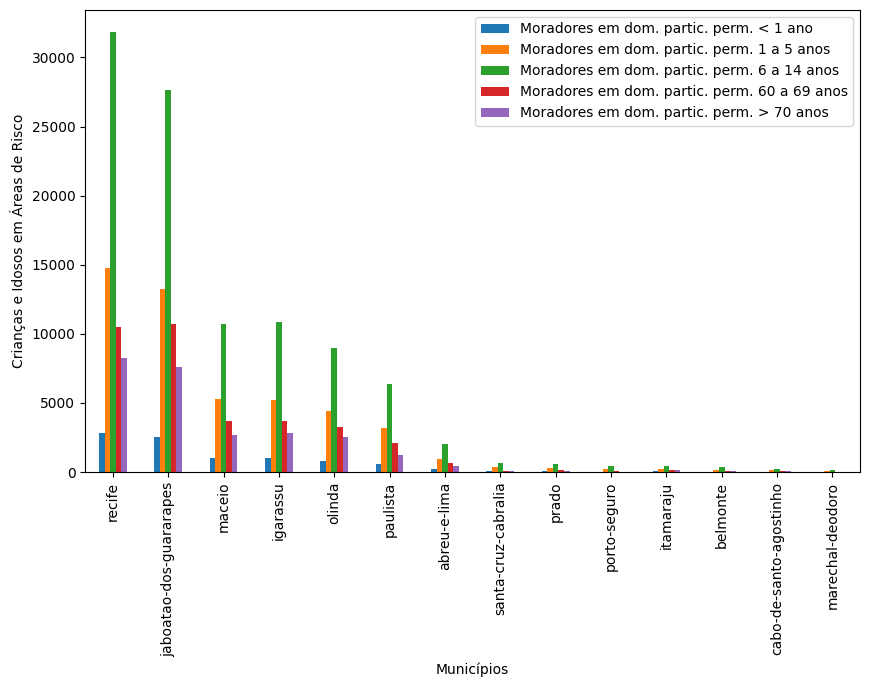

In [332]:
# Gráfico 'D005', 'D006', 'D007', 'D008', 'D009', 'D010'

df = DF_Areas_Risco_Domic_Pessoas.copy()

var1 = 'D005'
var2 = 'D006'
var3 = 'D007'
var5 = 'D009'
var6 = 'D010'
cols = [var1, var2, var3, var5, var6]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, var5, var6]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
df = df.sort_values(var2, ascending = False)

# Armazena novos nomes de variáveis
nvar1 = 'Moradores em dom. partic. perm. < 1 ano'
nvar2 = 'Moradores em dom. partic. perm. 1 a 5 anos'
nvar3 = 'Moradores em dom. partic. perm. 6 a 14 anos'
nvar5 = 'Moradores em dom. partic. perm. 60 a 69 anos'
nvar6 = 'Moradores em dom. partic. perm. > 70 anos'

df.rename({
var1: nvar1,
var2: nvar2,
var3: nvar3,
var5: nvar5,
var6: nvar6
}, axis = 1, inplace = True)
cols = [nvar1, nvar2, nvar3, nvar5, nvar6]

# Agregando df por município e somando os valores das variáveis trabalhadas com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum()
df = df.sort_values(nvar2, ascending = False)
df

df.plot(
        # x = 'nome_municipio',
        y = cols,
        kind = 'bar',
        legend = True
        )
plt.xlabel('Municípios')
plt.ylabel('Crianças e Idosos em Áreas de Risco')

save_graph('Bar_Jovens e Idosos em AR', 'Municipios')


Gráfico Municipal Estrutura Etária da População em Área de Risco (O.K.)

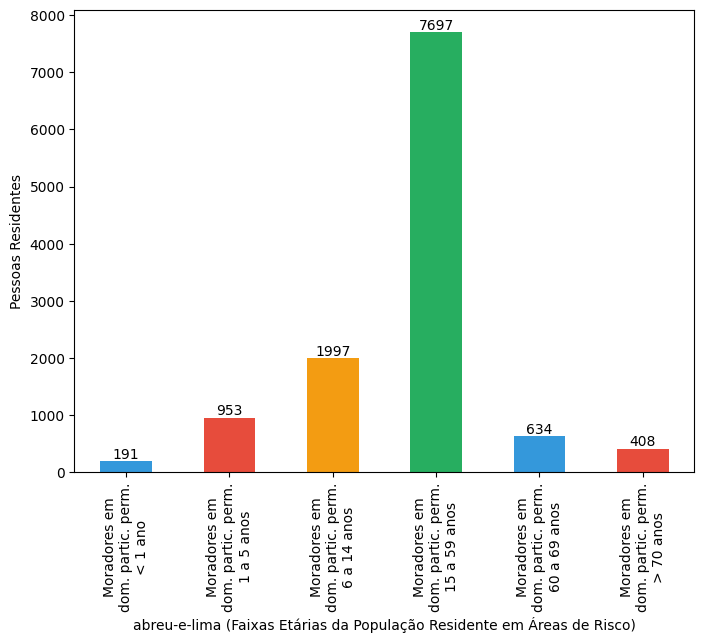

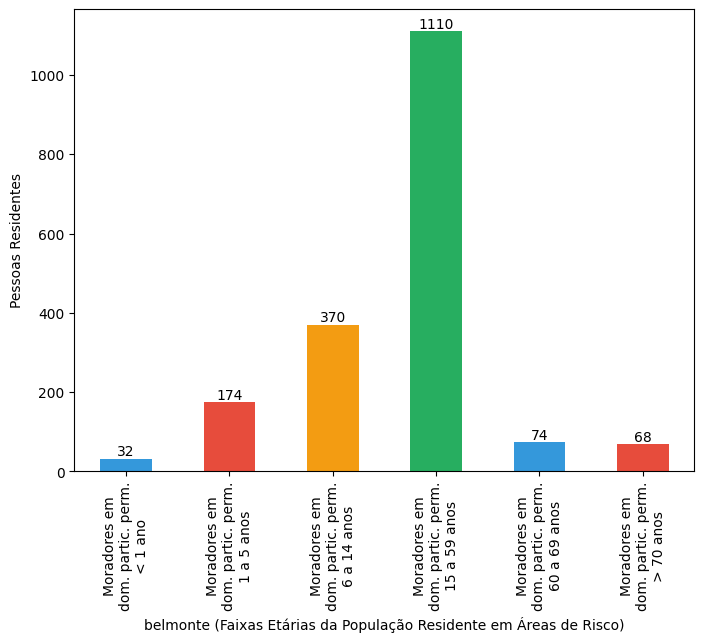

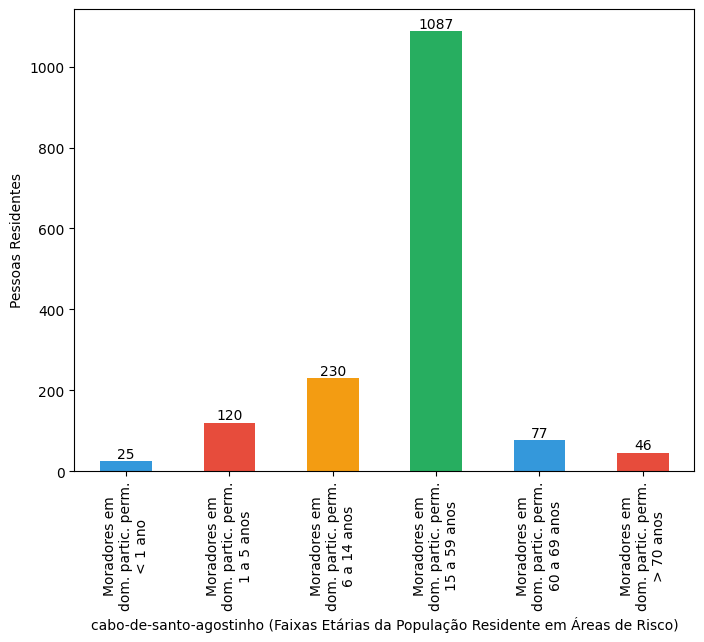

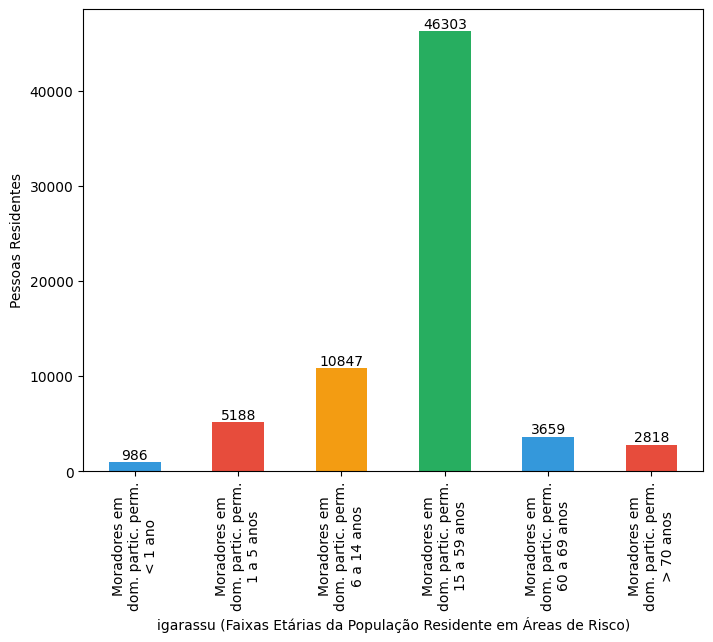

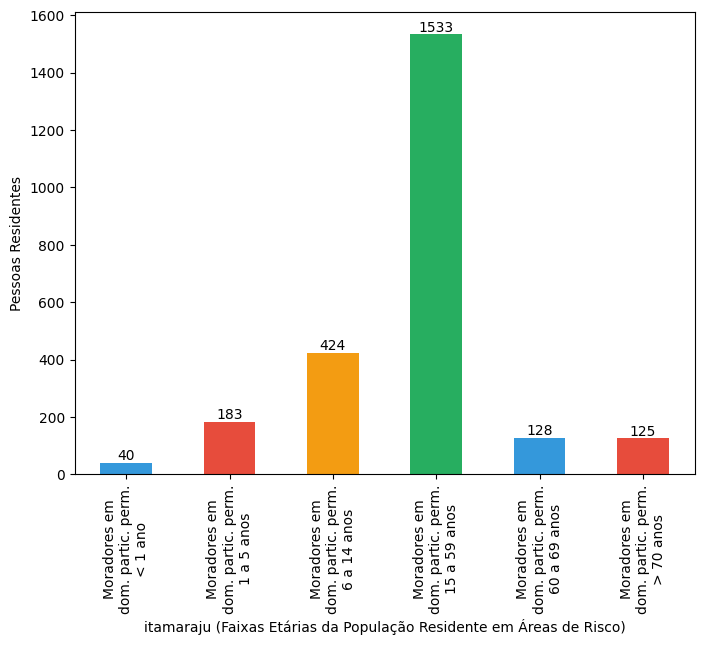

...

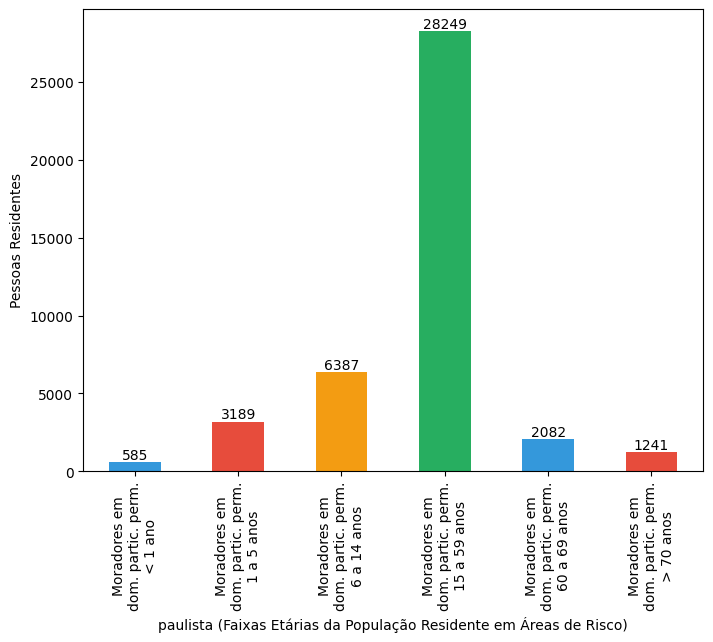

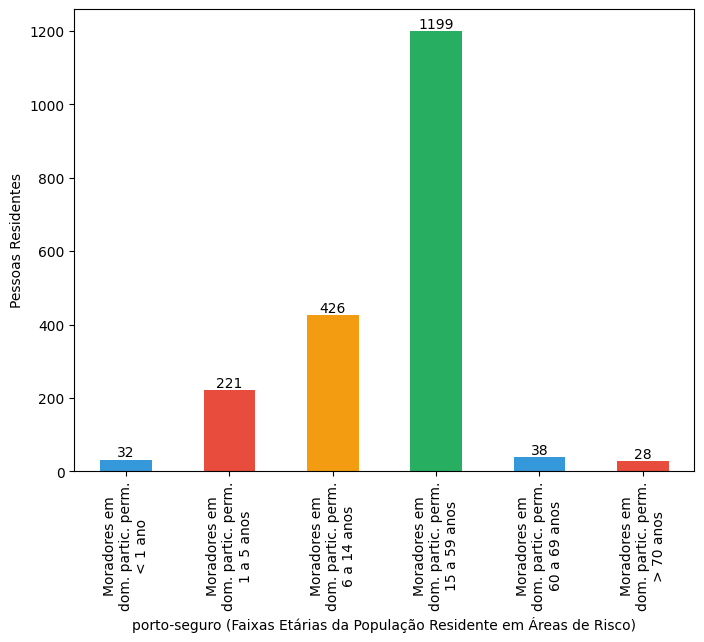

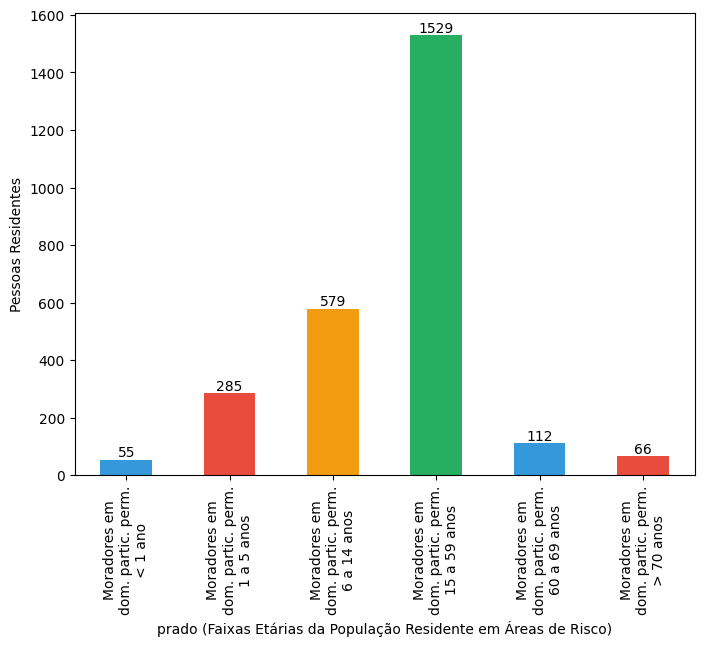

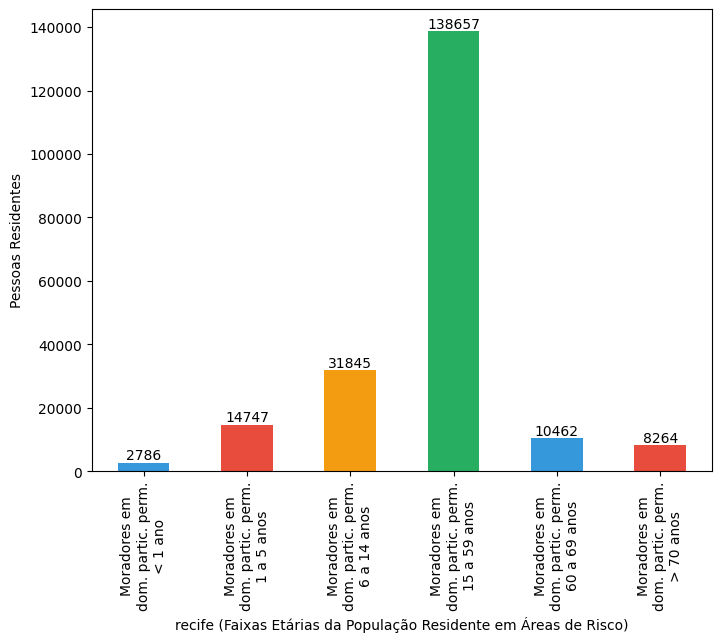

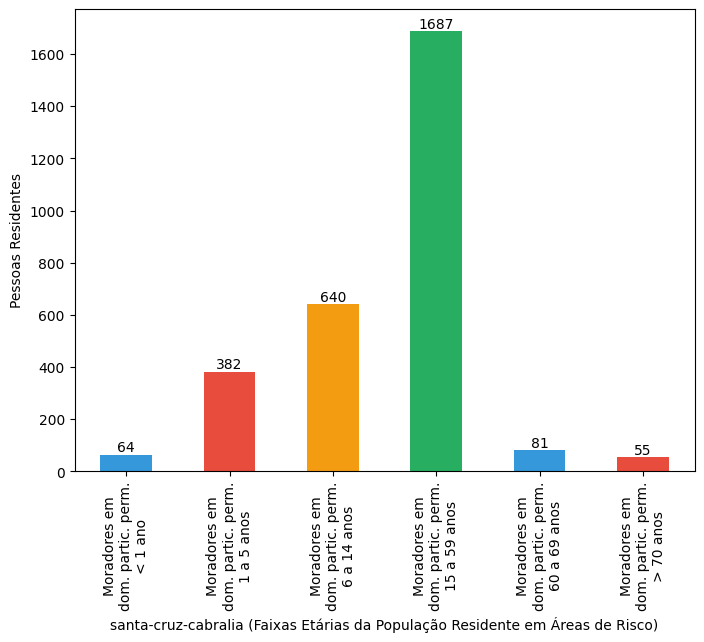

In [335]:
# Gráfico 'D005', 'D006', 'D007', 'D008', 'D009', 'D010'

df = DF_Areas_Risco_Domic_Pessoas.copy()

var1 = 'D005'
var2 = 'D006'
var3 = 'D007'
var4 = 'D008'
var5 = 'D009'
var6 = 'D010'
cols = [var1, var2, var3, var4, var5, var6]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, var4, var5, var6]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
df = df.sort_values(var2, ascending = False)

# Armazena novos nomes de variáveis
nvar1 = 'Moradores em\ndom. partic. perm.\n< 1 ano'
nvar2 = 'Moradores em\ndom. partic. perm.\n1 a 5 anos'
nvar3 = 'Moradores em\ndom. partic. perm.\n6 a 14 anos'
nvar4 = 'Moradores em\ndom. partic. perm.\n15 a 59 anos'
nvar5 = 'Moradores em\ndom. partic. perm.\n60 a 69 anos'
nvar6 = 'Moradores em\ndom. partic. perm.\n> 70 anos'

df.rename({
var1: nvar1,
var2: nvar2,
var3: nvar3,
var4: nvar4,
var5: nvar5,
var6: nvar6
}, axis = 1, inplace = True)
cols = [nvar1, nvar2, nvar3, nvar4, nvar5, nvar6]

# Define set_munic como apenas os nomes de municpios que constam em 'nome_municipio' no df reduzido
set_munic = set(df['nome_municipio'].tolist())

# Agregando df por município e somando os valores das variáveis trabalhadas com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum().reset_index()

# Define valores das cores das barras para o gráfico
c = '#3498db'
m = '#e74c3c'
y = '#f39c12'
g = '#27ae60'
p = '#9b59b6'

# Loop produz gráficos para cada município no DF
for munic in df['nome_municipio']:
        dfx = df[df['nome_municipio'] == munic]

        # Define colors for the bars
        colors = [c, m, y, g] #* 4

        # Plot the bar graph
        ax = dfx.iloc[0,1:].plot(kind='bar', color=colors, figsize=(8, 6))

        # Set the x and y axis labels
        ax.set_xlabel(f'{munic} (Faixas Etárias da População Residente em Áreas de Risco)')
        ax.set_ylabel('Pessoas Residentes')

        for i, val in enumerate(dfx.iloc[0,1:]):
                plt.text(i, val, str(val), ha='center', va='bottom', fontweight='light')

        # Save plot to save_path
        plt.savefig(f'{save_path}\\Bar_Estrutura Etária da Pop em Áreas de Risco_{munic}', dpi = 300, bbox_inches='tight' )

        # Show the plot
        plt.show() 



Gráfico Comparado Domicílios com acesso à infraestrutura em Áreas de Risco (O.K.)

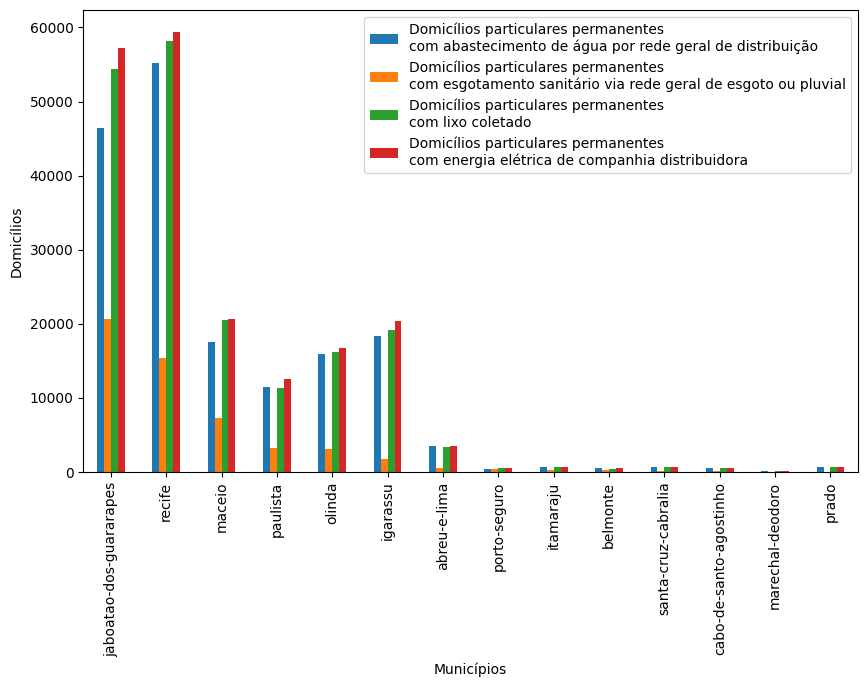

In [336]:
#Gráfico:
# 'D025' Domicílios particulares permanentes com abastecimento de água por rede geral de distribuição 
# 'D033' Domicílios particulares permanentes com esgotamento sanitário via rede geral de esgoto ou pluvia
# 'D040' Domicílios particulares permanente com lixo coletado
# 'D048' Domicílios particulares permanente com energia elétrica de companhia distribuidora

df = DF_Areas_Risco_Domic_Pessoas.copy()

var1 = 'D025'
var2 = 'D033'
var3 = 'D040'
var5 = 'D048'
cols = [var1, var2, var3, var5]

# Resume df necessário
df = df[['nome_UF', 'nome_municipio', var1, var2, var3, var5]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
# df = df.sort_values(var1, ascending = False)

# Armazena novos nomes de variáveis
nvar1 = 'Domicílios particulares permanentes\ncom abastecimento de água por rede geral de distribuição'
nvar2 = 'Domicílios particulares permanentes\ncom esgotamento sanitário via rede geral de esgoto ou pluvial'
nvar3 = 'Domicílios particulares permanentes\ncom lixo coletado'
nvar5 = 'Domicílios particulares permanentes\ncom energia elétrica de companhia distribuidora'

# Renomeia variáveis no df
df.rename({
var1: nvar1,
var2: nvar2,
var3: nvar3,
var5: nvar5
}, axis = 1, inplace = True)
cols = [nvar1, nvar2, nvar3, nvar5]

# Agregando df por município e somando os valores das variáveis trabalhadas com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum()
df = df.sort_values(nvar2, ascending = False)
df

df.plot(
        # x = 'nome_municipio',
        y = cols,
        kind = 'bar',
        legend = True
        )
plt.xlabel('Municípios')
plt.ylabel('Domicílios')

save_graph('Bar_Domicílios com acesso à infraestrutura em AR', 'Municipios')


Gráfico Municipal Domicílios com acesso à infraestrutura em Áreas de Risco (O.K.)

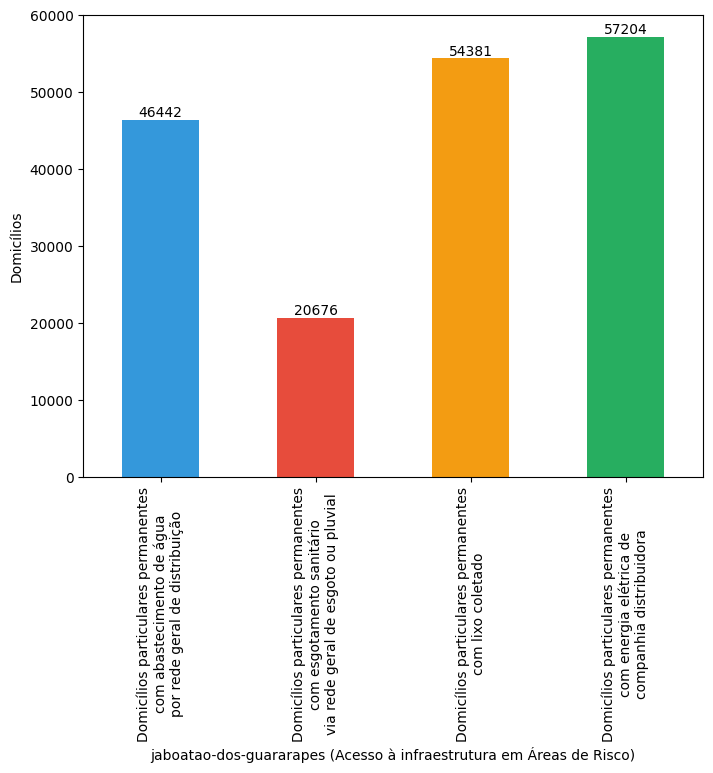

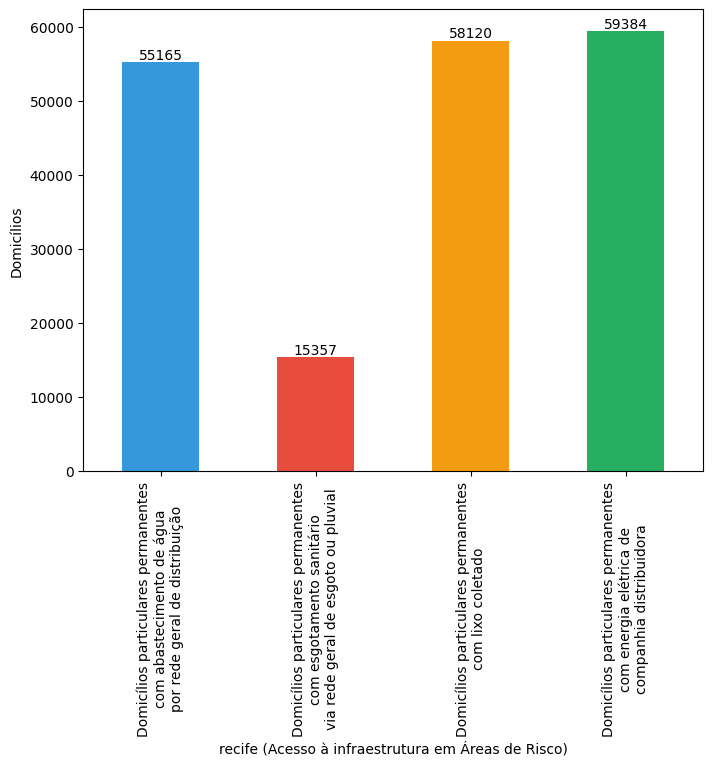

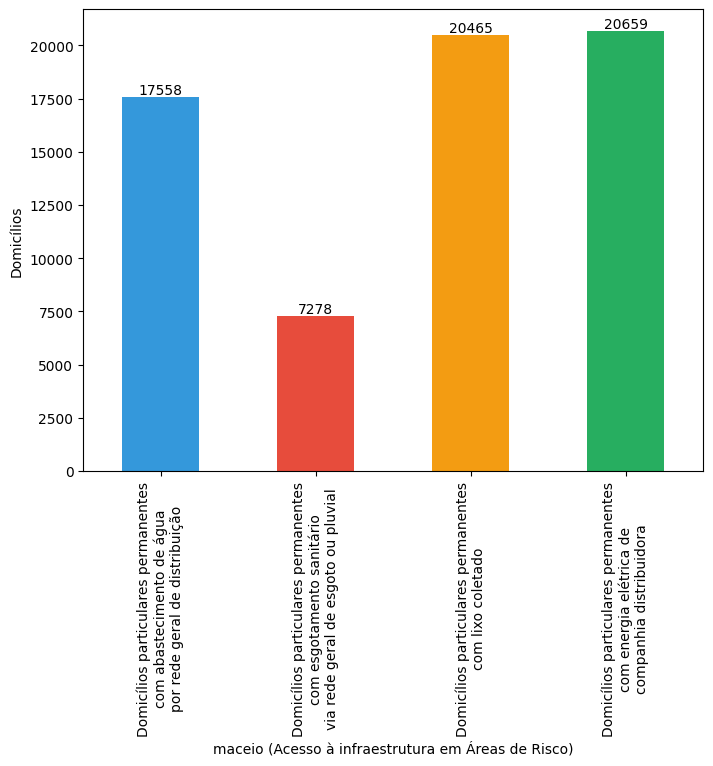

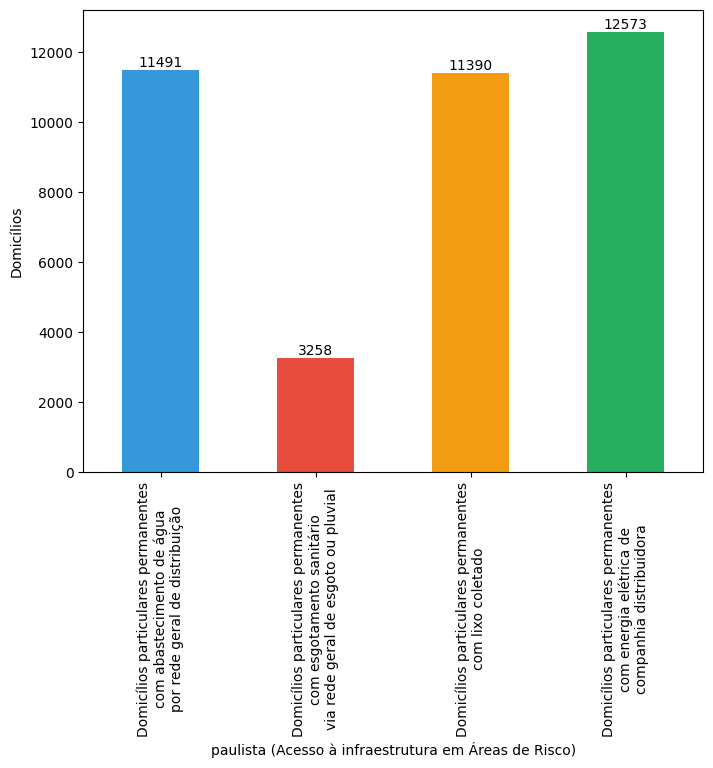

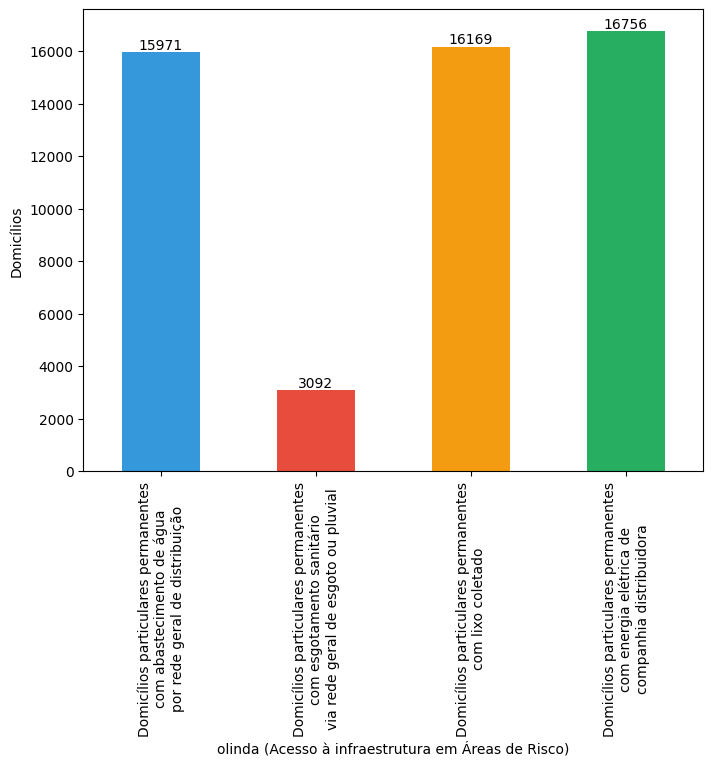

...

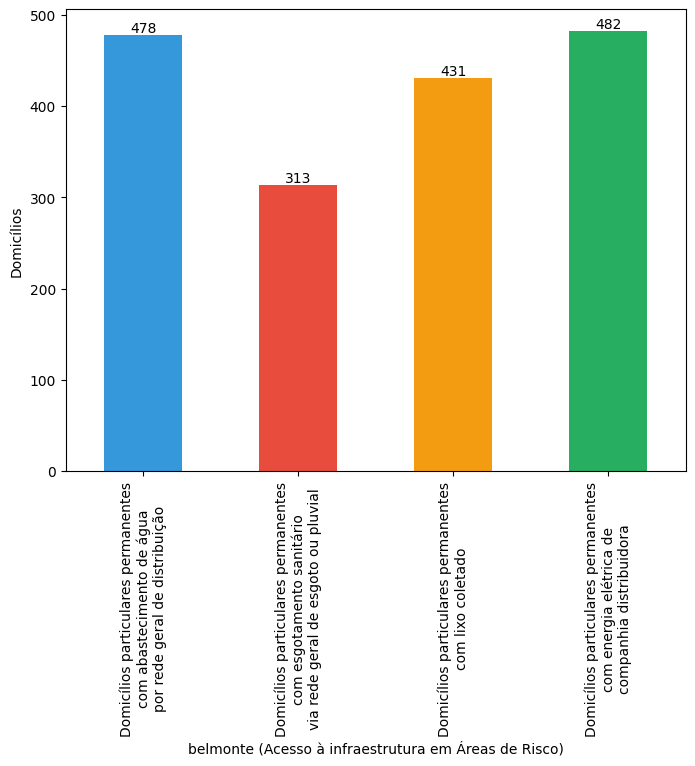

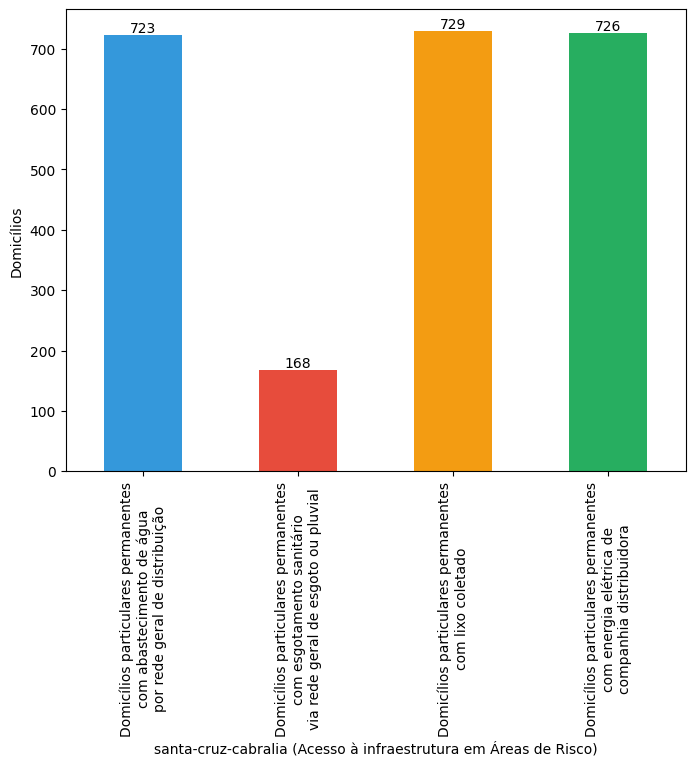

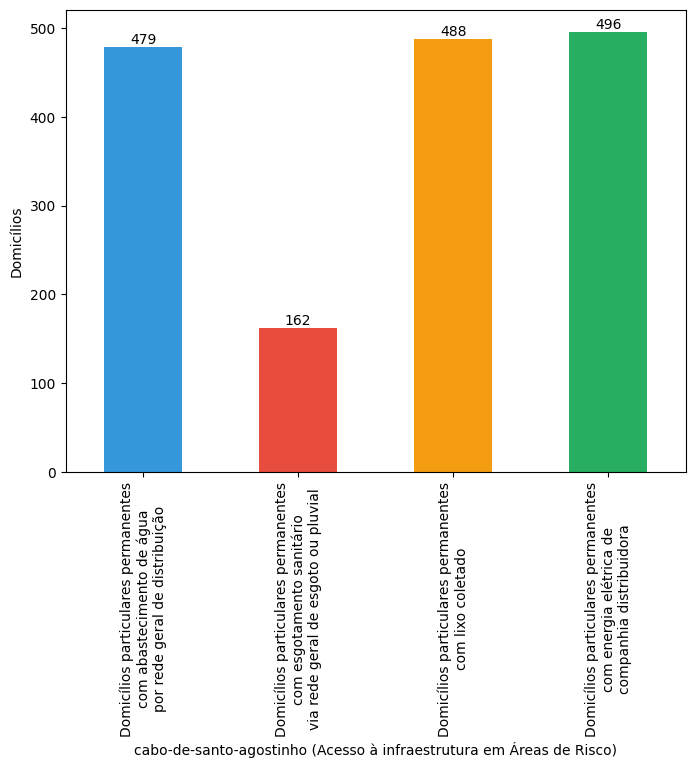

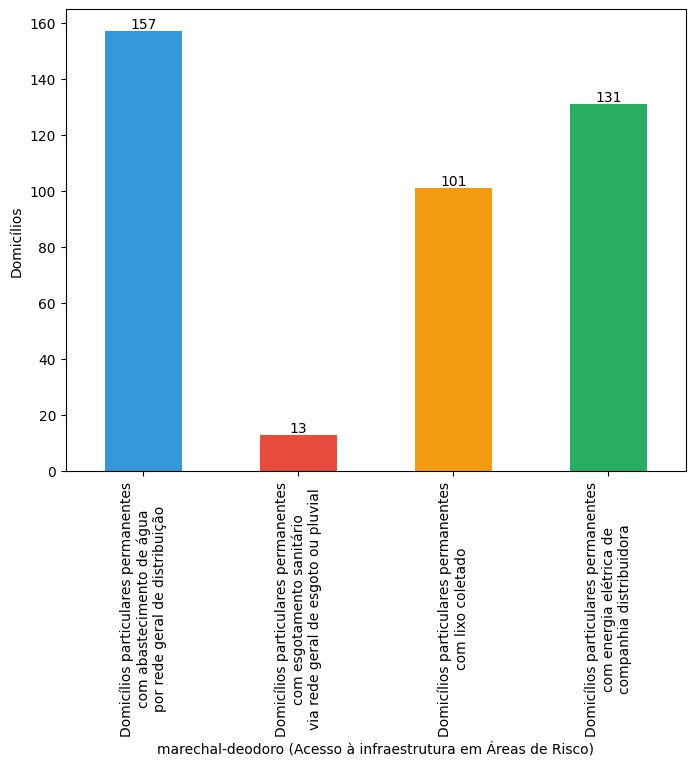

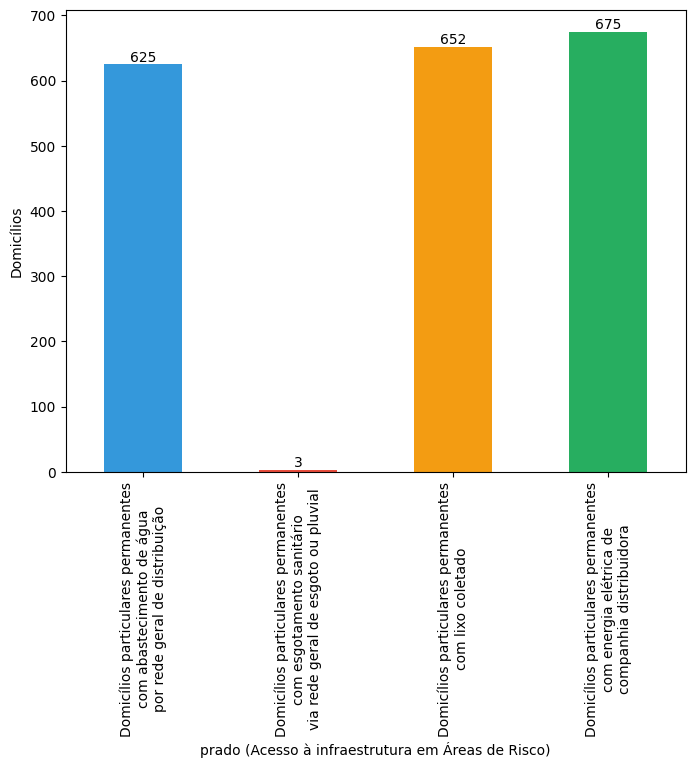

In [337]:
#Gráfico:
# 'D025' Domicílios particulares permanentes com abastecimento de água por rede geral de distribuição 
# 'D033' Domicílios particulares permanentes com esgotamento sanitário via rede geral de esgoto ou pluvia
# 'D040' Domicílios particulares permanente com lixo coletado
# 'D048' Domicílios particulares permanente com energia elétrica de companhia distribuidora

df = DF_Areas_Risco_Domic_Pessoas.copy()

var1 = 'D025'
var2 = 'D033'
var3 = 'D040'
var5 = 'D048'
cols = [var1, var2, var3, var5]

# Resume df necessário
df = df[['nome_UF', 'nome_municipio', var1, var2, var3, var5]]
df = df[df['nome_municipio'].isin(Municipios)]

# Define set_munic como apenas os nomes de municpios que constam em 'nome_municipio' no df reduzido
set_munic = set(df['nome_municipio'].tolist())

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
# df = df.sort_values(var1, ascending = False)

# Armazena novos nomes de variáveis
nvar1 = 'Domicílios particulares permanentes\ncom abastecimento de água\npor rede geral de distribuição'
nvar2 = 'Domicílios particulares permanentes\ncom esgotamento sanitário\nvia rede geral de esgoto ou pluvial'
nvar3 = 'Domicílios particulares permanentes\ncom lixo coletado'
nvar5 = 'Domicílios particulares permanentes\ncom energia elétrica de\ncompanhia distribuidora'

# Renomeia variáveis no df
df.rename({
var1: nvar1,
var2: nvar2,
var3: nvar3,
var5: nvar5
}, axis = 1, inplace = True)
cols = [nvar1, nvar2, nvar3, nvar5]

# Agregando df por município e somando os valores das variáveis trabalhadas com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum().reset_index()
df = df.sort_values(nvar2, ascending = False)

# Define valores das cores das barras para o gráfico
c = '#3498db'
m = '#e74c3c'
y = '#f39c12'
g = '#27ae60'
p = '#9b59b6'
  
# Loop produz gráficos para cada município no DF
for munic in df['nome_municipio']:
        dfx = df[df['nome_municipio'] == munic]

        # Define colors for the bars
        colors = [c, m, y, g] #* 4

        # Plot the bar graph
        ax = dfx.iloc[0,1:].plot(kind='bar', color=colors, figsize=(8, 6))

        # Set the x and y axis labels
        ax.set_xlabel(f'{munic} (Acesso à infraestrutura em Áreas de Risco)')
        ax.set_ylabel('Domicílios')

        for i, val in enumerate(dfx.iloc[0,1:]):
                plt.text(i, val, str(val), ha='center', va='bottom', fontweight='light')

        # Save plot to save_path
        plt.savefig(f'{save_path}\\Bar_Acesso à infraestrutura em Áreas de Risco_{munic}', dpi = 300, bbox_inches='tight' )

        # Show the plot
        plt.show() 

Gráfico Municipal Domicílios sem acesso à infraestrutura em Áreas de Risco (O.K.)

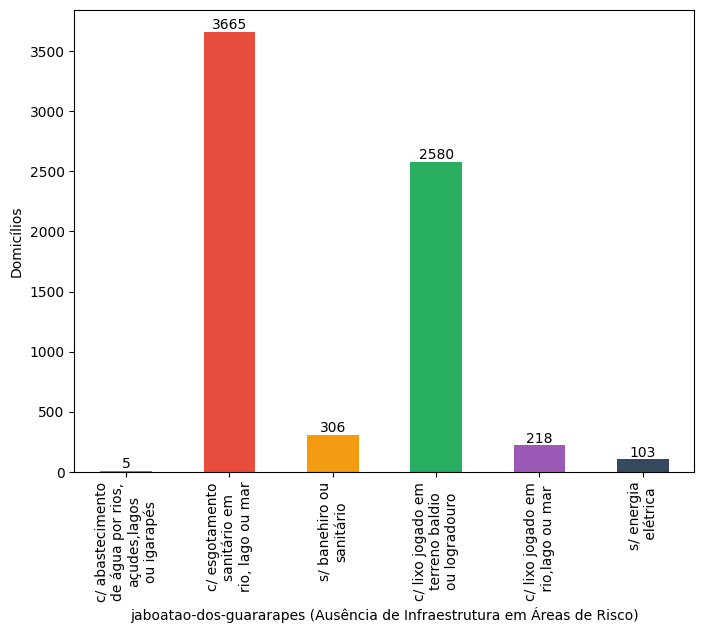

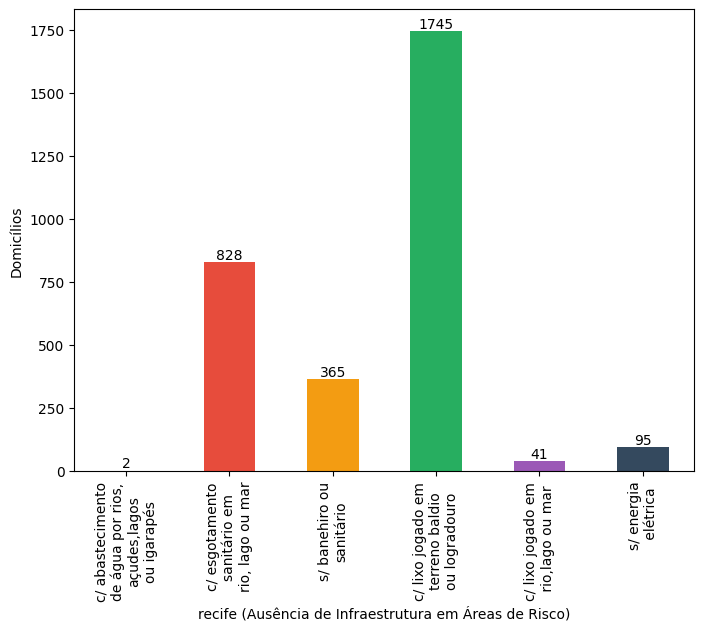

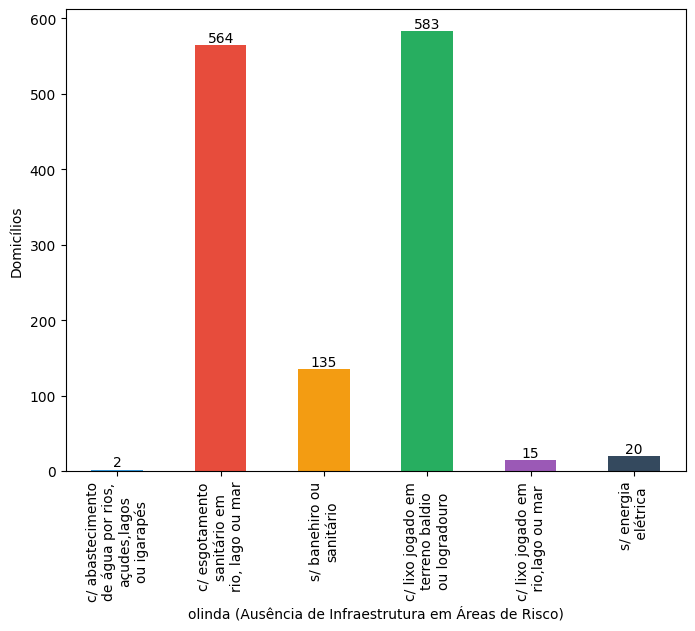

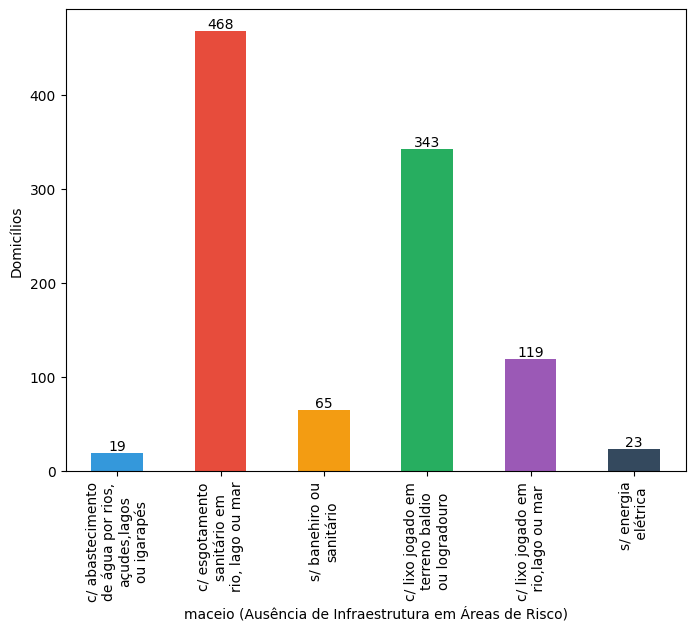

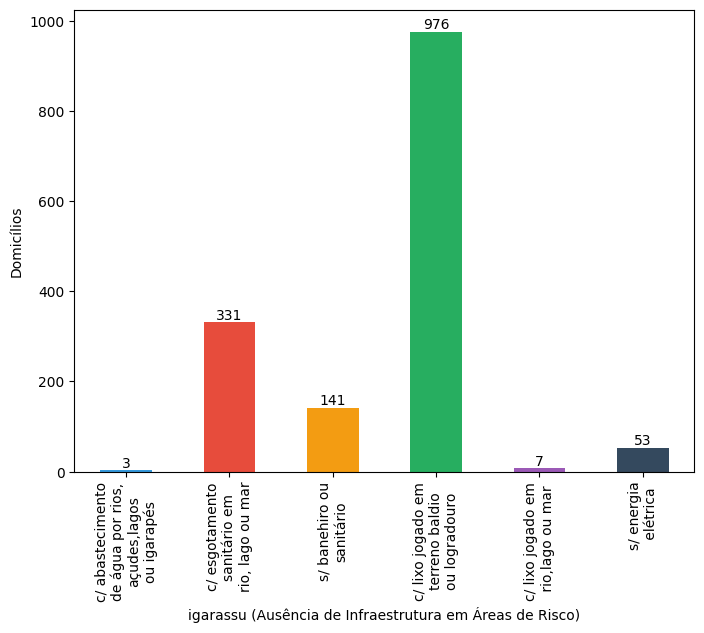

...

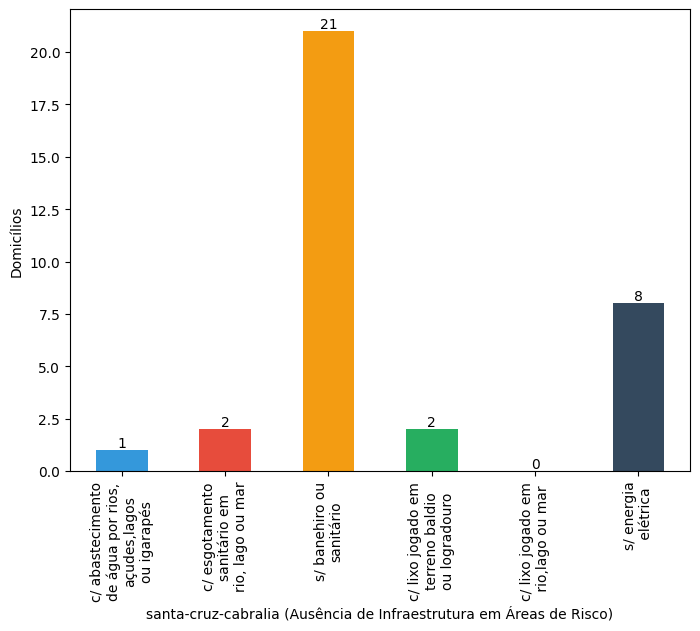

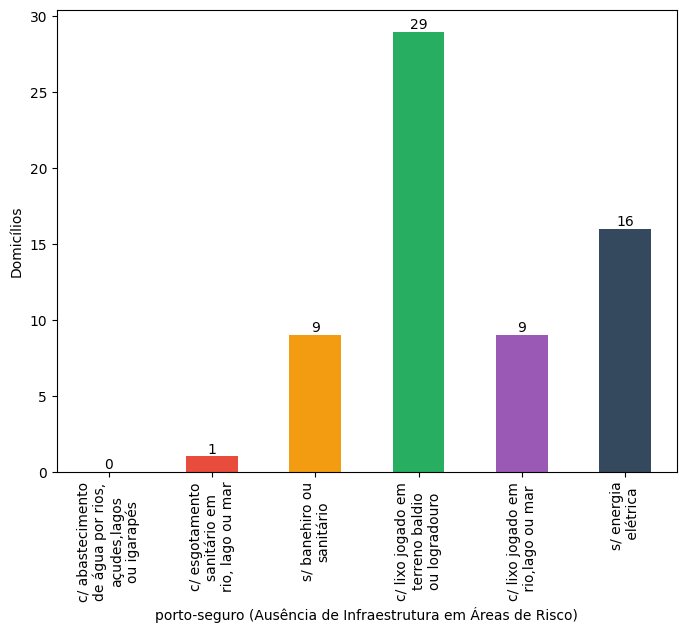

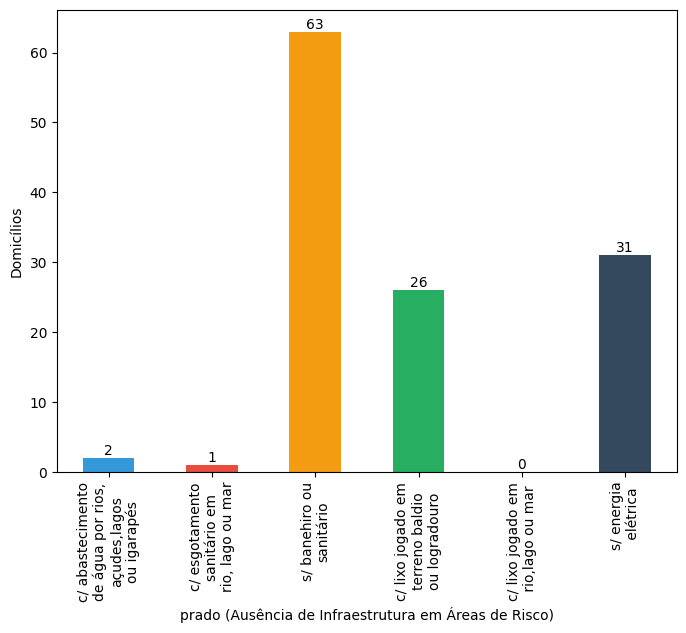

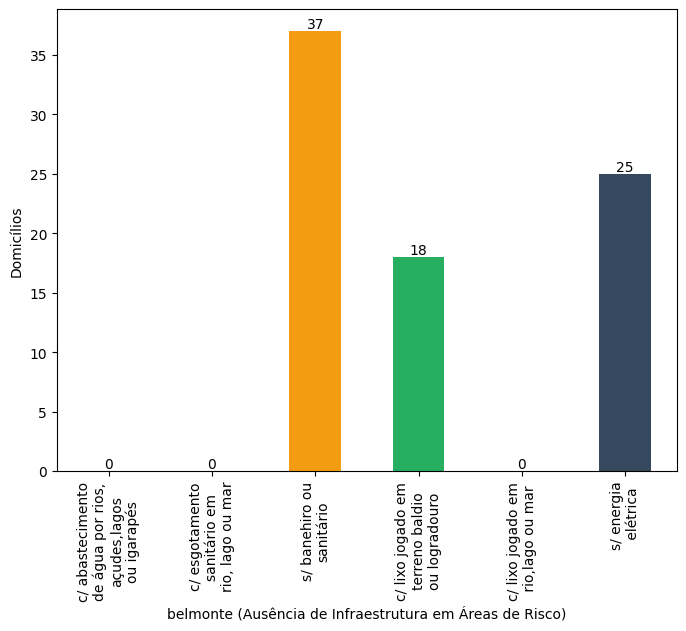

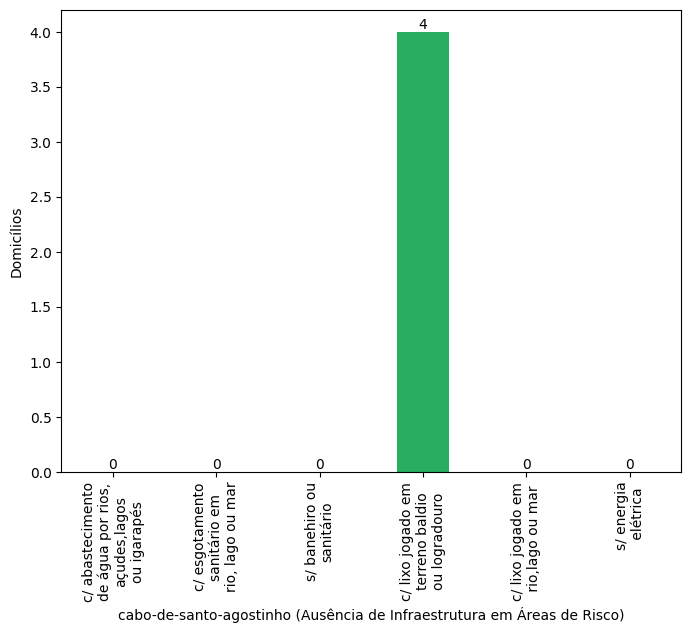

In [338]:
#Gráfico:
# 'D031' Domicílios particulares permanentes com abastecimento de água por rios, açudes, lagos ou igarapés
# 'D037' Domicílios particulares permanentes com esgotamento sanitário via em rio, lago ou mar
# 'D039' Domicílios particulares permanentes que não tinham banehiro ou sanitário
# 'D045' Domicílios particulares permanente com lixo jogado em terreno baldio ou logradouro
# 'D046' Domicílios particulares permanente com lixo jogado em rio, lago ou mar
# 'D053' Domicílios particulares permanentes sem energia elétrica

df = DF_Areas_Risco_Domic_Pessoas.copy()

var1 = 'D031'
var2 = 'D037'
var3 = 'D039'
var4 = 'D045'
var5 = 'D046'
var6 = 'D053'
cols = [var1, var2, var3, var4, var5, var6]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, var4, var5, var6]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
# df = df.sort_values(var1, ascending = False)

# Armazena novos nomes de variáveis
nvar1 = 'c/ abastecimento\nde água por rios,\naçudes,lagos\nou igarapés'
nvar2 = 'c/ esgotamento\nsanitário em\nrio, lago ou mar'
nvar3 = 's/ banehiro ou\nsanitário'
nvar4 = 'c/ lixo jogado em\nterreno baldio\nou logradouro'
nvar5 = 'c/ lixo jogado em\n rio,lago ou mar'
nvar6 = 's/ energia\n elétrica'

# Renomeia variáveis no df
df.rename({
var1: nvar1,
var2: nvar2,
var3: nvar3,
var4: nvar4,
var5: nvar5,
var6: nvar6
}, axis = 1, inplace = True)
cols = [nvar1, nvar2, nvar3, nvar4, nvar5,  nvar6]

# Agregando df por município e somando os valores das variáveis trabalhadas com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum().reset_index()
df = df.sort_values(nvar2, ascending = False)

# Define valores das cores das barras para o gráfico
c = '#3498db'
m = '#e74c3c'
y = '#f39c12'
g = '#27ae60'
p = '#9b59b6'
a = '#34495e'
  
# Loop produz gráficos para cada município no DF
for munic in df['nome_municipio']:
        dfx = df[df['nome_municipio'] == munic]

        # Define colors for the bars
        colors = [c, m, y, g, p, a] #* 4

        # Plot the bar graph
        ax = dfx.iloc[0,1:].plot(kind='bar', color=colors, figsize=(8, 6))

        # Set the x and y axis labels
        ax.set_xlabel(f'{munic} (Ausência de Infraestrutura em Áreas de Risco)')
        ax.set_ylabel('Domicílios')

        for i, val in enumerate(dfx.iloc[0,1:]):
                plt.text(i, val, str(val), ha='center', va='bottom', fontweight='light')

        # Save plot to save_path
        plt.savefig(f'{save_path}\\Bar_Domicilios sem Infraestrutura em Áreas de Risco_{munic}', dpi = 300, bbox_inches='tight' )

        # Show the plot
        plt.show() 

Gráfico Comparado Pessoas com acesso à infraestrutura em Áreas de Risco (O.K.)

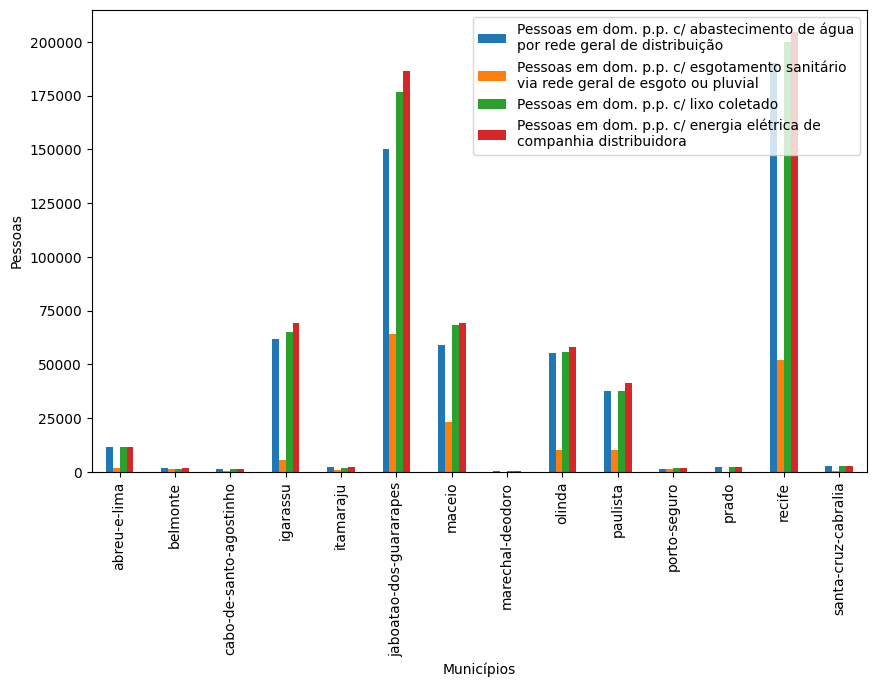

In [339]:
#Gráfico:
# 'M025' Moradores em Domicílios particulares permanentes com abastecimento de água por rede geral de distribuição 
# 'M033' Moradores em Domicílios particulares permanentes com esgotamento sanitário via rede geral de esgoto ou pluvia
# 'M040' Moradores em Domicílios particulares permanente com lixo coletado
# 'M048' Moradores em Domicílios particulares permanente com energia elétrica de companhia distribuidora

df = DF_Areas_Risco_Domic_Pessoas.copy()

var1 = 'M025'
var2 = 'M033'
var3 = 'M040'
var5 = 'M048'
cols = [var1, var2, var3, var5]

# Resume df necessário
df = df[['nome_UF', 'nome_municipio', var1, var2, var3, var5]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
# df = df.sort_values(var1, ascending = False)

# Armazena novos nomes de variáveis
nvar1 = 'Pessoas em dom. p.p. c/ abastecimento de água\npor rede geral de distribuição'
nvar2 = 'Pessoas em dom. p.p. c/ esgotamento sanitário\nvia rede geral de esgoto ou pluvial'
nvar3 = 'Pessoas em dom. p.p. c/ lixo coletado'
nvar5 = 'Pessoas em dom. p.p. c/ energia elétrica de\ncompanhia distribuidora'

# Renomeia variáveis no df
df.rename({
var1: nvar1,
var2: nvar2,
var3: nvar3,
var5: nvar5
}, axis = 1, inplace = True)
cols = [nvar1, nvar2, nvar3, nvar5]

# Agregando df por município e somando os valores das variáveis trabalhadas com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum()
# df = df.sort_values(nvar2, ascending = False)
df

df.plot(
        # x = 'nome_municipio',
        y = cols,
        kind = 'bar',
        legend = True
        )
plt.xlabel('Municípios')
plt.ylabel('Pessoas')

save_graph('Bar_Pessoas com acesso à infraestrutura em AR', 'Municipios')

Gráfico Municipal Pessoas com acesso à infraestrutura em Áreas de Risco (O.K.)

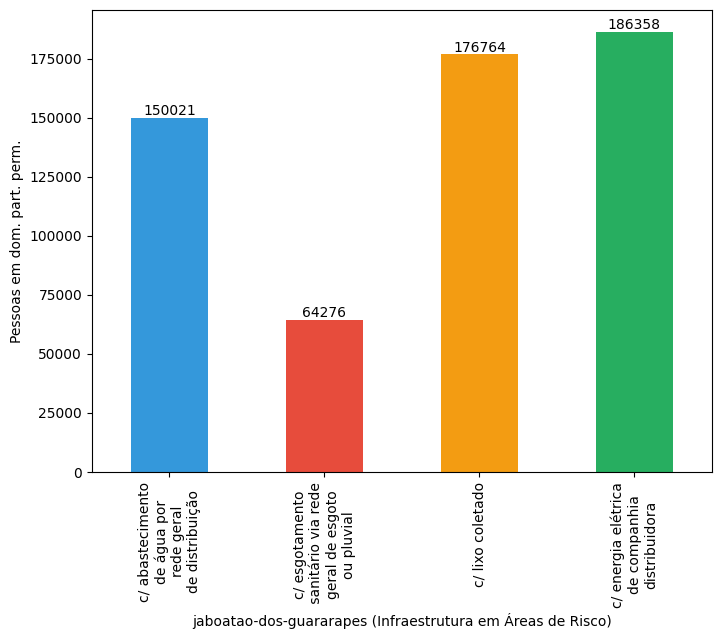

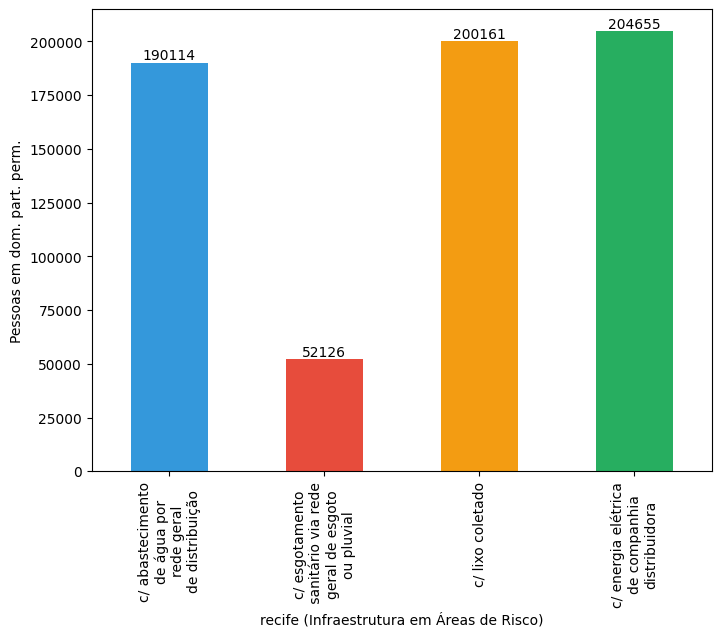

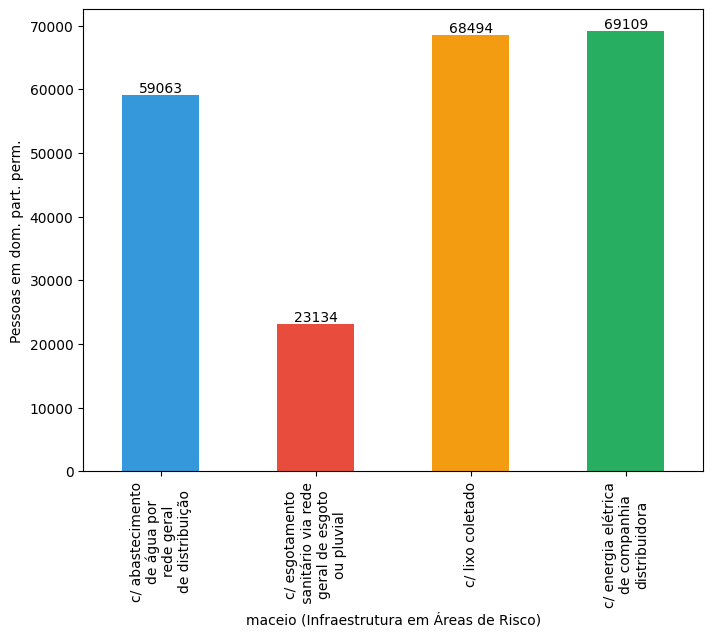

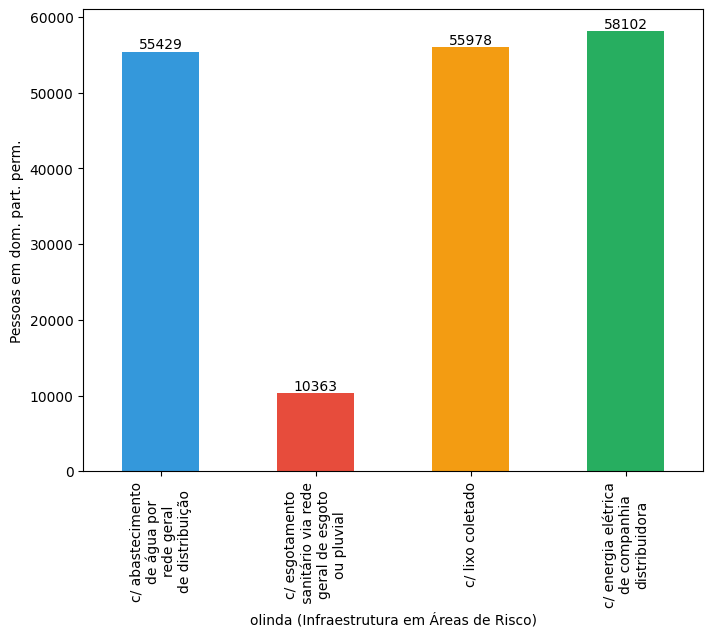

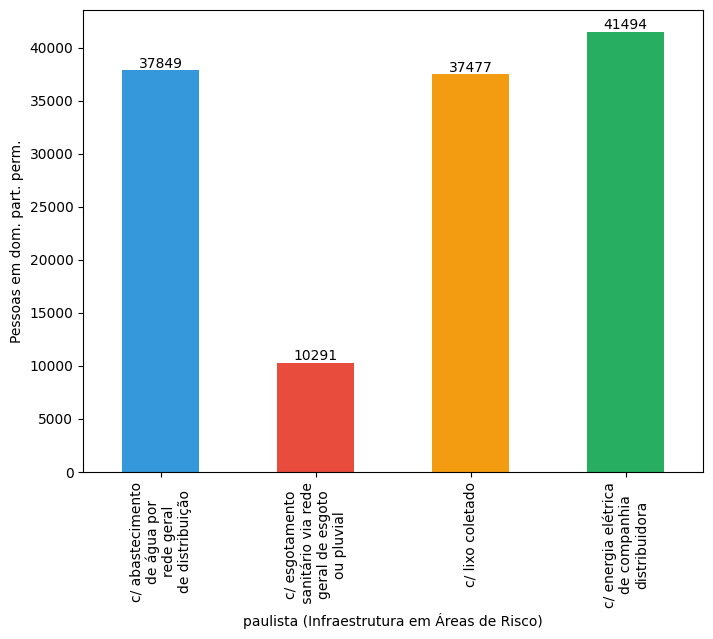

...

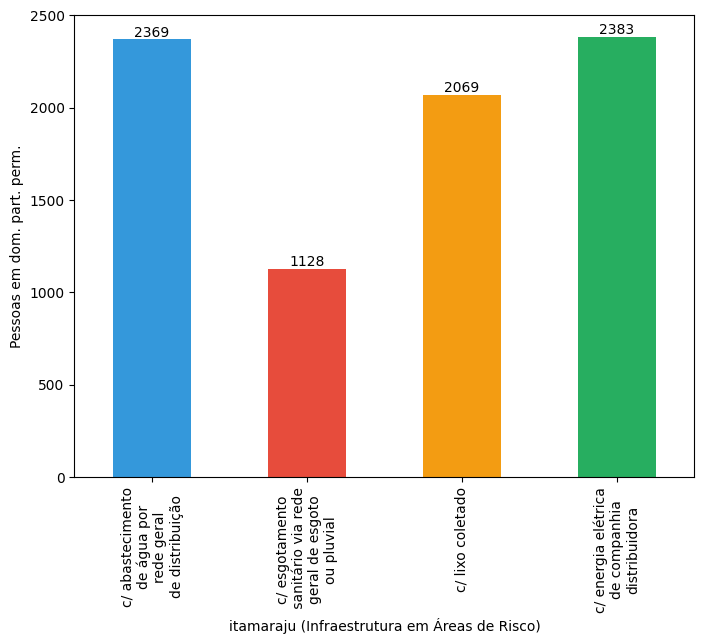

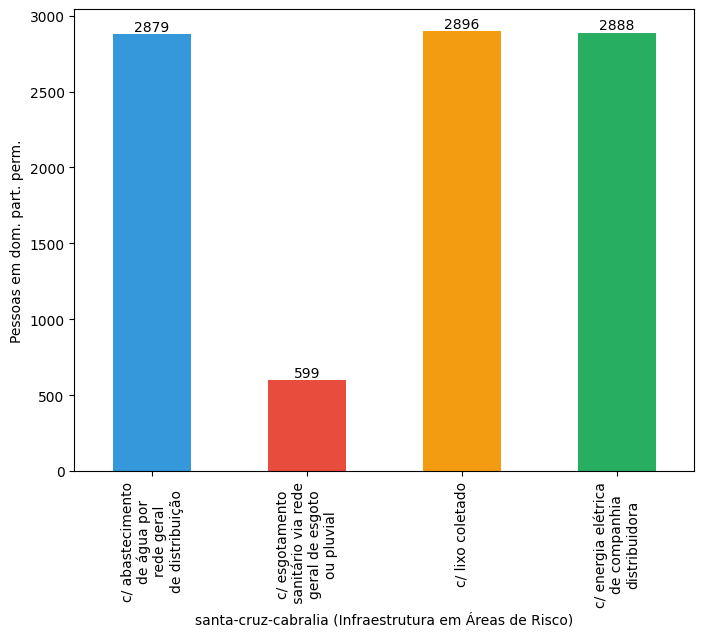

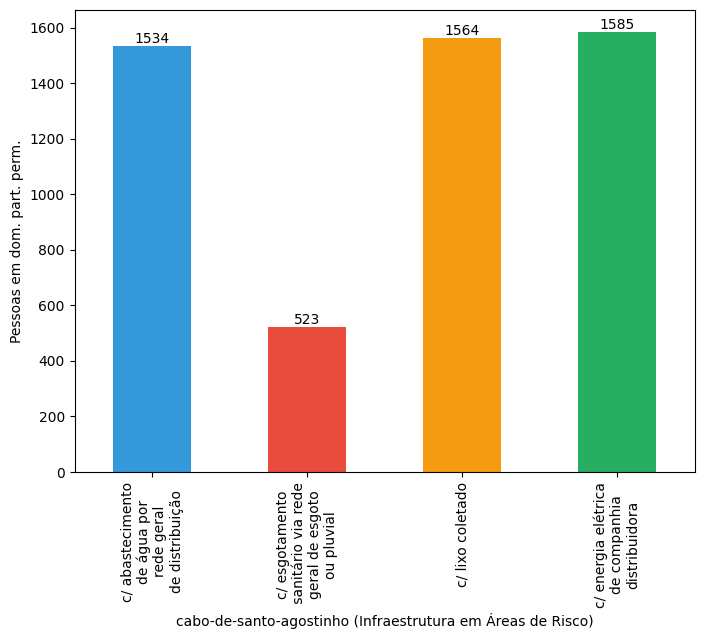

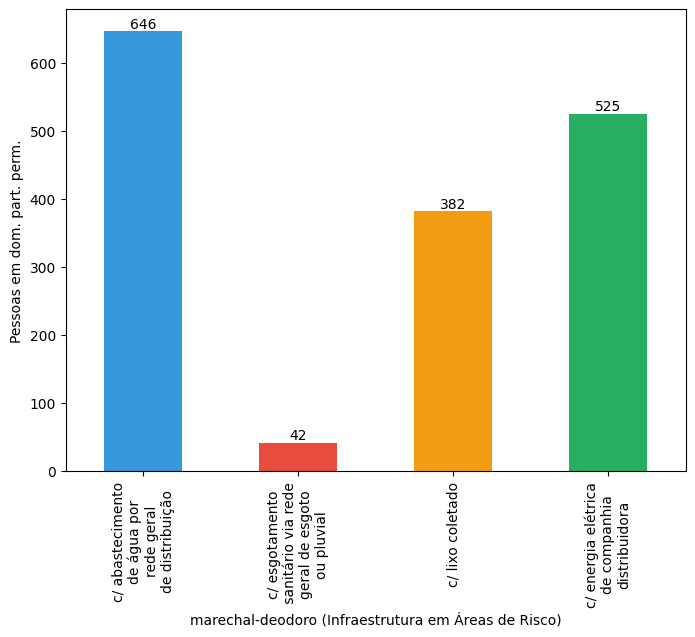

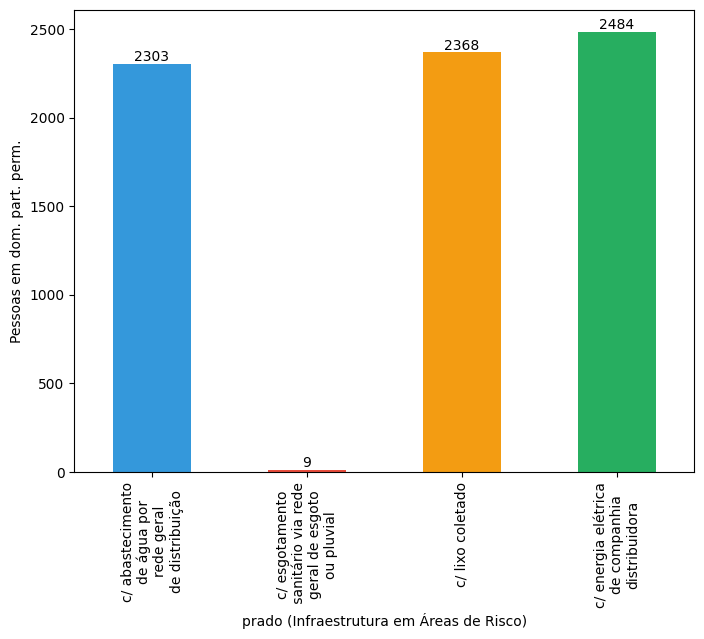

In [340]:
#Gráfico:
# 'M025' Moradores em Domicílios particulares permanentes com abastecimento de água por rede geral de distribuição 
# 'M033' Moradores em Domicílios particulares permanentes com esgotamento sanitário via rede geral de esgoto ou pluvia
# 'M040' Moradores em Domicílios particulares permanente com lixo coletado
# 'M048' Moradores em Domicílios particulares permanente com energia elétrica de companhia distribuidora

df = DF_Areas_Risco_Domic_Pessoas.copy()

var1 = 'M025'
var2 = 'M033'
var3 = 'M040'
var5 = 'M048'
cols = [var1, var2, var3, var5]

# Resume df necessário
df = df[['nome_UF', 'nome_municipio', var1, var2, var3, var5]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
# df = df.sort_values(var1, ascending = False)

# Armazena novos nomes de variáveis
nvar1 = 'c/ abastecimento\nde água por\nrede geral\nde distribuição'
nvar2 = 'c/ esgotamento\n sanitário via rede\ngeral de esgoto\nou pluvial'
nvar3 = 'c/ lixo coletado'
nvar5 = 'c/ energia elétrica\nde companhia\ndistribuidora'

# Renomeia variáveis no df
df.rename({
var1: nvar1,
var2: nvar2,
var3: nvar3,
var5: nvar5
}, axis = 1, inplace = True)
cols = [nvar1, nvar2, nvar3, nvar5]

# Agregando df por município e somando os valores das variáveis trabalhadas com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum().reset_index()
df = df.sort_values(nvar2, ascending = False)

# Define valores das cores das barras para o gráfico
c = '#3498db'
m = '#e74c3c'
y = '#f39c12'
g = '#27ae60'
p = '#9b59b6'
a = '#34495e'
  
# Loop produz gráficos para cada município no DF
for munic in df['nome_municipio']:
        dfx = df[df['nome_municipio'] == munic]

        # Define colors for the bars
        colors = [c, m, y, g, p, a] #* 4

        # Plot the bar graph
        ax = dfx.iloc[0,1:].plot(kind='bar', color=colors, figsize=(8, 6))

        # Set the x and y axis labels
        ax.set_xlabel(f'{munic} (Infraestrutura em Áreas de Risco)')
        ax.set_ylabel('Pessoas em dom. part. perm.')

        for i, val in enumerate(dfx.iloc[0,1:]):
                plt.text(i, val, str(val), ha='center', va='bottom', fontweight='light')

        # Save plot to save_path
        plt.savefig(f'{save_path}\\Bar_Pessoas em Domicilios com Acesso à Infraestrutura em Áreas de Risco_{munic}', dpi = 300, bbox_inches='tight' )

        # Show the plot
        plt.show() 

Gráfico Municipal Pessoas sem acesso à infraestrutura em Áreas de Risco (O.K)

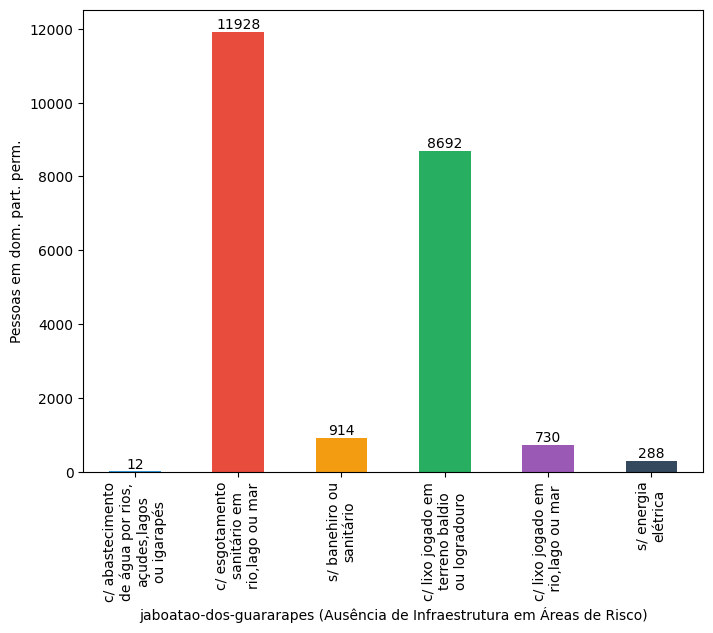

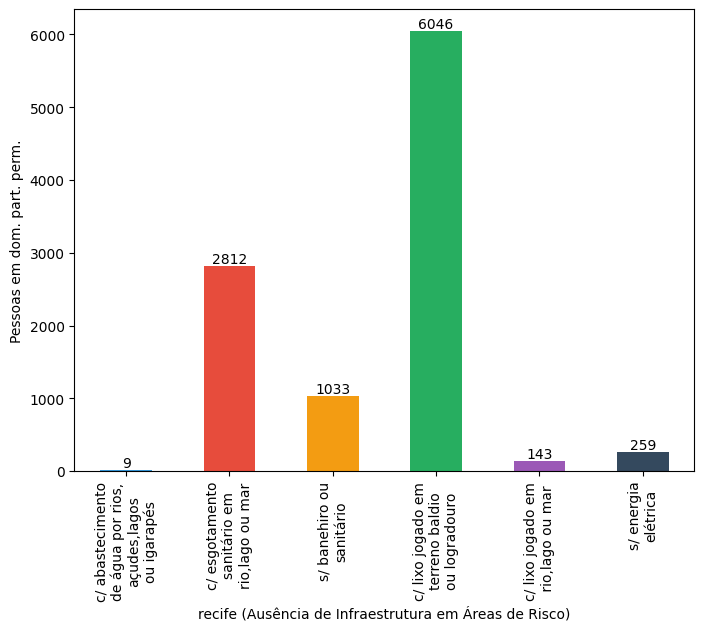

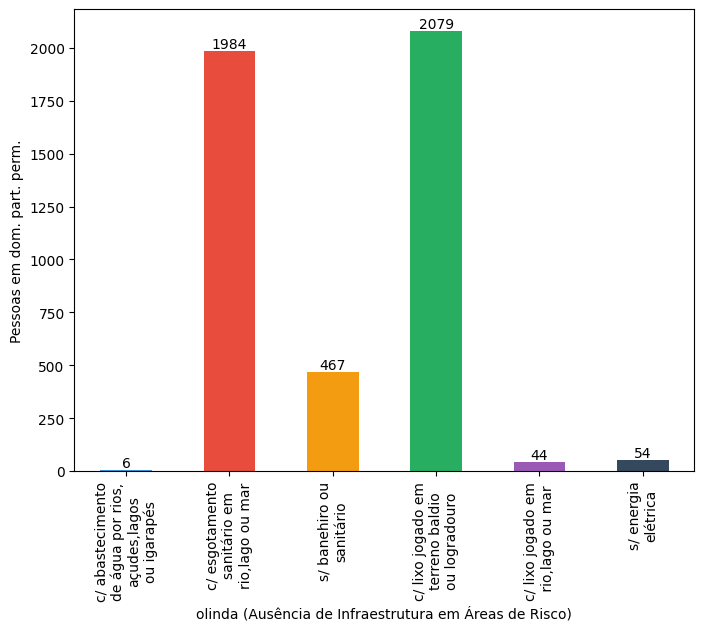

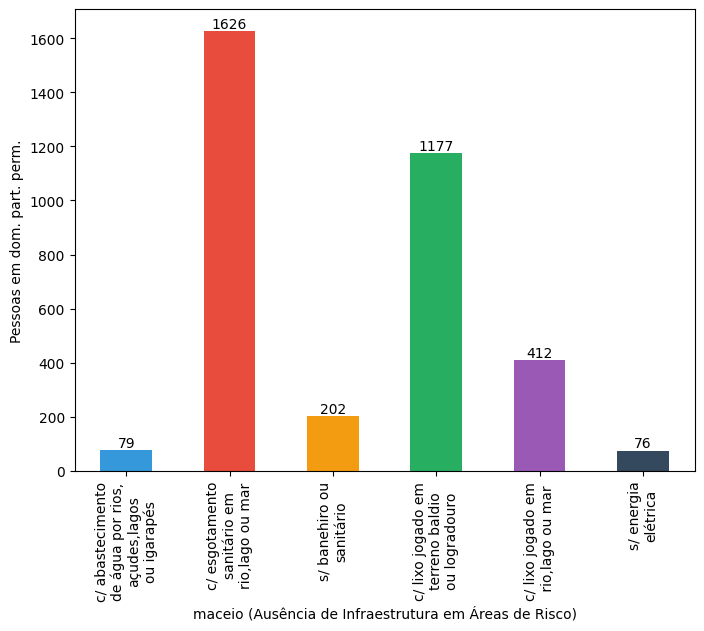

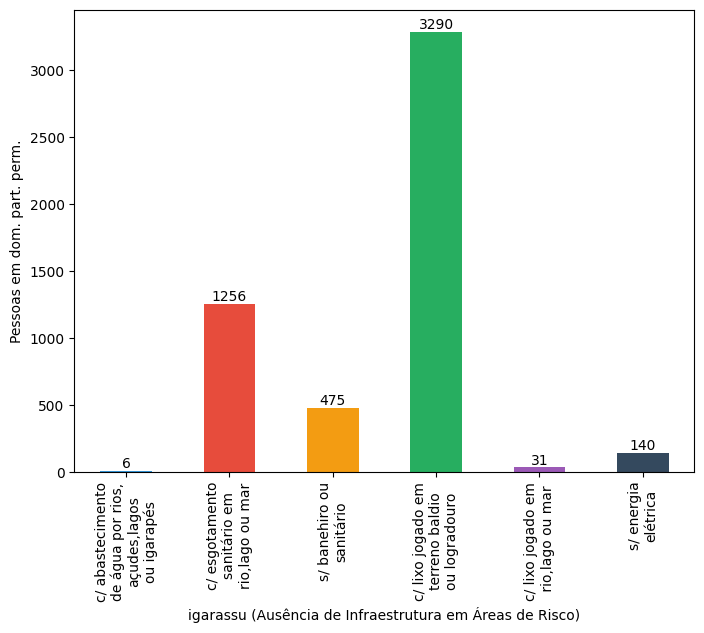

...

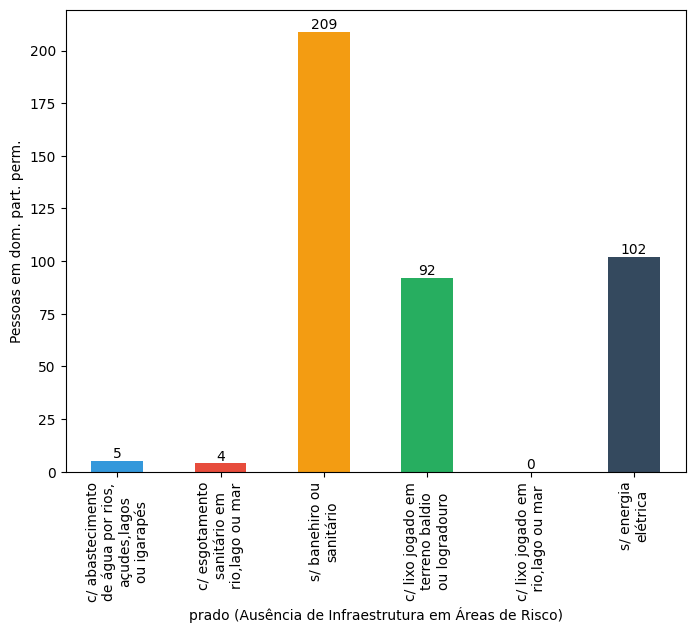

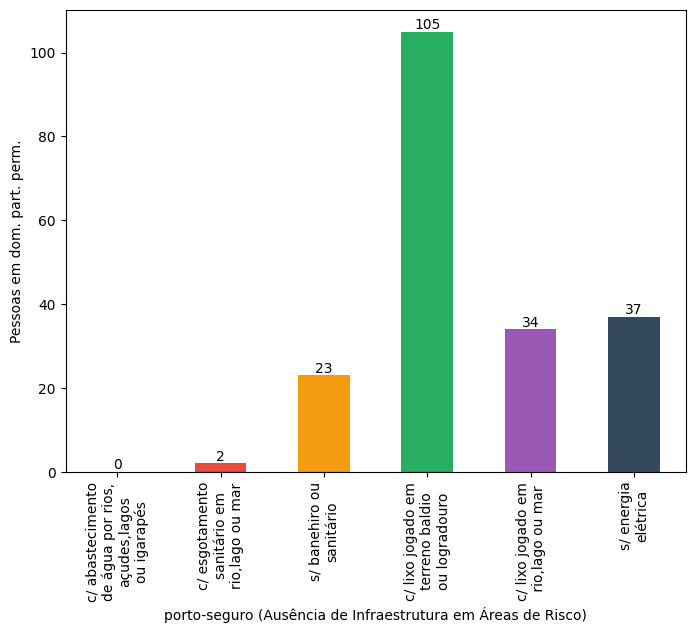

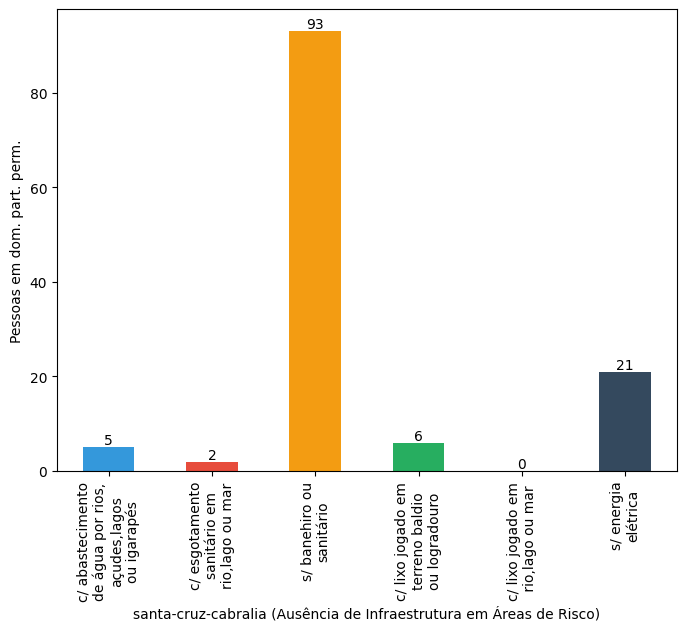

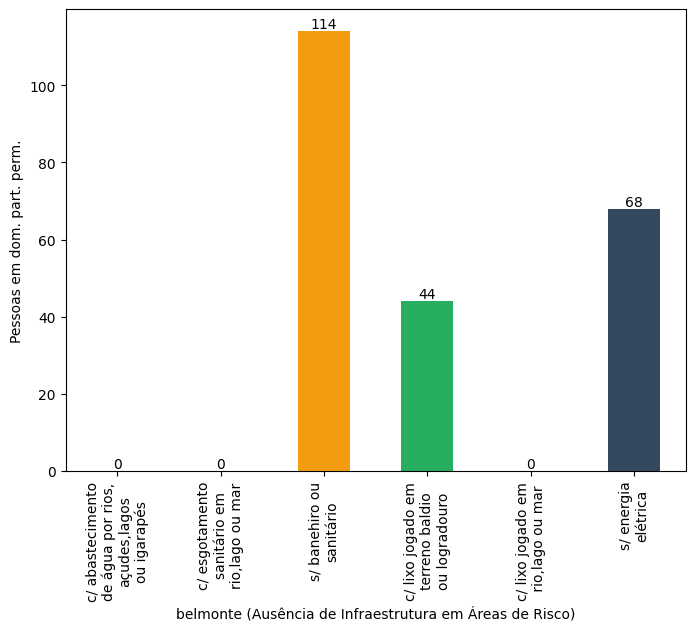

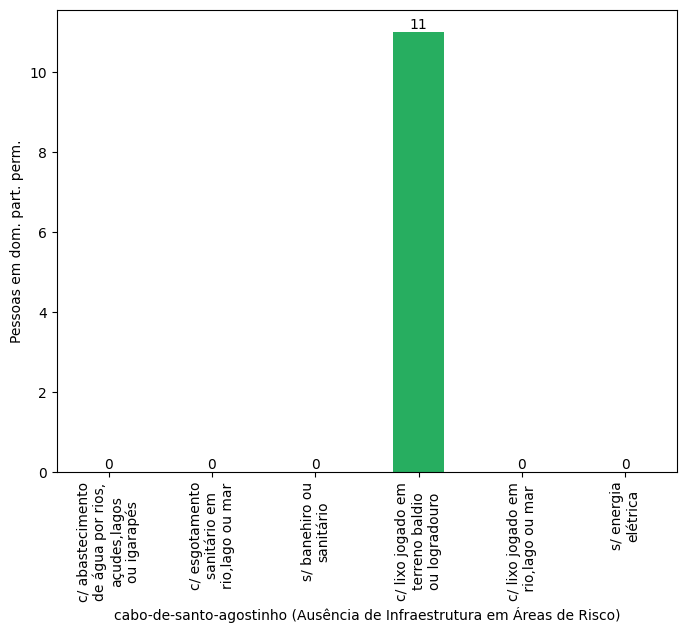

In [341]:
#Gráfico:
# 'M031' Domicílios particulares permanentes com abastecimento de água por rios, açudes, lagos ou igarapés
# 'M037' Domicílios particulares permanentes com esgotamento sanitário via em rio, lago ou mar
# 'M039' Domicílios particulares permanentes que não tinham banehiro ou sanitário
# 'M045' Domicílios particulares permanente com lixo jogado em terreno baldio ou logradouro
# 'M046' Domicílios particulares permanente com lixo jogado em rio, lago ou mar
# 'M053' Domicílios particulares permanentes sem energia elétrica

df = DF_Areas_Risco_Domic_Pessoas.copy()

var1 = 'M031'
var2 = 'M037'
var3 = 'M039'
var4 = 'M045'
var5 = 'M046'
var6 = 'M053'
cols = [var1, var2, var3, var4, var5, var6]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, var4, var5, var6]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
# df = df.sort_values(var1, ascending = False)

# Armazena novos nomes de variáveis
nvar1 = 'c/ abastecimento\nde água por rios,\naçudes,lagos\nou igarapés'
nvar2 = 'c/ esgotamento\nsanitário em\nrio,lago ou mar'
nvar3 = 's/ banehiro ou\nsanitário'
nvar4 = 'c/ lixo jogado em\nterreno baldio\nou logradouro'
nvar5 = 'c/ lixo jogado em\n rio,lago ou mar'
nvar6 = 's/ energia\nelétrica'

# Renomeia variáveis no df
df.rename({
var1: nvar1,
var2: nvar2,
var3: nvar3,
var4: nvar4,
var5: nvar5,
var6: nvar6
}, axis = 1, inplace = True)
cols = [nvar1, nvar2, nvar3, nvar4, nvar5,  nvar6]


# Agregando df por município e somando os valores das variáveis trabalhadas com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum().reset_index()
df = df.sort_values(nvar2, ascending = False)

# Define valores das cores das barras para o gráfico
c = '#3498db'
m = '#e74c3c'
y = '#f39c12'
g = '#27ae60'
p = '#9b59b6'
a = '#34495e'
  
# Loop produz gráficos para cada município no DF
for munic in df['nome_municipio']:
        dfx = df[df['nome_municipio'] == munic]

        # Define colors for the bars
        colors = [c, m, y, g, p, a] #* 4

        # Plot the bar graph
        ax = dfx.iloc[0,1:].plot(kind='bar', color=colors, figsize=(8, 6))

        # Set the x and y axis labels
        ax.set_xlabel(f'{munic} (Ausência de Infraestrutura em Áreas de Risco)')
        ax.set_ylabel('Pessoas em dom. part. perm.')

        for i, val in enumerate(dfx.iloc[0,1:]):
                plt.text(i, val, str(val), ha='center', va='bottom', fontweight='light')

        # Save plot to save_path
        plt.savefig(f'{save_path}\\Bar_Pessoas em Domicilios sem Acesso à Infraestrutura em Áreas de Risco_{munic}', dpi = 300, bbox_inches='tight' )

        # Show the plot
        plt.show() 

Gráfico Comparado Domicilios sem rendimento, até1/4, até 1/2, de 1/2 a 1, de 1 a 2, de 2 a 3,  de 3 a 4, 5+ Salários Mínimos (O.K.)

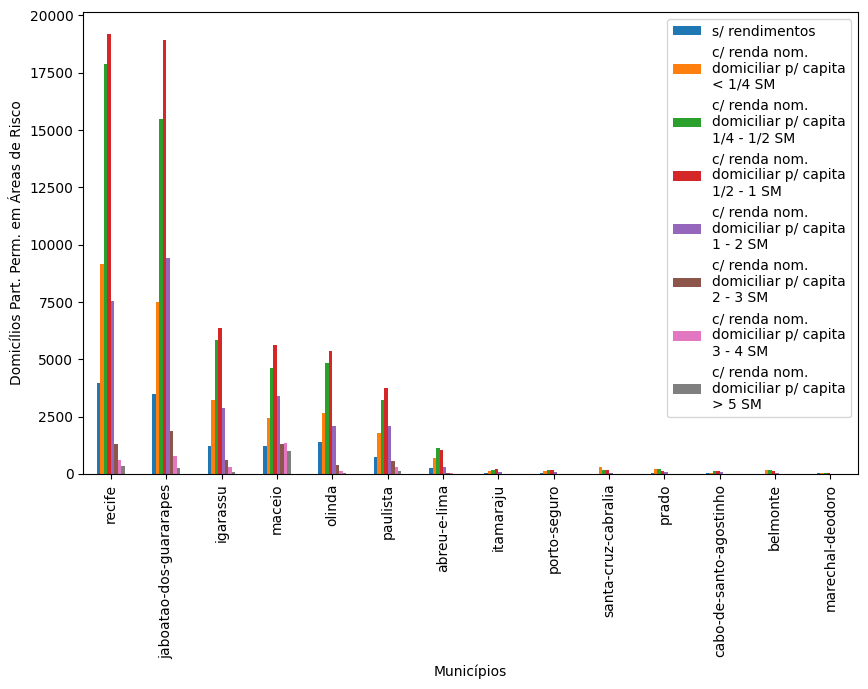

In [342]:
#Gráfico
# 'D069' 'Domicílios particulares sem rendimentos'
# 'D062' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita até 1/4 de salário mínimo'
# 'D063' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  1/4  a 1/2 salário mínimo'

# 'D064' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  1/2  a 1 salário mínimo'

# 'D065' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  1  a 2 salários mínimos'

# 'D066' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  2  a 3 salários mínimos'
# 'D067' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  3  a 4 salários mínimos'
# 'D068' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita maior que 5 salários mínimos'

df = DF_Areas_Risco_Domic_Pessoas.copy()

var1 = 'D069'
var2 = 'D062'
var3 = 'D063'
var4 = 'D064'
var5 = 'D065'
var6 = 'D066'
var7 = 'D067'
var8 = 'D068'
cols = [var1, var2, var3, var4, var5, var6, var7, var8]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, var4, var5, var6, var7, var8]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
# df = df.sort_values(var1, ascending = False)

# Armazena novos nomes de variáveis
nvar1 = 's/ rendimentos'
nvar2 = 'c/ renda nom.\ndomiciliar p/ capita\n< 1/4 SM'
nvar3 = 'c/ renda nom.\ndomiciliar p/ capita\n1/4 - 1/2 SM'
nvar4 = 'c/ renda nom.\ndomiciliar p/ capita\n1/2 - 1 SM'
nvar5 = 'c/ renda nom.\ndomiciliar p/ capita\n1 - 2 SM'
nvar6 = 'c/ renda nom.\ndomiciliar p/ capita\n2 - 3 SM'
nvar7 = 'c/ renda nom.\ndomiciliar p/ capita\n3 - 4 SM'
nvar8 = 'c/ renda nom.\ndomiciliar p/ capita\n> 5 SM'

# Renomeia variáveis no df
df.rename({
var1: nvar1,
var2: nvar2,
var3: nvar3,
var4: nvar4,
var5: nvar5,
var6: nvar6,
var7: nvar7,
var8: nvar8
}, axis = 1, inplace = True)
cols = [nvar1, nvar2, nvar3, nvar4, nvar5,  nvar6, nvar7, nvar8]

# Agregando df por município e somando os valores das variáveis trabalhadas com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum().reset_index()
df = df.sort_values(nvar4, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = cols,
        kind = 'bar',
        legend = True
        )
plt.xlabel('Municípios')
plt.ylabel('Domicílios Part. Perm. em Áreas de Risco')

save_graph('Bar_Domicilios sem rendimento e por renda em Salarios Mínimos em AR', 'Municipios')

Gráfico Comparado Pessoas em Domicilios sem rendimento, até1/4, até 1/2, de 1/2 a 1, de 1 a 2, de 2 a 3,  de 3 a 4, 5+ Salários Mínimos (O.K.)

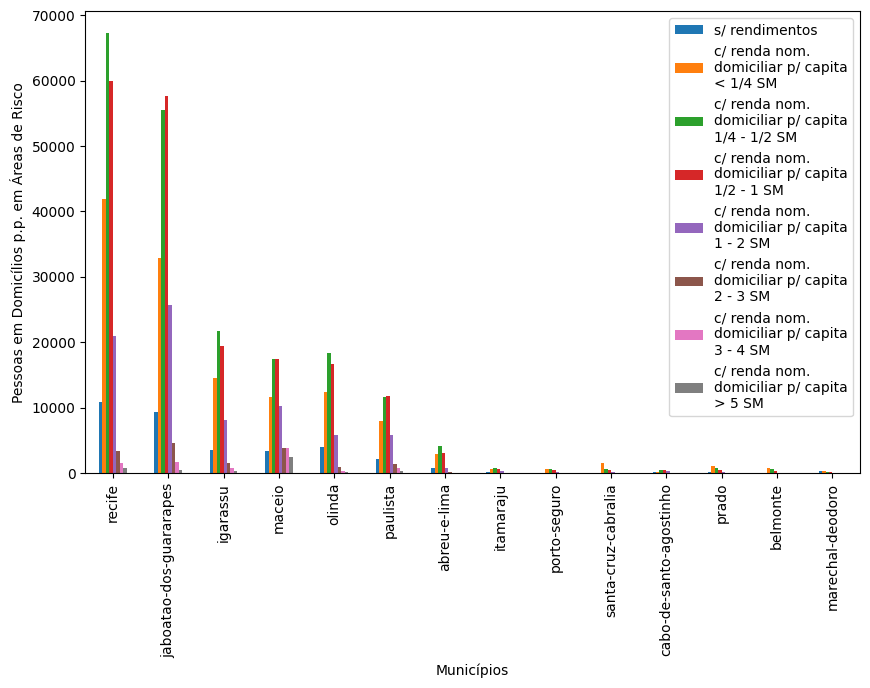

In [343]:
#Gráfico
# 'M069' 'Moradores em domicílios particulares sem rendimentos'
# 'M062' 'Moradores em domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  1/4  a 1/2 salário mínimo'
# 'M063' 'Moradores em domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita até 1/4 de salário mínimo'
# 'M064' 'Moradores em domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  1/2  a 1 salário mínimo'
# 'M065' 'Moradores em domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  1  a 2 salários mínimos'
# 'M066' 'Moradores em domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  2  a 3 salários mínimos'
# 'M067' 'Moradores em domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  3  a 4 salários mínimos'
# 'M068' 'Moradores em domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita maior que 5 salários mínimos'

df = DF_Areas_Risco_Domic_Pessoas.copy()

var1 = 'M069'
var2 = 'M062'
var3 = 'M063'
var4 = 'M064'
var5 = 'M065'
var6 = 'M066'
var7 = 'M067'
var8 = 'M068'
cols = [var1, var2, var3, var4, var5, var6, var7, var8]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, var4, var5, var6, var7, var8]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
# df = df.sort_values(var1, ascending = False)

# Armazena novos nomes de variáveis
nvar1 = 's/ rendimentos'
nvar2 = 'c/ renda nom.\ndomiciliar p/ capita\n< 1/4 SM'
nvar3 = 'c/ renda nom.\ndomiciliar p/ capita\n1/4 - 1/2 SM'
nvar4 = 'c/ renda nom.\ndomiciliar p/ capita\n1/2 - 1 SM'
nvar5 = 'c/ renda nom.\ndomiciliar p/ capita\n1 - 2 SM'
nvar6 = 'c/ renda nom.\ndomiciliar p/ capita\n2 - 3 SM'
nvar7 = 'c/ renda nom.\ndomiciliar p/ capita\n3 - 4 SM'
nvar8 = 'c/ renda nom.\ndomiciliar p/ capita\n> 5 SM'

# Renomeia variáveis no df
df.rename({
var1: nvar1,
var2: nvar2,
var3: nvar3,
var4: nvar4,
var5: nvar5,
var6: nvar6,
var7: nvar7,
var8: nvar8
}, axis = 1, inplace = True)
cols = [nvar1, nvar2, nvar3, nvar4, nvar5,  nvar6, nvar7, nvar8]

# Agregando df por município e somando os valores das variáveis trabalhadas com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum().reset_index()
df = df.sort_values(nvar4, ascending = False)

df.plot(
        x = 'nome_municipio',
        y = cols,
        kind = 'bar',
        legend = True
        )
plt.xlabel('Municípios')
plt.ylabel('Pessoas em Domicílios p.p. em Áreas de Risco')

save_graph('Bar_Pessoas em Domicilios sem rendimento e por renda em Salarios Mínimos em AR', 'Municipios')

Gráfico Municipal Domicilios sem rendimento, até1/4, até 1/2, de 1/2 a 1, de 1 a 2, de 2 a 3,  de 3 a 4, 5+ Salários Mínimos (O.K.)

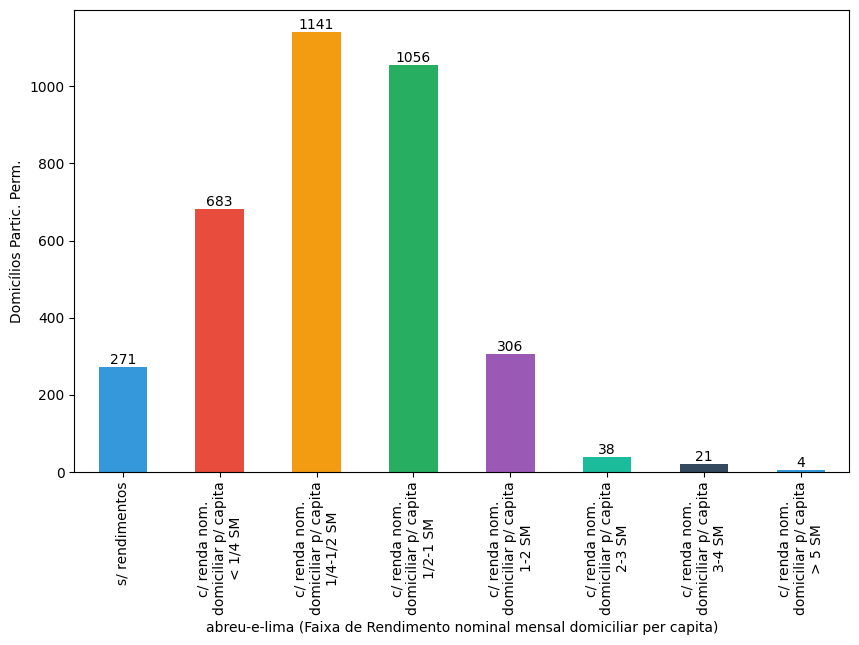

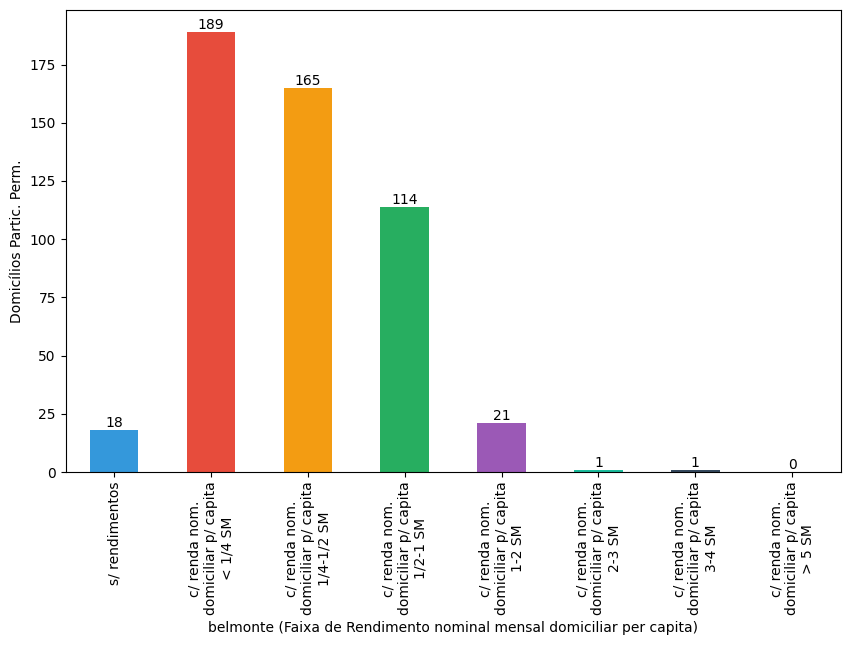

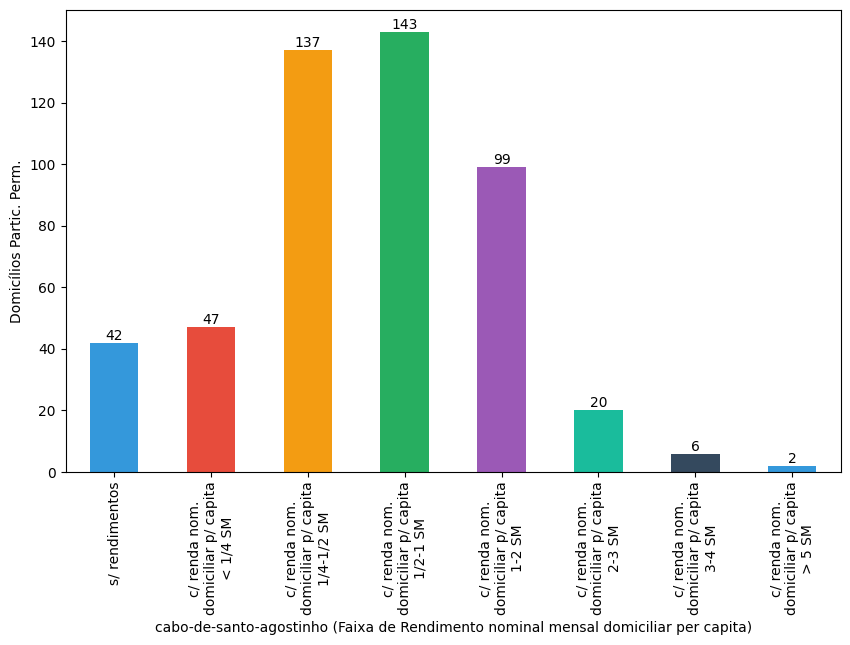

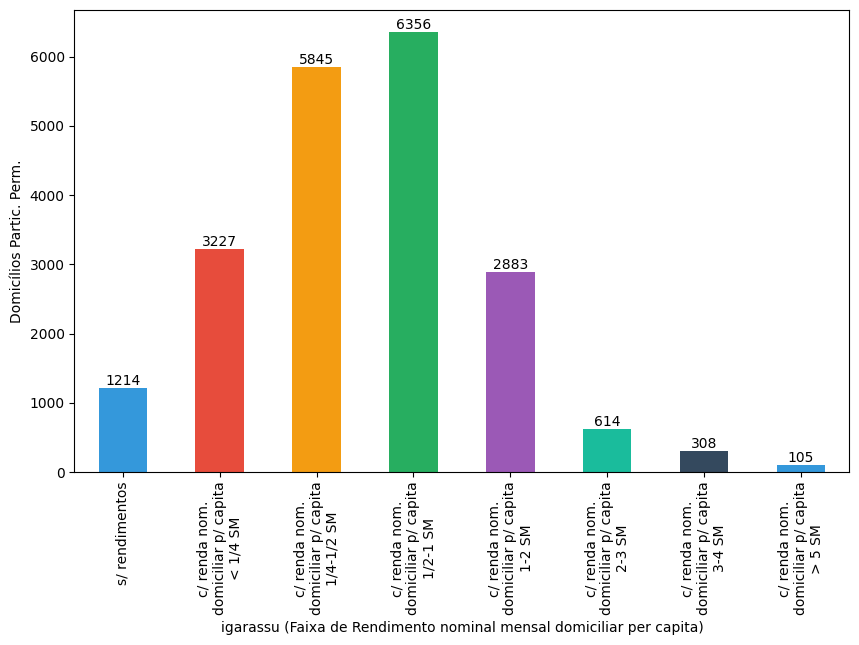

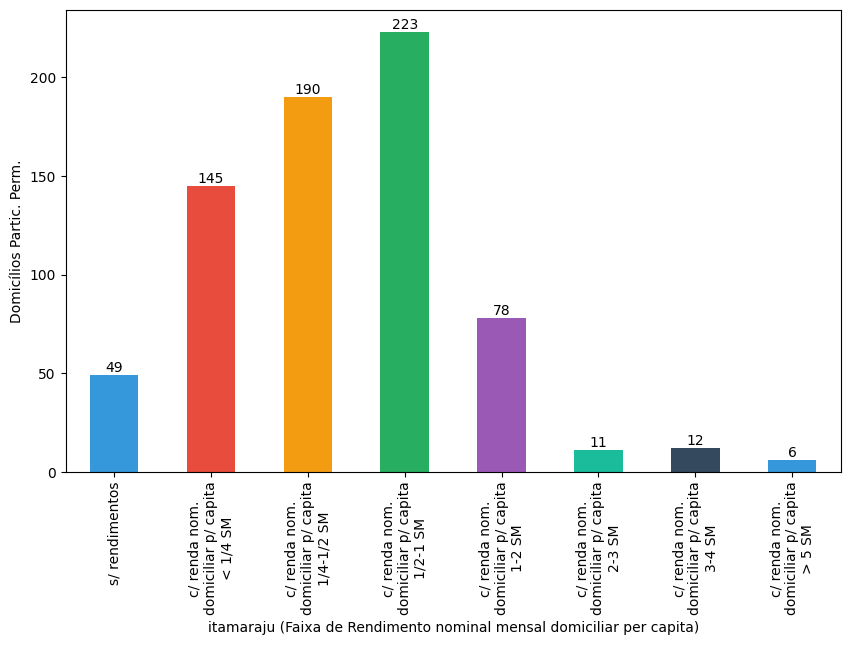

...

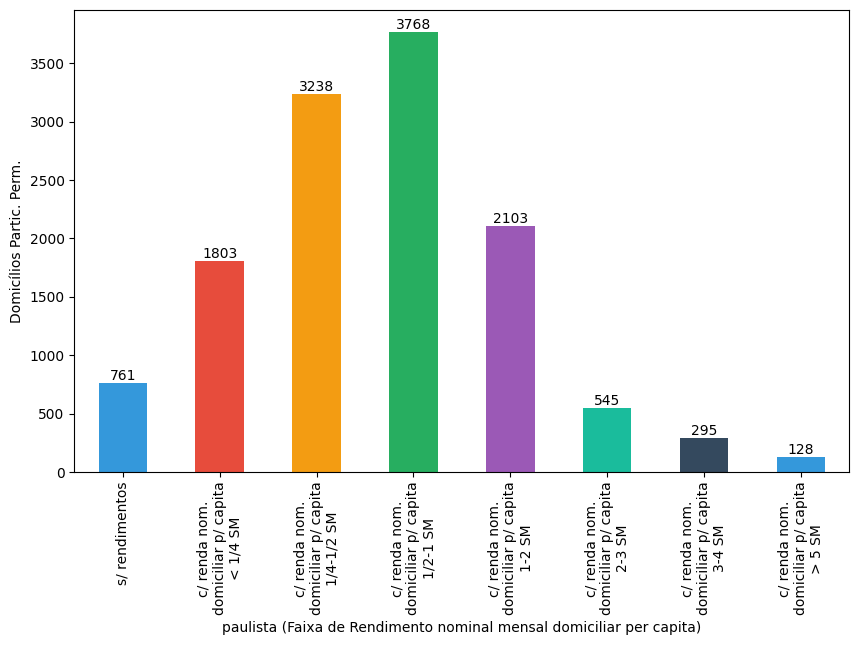

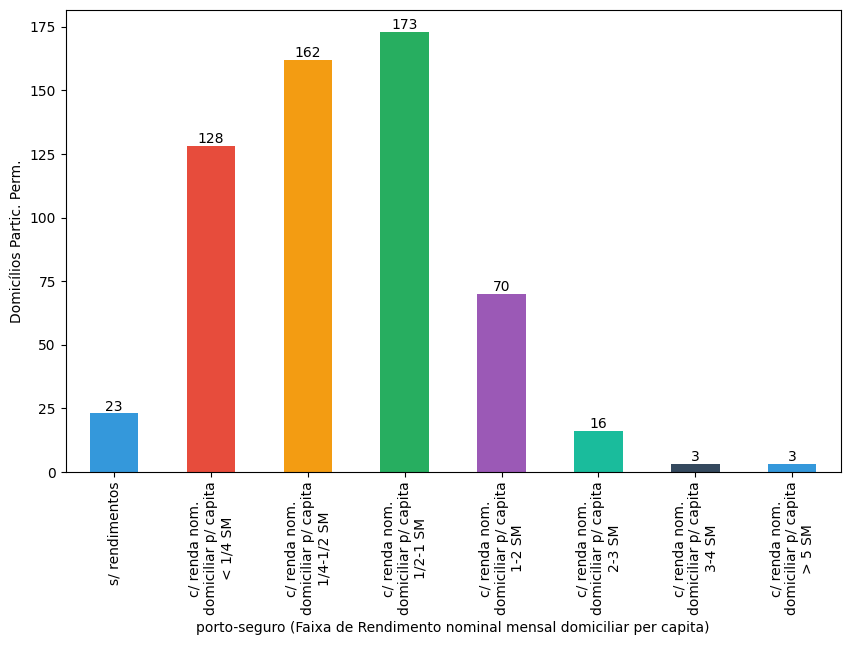

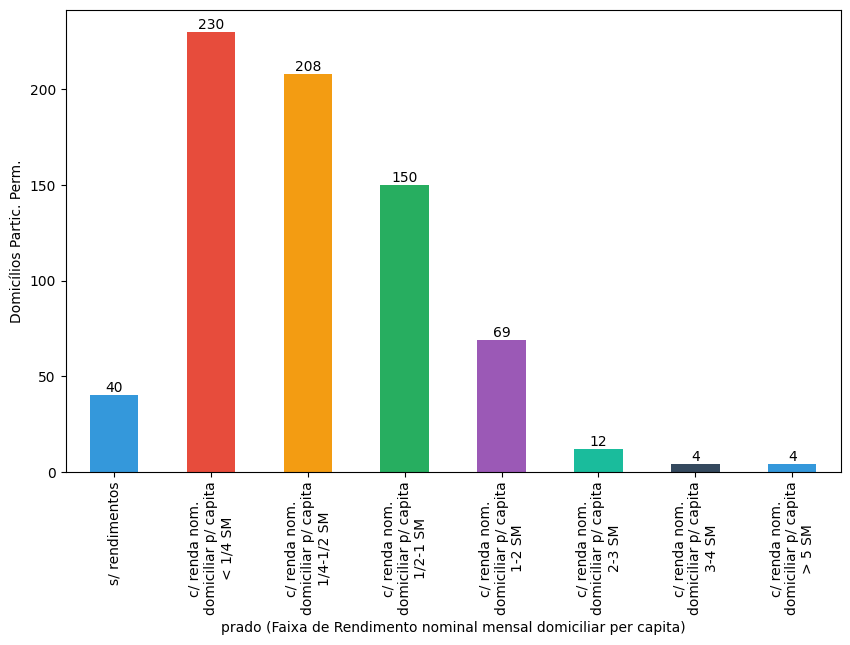

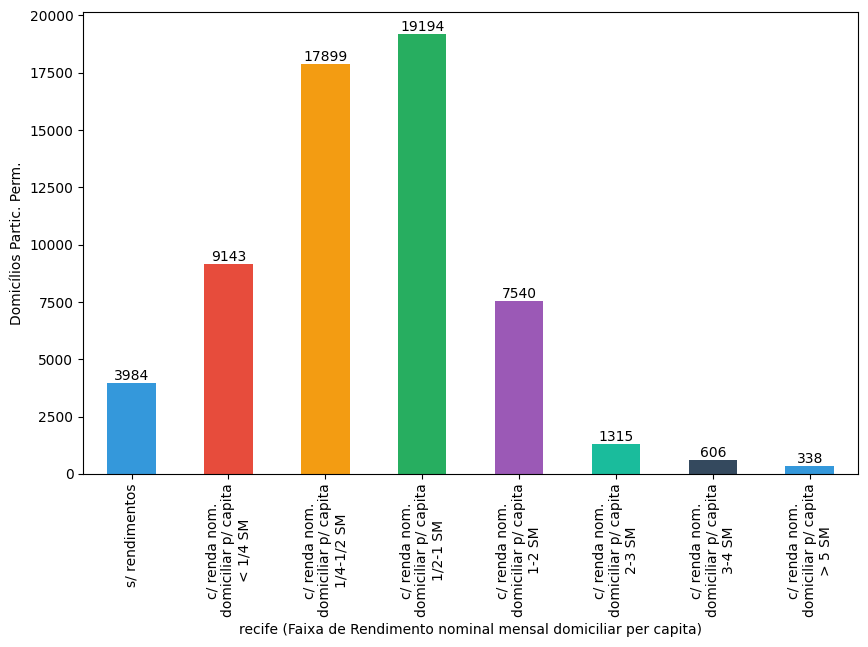

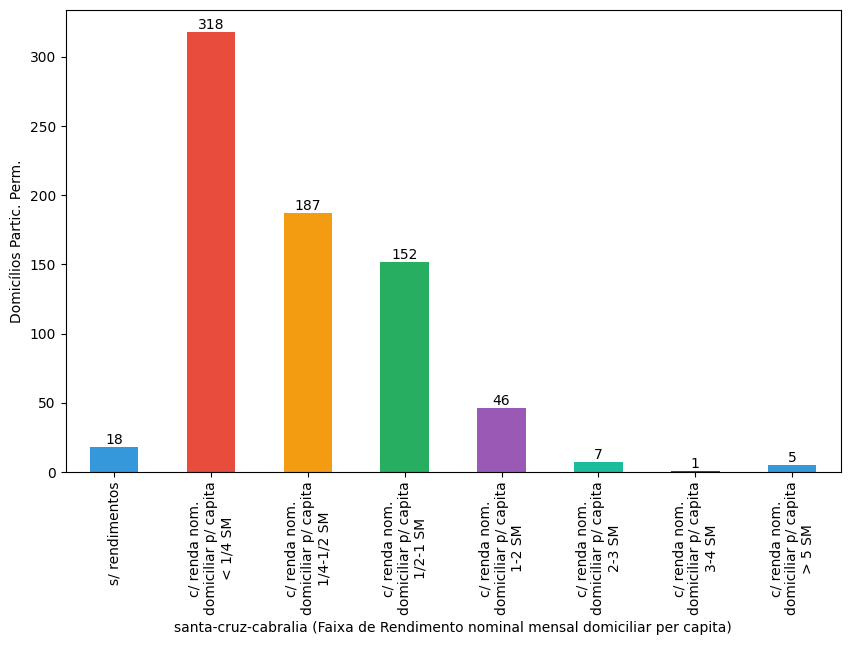

In [344]:
#Gráfico
# 'D069' 'Domicílios particulares sem rendimentos'
# 'D062' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita até 1/4 de salário mínimo'  
# 'D063' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  1/4  a 1/2 salário mínimo'
# 'D064' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  1/2  a 1 salário mínimo'
# 'D065' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  1  a 2 salários mínimos'
# 'D066' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  2  a 3 salários mínimos'
# 'D067' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  3  a 4 salários mínimos'
# 'D068' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita maior que 5 salários mínimos'


df = DF_Areas_Risco_Domic_Pessoas.copy()

var1 = 'D069'
var2 = 'D062'
var3 = 'D063'
var4 = 'D064'
var5 = 'D065'
var6 = 'D066'
var7 = 'D067'
var8 = 'D068'
cols = [var1, var2, var3, var4, var5, var6, var7, var8]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, var4, var5, var6, var7, var8]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
# df = df.sort_values(var1, ascending = False)

# Armazena novos nomes de variáveis
nvar1 = 's/ rendimentos'
nvar2 = 'c/ renda nom.\ndomiciliar p/ capita\n< 1/4 SM'
nvar3 = 'c/ renda nom.\ndomiciliar p/ capita\n1/4-1/2 SM'
nvar4 = 'c/ renda nom.\ndomiciliar p/ capita\n1/2-1 SM'
nvar5 = 'c/ renda nom.\ndomiciliar p/ capita\n1-2 SM'
nvar6 = 'c/ renda nom.\ndomiciliar p/ capita\n2-3 SM'
nvar7 = 'c/ renda nom.\ndomiciliar p/ capita\n3-4 SM'
nvar8 = 'c/ renda nom.\ndomiciliar p/ capita\n> 5 SM'

# Renomeia variáveis no df
df.rename({
var1: nvar1,
var2: nvar2,
var3: nvar3,
var4: nvar4,
var5: nvar5,
var6: nvar6,
var7: nvar7,
var8: nvar8
}, axis = 1, inplace = True)
cols = [nvar1, nvar2, nvar3, nvar4, nvar5,  nvar6, nvar7, nvar8]

# Agregando df por município e somando os valores das variáveis trabalhadas com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum().reset_index()
# df = df.sort_values(nvar2, ascending = False)

# Define valores das cores das barras para o gráfico
c = '#3498db'
m = '#e74c3c'
y = '#f39c12'
g = '#27ae60'
p = '#9b59b6'
t = '#1abc9c'
a = '#34495e'

# Loop produz gráficos para cada município no DF
for munic in df['nome_municipio']:
        dfx = df[df['nome_municipio'] == munic]

        # Define colors for the bars
        colors = [c, m, y, g, p, t, a] #* 4

        # Plot the bar graph
        ax = dfx.iloc[0,1:].plot(kind='bar', color=colors) #figsize=(8, 6)

        # Set the x and y axis labels
        ax.set_xlabel(f'{munic} (Faixa de Rendimento nominal mensal domiciliar per capita)')
        ax.set_ylabel('Domicílios Partic. Perm.')

        for i, val in enumerate(dfx.iloc[0,1:]):
                plt.text(i, val, str(val), ha='center', va='bottom', fontweight='light')

        # Save plot to save_path
        plt.savefig(f'{save_path}\\Bar_Domicilios por Faixa de Rendimento nominal mensal domiciliar per capita_{munic}', dpi = 300, bbox_inches='tight' )

        # Show the plot
        plt.show() 




Gráfico Municipal Pessoas em Domicilios sem rendimento, até1/4, até 1/2, de 1/2 a 1, de 1 a 2, de 2 a 3,  de 3 a 4, 5+ Salários Mínimos (O.K.)

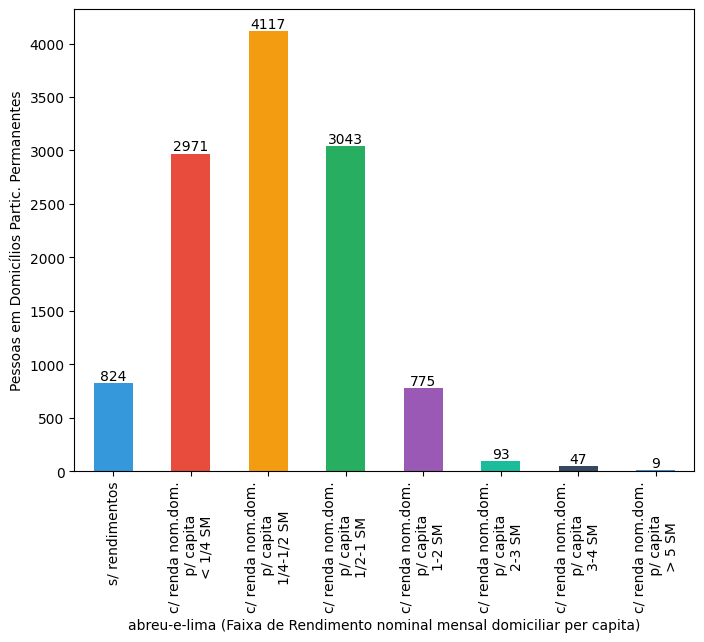

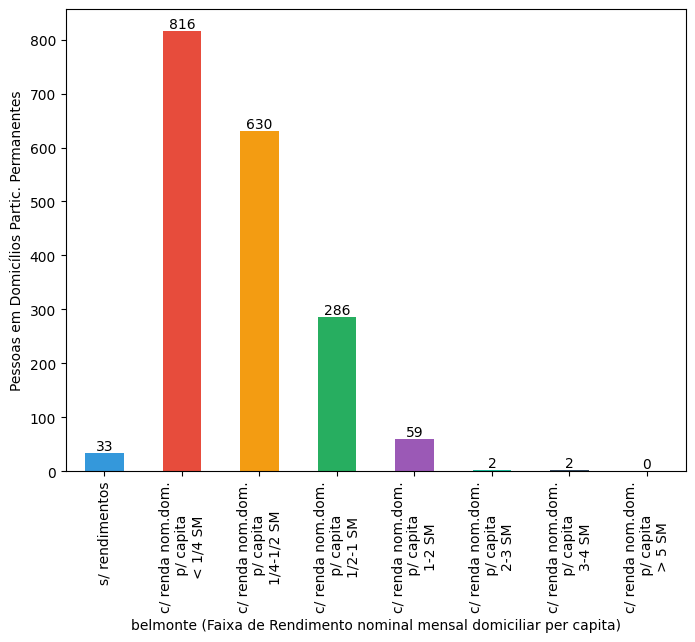

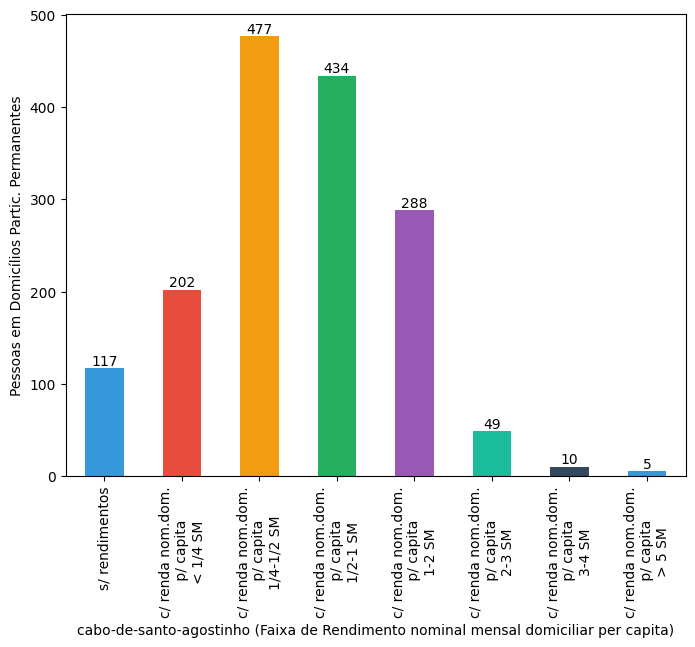

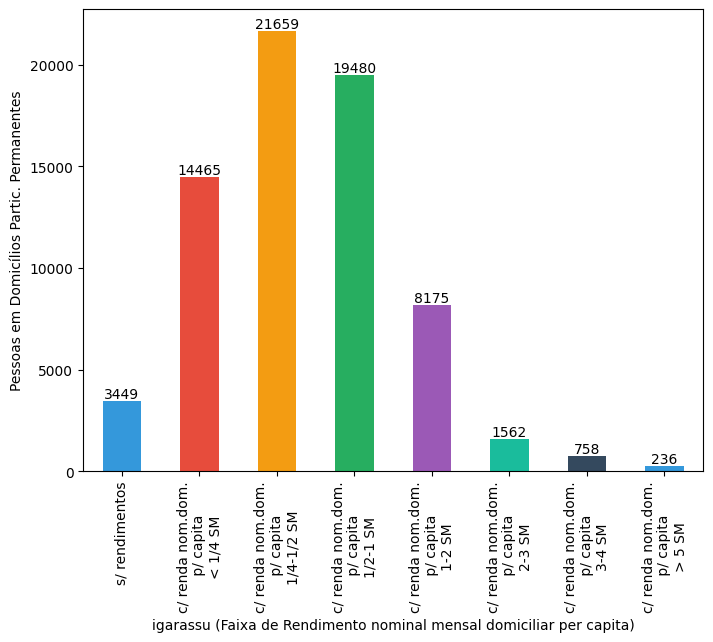

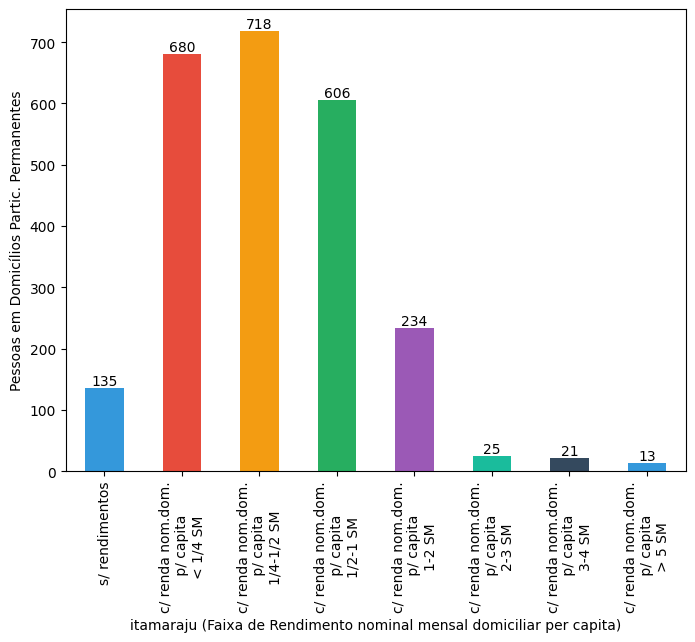

...

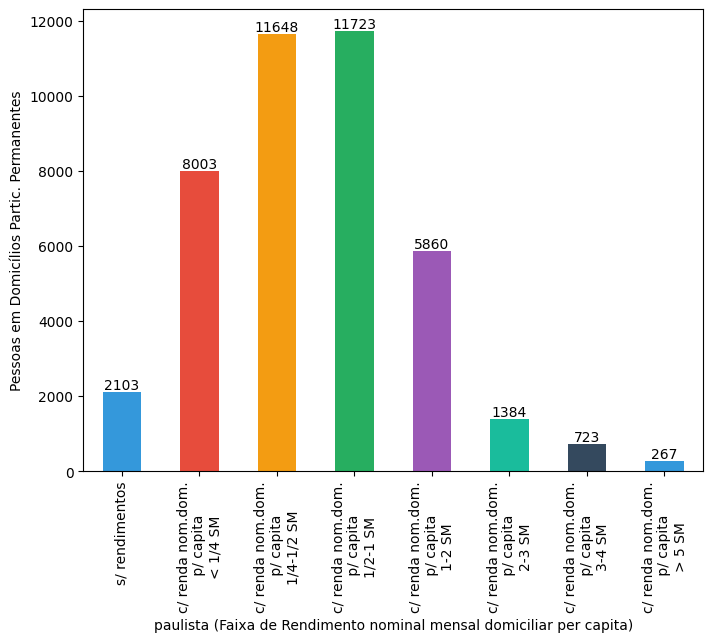

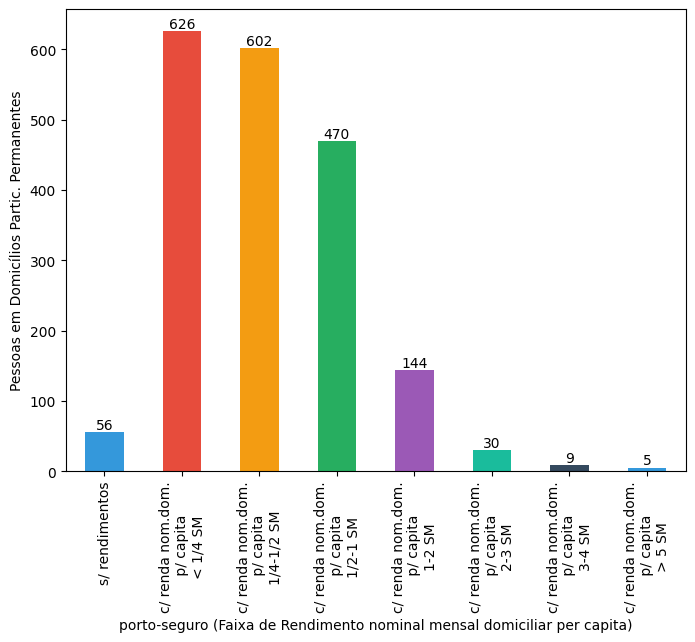

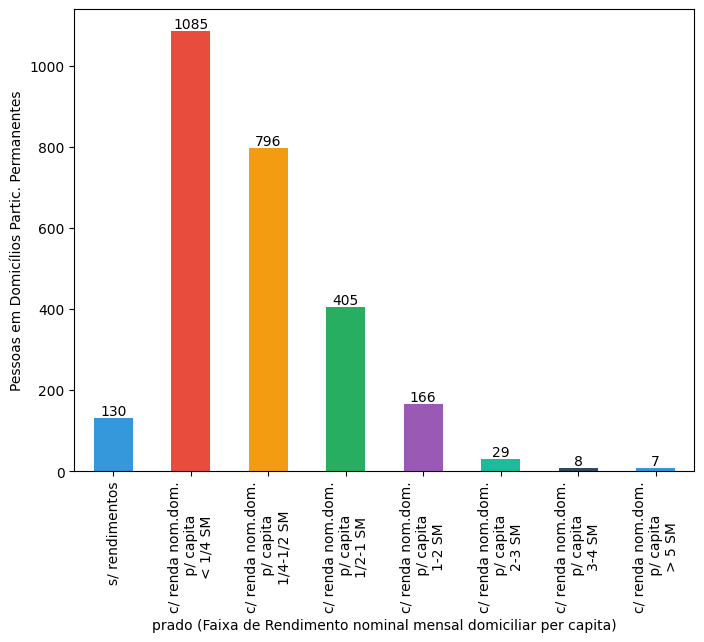

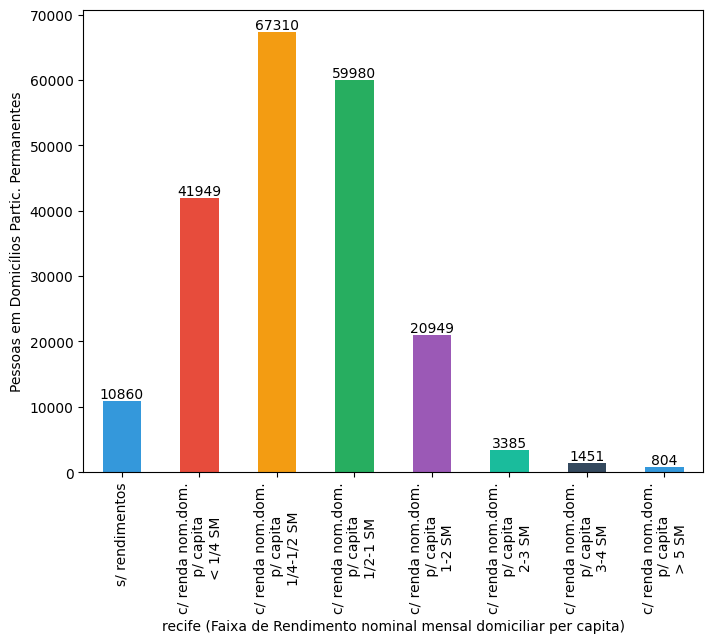

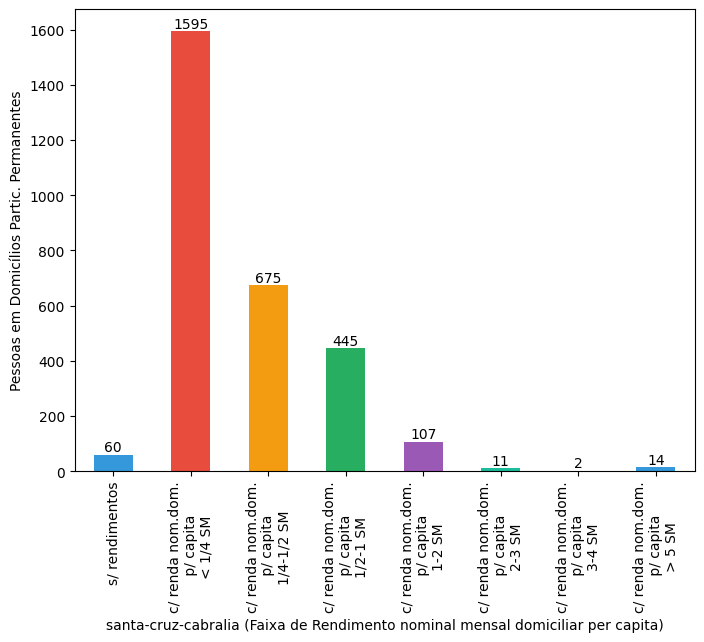

In [345]:
#Gráfico
# 'M069' 'Moradores em domicílios particulares sem rendimentos'
# 'M062' 'Moradores em domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  1/4  a 1/2 salário mínimo'
# 'M063' 'Moradores em domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita até 1/4 de salário mínimo'
# 'M064' 'Moradores em domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  1/2  a 1 salário mínimo'
# 'M065' 'Moradores em domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  1  a 2 salários mínimos'
# 'M066' 'Moradores em domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  2  a 3 salários mínimos'
# 'M067' 'Moradores em domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  3  a 4 salários mínimos'
# 'M068' 'Moradores em domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita maior que 5 salários mínimos'

df = DF_Areas_Risco_Domic_Pessoas.copy()

var1 = 'M069'
var2 = 'M062'
var3 = 'M063'
var4 = 'M064'
var5 = 'M065'
var6 = 'M066'
var7 = 'M067'
var8 = 'M068'
cols = [var1, var2, var3, var4, var5, var6, var7, var8]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, var4, var5, var6, var7, var8]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
# df = df.sort_values(var1, ascending = False)

# Armazena novos nomes de variáveis
nvar1 = 's/ rendimentos'
nvar2 = 'c/ renda nom.dom.\n p/ capita\n< 1/4 SM'
nvar3 = 'c/ renda nom.dom.\n p/ capita\n1/4-1/2 SM'
nvar4 = 'c/ renda nom.dom.\n p/ capita\n1/2-1 SM'
nvar5 = 'c/ renda nom.dom.\n p/ capita\n1-2 SM'
nvar6 = 'c/ renda nom.dom.\n p/ capita\n2-3 SM'
nvar7 = 'c/ renda nom.dom.\n p/ capita\n3-4 SM'
nvar8 = 'c/ renda nom.dom.\n p/ capita\n> 5 SM'

# Renomeia variáveis no df
df.rename({
var1: nvar1,
var2: nvar2,
var3: nvar3,
var4: nvar4,
var5: nvar5,
var6: nvar6,
var7: nvar7,
var8: nvar8
}, axis = 1, inplace = True)
cols = [nvar1, nvar2, nvar3, nvar4, nvar5,  nvar6, nvar7, nvar8]

# Agregando df por município e somando os valores das variáveis trabalhadas com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum().reset_index()
# df = df.sort_values(nvar2, ascending = False)

# Define valores das cores das barras para o gráfico
c = '#3498db'
m = '#e74c3c'
y = '#f39c12'
g = '#27ae60'
p = '#9b59b6'
t = '#1abc9c'
a = '#34495e'

# Loop produz gráficos para cada município no DF
for munic in df['nome_municipio']:
        dfx = df[df['nome_municipio'] == munic]

        # Define colors for the bars
        colors = [c, m, y, g, p, t, a] #* 4

        # Plot the bar graph
        ax = dfx.iloc[0,1:].plot(kind='bar', color=colors, figsize=(8, 6))

        # Set the x and y axis labels
        ax.set_xlabel(f'{munic} (Faixa de Rendimento nominal mensal domiciliar per capita)')
        ax.set_ylabel('Pessoas em Domicílios Partic. Permanentes')

        for i, val in enumerate(dfx.iloc[0,1:]):
                plt.text(i, val, str(val), ha='center', va='bottom', fontweight='light')

        # Save plot to save_path
        plt.savefig(f'{save_path}\\Bar_Pessoas em Domicilios por Faixa de Rendimento nominal mensal domiciliar per capita_{munic}', dpi = 300, bbox_inches='tight' )

        # Show the plot
        plt.show() 



Gráfico Municipal Domicilios Responsável Feminino sem rendimento, até1/4, até 1/2, de 1/2 a 1, de 1 a 2, de 2 a 3,  de 3 a 4, 5+ Salários Mínimos (O.K.)

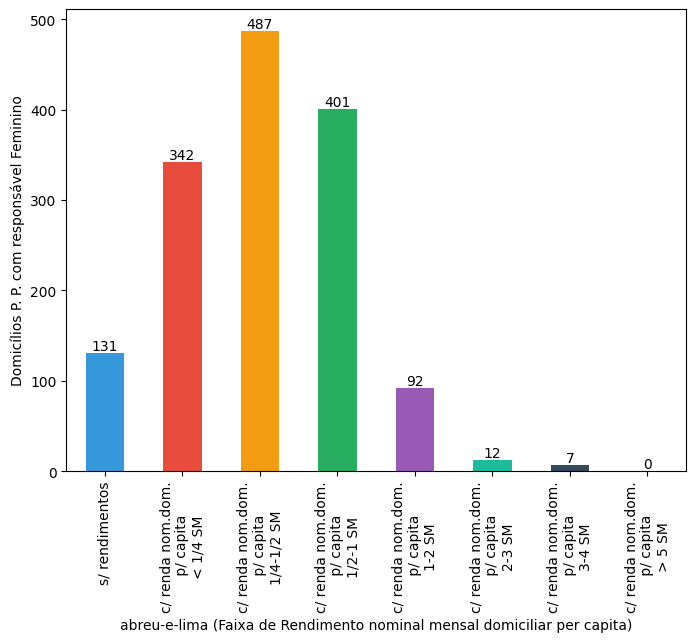

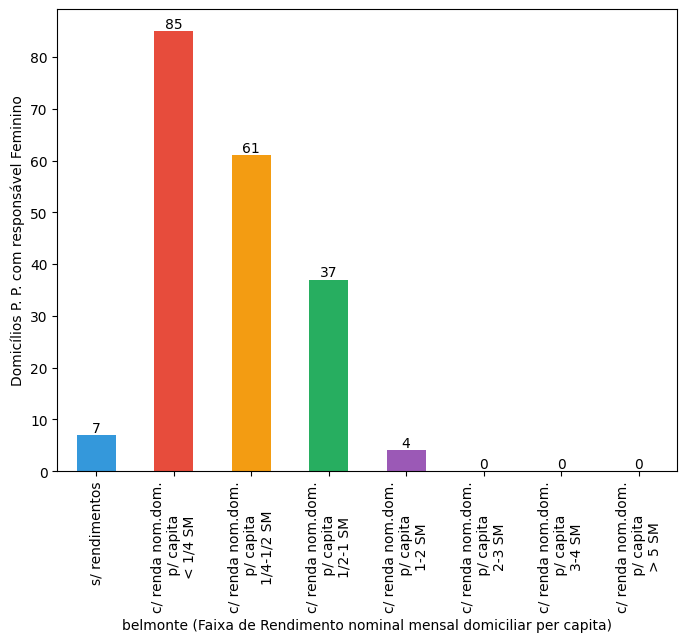

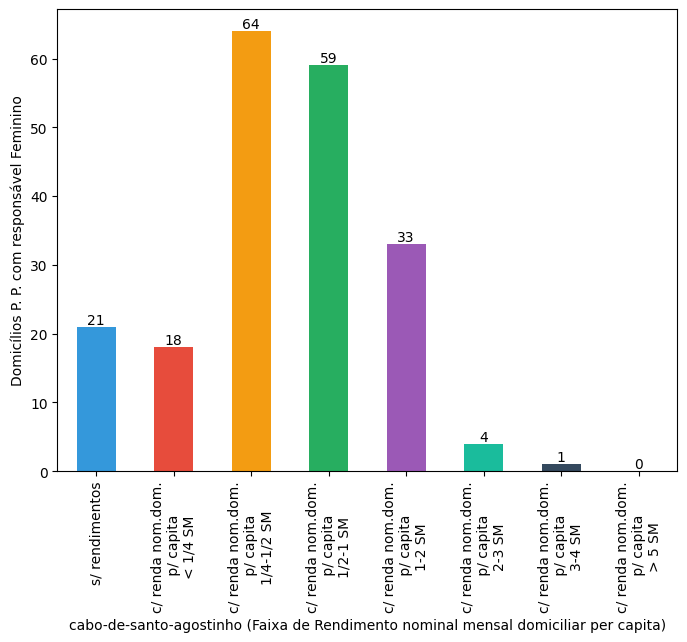

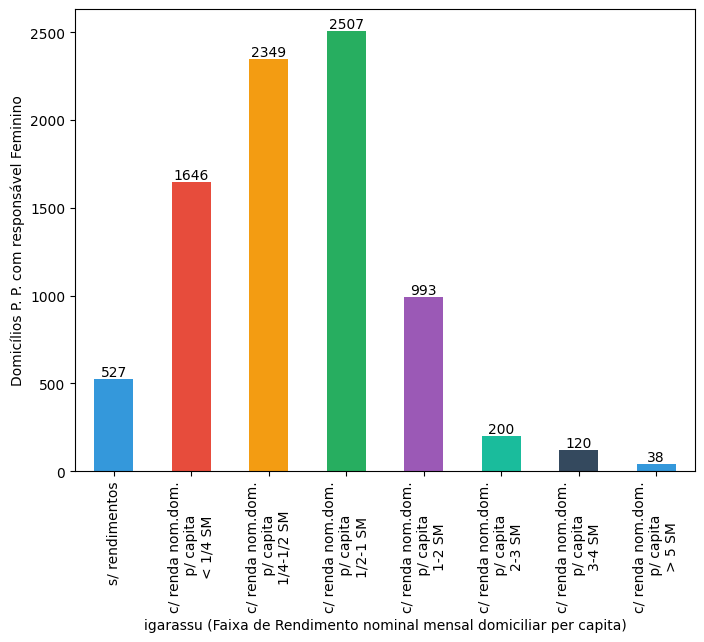

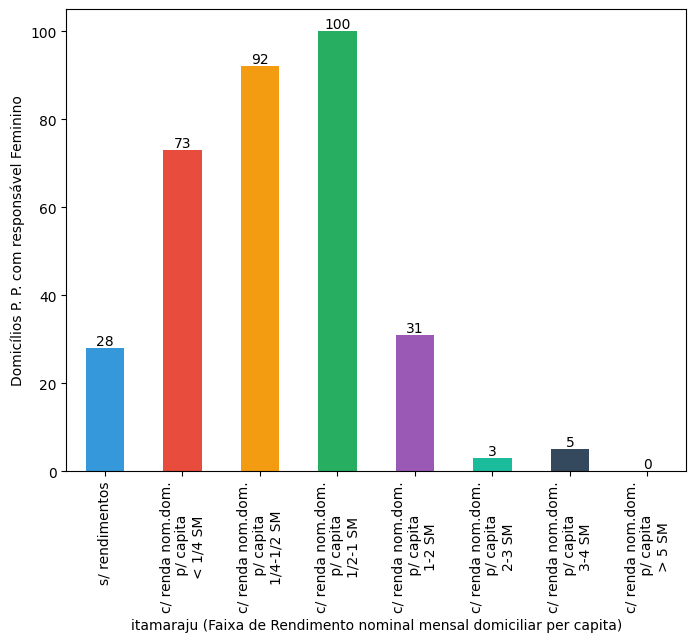

...

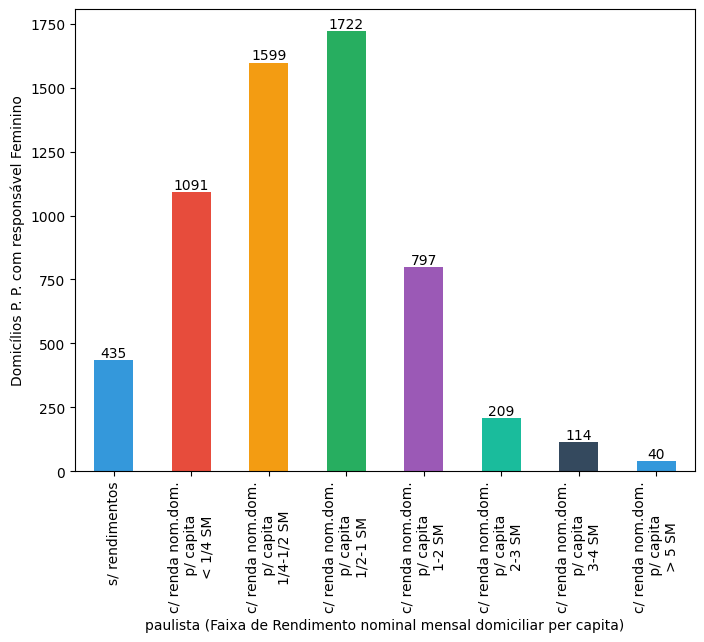

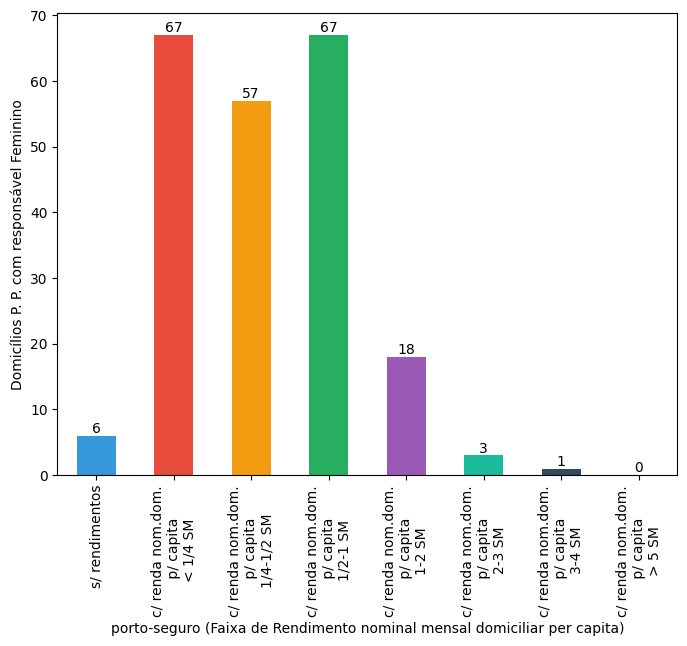

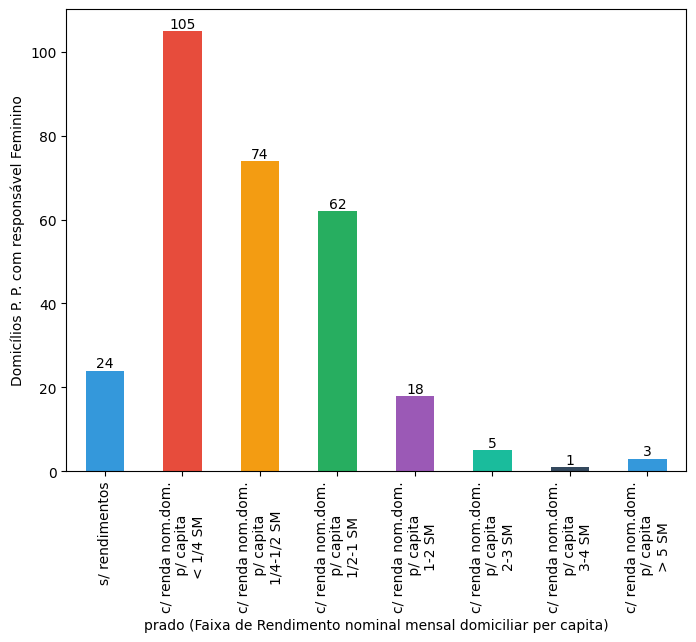

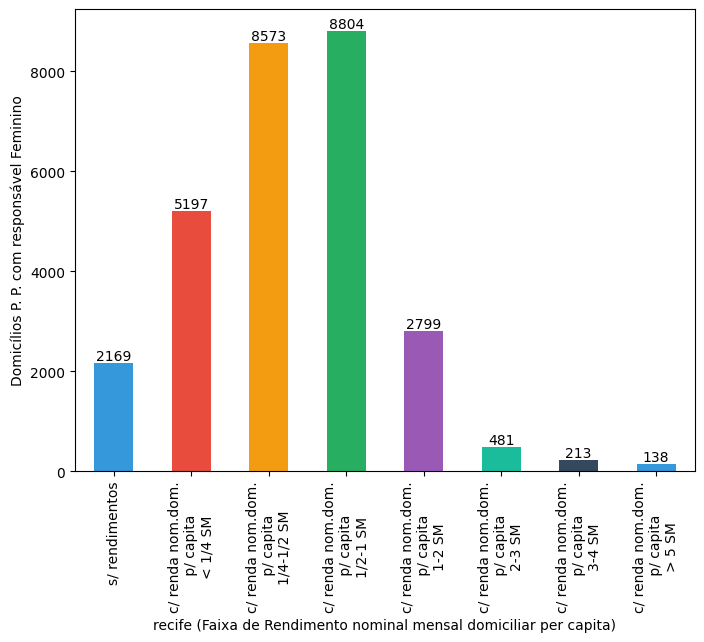

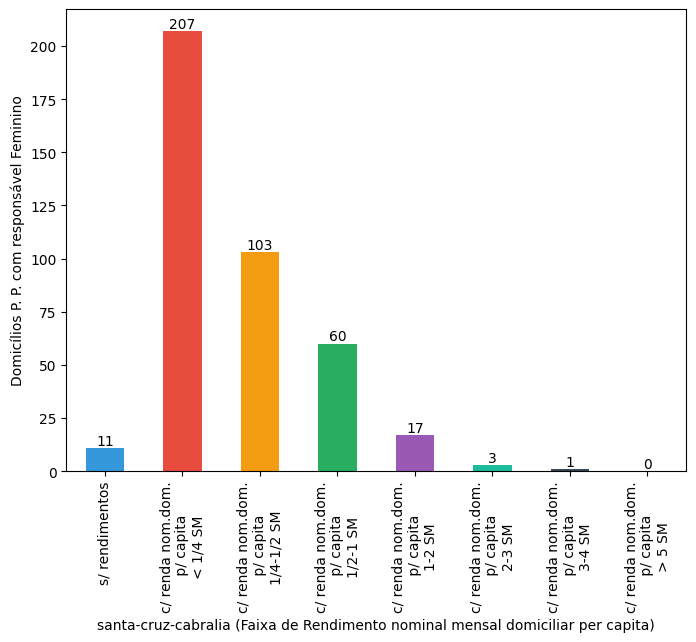

In [346]:
#Gráfico
# 'D092' 'Domicílios particulares sem rendimentos com responsável do sexo feminino'
# 'D085' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita até 1/4 de salário mínimo com responsável do sexo feminino'
# 'D086' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  1/4  a 1/2 salário mínimo  com responsável do sexo feminino'
# 'D087' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  1/2  a 1 salário mínimo com responsável do sexo feminino'
# 'D088' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  1  a 2 salários mínimos com responsável do sexo feminino'
# 'D089' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  2  a 3 salários mínimos com responsável do sexo feminino'
# 'D090' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita de  3  a 4 salários mínimos com responsável do sexo feminino'
# 'D091' 'Domicílios particulares permanentes com rendimento nominal mensal domiciliar per capita maior que 5 salários mínimos com responsável do sexo feminino'


df = DF_Areas_Risco_Domic_Pessoas.copy()

var1 = 'D092'
var2 = 'D085'
var3 = 'D086'
var4 = 'D087'
var5 = 'D088'
var6 = 'D089'
var7 = 'D090'
var8 = 'D091'
cols = [var1, var2, var3, var4, var5, var6, var7, var8]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, var4, var5, var6, var7, var8]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
# df = df.sort_values(var1, ascending = False)

# Armazena novos nomes de variáveis
nvar1 = 's/ rendimentos'
nvar2 = 'c/ renda nom.dom.\n p/ capita\n< 1/4 SM'
nvar3 = 'c/ renda nom.dom.\n p/ capita\n1/4-1/2 SM'
nvar4 = 'c/ renda nom.dom.\n p/ capita\n1/2-1 SM'
nvar5 = 'c/ renda nom.dom.\n p/ capita\n1-2 SM'
nvar6 = 'c/ renda nom.dom.\n p/ capita\n2-3 SM'
nvar7 = 'c/ renda nom.dom.\n p/ capita\n3-4 SM'
nvar8 = 'c/ renda nom.dom.\n p/ capita\n> 5 SM'

# Renomeia variáveis no df
df.rename({
var1: nvar1,
var2: nvar2,
var3: nvar3,
var4: nvar4,
var5: nvar5,
var6: nvar6,
var7: nvar7,
var8: nvar8
}, axis = 1, inplace = True)
cols = [nvar1, nvar2, nvar3, nvar4, nvar5,  nvar6, nvar7, nvar8]

# Agregando df por município e somando os valores das variáveis trabalhadas com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum().reset_index()
# df = df.sort_values(nvar2, ascending = False)

# Define valores das cores das barras para o gráfico
c = '#3498db'
m = '#e74c3c'
y = '#f39c12'
g = '#27ae60'
p = '#9b59b6'
t = '#1abc9c'
a = '#34495e'

# Loop produz gráficos para cada município no DF
for munic in df['nome_municipio']:
        dfx = df[df['nome_municipio'] == munic]

        # Define colors for the bars
        colors = [c, m, y, g, p, t, a] #* 4

        # Plot the bar graph
        ax = dfx.iloc[0,1:].plot(kind='bar', color=colors, figsize=(8, 6))

        # Set the x and y axis labels
        ax.set_xlabel(f'{munic} (Faixa de Rendimento nominal mensal domiciliar per capita)')
        ax.set_ylabel('Domicílios P. P. com responsável Feminino')

        for i, val in enumerate(dfx.iloc[0,1:]):
                plt.text(i, val, str(val), ha='center', va='bottom', fontweight='light')

        # Save plot to save_path
        plt.savefig(f'{save_path}\\Bar_Pessoas em Domicilios por Faixa de Rendimento domiciliar per capita Responsavel Feminino_{munic}', dpi = 300, bbox_inches='tight' )

        # Show the plot
        plt.show() 








Gráfico Municipal Pie Responsáveis pelo Domicílio Feminino x Masculino (O.K.)

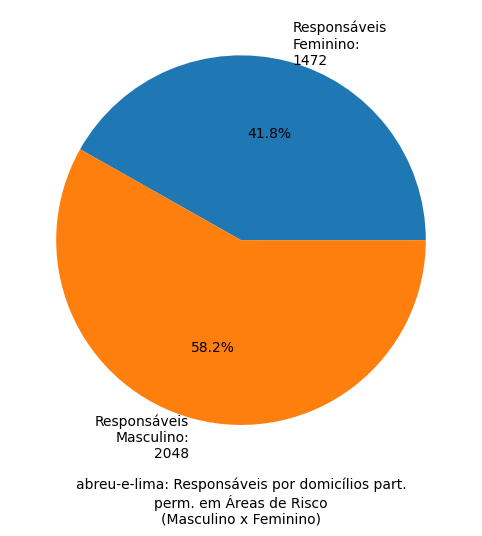

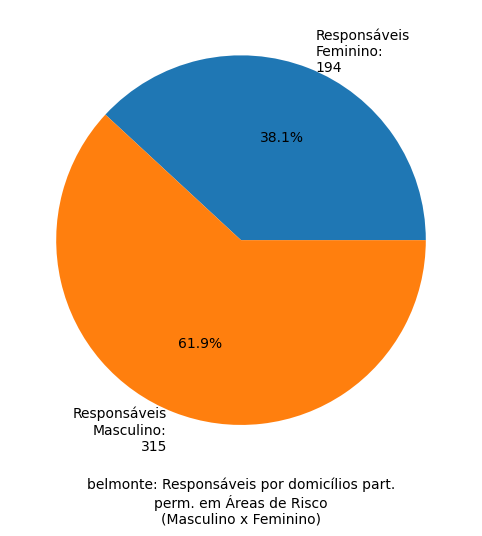

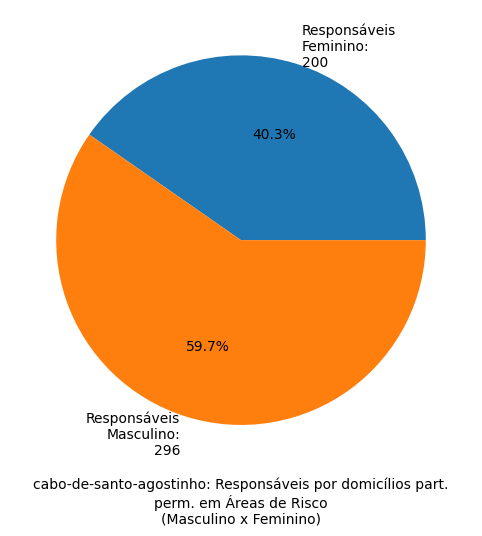

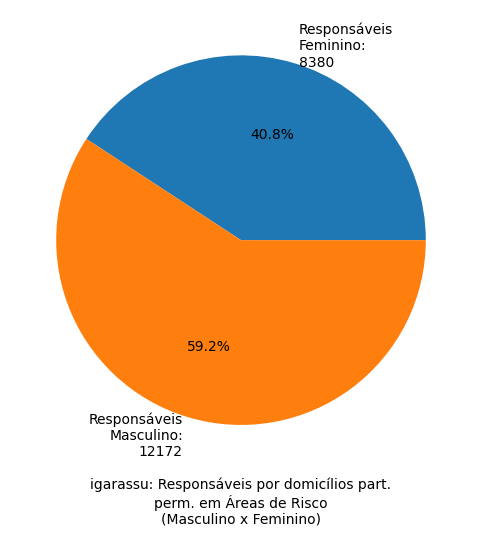

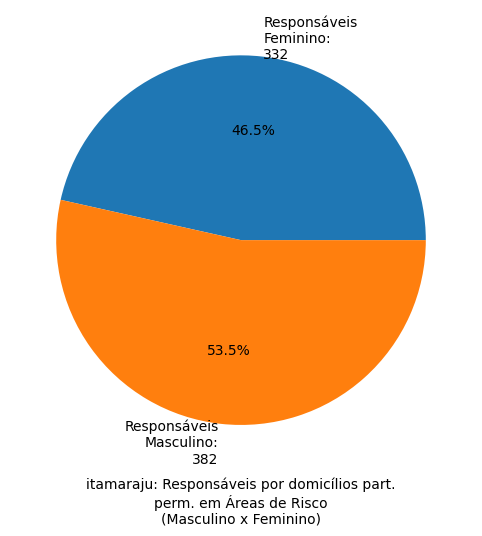

...

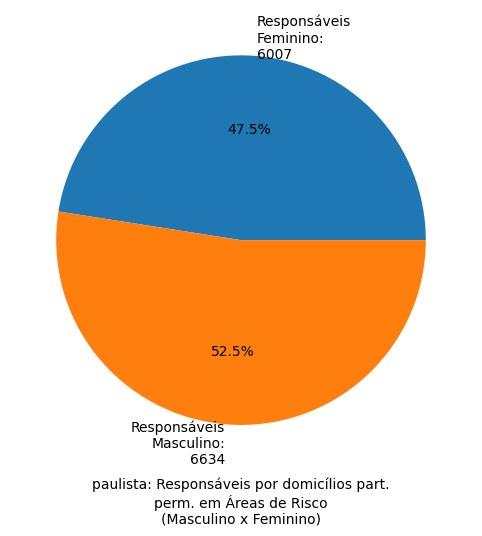

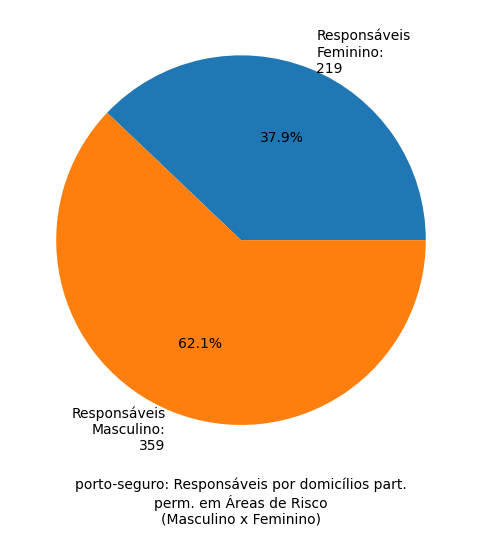

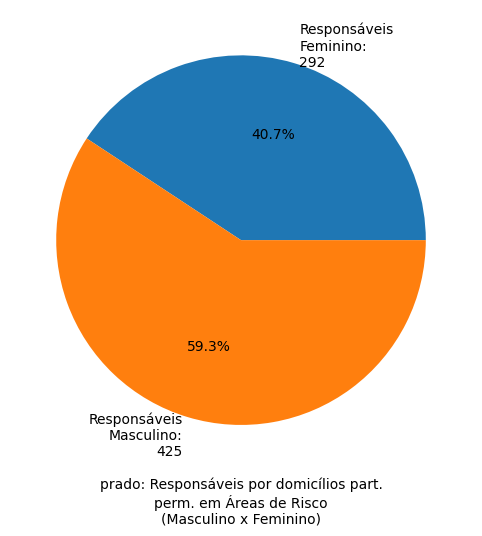

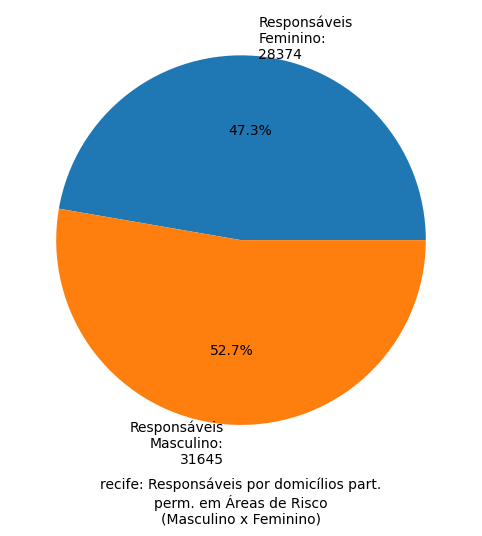

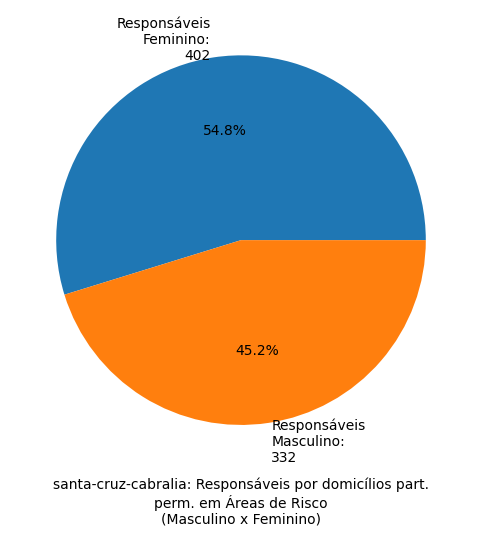

In [347]:
# Gráfico:
'M086' 'Total de pessoas responsáveis pelo domicílio particular permanente do sexo feminino'
'M085' 'Total de pessoas responsáveis pelo domicílio particular permanente do sexo masculino'

df = DF_Areas_Risco_Domic_Pessoas.copy()

var = 'M086'
var2 = 'M085'
cols = [var, var2]

# Resume df necessário
df = df[['nome_municipio', var, var2]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
df = df.sort_values(var, ascending = False)


# Agregando df por município e somando os valores da variável trabalhada com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum().reset_index()

# Loop de criação dos pie charts para pop_situ_domic_df
df['Est. Total'] = df.apply(lambda row: row[var] + row[var2], axis = 1)

for i, row in df.iterrows():
        try:
                dfx = df[cols]
                percents = dfx.iloc[i] / df['Est. Total'].iloc[i]
                label1 = f'Responsáveis\nFeminino:\n{round(df[var].iloc[i])}'
                label2 = f'Responsáveis\nMasculino:\n{round(df[var2].iloc[i])}'
                labels=[label1, label2]
                sizes = percents.values
                plt.pie(sizes, labels=labels, autopct='%1.1f%%')
        except:
                print(f'Não há valores para' + row['nome_municipio'] + 'Municipio adicionado em Errors_list')
                Errors_list.append(row['nome_municipio'])
        else:
                plt.xlabel(row['nome_municipio']+': Responsáveis por domicílios part.\nperm. em Áreas de Risco\n(Masculino x Feminino)')
                plt.savefig(f'{save_path}\\Pie_% Responsáveis por domicílios p p Masculino x Feminino_{row["nome_municipio"]}.png')
                plt.show()


Gráfico Municipal PIe Responsáveis pelo Domicílio Alfabetizado x Não Alfabetizado em Áreas de Risco (O.K.)

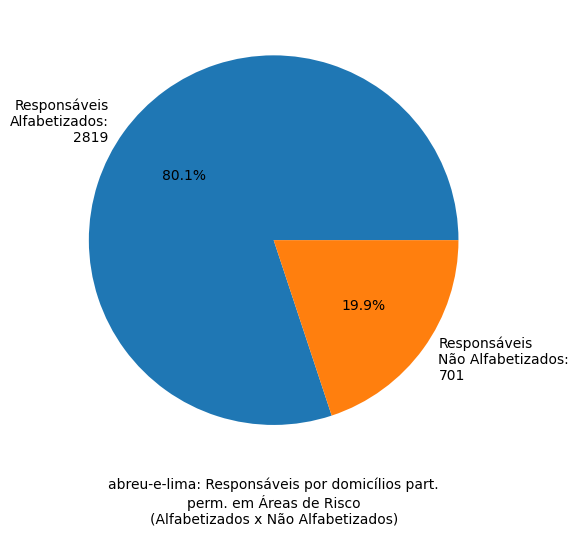

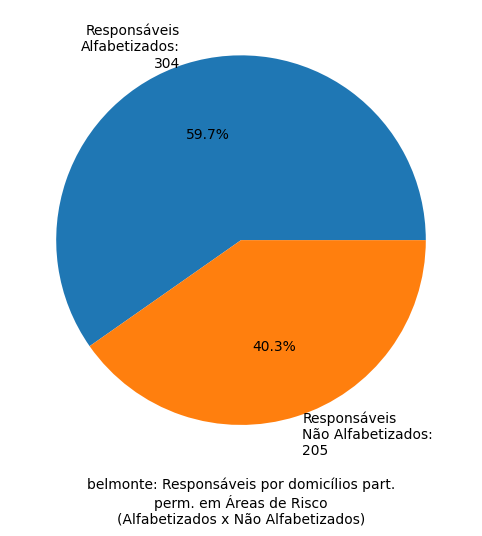

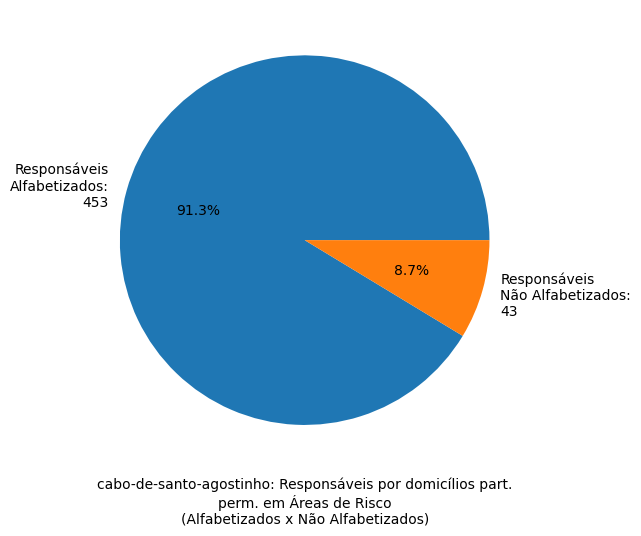

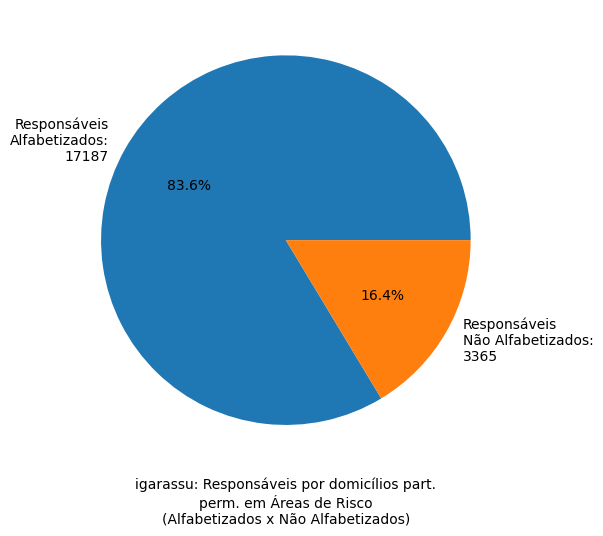

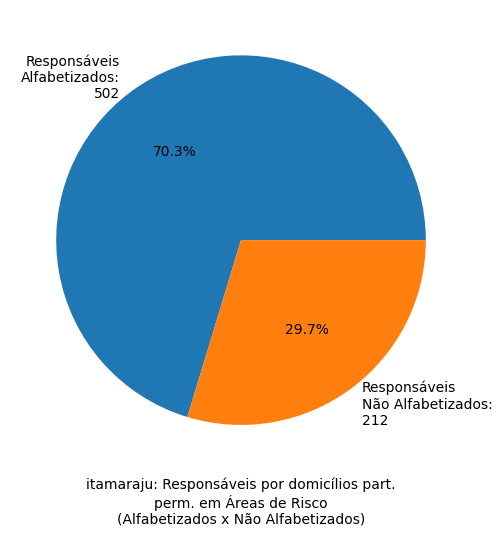

...

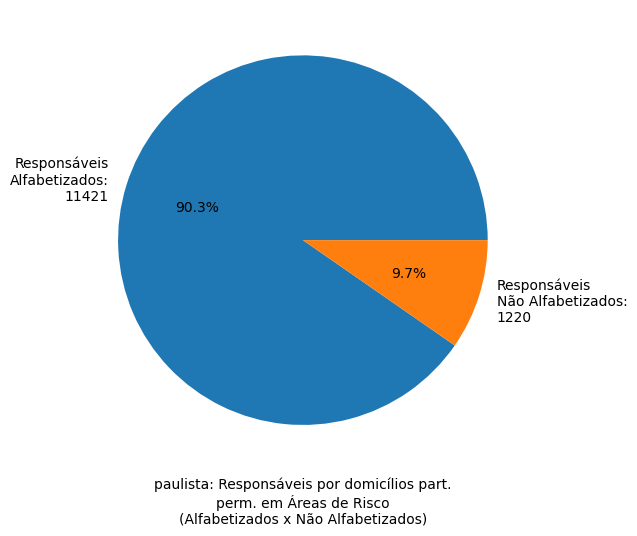

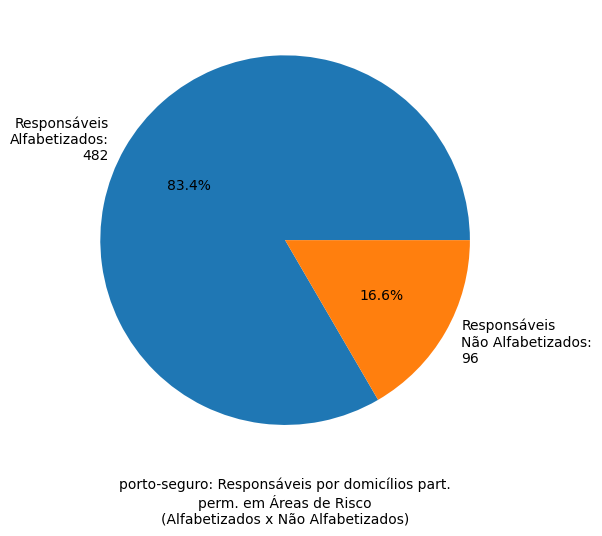

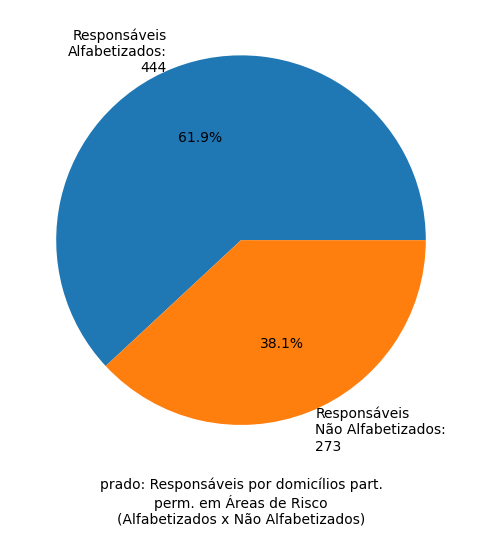

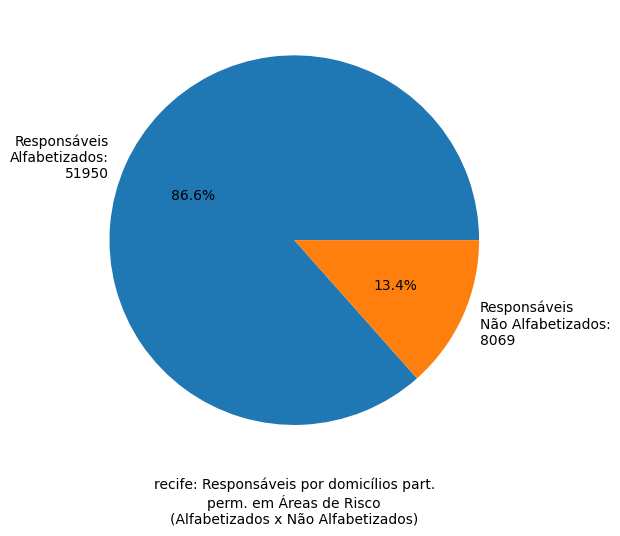

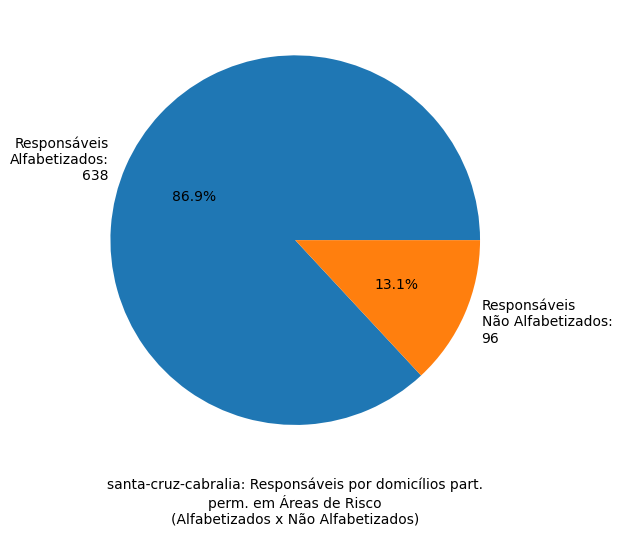

In [348]:
# Gráfico:
# 'M087' 'Pessoas responsáveis pelo domicílio particular permanente  alfabetizadas'
# 'M090' 'Pessoas responsáveis pelo domicílio particular permanente não alfabetizadas' 

df = DF_Areas_Risco_Domic_Pessoas.copy()

var = 'M087'
var2 = 'M090'
cols = [var, var2]

# Resume df necessário
df = df[['nome_municipio', var, var2]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
df = df.sort_values(var, ascending = False)


# Agregando df por município e somando os valores da variável trabalhada com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum().reset_index()

# Loop de criação dos pie charts para pop_situ_domic_df

df['Est. Total'] = df.apply(lambda row: row[var] + row[var2], axis = 1)

for i, row in df.iterrows():
        try:
                dfx = df[cols]
                percents = dfx.iloc[i] / df['Est. Total'].iloc[i]
                label1 = f'Responsáveis\nAlfabetizados:\n{round(df[var].iloc[i])}'
                label2 = f'Responsáveis\nNão Alfabetizados:\n{round(df[var2].iloc[i])}'
                labels=[label1, label2]
                sizes = percents.values
                plt.pie(sizes, labels=labels, autopct='%1.1f%%')
        except:
                print(f'Não há valores para' + row['nome_municipio'] + 'Municipio adicionado em Errors_list')
                Errors_list.append(row['nome_municipio'])
        else:
                plt.xlabel(row['nome_municipio']+': Responsáveis por domicílios part.\nperm. em Áreas de Risco\n(Alfabetizados x Não Alfabetizados)')
                plt.savefig(f'{save_path}\\Pie_% Responsáveis por domicílios p p Alfabetizados x Não Alfabetizados_{row["nome_municipio"]}.png')
                plt.show()





Gráfico Comparado Responsáveis pelo Domicílio Alfabetizado x Não Alfabetizado em Áreas de Risco (O.K.)

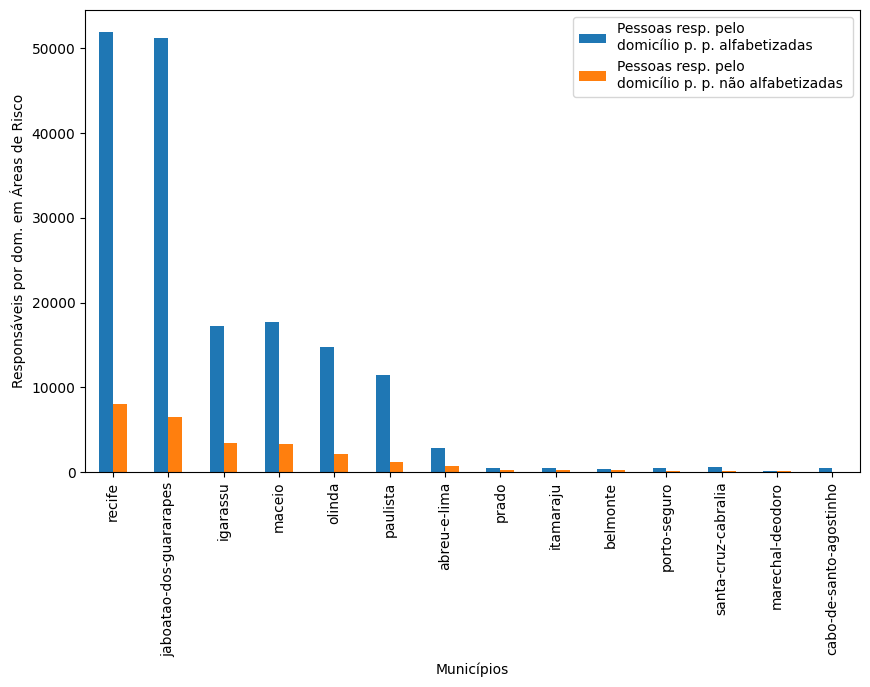

In [349]:
# Gráfico Comparado
# 'M087'	'Pessoas resp. pelo domicílio p. p.  alfabetizadas'
# 'M090'	'Pessoas resp. pelo domicílio p. p. não alfabetizadas '



df = DF_Areas_Risco_Domic_Pessoas.copy()

var1 = 'M087'
var2 = 'M090'

cols = [var1, var2]

# Resume df necessário
df = df[['nome_municipio', var1, var2]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
df = df.sort_values(var2, ascending = False)

# Armazena novos nomes de variáveis
nvar1 = 'Pessoas resp. pelo\ndomicílio p. p. alfabetizadas'
nvar2 = 'Pessoas resp. pelo\ndomicílio p. p. não alfabetizadas '

df.rename({var1 : nvar1, var2 : nvar2}, axis = 1, inplace = True)
cols = [nvar1, nvar2]

# Agregando df por município e somando os valores das variáveis trabalhadas com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum()
df = df.sort_values(nvar2, ascending = False)


df.plot(
        # x = 'nome_municipio',
        y = cols,
        kind = 'bar',
        legend = True
        )
plt.xlabel('Municípios')
plt.ylabel('Responsáveis por dom. em Áreas de Risco')

save_graph('Bar_Responsáveis pelo Domicílio Alfabetizado x Não Alfabetizado em AR', 'Municipios')

Gráfico Comparado Rendimento médio nominal mensal domiciliar per capita em Áreas de Risco (O.K.)

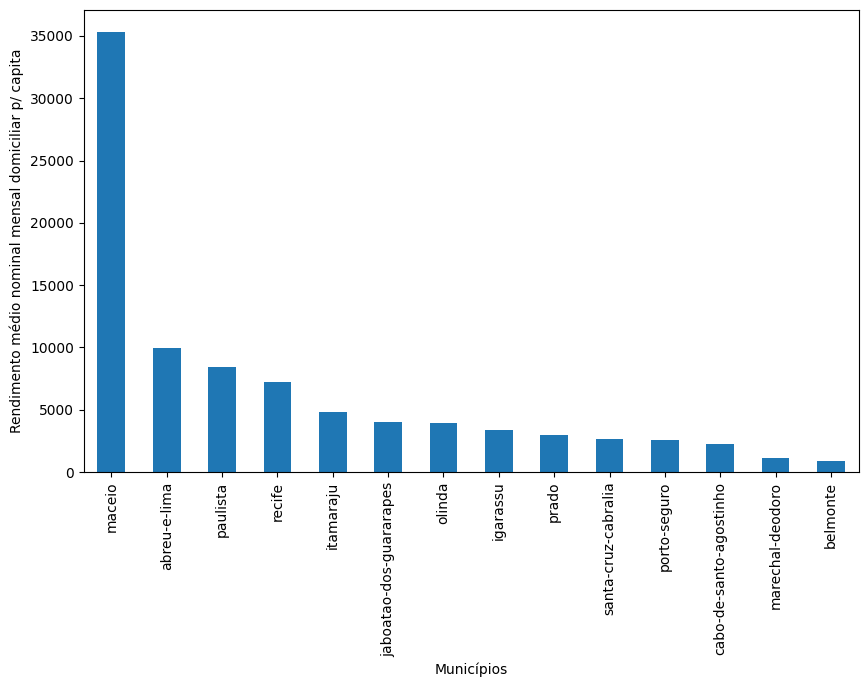

In [350]:
# Gráfico 'D084'	Rendimento médio nominal mensal domiciliar per capita

df = DF_Areas_Risco_Domic_Pessoas.copy()

var1 = 'D084'


cols = [var1]

# Resume df necessário
df = df[['nome_municipio', var1]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
df = df.sort_values(var1, ascending = False)

# Armazena novos nomes de variáveis
nvar1 = 'Rendimento médio nominal\nmensal domiciliar per capita'

df.rename({var1 : nvar1}, axis = 1, inplace = True)
cols = [nvar1]

# Agregando df por município e somando os valores das variáveis trabalhadas com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum()
df = df.sort_values(nvar1, ascending = False)


df.plot(
        # x = 'nome_municipio',
        y = cols,
        kind = 'bar',
        legend = False
        )
plt.xlabel('Municípios')
plt.ylabel('Rendimento médio nominal mensal domiciliar p/ capita')

save_graph('Bar_Rendimento médio nominal mensal domiciliar per capita em AR', 'Municipios')

Gráfico Municipal Domicílios em Extrema Vulnerabilidade Socioeconômica em Áreas de Risco (O.K.)

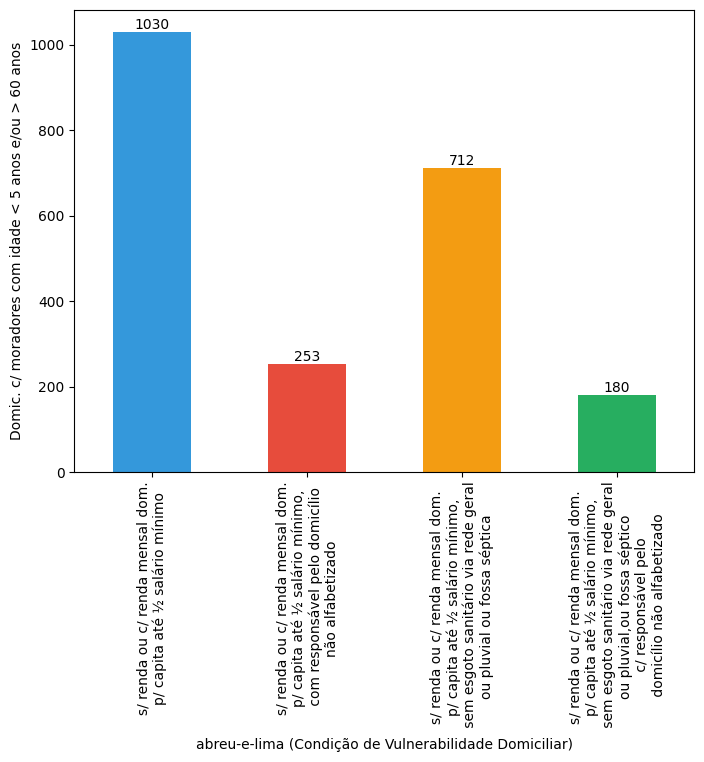

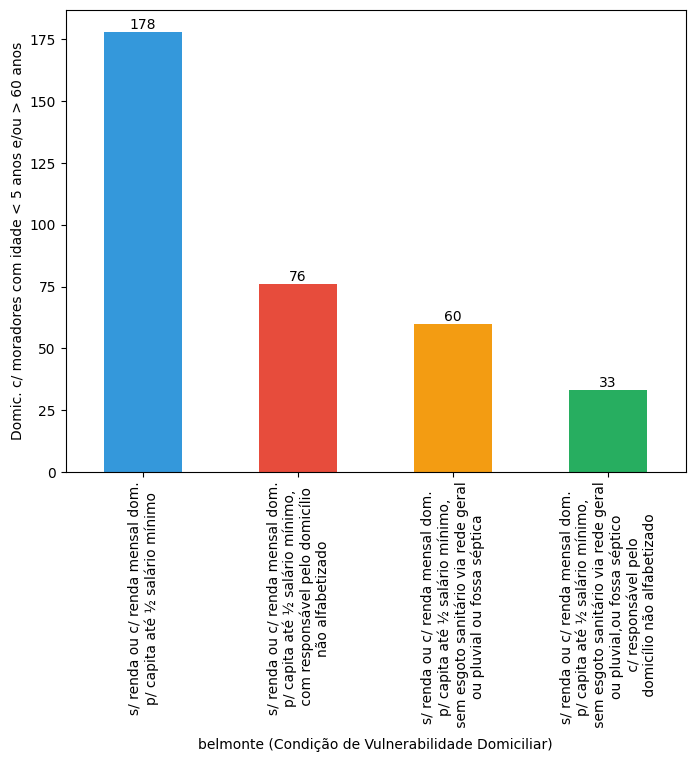

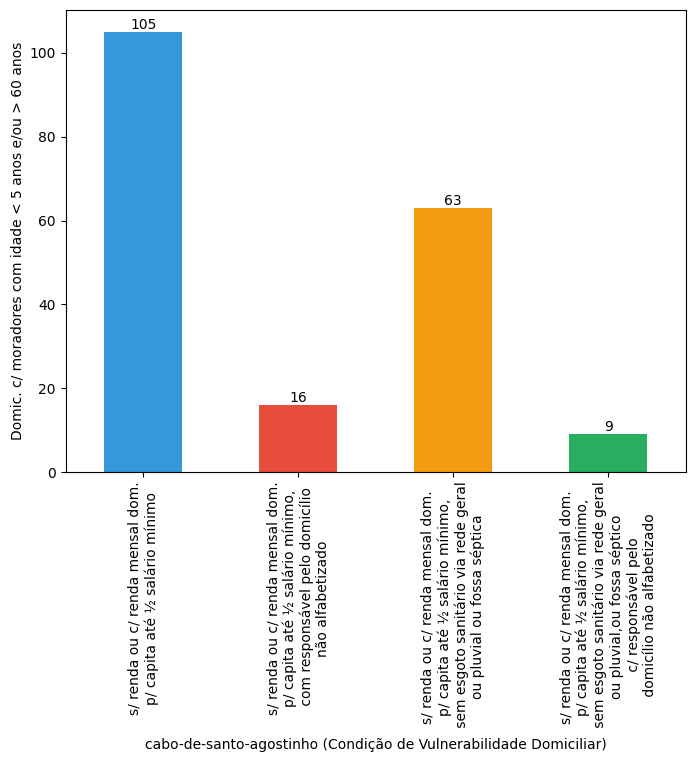

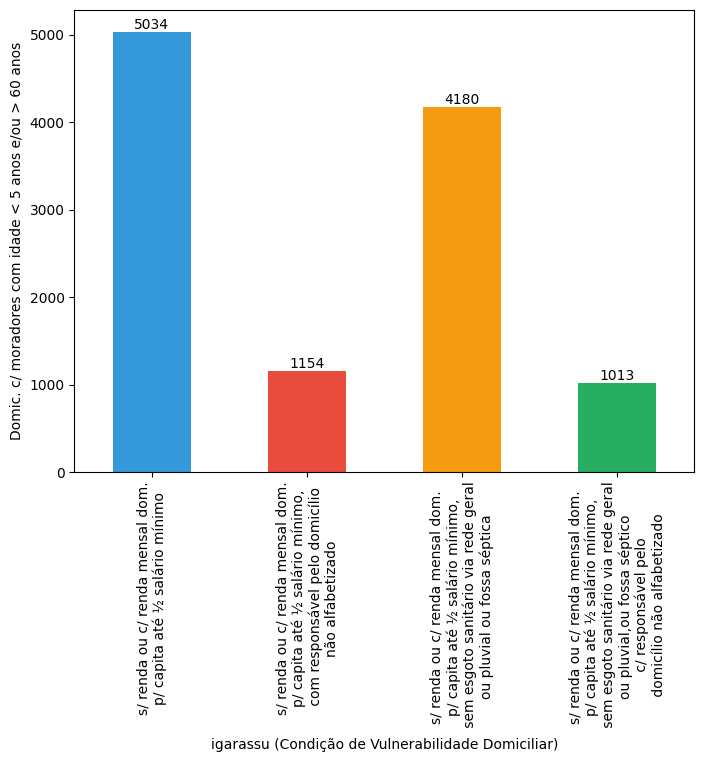

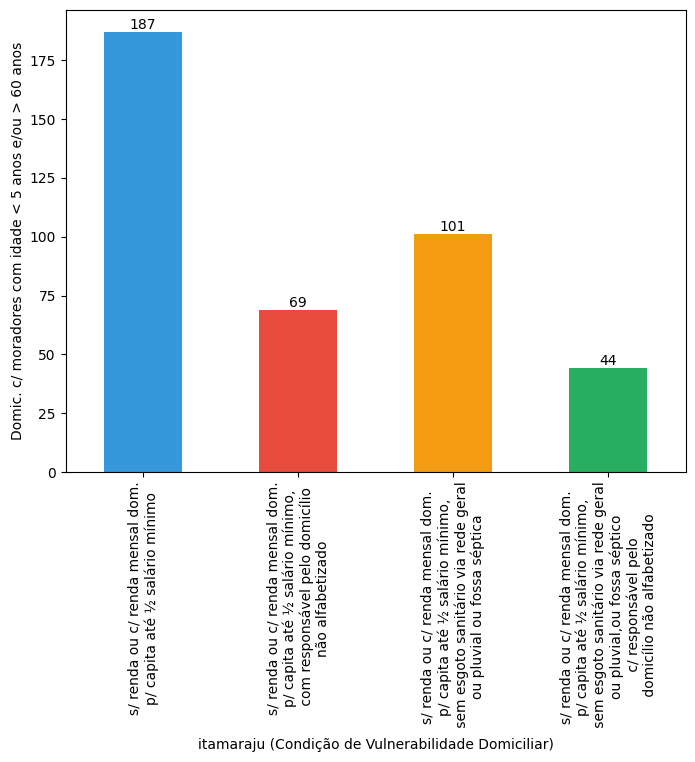

...

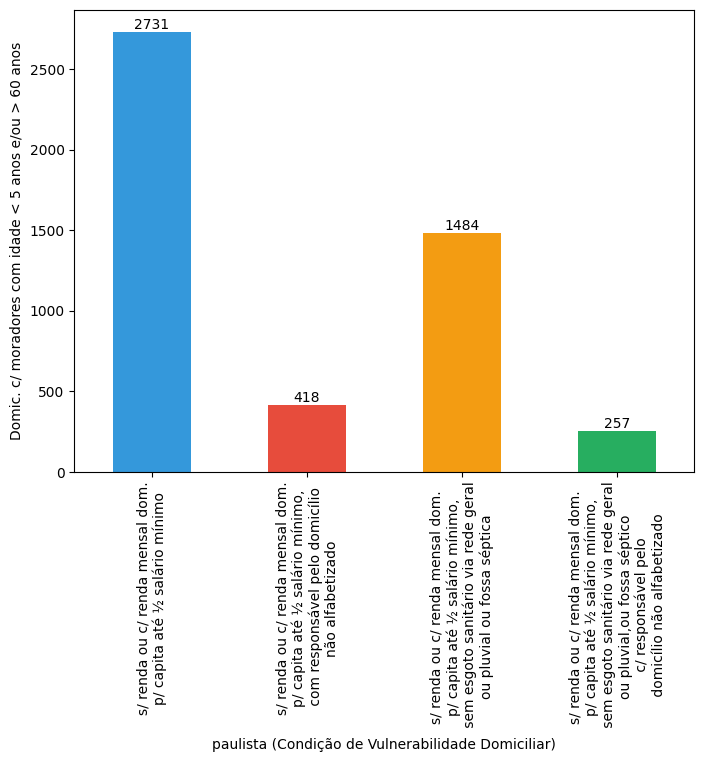

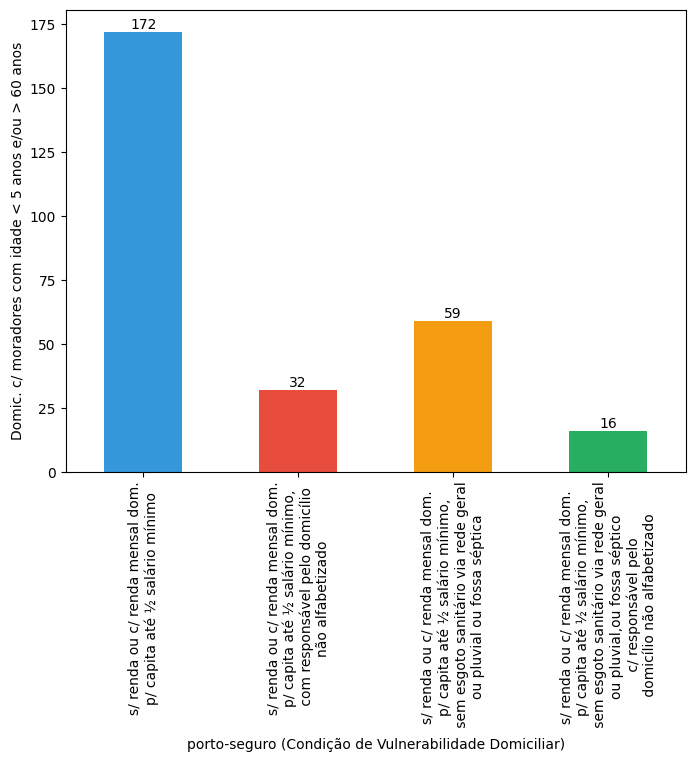

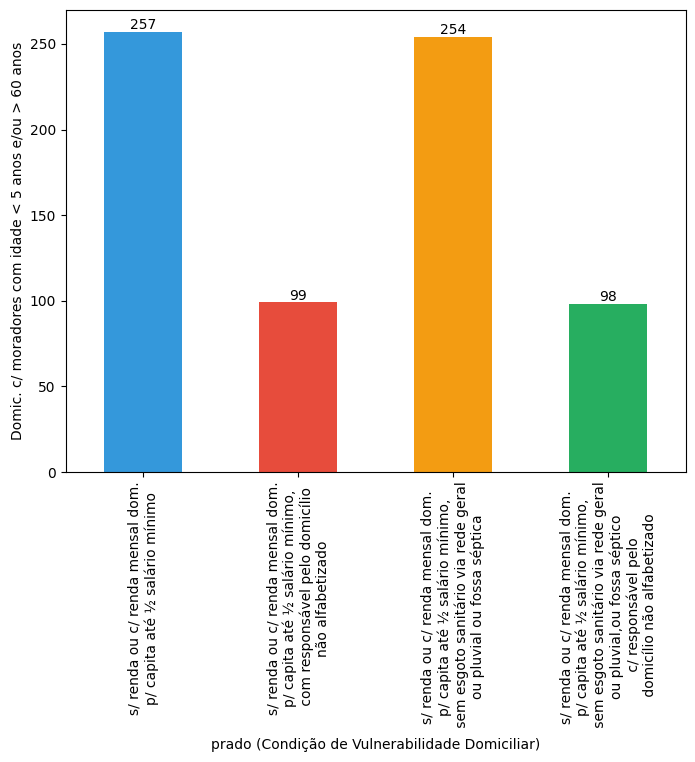

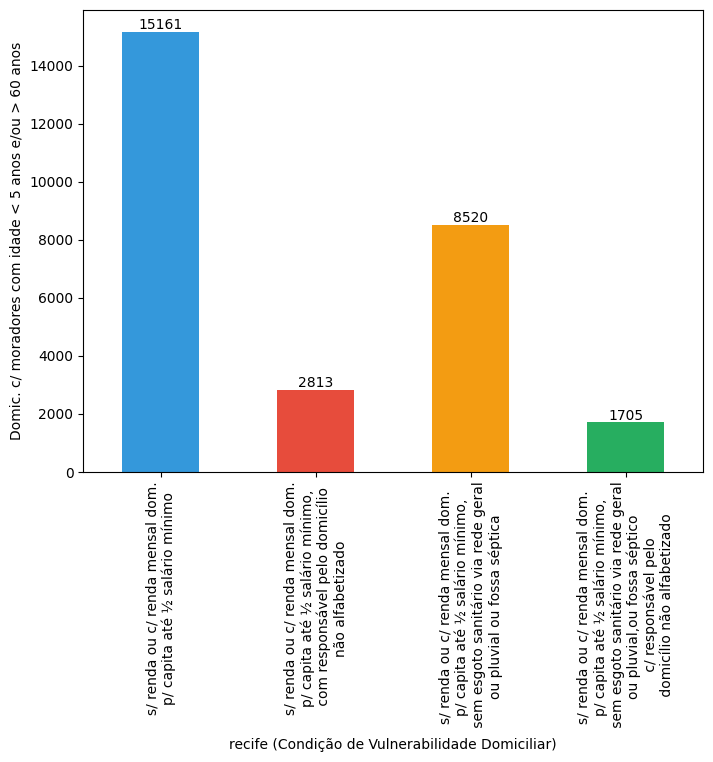

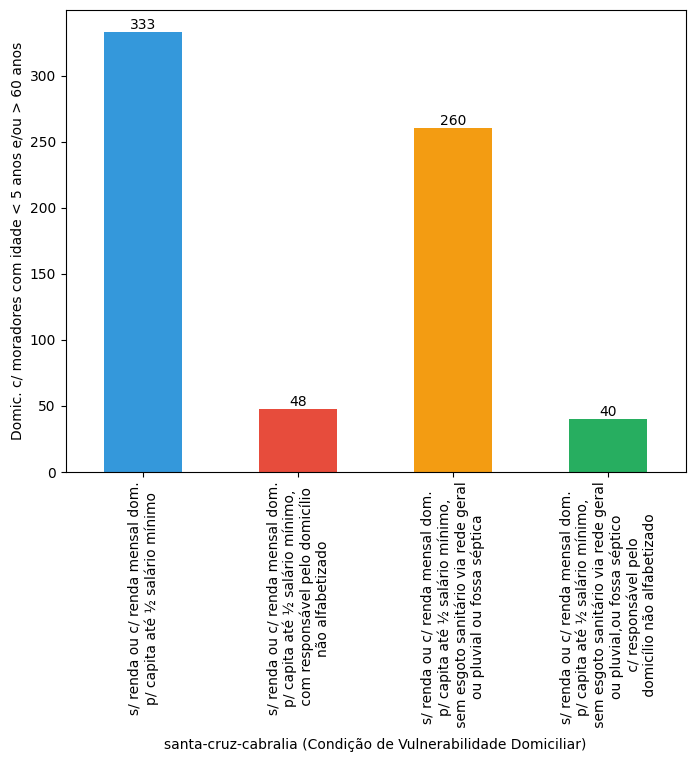

In [351]:
# Gráfico
# 'D115' Domicílios particulares permanentes com moradores com idade menor ou igual a 5 anos e/ou maior ou igual a 60 anos, sem rendimento ou com rendimento nominal mensal domiciliar per capita até ½ salário mínimo
# 'D121' Domicílios particulares permanentes com moradores com idade menor ou igual a 5 anos e/ou maior ou igual a 60 anos, sem rendimento ou com rendimento nominal mensal domiciliar per capita até ½ salário mínimo, 
# 'D127' Domicílios particulares permanentes com moradores com idade menor ou igual a 5 anos e/ou maior ou igual a 60 anos, sem rendimento ou com rendimento nominal mensal domiciliar per capita até ½ salário mínimo, sem esgoto sanitário via rede geral de esgoto ou pluvial ou fossa séptica, com responsável pelo domicílio não alfabetizado
# 'D133' Domicílios particulares permanentes com moradores com idade menor ou igual a 5 anos e/ou maior ou igual a 60 anos, sem rendimento ou com rendimento nominal mensal domiciliar per capita até ½ salário mínimo, sem esgoto sanitário via rede geral de esgoto ou pluvial ou fossa séptica


df = DF_Areas_Risco_Domic_Pessoas.copy()

var1 = 'D115'
var2 = 'D121'
var3 = 'D127'
var4 = 'D133'

cols = [var1, var2, var3, var4]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, var4]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
# df = df.sort_values(var1, ascending = False)

# Armazena novos nomes de variáveis
nvar1 = 's/ renda ou c/ renda mensal dom.\np/ capita até ½ salário mínimo'
nvar2 = 's/ renda ou c/ renda mensal dom.\np/ capita até ½ salário mínimo,\n com responsável pelo domicílio\nnão alfabetizado'
nvar3 = 's/ renda ou c/ renda mensal dom.\np/ capita até ½ salário mínimo,\n sem esgoto sanitário via rede geral\nou pluvial,ou fossa séptico\n c/ responsável pelo\n domicílio não alfabetizado' 
nvar4 = 's/ renda ou c/ renda mensal dom.\np/ capita até ½ salário mínimo,\n sem esgoto sanitário via rede geral\nou pluvial ou fossa séptica'


# Renomeia variáveis no df
df.rename({
var1: nvar1,
var2: nvar2,
var3: nvar3,
var4: nvar4,
var5: nvar5,
var6: nvar6,
var7: nvar7,
var8: nvar8
}, axis = 1, inplace = True)
cols = [nvar1, nvar2, nvar4, nvar3]

# Agregando df por município e somando os valores das variáveis trabalhadas com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum().reset_index()
# df = df.sort_values(nvar2, ascending = False)

# Define valores das cores das barras para o gráfico
c = '#3498db'
m = '#e74c3c'
y = '#f39c12'
g = '#27ae60'
p = '#9b59b6'
t = '#1abc9c'
a = '#34495e'

# Loop produz gráficos para cada município no DF
for munic in df['nome_municipio']:
        dfx = df[df['nome_municipio'] == munic]

        # Define colors for the bars
        colors = [c, m, y, g] #* 4

        # Plot the bar graph
        ax = dfx.iloc[0,1:].plot(kind='bar', color=colors, figsize=(8, 6))

        # Set the x and y axis labels
        ax.set_xlabel(f'{munic} (Condição de Vulnerabilidade Domiciliar)')
        ax.set_ylabel('Domic. c/ moradores com idade < 5 anos e/ou > 60 anos')

        for i, val in enumerate(dfx.iloc[0,1:]):
                plt.text(i, val, str(val), ha='center', va='bottom', fontweight='light')

        # Save plot to save_path
        plt.savefig(f'{save_path}\\Bar_Domicílios p p por Condição de Vulnerabilidade no Domicílio_{munic}', dpi = 300, bbox_inches='tight' )

        # Show the plot
        plt.show() 






Gráfico População em Domicílios em Extrema Vulnerabilidade SocioeconÔmica em Áreas de Risco (O.K.)

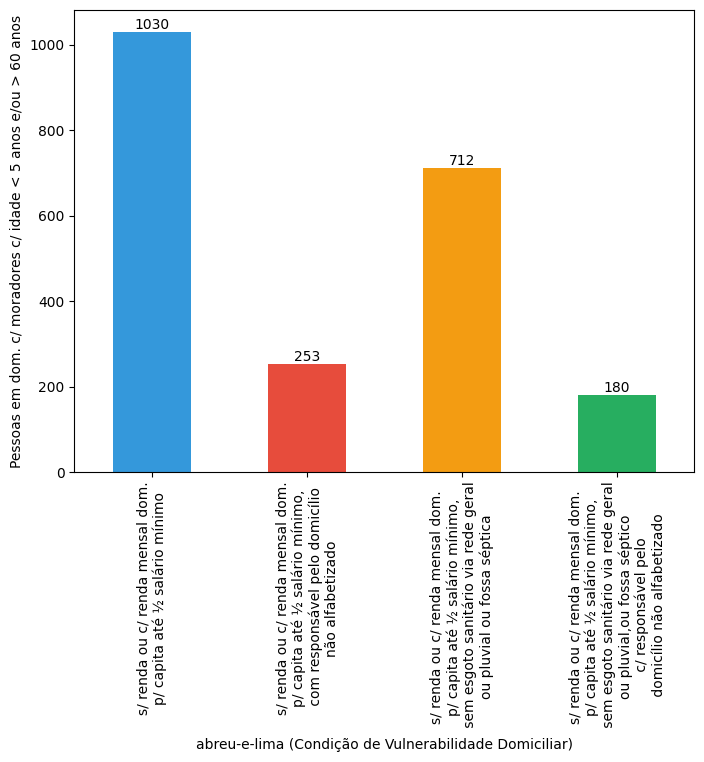

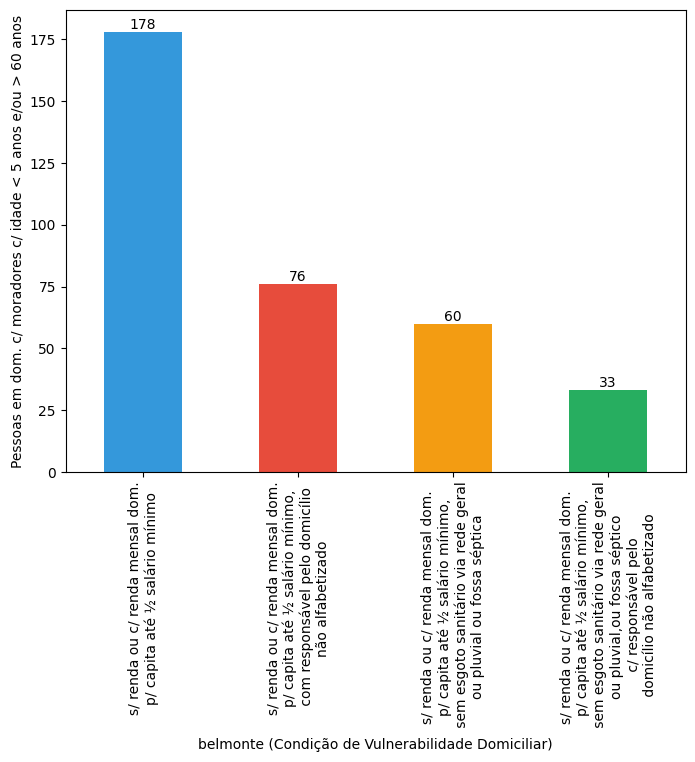

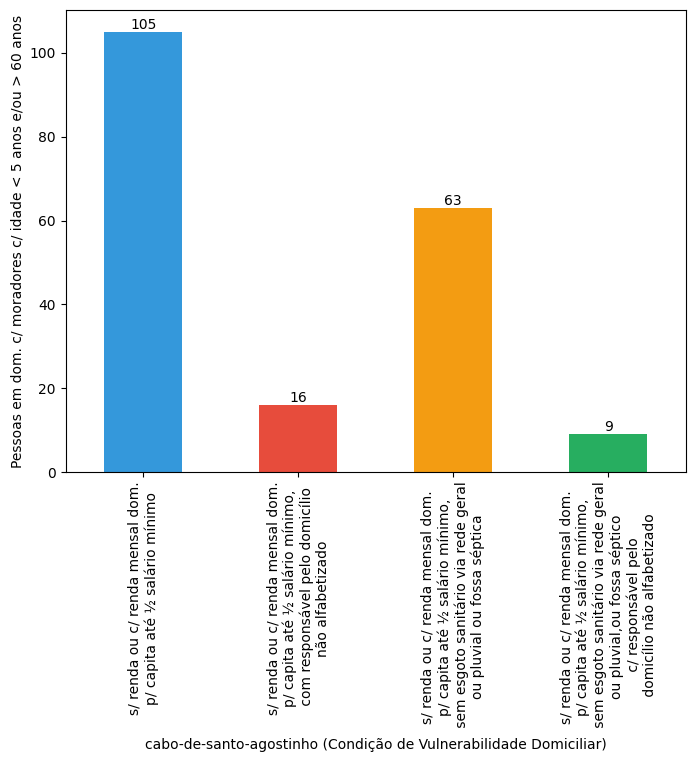

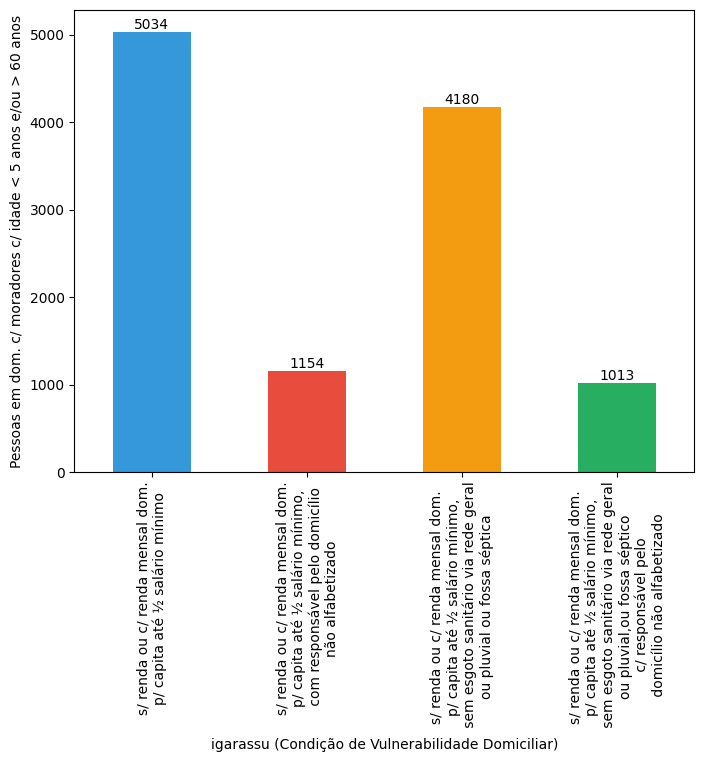

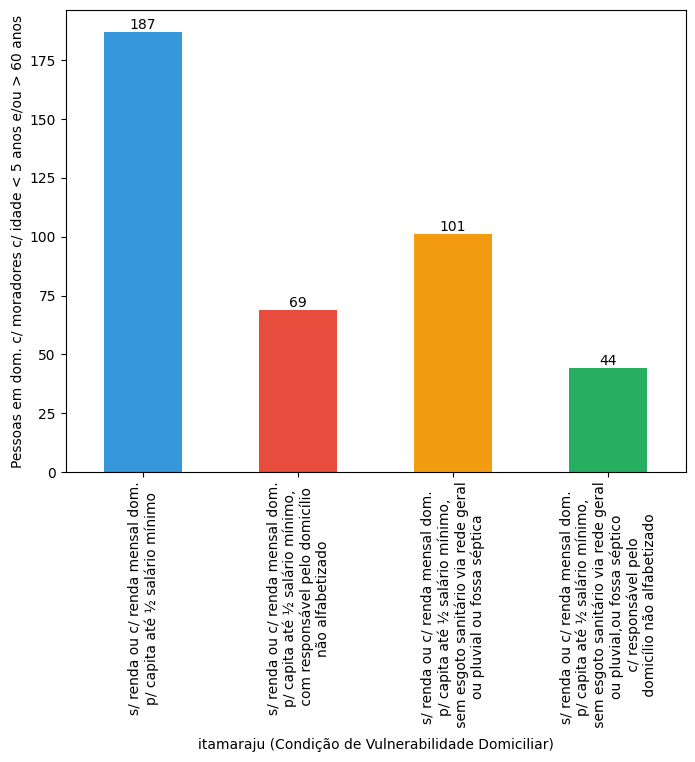

...

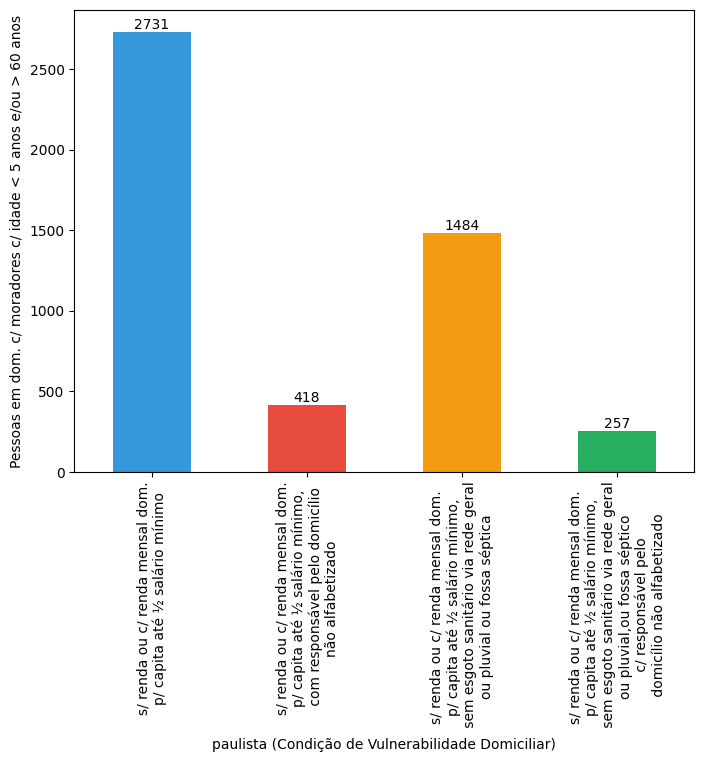

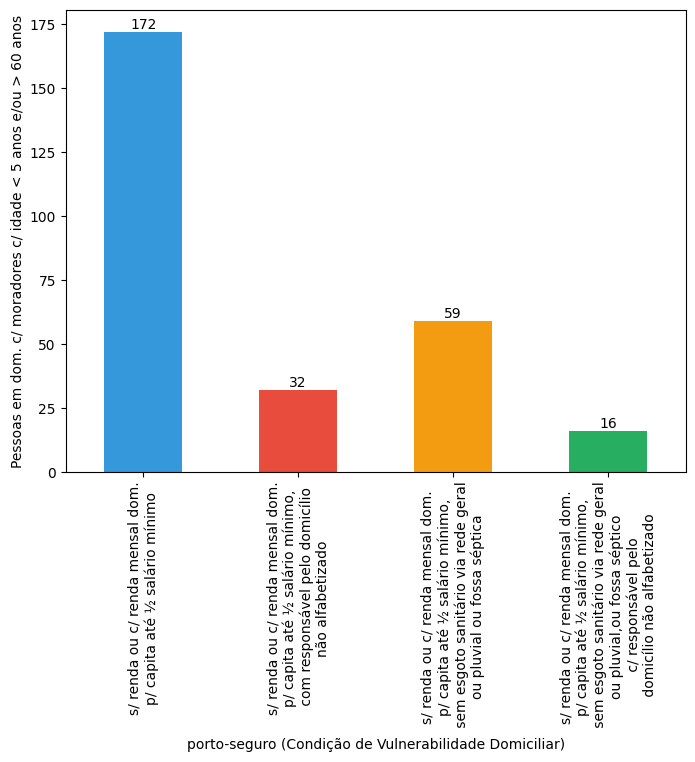

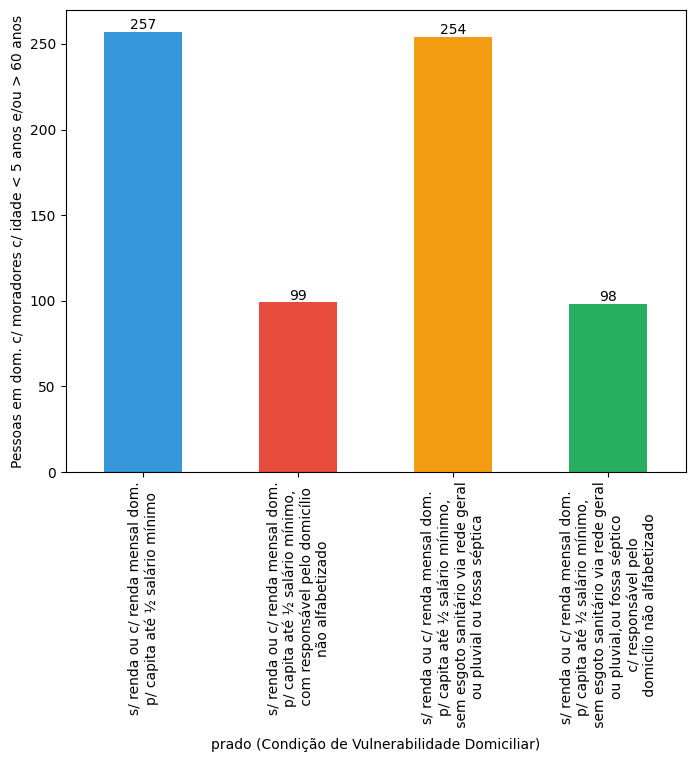

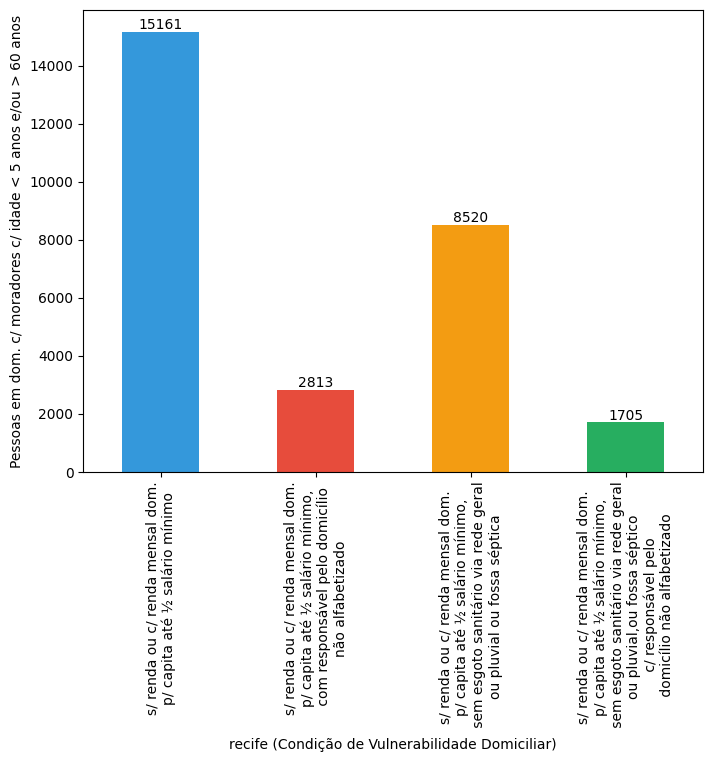

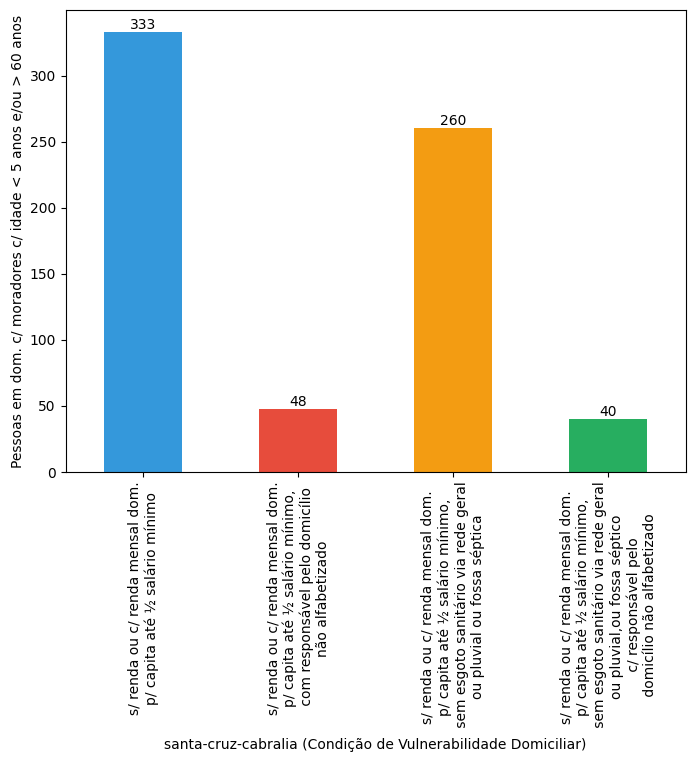

In [352]:
# Gráfico
# 'M163' Moradores em domicílios particulares permanentes com idade menor ou igual a 5 anos e/ou maior ou igual a 60 anos, sem rendimento ou com rendimento nominal mensal domiciliar per capita até ½ salário mínimo
# 'M169' Moradores em domicílios particulares permanentes com idade menor ou igual a 5 anos e/ou maior ou igual a 60 anos, sem rendimento ou com rendimento nominal mensal domiciliar per capita até ½ salário mínimo, com responsável pelo domicílio não alfabetizado
# 'M175' Moradores em domicílios particulares permanentes com idade menor ou igual a 5 anos e/ou maior ou igual a 60 anos, sem rendimento ou com rendimento nominal mensal domiciliar per capita até ½ salário mínimo, sem esgoto sanitário via rede geral de esgoto ou pluvial ou fossa séptica, com responsável pelo domicílio não alfabetizado
# 'M181' Moradores em domicílios particulares permanentes com idade menor ou igual a 5 anos e/ou maior ou igual a 60 anos, sem rendimento ou com rendimento nominal mensal domiciliar per capita até ½ salário mínimo, sem esgoto sanitário via rede geral de esgoto ou pluvial ou fossa séptica

df = DF_Areas_Risco_Domic_Pessoas.copy()

var1 = 'D115'
var2 = 'D121'
var3 = 'D127'
var4 = 'D133'

cols = [var1, var2, var3, var4]

# Resume df necessário
df = df[['nome_municipio', var1, var2, var3, var4]]
df = df[df['nome_municipio'].isin(Municipios)]

# Converte dtype das colunas para números
df[cols] = df[cols].apply(lambda x: pd.to_numeric(x, errors = 'coerce') )
# df = df.sort_values(var1, ascending = False)

# Armazena novos nomes de variáveis
nvar1 = 's/ renda ou c/ renda mensal dom.\np/ capita até ½ salário mínimo'
nvar2 = 's/ renda ou c/ renda mensal dom.\np/ capita até ½ salário mínimo,\n com responsável pelo domicílio\nnão alfabetizado'
nvar3 = 's/ renda ou c/ renda mensal dom.\np/ capita até ½ salário mínimo,\n sem esgoto sanitário via rede geral\nou pluvial,ou fossa séptico\n c/ responsável pelo\n domicílio não alfabetizado' 
nvar4 = 's/ renda ou c/ renda mensal dom.\np/ capita até ½ salário mínimo,\n sem esgoto sanitário via rede geral\nou pluvial ou fossa séptica'


# Renomeia variáveis no df
df.rename({
var1: nvar1,
var2: nvar2,
var3: nvar3,
var4: nvar4,
var5: nvar5,
var6: nvar6,
var7: nvar7,
var8: nvar8
}, axis = 1, inplace = True)
cols = [nvar1, nvar2, nvar4, nvar3]

# Agregando df por município e somando os valores das variáveis trabalhadas com groupby().sum()
df = df.groupby(['nome_municipio'])[cols].sum().reset_index()
# df = df.sort_values(nvar2, ascending = False)

# Define valores das cores das barras para o gráfico
c = '#3498db'
m = '#e74c3c'
y = '#f39c12'
g = '#27ae60'
p = '#9b59b6'
t = '#1abc9c'
a = '#34495e'

# Loop produz gráficos para cada município no DF
for munic in df['nome_municipio']:
        dfx = df[df['nome_municipio'] == munic]

        # Define colors for the bars
        colors = [c, m, y, g] #* 4

        # Plot the bar graph
        ax = dfx.iloc[0,1:].plot(kind='bar', color=colors, figsize=(8, 6))

        # Set the x and y axis labels
        ax.set_xlabel(f'{munic} (Condição de Vulnerabilidade Domiciliar)')
        ax.set_ylabel('Pessoas em dom. c/ moradores c/ idade < 5 anos e/ou > 60 anos')

        for i, val in enumerate(dfx.iloc[0,1:]):
                plt.text(i, val, str(val), ha='center', va='bottom', fontweight='light')

        # Save plot to save_path
        plt.savefig(f'{save_path}\\Bar_Pessoas em Domicílios p p por Condição de Vulnerabilidade no Domicílio_{munic}', dpi = 300, bbox_inches='tight' )

        # Show the plot
        plt.show() 


